In [1]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from glob import glob
from sklearn.model_selection import train_test_split
from torchvision import transforms
from torch.optim.lr_scheduler import CosineAnnealingLR
import matplotlib.pyplot as plt
from tqdm import tqdm


In [2]:
from google.colab import drive
drive.mount('/content/drive')

print(os.path.exists('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final'))
print(os.listdir('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images'))


Mounted at /content/drive
True
['new_data']
['Blast_PCRM_1202182 D5_0.bmp', 'Blast_PCRM_1202182 D5_1.bmp', 'Blast_PCRM_1202182 D5_2.bmp', 'Blast_PCRM_1202182 D5_3.bmp', 'Blast_PCRM_1202182 D5_4.bmp', 'Blast_PCRM_R16-0204A_0.bmp', 'Blast_PCRM_R16-0204A_1.bmp', 'Blast_PCRM_R16-0204A_2.bmp', 'Blast_PCRM_R16-0204A_3.bmp', 'Blast_PCRM_R16-0204A_4.bmp', 'Blast_PCRM_R12-0326b_0.bmp', 'Blast_PCRM_R12-0326b_1.bmp', 'Blast_PCRM_R12-0326b_2.bmp', 'Blast_PCRM_R12-0326b_3.bmp', 'Blast_PCRM_R12-0326b_4.bmp', 'Blast_PCRM_R13-0027_0.bmp', 'Blast_PCRM_R13-0027_1.bmp', 'Blast_PCRM_R13-0027_2.bmp', 'Blast_PCRM_R13-0027_3.bmp', 'Blast_PCRM_R13-0027_4.bmp', 'Blast_PCRM_R14-0374b_0.bmp', 'Blast_PCRM_R14-0374b_1.bmp', 'Blast_PCRM_R14-0374b_2.bmp', 'Blast_PCRM_R14-0374b_3.bmp', 'Blast_PCRM_R14-0374b_4.bmp', 'Blast_PCRM_R16-0274A_0.bmp', 'Blast_PCRM_R16-0274A_1.bmp', 'Blast_PCRM_R16-0274A_2.bmp', 'Blast_PCRM_R16-0274A_3.bmp', 'Blast_PCRM_R16-0274A_4.bmp', 'Blast_PCRM_R12-0358a_0.bmp', 'Blast_PCRM_R12-0358a_1.b

In [3]:
SIZE = 256
BATCH_SIZE = 8
EPOCHS = 200
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [4]:
class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((SIZE, SIZE)),
        ])

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = cv2.imread(self.image_paths[idx])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (SIZE, SIZE)) / 255.0

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (SIZE, SIZE)) / 255.0
        mask = np.expand_dims(mask, axis=0)

        image = torch.from_numpy(image).permute(2, 0, 1).float()
        mask = torch.from_numpy(mask).float()

        return image, mask


In [9]:
def get_confusion(y_true, y_pred, threshold=0.5):
    y_pred = (y_pred > threshold).float()
    y_true = y_true.float()

    TP = (y_true * y_pred).sum()
    TN = ((1 - y_true) * (1 - y_pred)).sum()
    FP = ((1 - y_true) * y_pred).sum()
    FN = (y_true * (1 - y_pred)).sum()

    return TP, TN, FP, FN

def dice_score(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (2 * TP + 1e-6) / (2 * TP + FP + FN + 1e-6)

def mean_iou(y_true, y_pred):
    TP, _, FP, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FP + FN + 1e-6)

def accuracy(y_true, y_pred):
    TP, TN, FP, FN = get_confusion(y_true, y_pred)
    return (TP + TN + 1e-6) / (TP + TN + FP + FN + 1e-6)

def sensitivity(y_true, y_pred):
    TP, _, _, FN = get_confusion(y_true, y_pred)
    return (TP + 1e-6) / (TP + FN + 1e-6)

def specificity(y_true, y_pred):
    _, TN, FP, _ = get_confusion(y_true, y_pred)
    return (TN + 1e-6) / (TN + FP + 1e-6)


In [10]:
class BCEDiceLoss(nn.Module):
    def __init__(self, lambda1=1, lambda2=1):
        super(BCEDiceLoss, self).__init__()
        self.bce = nn.BCEWithLogitsLoss()
        self.lambda1 = lambda1
        self.lambda2 = lambda2

    def forward(self, outputs, targets):
        bce_loss = self.bce(outputs, targets)
        intersection = (outputs * targets).sum()
        dice_loss = 1 - (2 * intersection + 1) / (outputs.sum() + targets.sum() + 1)
        return self.lambda1 * bce_loss + self.lambda2 * dice_loss


In [5]:
train_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/images/*.bmp'))
train_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/train/GT_ICM/*.bmp'))
valid_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/images/*.bmp'))
valid_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/valid/GT_ICM/*.bmp'))
test_x = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/images/*.bmp'))
test_y = sorted(glob('/content/drive/MyDrive/Copie de PFA_Final/new_data/test/GT_ICM/*.bmp'))

train_dataset = SegmentationDataset(train_x, train_y)
valid_dataset = SegmentationDataset(valid_x, valid_y)
test_dataset  = SegmentationDataset(test_x, test_y)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE)
test_loader  = DataLoader(test_dataset, batch_size=BATCH_SIZE)

print("Training:", len(train_dataset))
print("Validation:", len(valid_dataset))
print("Testing:", len(test_dataset))


Training: 995
Validation: 25
Testing: 25


In [6]:
import torch
from torch import nn
import torch.nn.functional as F

from timm.models.layers import trunc_normal_
import math


class DepthWiseConv2d(nn.Module):
    def __init__(self, dim_in, dim_out, kernel_size=3, padding=1, stride=1, dilation=1):
        super().__init__()

        self.conv1 = nn.Conv2d(dim_in, dim_in, kernel_size=kernel_size, padding=padding,
                      stride=stride, dilation=dilation, groups=dim_in)
        self.norm_layer = nn.GroupNorm(4, dim_in)
        self.conv2 = nn.Conv2d(dim_in, dim_out, kernel_size=1)

    def forward(self, x):
        return self.conv2(self.norm_layer(self.conv1(x)))

class GatedAttentionUnit(nn.Module):
    def __init__(self, in_c, out_c, kernel_size):
        super().__init__()
        self.w1 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size, padding=kernel_size//2),
            nn.Sigmoid()
        )

        self.w2 = nn.Sequential(
            DepthWiseConv2d(in_c, in_c, kernel_size + 2, padding=(kernel_size + 2)//2),
            nn.GELU()
        )
        self.wo = nn.Sequential(
            DepthWiseConv2d(in_c, out_c, kernel_size),
            nn.GELU()
        )

        self.cw = nn.Conv2d(in_c, out_c, 1)

    def forward(self, x):
        x1, x2 = self.w1(x), self.w2(x)
        out = self.wo(x1 * x2) + self.cw(x)
        return out


class DilatedGatedAttention(nn.Module):
    def __init__(self, in_c, out_c, k_size=3, dilated_ratio=[7, 5, 2, 1]):
        super().__init__()

        self.mda0 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[0]-1))//2,
                             dilation=dilated_ratio[0], groups=in_c//4)
        self.mda1 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[1]-1))//2,
                             dilation=dilated_ratio[1], groups=in_c//4)
        self.mda2 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[2]-1))//2,
                             dilation=dilated_ratio[2], groups=in_c//4)
        self.mda3 = nn.Conv2d(in_c//4, in_c//4, kernel_size=k_size, stride=1,
                              padding=(k_size+(k_size-1)*(dilated_ratio[3]-1))//2,
                             dilation=dilated_ratio[3], groups=in_c//4)
        self.norm_layer = nn.GroupNorm(4, in_c)
        self.conv = nn.Conv2d(in_c, in_c, 1)

        self.gau = GatedAttentionUnit(in_c, out_c, 3)

    def forward(self, x):
        x = torch.chunk(x, 4, dim=1)
        x0 = self.mda0(x[0])
        x1 = self.mda1(x[1])
        x2 = self.mda2(x[2])
        x3 = self.mda3(x[3])
        x = F.gelu(self.conv(self.norm_layer(torch.cat((x0, x1, x2, x3), dim=1))))
        x = self.gau(x)
        return x


class EAblock(nn.Module):
    def __init__(self, in_c):
        super().__init__()

        self.conv1 = nn.Conv2d(in_c, in_c, 1)

        self.k = in_c * 4
        self.linear_0 = nn.Conv1d(in_c, self.k, 1, bias=False)

        self.linear_1 = nn.Conv1d(self.k, in_c, 1, bias=False)
        self.linear_1.weight.data = self.linear_0.weight.data.permute(1, 0, 2)

        self.conv2 = nn.Conv2d(in_c, in_c, 1, bias=False)
        self.norm_layer = nn.GroupNorm(4, in_c)

    def forward(self, x):
        idn = x
        x = self.conv1(x)

        b, c, h, w = x.size()
        x = x.view(b, c, h*w)   # b * c * n

        attn = self.linear_0(x) # b, k, n
        attn = F.softmax(attn, dim=-1) # b, k, n

        attn = attn / (1e-9 + attn.sum(dim=1, keepdim=True)) #  # b, k, n
        x = self.linear_1(attn) # b, c, n

        x = x.view(b, c, h, w)
        x = self.norm_layer(self.conv2(x))
        x = x + idn
        x = F.gelu(x)
        return x


class Channel_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()
        c_list_sum = sum(c_list) - c_list[-1]
        self.split_att = split_att
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.get_all_att = nn.Conv1d(1, 1, kernel_size=3, padding=1, bias=False)
        self.att1 = nn.Linear(c_list_sum, c_list[0]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[0], 1)
        self.att2 = nn.Linear(c_list_sum, c_list[1]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[1], 1)
        self.att3 = nn.Linear(c_list_sum, c_list[2]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[2], 1)
        self.att4 = nn.Linear(c_list_sum, c_list[3]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[3], 1)
        self.att5 = nn.Linear(c_list_sum, c_list[4]) if split_att == 'fc' else nn.Conv1d(c_list_sum, c_list[4], 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, t1, t2, t3, t4, t5):
        att = torch.cat((self.avgpool(t1),
                         self.avgpool(t2),
                         self.avgpool(t3),
                         self.avgpool(t4),
                         self.avgpool(t5)), dim=1)
        att = self.get_all_att(att.squeeze(-1).transpose(-1, -2))
        if self.split_att != 'fc':
            att = att.transpose(-1, -2)
        att1 = self.sigmoid(self.att1(att))
        att2 = self.sigmoid(self.att2(att))
        att3 = self.sigmoid(self.att3(att))
        att4 = self.sigmoid(self.att4(att))
        att5 = self.sigmoid(self.att5(att))
        if self.split_att == 'fc':
            att1 = att1.transpose(-1, -2).unsqueeze(-1).expand_as(t1)
            att2 = att2.transpose(-1, -2).unsqueeze(-1).expand_as(t2)
            att3 = att3.transpose(-1, -2).unsqueeze(-1).expand_as(t3)
            att4 = att4.transpose(-1, -2).unsqueeze(-1).expand_as(t4)
            att5 = att5.transpose(-1, -2).unsqueeze(-1).expand_as(t5)
        else:
            att1 = att1.unsqueeze(-1).expand_as(t1)
            att2 = att2.unsqueeze(-1).expand_as(t2)
            att3 = att3.unsqueeze(-1).expand_as(t3)
            att4 = att4.unsqueeze(-1).expand_as(t4)
            att5 = att5.unsqueeze(-1).expand_as(t5)

        return att1, att2, att3, att4, att5


class Spatial_Att_Bridge(nn.Module):
    def __init__(self):
        super().__init__()
        self.shared_conv2d = nn.Sequential(nn.Conv2d(2, 1, 7, stride=1, padding=9, dilation=3),
                                          nn.Sigmoid())

    def forward(self, t1, t2, t3, t4, t5):
        t_list = [t1, t2, t3, t4, t5]
        att_list = []
        for t in t_list:
            avg_out = torch.mean(t, dim=1, keepdim=True)
            max_out, _ = torch.max(t, dim=1, keepdim=True)
            att = torch.cat([avg_out, max_out], dim=1)
            att = self.shared_conv2d(att)
            att_list.append(att)
        return att_list[0], att_list[1], att_list[2], att_list[3], att_list[4]


class SC_Att_Bridge(nn.Module):
    def __init__(self, c_list, split_att='fc'):
        super().__init__()

        self.catt = Channel_Att_Bridge(c_list, split_att=split_att)
        self.satt = Spatial_Att_Bridge()

    def forward(self, t1, t2, t3, t4, t5):
        r1, r2, r3, r4, r5 = t1, t2, t3, t4, t5

        satt1, satt2, satt3, satt4, satt5 = self.satt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = satt1 * t1, satt2 * t2, satt3 * t3, satt4 * t4, satt5 * t5

        r1_, r2_, r3_, r4_, r5_ = t1, t2, t3, t4, t5
        t1, t2, t3, t4, t5 = t1 + r1, t2 + r2, t3 + r3, t4 + r4, t5 + r5

        catt1, catt2, catt3, catt4, catt5 = self.catt(t1, t2, t3, t4, t5)
        t1, t2, t3, t4, t5 = catt1 * t1, catt2 * t2, catt3 * t3, catt4 * t4, catt5 * t5

        return t1 + r1_, t2 + r2_, t3 + r3_, t4 + r4_, t5 + r5_


class MALUNet(nn.Module):

    def __init__(self, num_classes=1, input_channels=3, c_list=[8,16,24,32,48,64],
                split_att='fc', bridge=True):
        super().__init__()

        self.bridge = bridge

        self.encoder1 = nn.Sequential(
            nn.Conv2d(input_channels, c_list[0], 3, stride=1, padding=1),
        )
        self.encoder2 =nn.Sequential(
            nn.Conv2d(c_list[0], c_list[1], 3, stride=1, padding=1),
        )
        self.encoder3 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[2], 3, stride=1, padding=1),
        )
        self.encoder4 = nn.Sequential(
            EAblock(c_list[2]),
            DilatedGatedAttention(c_list[2], c_list[3]),
        )
        self.encoder5 = nn.Sequential(
            EAblock(c_list[3]),
            DilatedGatedAttention(c_list[3], c_list[4]),
        )
        self.encoder6 = nn.Sequential(
            EAblock(c_list[4]),
            DilatedGatedAttention(c_list[4], c_list[5]),
        )

        if bridge:
            self.scab = SC_Att_Bridge(c_list, split_att)
            print('SC_Att_Bridge was used')

        self.decoder1 = nn.Sequential(
            DilatedGatedAttention(c_list[5], c_list[4]),
            EAblock(c_list[4]),
        )
        self.decoder2 = nn.Sequential(
            DilatedGatedAttention(c_list[4], c_list[3]),
            EAblock(c_list[3]),
        )
        self.decoder3 = nn.Sequential(
            DilatedGatedAttention(c_list[3], c_list[2]),
            EAblock(c_list[2]),
        )
        self.decoder4 = nn.Sequential(
            nn.Conv2d(c_list[2], c_list[1], 3, stride=1, padding=1),
        )
        self.decoder5 = nn.Sequential(
            nn.Conv2d(c_list[1], c_list[0], 3, stride=1, padding=1),
        )
        self.ebn1 = nn.GroupNorm(4, c_list[0])
        self.ebn2 = nn.GroupNorm(4, c_list[1])
        self.ebn3 = nn.GroupNorm(4, c_list[2])
        self.ebn4 = nn.GroupNorm(4, c_list[3])
        self.ebn5 = nn.GroupNorm(4, c_list[4])
        self.dbn1 = nn.GroupNorm(4, c_list[4])
        self.dbn2 = nn.GroupNorm(4, c_list[3])
        self.dbn3 = nn.GroupNorm(4, c_list[2])
        self.dbn4 = nn.GroupNorm(4, c_list[1])
        self.dbn5 = nn.GroupNorm(4, c_list[0])

        self.final = nn.Conv2d(c_list[0], num_classes, kernel_size=1)

        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            trunc_normal_(m.weight, std=.02)
            if isinstance(m, nn.Linear) and m.bias is not None:
                nn.init.constant_(m.bias, 0)
        elif isinstance(m, nn.Conv1d):
                n = m.kernel_size[0] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
        elif isinstance(m, nn.Conv2d):
            fan_out = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
            fan_out //= m.groups
            m.weight.data.normal_(0, math.sqrt(2.0 / fan_out))
            if m.bias is not None:
                m.bias.data.zero_()

    def forward(self, x):

        out = F.gelu(F.max_pool2d(self.ebn1(self.encoder1(x)),2,2))
        t1 = out # b, c0, H/2, W/2

        out = F.gelu(F.max_pool2d(self.ebn2(self.encoder2(out)),2,2))
        t2 = out # b, c1, H/4, W/4

        out = F.gelu(F.max_pool2d(self.ebn3(self.encoder3(out)),2,2))
        t3 = out # b, c2, H/8, W/8

        out = F.gelu(F.max_pool2d(self.ebn4(self.encoder4(out)),2,2))
        t4 = out # b, c3, H/16, W/16

        out = F.gelu(F.max_pool2d(self.ebn5(self.encoder5(out)),2,2))
        t5 = out # b, c4, H/32, W/32

        if self.bridge: t1, t2, t3, t4, t5 = self.scab(t1, t2, t3, t4, t5)

        out = F.gelu(self.encoder6(out)) # b, c5, H/32, W/32

        out5 = F.gelu(self.dbn1(self.decoder1(out))) # b, c4, H/32, W/32
        out5 = torch.add(out5, t5) # b, c4, H/32, W/32

        out4 = F.gelu(F.interpolate(self.dbn2(self.decoder2(out5)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c3, H/16, W/16
        out4 = torch.add(out4, t4) # b, c3, H/16, W/16

        out3 = F.gelu(F.interpolate(self.dbn3(self.decoder3(out4)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c2, H/8, W/8
        out3 = torch.add(out3, t3) # b, c2, H/8, W/8

        out2 = F.gelu(F.interpolate(self.dbn4(self.decoder4(out3)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c1, H/4, W/4
        out2 = torch.add(out2, t2) # b, c1, H/4, W/4

        out1 = F.gelu(F.interpolate(self.dbn5(self.decoder5(out2)),scale_factor=(2,2),mode ='bilinear',align_corners=True)) # b, c0, H/2, W/2
        out1 = torch.add(out1, t1) # b, c0, H/2, W/2

        out0 = F.interpolate(self.final(out1),scale_factor=(2,2),mode ='bilinear',align_corners=True) # b, num_class, H, W

        return torch.sigmoid(out0)

/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [7]:
model = MALUNet().to(DEVICE)

optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)


SC_Att_Bridge was used


In [11]:
# Training loop with evaluation metrics
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0
    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)

        optimizer.zero_grad()
        preds = model(images)  # Model already applies sigmoid in the output

        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    scheduler.step()

    # Validation phase
    model.eval()
    with torch.no_grad():
        val_dice = []
        val_miou = []
        val_accuracy = []
        val_sensitivity = []
        val_specificity = []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)  # Model already applies sigmoid in the output

            # Compute confusion matrix for the predictions
            TP, TN, FP, FN = get_confusion(masks, preds)

            # Compute evaluation metrics
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        # Print out the evaluation metrics for the current epoch
        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")


Epoch 1/200: 100%|██████████| 125/125 [10:24<00:00,  5.00s/it]


Epoch 1: Loss = 127.3503, Val Dice = 0.8115, Val mIoU = 0.6840, Val Accuracy = 0.9677, Val Sensitivity = 0.8063, Val Specificity = 0.9838


Epoch 2/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 2: Loss = 111.3387, Val Dice = 0.8156, Val mIoU = 0.6893, Val Accuracy = 0.9693, Val Sensitivity = 0.7867, Val Specificity = 0.9874


Epoch 3/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 3: Loss = 108.1886, Val Dice = 0.8386, Val mIoU = 0.7233, Val Accuracy = 0.9721, Val Sensitivity = 0.8414, Val Specificity = 0.9852


Epoch 4/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 4: Loss = 106.4068, Val Dice = 0.8332, Val mIoU = 0.7147, Val Accuracy = 0.9727, Val Sensitivity = 0.7871, Val Specificity = 0.9911


Epoch 5/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 5: Loss = 105.4865, Val Dice = 0.8328, Val mIoU = 0.7141, Val Accuracy = 0.9713, Val Sensitivity = 0.8281, Val Specificity = 0.9857


Epoch 6/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 6: Loss = 104.6589, Val Dice = 0.8409, Val mIoU = 0.7266, Val Accuracy = 0.9730, Val Sensitivity = 0.8285, Val Specificity = 0.9874


Epoch 7/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 7: Loss = 103.6018, Val Dice = 0.8374, Val mIoU = 0.7211, Val Accuracy = 0.9725, Val Sensitivity = 0.8204, Val Specificity = 0.9877


Epoch 8/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 8: Loss = 102.9673, Val Dice = 0.8382, Val mIoU = 0.7223, Val Accuracy = 0.9724, Val Sensitivity = 0.8284, Val Specificity = 0.9868


Epoch 9/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 9: Loss = 102.6265, Val Dice = 0.8277, Val mIoU = 0.7072, Val Accuracy = 0.9716, Val Sensitivity = 0.7906, Val Specificity = 0.9895


Epoch 10/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 10: Loss = 101.8341, Val Dice = 0.8374, Val mIoU = 0.7217, Val Accuracy = 0.9725, Val Sensitivity = 0.8229, Val Specificity = 0.9874


Epoch 11/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 11: Loss = 100.8806, Val Dice = 0.8487, Val mIoU = 0.7387, Val Accuracy = 0.9734, Val Sensitivity = 0.8637, Val Specificity = 0.9845


Epoch 12/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 12: Loss = 100.2847, Val Dice = 0.8467, Val mIoU = 0.7359, Val Accuracy = 0.9738, Val Sensitivity = 0.8409, Val Specificity = 0.9870


Epoch 13/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 13: Loss = 99.8802, Val Dice = 0.8354, Val mIoU = 0.7181, Val Accuracy = 0.9728, Val Sensitivity = 0.8013, Val Specificity = 0.9897


Epoch 14/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 14: Loss = 99.1825, Val Dice = 0.8422, Val mIoU = 0.7285, Val Accuracy = 0.9736, Val Sensitivity = 0.8156, Val Specificity = 0.9892


Epoch 15/200: 100%|██████████| 125/125 [01:30<00:00,  1.37it/s]


Epoch 15: Loss = 98.4134, Val Dice = 0.8395, Val mIoU = 0.7247, Val Accuracy = 0.9726, Val Sensitivity = 0.8325, Val Specificity = 0.9867


Epoch 16/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 16: Loss = 97.6273, Val Dice = 0.8439, Val mIoU = 0.7321, Val Accuracy = 0.9733, Val Sensitivity = 0.8426, Val Specificity = 0.9862


Epoch 17/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 17: Loss = 96.7790, Val Dice = 0.8440, Val mIoU = 0.7318, Val Accuracy = 0.9733, Val Sensitivity = 0.8418, Val Specificity = 0.9862


Epoch 18/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 18: Loss = 96.7600, Val Dice = 0.8361, Val mIoU = 0.7193, Val Accuracy = 0.9723, Val Sensitivity = 0.8195, Val Specificity = 0.9873


Epoch 19/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 19: Loss = 96.2428, Val Dice = 0.8395, Val mIoU = 0.7249, Val Accuracy = 0.9731, Val Sensitivity = 0.8172, Val Specificity = 0.9885


Epoch 20/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 20: Loss = 95.6192, Val Dice = 0.8401, Val mIoU = 0.7264, Val Accuracy = 0.9731, Val Sensitivity = 0.8273, Val Specificity = 0.9872


Epoch 21/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 21: Loss = 95.0553, Val Dice = 0.8393, Val mIoU = 0.7243, Val Accuracy = 0.9732, Val Sensitivity = 0.8141, Val Specificity = 0.9889


Epoch 22/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 22: Loss = 94.8278, Val Dice = 0.8451, Val mIoU = 0.7337, Val Accuracy = 0.9733, Val Sensitivity = 0.8455, Val Specificity = 0.9859


Epoch 23/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 23: Loss = 94.3505, Val Dice = 0.8472, Val mIoU = 0.7362, Val Accuracy = 0.9742, Val Sensitivity = 0.8305, Val Specificity = 0.9882


Epoch 24/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 24: Loss = 93.5465, Val Dice = 0.8443, Val mIoU = 0.7320, Val Accuracy = 0.9738, Val Sensitivity = 0.8287, Val Specificity = 0.9880


Epoch 25/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 25: Loss = 92.9572, Val Dice = 0.8275, Val mIoU = 0.7070, Val Accuracy = 0.9712, Val Sensitivity = 0.8010, Val Specificity = 0.9878


Epoch 26/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 26: Loss = 92.6331, Val Dice = 0.8393, Val mIoU = 0.7244, Val Accuracy = 0.9731, Val Sensitivity = 0.8178, Val Specificity = 0.9882


Epoch 27/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 27: Loss = 92.3395, Val Dice = 0.8378, Val mIoU = 0.7222, Val Accuracy = 0.9724, Val Sensitivity = 0.8303, Val Specificity = 0.9863


Epoch 28/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 28: Loss = 91.9165, Val Dice = 0.8425, Val mIoU = 0.7297, Val Accuracy = 0.9737, Val Sensitivity = 0.8212, Val Specificity = 0.9884


Epoch 29/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 29: Loss = 91.4545, Val Dice = 0.8453, Val mIoU = 0.7343, Val Accuracy = 0.9736, Val Sensitivity = 0.8443, Val Specificity = 0.9862


Epoch 30/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 30: Loss = 91.1628, Val Dice = 0.8459, Val mIoU = 0.7349, Val Accuracy = 0.9742, Val Sensitivity = 0.8289, Val Specificity = 0.9882


Epoch 31/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 31: Loss = 90.8758, Val Dice = 0.8438, Val mIoU = 0.7317, Val Accuracy = 0.9738, Val Sensitivity = 0.8275, Val Specificity = 0.9880


Epoch 32/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 32: Loss = 90.5977, Val Dice = 0.8428, Val mIoU = 0.7297, Val Accuracy = 0.9738, Val Sensitivity = 0.8165, Val Specificity = 0.9892


Epoch 33/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 33: Loss = 90.3311, Val Dice = 0.8391, Val mIoU = 0.7242, Val Accuracy = 0.9731, Val Sensitivity = 0.8183, Val Specificity = 0.9881


Epoch 34/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 34: Loss = 90.0329, Val Dice = 0.8382, Val mIoU = 0.7236, Val Accuracy = 0.9729, Val Sensitivity = 0.8218, Val Specificity = 0.9875


Epoch 35/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 35: Loss = 89.8028, Val Dice = 0.8370, Val mIoU = 0.7212, Val Accuracy = 0.9727, Val Sensitivity = 0.8167, Val Specificity = 0.9878


Epoch 36/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 36: Loss = 89.6701, Val Dice = 0.8358, Val mIoU = 0.7195, Val Accuracy = 0.9725, Val Sensitivity = 0.8136, Val Specificity = 0.9880


Epoch 37/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 37: Loss = 89.3740, Val Dice = 0.8415, Val mIoU = 0.7285, Val Accuracy = 0.9735, Val Sensitivity = 0.8224, Val Specificity = 0.9881


Epoch 38/200: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


Epoch 38: Loss = 89.1722, Val Dice = 0.8376, Val mIoU = 0.7224, Val Accuracy = 0.9728, Val Sensitivity = 0.8186, Val Specificity = 0.9877


Epoch 39/200: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


Epoch 39: Loss = 88.9418, Val Dice = 0.8310, Val mIoU = 0.7125, Val Accuracy = 0.9717, Val Sensitivity = 0.8113, Val Specificity = 0.9872


Epoch 40/200: 100%|██████████| 125/125 [01:28<00:00,  1.40it/s]


Epoch 40: Loss = 88.7791, Val Dice = 0.8345, Val mIoU = 0.7180, Val Accuracy = 0.9723, Val Sensitivity = 0.8161, Val Specificity = 0.9874


Epoch 41/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 41: Loss = 88.5828, Val Dice = 0.8330, Val mIoU = 0.7155, Val Accuracy = 0.9722, Val Sensitivity = 0.8089, Val Specificity = 0.9880


Epoch 42/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 42: Loss = 88.4611, Val Dice = 0.8321, Val mIoU = 0.7142, Val Accuracy = 0.9720, Val Sensitivity = 0.8094, Val Specificity = 0.9877


Epoch 43/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 43: Loss = 88.3685, Val Dice = 0.8312, Val mIoU = 0.7129, Val Accuracy = 0.9718, Val Sensitivity = 0.8099, Val Specificity = 0.9874


Epoch 44/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 44: Loss = 88.2741, Val Dice = 0.8301, Val mIoU = 0.7113, Val Accuracy = 0.9717, Val Sensitivity = 0.8062, Val Specificity = 0.9877


Epoch 45/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 45: Loss = 88.1955, Val Dice = 0.8299, Val mIoU = 0.7111, Val Accuracy = 0.9716, Val Sensitivity = 0.8071, Val Specificity = 0.9875


Epoch 46/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 46: Loss = 88.1384, Val Dice = 0.8299, Val mIoU = 0.7110, Val Accuracy = 0.9716, Val Sensitivity = 0.8067, Val Specificity = 0.9876


Epoch 47/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 47: Loss = 88.0934, Val Dice = 0.8298, Val mIoU = 0.7110, Val Accuracy = 0.9716, Val Sensitivity = 0.8072, Val Specificity = 0.9875


Epoch 48/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 48: Loss = 88.0847, Val Dice = 0.8296, Val mIoU = 0.7106, Val Accuracy = 0.9716, Val Sensitivity = 0.8069, Val Specificity = 0.9875


Epoch 49/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 49: Loss = 88.0603, Val Dice = 0.8293, Val mIoU = 0.7103, Val Accuracy = 0.9715, Val Sensitivity = 0.8073, Val Specificity = 0.9874


Epoch 50/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 50: Loss = 88.0252, Val Dice = 0.8288, Val mIoU = 0.7095, Val Accuracy = 0.9715, Val Sensitivity = 0.8055, Val Specificity = 0.9875


Epoch 51/200: 100%|██████████| 125/125 [01:28<00:00,  1.40it/s]


Epoch 51: Loss = 87.9831, Val Dice = 0.8289, Val mIoU = 0.7097, Val Accuracy = 0.9715, Val Sensitivity = 0.8060, Val Specificity = 0.9875


Epoch 52/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 52: Loss = 87.9857, Val Dice = 0.8288, Val mIoU = 0.7095, Val Accuracy = 0.9714, Val Sensitivity = 0.8061, Val Specificity = 0.9874


Epoch 53/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 53: Loss = 87.9814, Val Dice = 0.8279, Val mIoU = 0.7081, Val Accuracy = 0.9713, Val Sensitivity = 0.8038, Val Specificity = 0.9875


Epoch 54/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 54: Loss = 87.9956, Val Dice = 0.8288, Val mIoU = 0.7096, Val Accuracy = 0.9715, Val Sensitivity = 0.8054, Val Specificity = 0.9875


Epoch 55/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 55: Loss = 87.9774, Val Dice = 0.8278, Val mIoU = 0.7081, Val Accuracy = 0.9713, Val Sensitivity = 0.8047, Val Specificity = 0.9874


Epoch 56/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 56: Loss = 87.9629, Val Dice = 0.8278, Val mIoU = 0.7081, Val Accuracy = 0.9713, Val Sensitivity = 0.8033, Val Specificity = 0.9876


Epoch 57/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 57: Loss = 87.9546, Val Dice = 0.8287, Val mIoU = 0.7094, Val Accuracy = 0.9715, Val Sensitivity = 0.8042, Val Specificity = 0.9876


Epoch 58/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 58: Loss = 88.0123, Val Dice = 0.8255, Val mIoU = 0.7047, Val Accuracy = 0.9710, Val Sensitivity = 0.7993, Val Specificity = 0.9876


Epoch 59/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 59: Loss = 88.1793, Val Dice = 0.8290, Val mIoU = 0.7101, Val Accuracy = 0.9714, Val Sensitivity = 0.8082, Val Specificity = 0.9872


Epoch 60/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 60: Loss = 88.2540, Val Dice = 0.8306, Val mIoU = 0.7124, Val Accuracy = 0.9717, Val Sensitivity = 0.8087, Val Specificity = 0.9874


Epoch 61/200: 100%|██████████| 125/125 [01:30<00:00,  1.37it/s]


Epoch 61: Loss = 88.3870, Val Dice = 0.8282, Val mIoU = 0.7091, Val Accuracy = 0.9714, Val Sensitivity = 0.8054, Val Specificity = 0.9873


Epoch 62/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 62: Loss = 88.4651, Val Dice = 0.8284, Val mIoU = 0.7090, Val Accuracy = 0.9715, Val Sensitivity = 0.8011, Val Specificity = 0.9879


Epoch 63/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 63: Loss = 88.5600, Val Dice = 0.8305, Val mIoU = 0.7123, Val Accuracy = 0.9717, Val Sensitivity = 0.8120, Val Specificity = 0.9870


Epoch 64/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 64: Loss = 88.7204, Val Dice = 0.8280, Val mIoU = 0.7082, Val Accuracy = 0.9714, Val Sensitivity = 0.8016, Val Specificity = 0.9878


Epoch 65/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 65: Loss = 88.7145, Val Dice = 0.8354, Val mIoU = 0.7193, Val Accuracy = 0.9726, Val Sensitivity = 0.8120, Val Specificity = 0.9880


Epoch 66/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 66: Loss = 88.9134, Val Dice = 0.8339, Val mIoU = 0.7171, Val Accuracy = 0.9723, Val Sensitivity = 0.8100, Val Specificity = 0.9880


Epoch 67/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 67: Loss = 88.9517, Val Dice = 0.8393, Val mIoU = 0.7255, Val Accuracy = 0.9730, Val Sensitivity = 0.8231, Val Specificity = 0.9874


Epoch 68/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 68: Loss = 89.0600, Val Dice = 0.8321, Val mIoU = 0.7144, Val Accuracy = 0.9719, Val Sensitivity = 0.8106, Val Specificity = 0.9876


Epoch 69/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 69: Loss = 89.1290, Val Dice = 0.8349, Val mIoU = 0.7187, Val Accuracy = 0.9728, Val Sensitivity = 0.8062, Val Specificity = 0.9888


Epoch 70/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 70: Loss = 89.4496, Val Dice = 0.8365, Val mIoU = 0.7216, Val Accuracy = 0.9724, Val Sensitivity = 0.8246, Val Specificity = 0.9866


Epoch 71/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 71: Loss = 89.4947, Val Dice = 0.8369, Val mIoU = 0.7221, Val Accuracy = 0.9727, Val Sensitivity = 0.8201, Val Specificity = 0.9875


Epoch 72/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 72: Loss = 89.6393, Val Dice = 0.8320, Val mIoU = 0.7148, Val Accuracy = 0.9719, Val Sensitivity = 0.8147, Val Specificity = 0.9869


Epoch 73/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 73: Loss = 90.1495, Val Dice = 0.8328, Val mIoU = 0.7152, Val Accuracy = 0.9720, Val Sensitivity = 0.8114, Val Specificity = 0.9876


Epoch 74/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 74: Loss = 90.5512, Val Dice = 0.8287, Val mIoU = 0.7098, Val Accuracy = 0.9711, Val Sensitivity = 0.8099, Val Specificity = 0.9870


Epoch 75/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 75: Loss = 90.3857, Val Dice = 0.8231, Val mIoU = 0.7005, Val Accuracy = 0.9712, Val Sensitivity = 0.7796, Val Specificity = 0.9897


Epoch 76/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 76: Loss = 90.2708, Val Dice = 0.8404, Val mIoU = 0.7271, Val Accuracy = 0.9730, Val Sensitivity = 0.8265, Val Specificity = 0.9874


Epoch 77/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 77: Loss = 90.0877, Val Dice = 0.8331, Val mIoU = 0.7160, Val Accuracy = 0.9715, Val Sensitivity = 0.8274, Val Specificity = 0.9856


Epoch 78/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 78: Loss = 90.0136, Val Dice = 0.8329, Val mIoU = 0.7152, Val Accuracy = 0.9724, Val Sensitivity = 0.8013, Val Specificity = 0.9890


Epoch 79/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 79: Loss = 90.4960, Val Dice = 0.8435, Val mIoU = 0.7316, Val Accuracy = 0.9729, Val Sensitivity = 0.8513, Val Specificity = 0.9849


Epoch 80/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 80: Loss = 90.9527, Val Dice = 0.8277, Val mIoU = 0.7084, Val Accuracy = 0.9712, Val Sensitivity = 0.8051, Val Specificity = 0.9873


Epoch 81/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 81: Loss = 93.0255, Val Dice = 0.8323, Val mIoU = 0.7143, Val Accuracy = 0.9717, Val Sensitivity = 0.8117, Val Specificity = 0.9874


Epoch 82/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 82: Loss = 91.7300, Val Dice = 0.8265, Val mIoU = 0.7059, Val Accuracy = 0.9709, Val Sensitivity = 0.8035, Val Specificity = 0.9875


Epoch 83/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 83: Loss = 91.0813, Val Dice = 0.8372, Val mIoU = 0.7223, Val Accuracy = 0.9730, Val Sensitivity = 0.8090, Val Specificity = 0.9888


Epoch 84/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 84: Loss = 90.8726, Val Dice = 0.8416, Val mIoU = 0.7278, Val Accuracy = 0.9737, Val Sensitivity = 0.8095, Val Specificity = 0.9898


Epoch 85/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 85: Loss = 90.9222, Val Dice = 0.8402, Val mIoU = 0.7266, Val Accuracy = 0.9731, Val Sensitivity = 0.8254, Val Specificity = 0.9874


Epoch 86/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 86: Loss = 90.8683, Val Dice = 0.8315, Val mIoU = 0.7136, Val Accuracy = 0.9727, Val Sensitivity = 0.7846, Val Specificity = 0.9908


Epoch 87/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 87: Loss = 90.7751, Val Dice = 0.8430, Val mIoU = 0.7301, Val Accuracy = 0.9736, Val Sensitivity = 0.8230, Val Specificity = 0.9883


Epoch 88/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 88: Loss = 90.7662, Val Dice = 0.8377, Val mIoU = 0.7222, Val Accuracy = 0.9729, Val Sensitivity = 0.8152, Val Specificity = 0.9882


Epoch 89/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 89: Loss = 91.7112, Val Dice = 0.8434, Val mIoU = 0.7327, Val Accuracy = 0.9738, Val Sensitivity = 0.8250, Val Specificity = 0.9881


Epoch 90/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 90: Loss = 92.2486, Val Dice = 0.8518, Val mIoU = 0.7438, Val Accuracy = 0.9752, Val Sensitivity = 0.8296, Val Specificity = 0.9893


Epoch 91/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 91: Loss = 92.1922, Val Dice = 0.8378, Val mIoU = 0.7223, Val Accuracy = 0.9726, Val Sensitivity = 0.8203, Val Specificity = 0.9875


Epoch 92/200: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


Epoch 92: Loss = 92.8239, Val Dice = 0.8455, Val mIoU = 0.7341, Val Accuracy = 0.9736, Val Sensitivity = 0.8447, Val Specificity = 0.9861


Epoch 93/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 93: Loss = 93.4524, Val Dice = 0.8460, Val mIoU = 0.7350, Val Accuracy = 0.9738, Val Sensitivity = 0.8377, Val Specificity = 0.9871


Epoch 94/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 94: Loss = 92.1393, Val Dice = 0.8429, Val mIoU = 0.7306, Val Accuracy = 0.9734, Val Sensitivity = 0.8320, Val Specificity = 0.9872


Epoch 95/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 95: Loss = 91.1679, Val Dice = 0.8479, Val mIoU = 0.7374, Val Accuracy = 0.9742, Val Sensitivity = 0.8322, Val Specificity = 0.9881


Epoch 96/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 96: Loss = 90.5512, Val Dice = 0.8344, Val mIoU = 0.7173, Val Accuracy = 0.9729, Val Sensitivity = 0.7926, Val Specificity = 0.9905


Epoch 97/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 97: Loss = 90.3628, Val Dice = 0.8470, Val mIoU = 0.7356, Val Accuracy = 0.9745, Val Sensitivity = 0.8178, Val Specificity = 0.9899


Epoch 98/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 98: Loss = 90.4161, Val Dice = 0.8430, Val mIoU = 0.7297, Val Accuracy = 0.9735, Val Sensitivity = 0.8261, Val Specificity = 0.9880


Epoch 99/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 99: Loss = 90.7412, Val Dice = 0.8452, Val mIoU = 0.7334, Val Accuracy = 0.9735, Val Sensitivity = 0.8416, Val Specificity = 0.9865


Epoch 100/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 100: Loss = 90.6463, Val Dice = 0.8464, Val mIoU = 0.7347, Val Accuracy = 0.9742, Val Sensitivity = 0.8263, Val Specificity = 0.9888


Epoch 101/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 101: Loss = 90.7623, Val Dice = 0.8355, Val mIoU = 0.7195, Val Accuracy = 0.9725, Val Sensitivity = 0.8076, Val Specificity = 0.9886


Epoch 102/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 102: Loss = 91.2567, Val Dice = 0.8224, Val mIoU = 0.6999, Val Accuracy = 0.9708, Val Sensitivity = 0.7805, Val Specificity = 0.9897


Epoch 103/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 103: Loss = 91.3563, Val Dice = 0.8420, Val mIoU = 0.7283, Val Accuracy = 0.9735, Val Sensitivity = 0.8239, Val Specificity = 0.9882


Epoch 104/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 104: Loss = 91.7526, Val Dice = 0.8340, Val mIoU = 0.7167, Val Accuracy = 0.9722, Val Sensitivity = 0.8103, Val Specificity = 0.9881


Epoch 105/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 105: Loss = 91.5465, Val Dice = 0.8453, Val mIoU = 0.7334, Val Accuracy = 0.9741, Val Sensitivity = 0.8238, Val Specificity = 0.9890


Epoch 106/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 106: Loss = 90.6515, Val Dice = 0.8441, Val mIoU = 0.7317, Val Accuracy = 0.9732, Val Sensitivity = 0.8460, Val Specificity = 0.9857


Epoch 107/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 107: Loss = 90.2141, Val Dice = 0.8512, Val mIoU = 0.7425, Val Accuracy = 0.9750, Val Sensitivity = 0.8352, Val Specificity = 0.9887


Epoch 108/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 108: Loss = 90.0478, Val Dice = 0.8492, Val mIoU = 0.7391, Val Accuracy = 0.9748, Val Sensitivity = 0.8204, Val Specificity = 0.9902


Epoch 109/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 109: Loss = 89.4876, Val Dice = 0.8460, Val mIoU = 0.7346, Val Accuracy = 0.9744, Val Sensitivity = 0.8179, Val Specificity = 0.9897


Epoch 110/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 110: Loss = 89.3437, Val Dice = 0.8454, Val mIoU = 0.7335, Val Accuracy = 0.9742, Val Sensitivity = 0.8151, Val Specificity = 0.9899


Epoch 111/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 111: Loss = 89.1980, Val Dice = 0.8496, Val mIoU = 0.7410, Val Accuracy = 0.9743, Val Sensitivity = 0.8412, Val Specificity = 0.9874


Epoch 112/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 112: Loss = 89.1573, Val Dice = 0.8390, Val mIoU = 0.7239, Val Accuracy = 0.9734, Val Sensitivity = 0.8023, Val Specificity = 0.9903


Epoch 113/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 113: Loss = 89.1202, Val Dice = 0.8486, Val mIoU = 0.7391, Val Accuracy = 0.9744, Val Sensitivity = 0.8344, Val Specificity = 0.9882


Epoch 114/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 114: Loss = 88.9344, Val Dice = 0.8515, Val mIoU = 0.7426, Val Accuracy = 0.9752, Val Sensitivity = 0.8260, Val Specificity = 0.9898


Epoch 115/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 115: Loss = 88.7966, Val Dice = 0.8415, Val mIoU = 0.7276, Val Accuracy = 0.9735, Val Sensitivity = 0.8162, Val Specificity = 0.9890


Epoch 116/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 116: Loss = 88.6927, Val Dice = 0.8573, Val mIoU = 0.7516, Val Accuracy = 0.9761, Val Sensitivity = 0.8348, Val Specificity = 0.9899


Epoch 117/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 117: Loss = 88.5623, Val Dice = 0.8432, Val mIoU = 0.7302, Val Accuracy = 0.9741, Val Sensitivity = 0.8060, Val Specificity = 0.9905


Epoch 118/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 118: Loss = 88.3885, Val Dice = 0.8504, Val mIoU = 0.7410, Val Accuracy = 0.9747, Val Sensitivity = 0.8362, Val Specificity = 0.9883


Epoch 119/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 119: Loss = 88.2665, Val Dice = 0.8518, Val mIoU = 0.7439, Val Accuracy = 0.9751, Val Sensitivity = 0.8350, Val Specificity = 0.9887


Epoch 120/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 120: Loss = 88.1001, Val Dice = 0.8529, Val mIoU = 0.7452, Val Accuracy = 0.9752, Val Sensitivity = 0.8345, Val Specificity = 0.9890


Epoch 121/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 121: Loss = 88.0137, Val Dice = 0.8505, Val mIoU = 0.7417, Val Accuracy = 0.9751, Val Sensitivity = 0.8223, Val Specificity = 0.9900


Epoch 122/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 122: Loss = 87.9701, Val Dice = 0.8543, Val mIoU = 0.7473, Val Accuracy = 0.9754, Val Sensitivity = 0.8390, Val Specificity = 0.9887


Epoch 123/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 123: Loss = 87.9442, Val Dice = 0.8481, Val mIoU = 0.7380, Val Accuracy = 0.9745, Val Sensitivity = 0.8263, Val Specificity = 0.9890


Epoch 124/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 124: Loss = 87.8302, Val Dice = 0.8532, Val mIoU = 0.7457, Val Accuracy = 0.9750, Val Sensitivity = 0.8450, Val Specificity = 0.9877


Epoch 125/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 125: Loss = 87.6912, Val Dice = 0.8472, Val mIoU = 0.7365, Val Accuracy = 0.9745, Val Sensitivity = 0.8202, Val Specificity = 0.9896


Epoch 126/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 126: Loss = 87.5502, Val Dice = 0.8448, Val mIoU = 0.7329, Val Accuracy = 0.9739, Val Sensitivity = 0.8218, Val Specificity = 0.9890


Epoch 127/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 127: Loss = 87.4279, Val Dice = 0.8469, Val mIoU = 0.7361, Val Accuracy = 0.9745, Val Sensitivity = 0.8173, Val Specificity = 0.9900


Epoch 128/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 128: Loss = 87.3310, Val Dice = 0.8473, Val mIoU = 0.7371, Val Accuracy = 0.9743, Val Sensitivity = 0.8292, Val Specificity = 0.9885


Epoch 129/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 129: Loss = 87.2010, Val Dice = 0.8456, Val mIoU = 0.7340, Val Accuracy = 0.9740, Val Sensitivity = 0.8246, Val Specificity = 0.9888


Epoch 130/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 130: Loss = 87.0943, Val Dice = 0.8505, Val mIoU = 0.7417, Val Accuracy = 0.9749, Val Sensitivity = 0.8297, Val Specificity = 0.9891


Epoch 131/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 131: Loss = 86.9560, Val Dice = 0.8463, Val mIoU = 0.7351, Val Accuracy = 0.9742, Val Sensitivity = 0.8234, Val Specificity = 0.9890


Epoch 132/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 132: Loss = 86.8688, Val Dice = 0.8504, Val mIoU = 0.7413, Val Accuracy = 0.9749, Val Sensitivity = 0.8287, Val Specificity = 0.9892


Epoch 133/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 133: Loss = 86.7574, Val Dice = 0.8482, Val mIoU = 0.7380, Val Accuracy = 0.9747, Val Sensitivity = 0.8222, Val Specificity = 0.9896


Epoch 134/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 134: Loss = 86.6722, Val Dice = 0.8474, Val mIoU = 0.7370, Val Accuracy = 0.9744, Val Sensitivity = 0.8273, Val Specificity = 0.9888


Epoch 135/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 135: Loss = 86.6012, Val Dice = 0.8474, Val mIoU = 0.7367, Val Accuracy = 0.9744, Val Sensitivity = 0.8228, Val Specificity = 0.9894


Epoch 136/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 136: Loss = 86.5052, Val Dice = 0.8433, Val mIoU = 0.7305, Val Accuracy = 0.9738, Val Sensitivity = 0.8159, Val Specificity = 0.9894


Epoch 137/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 137: Loss = 86.4274, Val Dice = 0.8448, Val mIoU = 0.7327, Val Accuracy = 0.9741, Val Sensitivity = 0.8183, Val Specificity = 0.9894


Epoch 138/200: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


Epoch 138: Loss = 86.3849, Val Dice = 0.8457, Val mIoU = 0.7342, Val Accuracy = 0.9742, Val Sensitivity = 0.8207, Val Specificity = 0.9893


Epoch 139/200: 100%|██████████| 125/125 [01:28<00:00,  1.40it/s]


Epoch 139: Loss = 86.2894, Val Dice = 0.8462, Val mIoU = 0.7350, Val Accuracy = 0.9742, Val Sensitivity = 0.8233, Val Specificity = 0.9890


Epoch 140/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 140: Loss = 86.2239, Val Dice = 0.8472, Val mIoU = 0.7365, Val Accuracy = 0.9743, Val Sensitivity = 0.8257, Val Specificity = 0.9889


Epoch 141/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 141: Loss = 86.1902, Val Dice = 0.8447, Val mIoU = 0.7326, Val Accuracy = 0.9740, Val Sensitivity = 0.8211, Val Specificity = 0.9890


Epoch 142/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 142: Loss = 86.1478, Val Dice = 0.8452, Val mIoU = 0.7334, Val Accuracy = 0.9741, Val Sensitivity = 0.8217, Val Specificity = 0.9890


Epoch 143/200: 100%|██████████| 125/125 [01:30<00:00,  1.37it/s]


Epoch 143: Loss = 86.0962, Val Dice = 0.8445, Val mIoU = 0.7324, Val Accuracy = 0.9740, Val Sensitivity = 0.8203, Val Specificity = 0.9891


Epoch 144/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 144: Loss = 86.0769, Val Dice = 0.8443, Val mIoU = 0.7320, Val Accuracy = 0.9739, Val Sensitivity = 0.8202, Val Specificity = 0.9890


Epoch 145/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 145: Loss = 86.0596, Val Dice = 0.8445, Val mIoU = 0.7324, Val Accuracy = 0.9739, Val Sensitivity = 0.8209, Val Specificity = 0.9890


Epoch 146/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 146: Loss = 86.0353, Val Dice = 0.8441, Val mIoU = 0.7318, Val Accuracy = 0.9739, Val Sensitivity = 0.8206, Val Specificity = 0.9889


Epoch 147/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 147: Loss = 86.0125, Val Dice = 0.8441, Val mIoU = 0.7318, Val Accuracy = 0.9739, Val Sensitivity = 0.8207, Val Specificity = 0.9889


Epoch 148/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 148: Loss = 86.0225, Val Dice = 0.8439, Val mIoU = 0.7314, Val Accuracy = 0.9738, Val Sensitivity = 0.8204, Val Specificity = 0.9889


Epoch 149/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 149: Loss = 86.0053, Val Dice = 0.8439, Val mIoU = 0.7315, Val Accuracy = 0.9738, Val Sensitivity = 0.8204, Val Specificity = 0.9889


Epoch 150/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 150: Loss = 85.9876, Val Dice = 0.8438, Val mIoU = 0.7313, Val Accuracy = 0.9738, Val Sensitivity = 0.8200, Val Specificity = 0.9889


Epoch 151/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 151: Loss = 85.9937, Val Dice = 0.8437, Val mIoU = 0.7312, Val Accuracy = 0.9738, Val Sensitivity = 0.8199, Val Specificity = 0.9889


Epoch 152/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 152: Loss = 85.9716, Val Dice = 0.8438, Val mIoU = 0.7313, Val Accuracy = 0.9738, Val Sensitivity = 0.8204, Val Specificity = 0.9889


Epoch 153/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 153: Loss = 86.0040, Val Dice = 0.8436, Val mIoU = 0.7309, Val Accuracy = 0.9738, Val Sensitivity = 0.8197, Val Specificity = 0.9889


Epoch 154/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 154: Loss = 85.9785, Val Dice = 0.8436, Val mIoU = 0.7310, Val Accuracy = 0.9738, Val Sensitivity = 0.8201, Val Specificity = 0.9889


Epoch 155/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 155: Loss = 85.9910, Val Dice = 0.8435, Val mIoU = 0.7308, Val Accuracy = 0.9738, Val Sensitivity = 0.8197, Val Specificity = 0.9889


Epoch 156/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 156: Loss = 85.9780, Val Dice = 0.8428, Val mIoU = 0.7298, Val Accuracy = 0.9737, Val Sensitivity = 0.8181, Val Specificity = 0.9890


Epoch 157/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 157: Loss = 85.9687, Val Dice = 0.8431, Val mIoU = 0.7302, Val Accuracy = 0.9737, Val Sensitivity = 0.8190, Val Specificity = 0.9889


Epoch 158/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 158: Loss = 85.9809, Val Dice = 0.8441, Val mIoU = 0.7318, Val Accuracy = 0.9739, Val Sensitivity = 0.8211, Val Specificity = 0.9889


Epoch 159/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 159: Loss = 86.0556, Val Dice = 0.8429, Val mIoU = 0.7299, Val Accuracy = 0.9737, Val Sensitivity = 0.8182, Val Specificity = 0.9890


Epoch 160/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 160: Loss = 86.1712, Val Dice = 0.8414, Val mIoU = 0.7276, Val Accuracy = 0.9734, Val Sensitivity = 0.8197, Val Specificity = 0.9885


Epoch 161/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 161: Loss = 86.2683, Val Dice = 0.8437, Val mIoU = 0.7311, Val Accuracy = 0.9738, Val Sensitivity = 0.8193, Val Specificity = 0.9890


Epoch 162/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 162: Loss = 86.3158, Val Dice = 0.8417, Val mIoU = 0.7281, Val Accuracy = 0.9732, Val Sensitivity = 0.8250, Val Specificity = 0.9878


Epoch 163/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 163: Loss = 86.3728, Val Dice = 0.8451, Val mIoU = 0.7333, Val Accuracy = 0.9738, Val Sensitivity = 0.8299, Val Specificity = 0.9880


Epoch 164/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 164: Loss = 86.4104, Val Dice = 0.8412, Val mIoU = 0.7276, Val Accuracy = 0.9734, Val Sensitivity = 0.8189, Val Specificity = 0.9885


Epoch 165/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 165: Loss = 86.4871, Val Dice = 0.8437, Val mIoU = 0.7312, Val Accuracy = 0.9737, Val Sensitivity = 0.8239, Val Specificity = 0.9883


Epoch 166/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 166: Loss = 86.5687, Val Dice = 0.8414, Val mIoU = 0.7277, Val Accuracy = 0.9735, Val Sensitivity = 0.8131, Val Specificity = 0.9893


Epoch 167/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 167: Loss = 86.6686, Val Dice = 0.8439, Val mIoU = 0.7317, Val Accuracy = 0.9737, Val Sensitivity = 0.8225, Val Specificity = 0.9886


Epoch 168/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 168: Loss = 86.7552, Val Dice = 0.8452, Val mIoU = 0.7336, Val Accuracy = 0.9742, Val Sensitivity = 0.8166, Val Specificity = 0.9897


Epoch 169/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 169: Loss = 86.8262, Val Dice = 0.8397, Val mIoU = 0.7253, Val Accuracy = 0.9735, Val Sensitivity = 0.8076, Val Specificity = 0.9897


Epoch 170/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 170: Loss = 86.9859, Val Dice = 0.8374, Val mIoU = 0.7218, Val Accuracy = 0.9730, Val Sensitivity = 0.8052, Val Specificity = 0.9896


Epoch 171/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 171: Loss = 87.0696, Val Dice = 0.8455, Val mIoU = 0.7339, Val Accuracy = 0.9742, Val Sensitivity = 0.8183, Val Specificity = 0.9895


Epoch 172/200: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


Epoch 172: Loss = 87.1738, Val Dice = 0.8387, Val mIoU = 0.7239, Val Accuracy = 0.9729, Val Sensitivity = 0.8151, Val Specificity = 0.9885


Epoch 173/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 173: Loss = 87.2231, Val Dice = 0.8349, Val mIoU = 0.7181, Val Accuracy = 0.9726, Val Sensitivity = 0.8040, Val Specificity = 0.9892


Epoch 174/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 174: Loss = 87.3295, Val Dice = 0.8429, Val mIoU = 0.7304, Val Accuracy = 0.9737, Val Sensitivity = 0.8180, Val Specificity = 0.9891


Epoch 175/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 175: Loss = 87.3411, Val Dice = 0.8422, Val mIoU = 0.7287, Val Accuracy = 0.9736, Val Sensitivity = 0.8154, Val Specificity = 0.9892


Epoch 176/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 176: Loss = 87.5705, Val Dice = 0.8440, Val mIoU = 0.7322, Val Accuracy = 0.9738, Val Sensitivity = 0.8236, Val Specificity = 0.9886


Epoch 177/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 177: Loss = 87.8050, Val Dice = 0.8474, Val mIoU = 0.7367, Val Accuracy = 0.9741, Val Sensitivity = 0.8336, Val Specificity = 0.9879


Epoch 178/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 178: Loss = 87.7887, Val Dice = 0.8449, Val mIoU = 0.7333, Val Accuracy = 0.9740, Val Sensitivity = 0.8216, Val Specificity = 0.9890


Epoch 179/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 179: Loss = 87.8914, Val Dice = 0.8452, Val mIoU = 0.7334, Val Accuracy = 0.9740, Val Sensitivity = 0.8220, Val Specificity = 0.9890


Epoch 180/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 180: Loss = 88.5821, Val Dice = 0.8446, Val mIoU = 0.7331, Val Accuracy = 0.9736, Val Sensitivity = 0.8362, Val Specificity = 0.9870


Epoch 181/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 181: Loss = 89.5150, Val Dice = 0.8460, Val mIoU = 0.7344, Val Accuracy = 0.9747, Val Sensitivity = 0.8068, Val Specificity = 0.9911


Epoch 182/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 182: Loss = 89.0313, Val Dice = 0.8482, Val mIoU = 0.7382, Val Accuracy = 0.9741, Val Sensitivity = 0.8435, Val Specificity = 0.9869


Epoch 183/200: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


Epoch 183: Loss = 89.1505, Val Dice = 0.8371, Val mIoU = 0.7219, Val Accuracy = 0.9734, Val Sensitivity = 0.7964, Val Specificity = 0.9905


Epoch 184/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 184: Loss = 88.4193, Val Dice = 0.8362, Val mIoU = 0.7202, Val Accuracy = 0.9729, Val Sensitivity = 0.7979, Val Specificity = 0.9902


Epoch 185/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 185: Loss = 88.3499, Val Dice = 0.8449, Val mIoU = 0.7331, Val Accuracy = 0.9740, Val Sensitivity = 0.8203, Val Specificity = 0.9891


Epoch 186/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 186: Loss = 88.3633, Val Dice = 0.8387, Val mIoU = 0.7239, Val Accuracy = 0.9734, Val Sensitivity = 0.8007, Val Specificity = 0.9904


Epoch 187/200: 100%|██████████| 125/125 [01:28<00:00,  1.41it/s]


Epoch 187: Loss = 88.2028, Val Dice = 0.8406, Val mIoU = 0.7262, Val Accuracy = 0.9736, Val Sensitivity = 0.8064, Val Specificity = 0.9902


Epoch 188/200: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


Epoch 188: Loss = 88.6839, Val Dice = 0.8327, Val mIoU = 0.7148, Val Accuracy = 0.9719, Val Sensitivity = 0.8097, Val Specificity = 0.9881


Epoch 189/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 189: Loss = 89.1431, Val Dice = 0.8385, Val mIoU = 0.7239, Val Accuracy = 0.9731, Val Sensitivity = 0.8086, Val Specificity = 0.9894


Epoch 190/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 190: Loss = 89.4117, Val Dice = 0.8478, Val mIoU = 0.7375, Val Accuracy = 0.9742, Val Sensitivity = 0.8393, Val Specificity = 0.9875


Epoch 191/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 191: Loss = 89.9557, Val Dice = 0.8416, Val mIoU = 0.7288, Val Accuracy = 0.9735, Val Sensitivity = 0.8248, Val Specificity = 0.9879


Epoch 192/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 192: Loss = 89.3566, Val Dice = 0.8394, Val mIoU = 0.7244, Val Accuracy = 0.9736, Val Sensitivity = 0.7995, Val Specificity = 0.9908


Epoch 193/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 193: Loss = 89.0078, Val Dice = 0.8537, Val mIoU = 0.7462, Val Accuracy = 0.9754, Val Sensitivity = 0.8318, Val Specificity = 0.9896


Epoch 194/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 194: Loss = 88.9828, Val Dice = 0.8542, Val mIoU = 0.7466, Val Accuracy = 0.9755, Val Sensitivity = 0.8337, Val Specificity = 0.9895


Epoch 195/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 195: Loss = 88.8634, Val Dice = 0.8586, Val mIoU = 0.7538, Val Accuracy = 0.9761, Val Sensitivity = 0.8439, Val Specificity = 0.9890


Epoch 196/200: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


Epoch 196: Loss = 88.7135, Val Dice = 0.8568, Val mIoU = 0.7509, Val Accuracy = 0.9758, Val Sensitivity = 0.8407, Val Specificity = 0.9891


Epoch 197/200: 100%|██████████| 125/125 [01:29<00:00,  1.40it/s]


Epoch 197: Loss = 88.7282, Val Dice = 0.8436, Val mIoU = 0.7309, Val Accuracy = 0.9739, Val Sensitivity = 0.8141, Val Specificity = 0.9899


Epoch 198/200: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


Epoch 198: Loss = 89.4006, Val Dice = 0.8409, Val mIoU = 0.7273, Val Accuracy = 0.9731, Val Sensitivity = 0.8206, Val Specificity = 0.9883


Epoch 199/200: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


Epoch 199: Loss = 91.7028, Val Dice = 0.8548, Val mIoU = 0.7479, Val Accuracy = 0.9759, Val Sensitivity = 0.8180, Val Specificity = 0.9918


Epoch 200/200: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


Epoch 200: Loss = 92.2649, Val Dice = 0.8466, Val mIoU = 0.7346, Val Accuracy = 0.9741, Val Sensitivity = 0.8306, Val Specificity = 0.9884


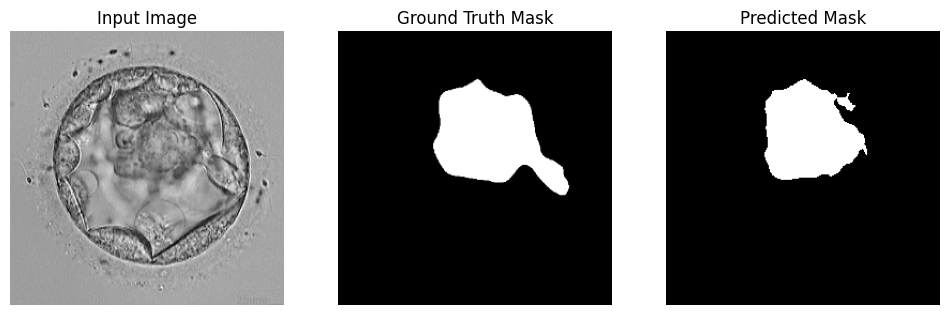

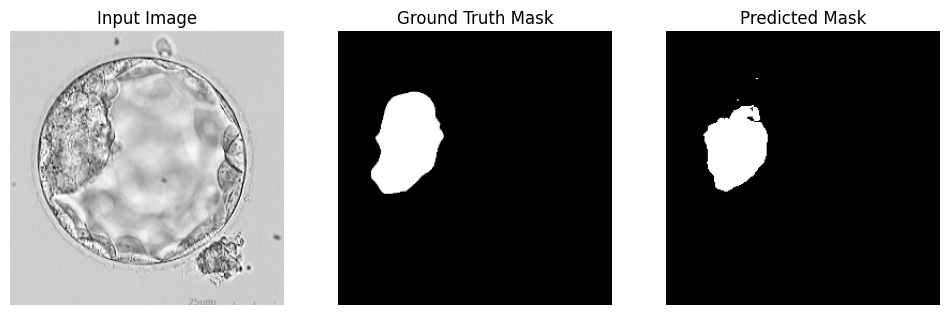

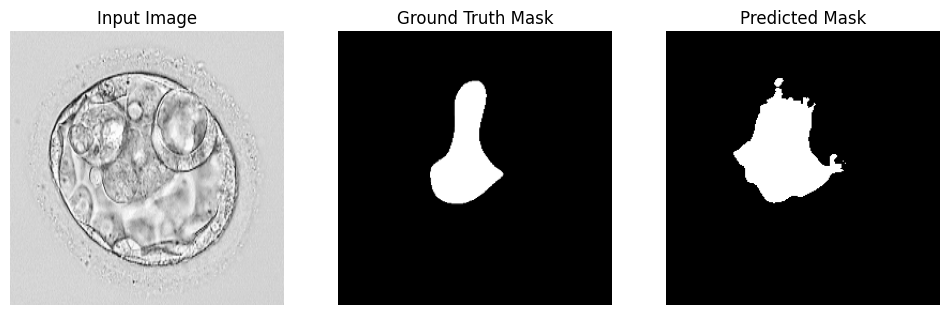

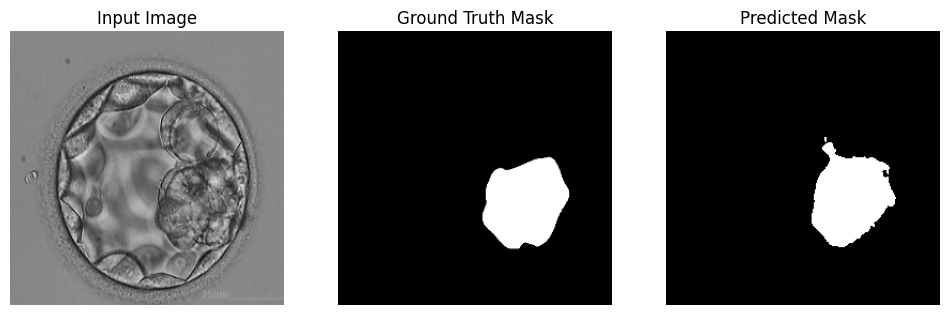

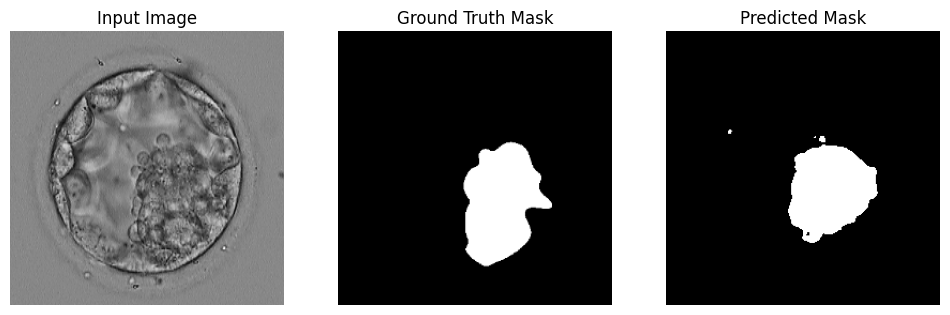

In [12]:
import matplotlib.pyplot as plt

def visualize_predictions(model, dataloader, device, num_samples=5, threshold=0.5):
    model.eval()
    images_shown = 0

    with torch.no_grad():
        for images, masks in dataloader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            for i in range(images.size(0)):
                if images_shown >= num_samples:
                    return

                image = images[i].cpu().numpy()
                image = image.transpose(1, 2, 0)
                gt_mask = masks[i].cpu().squeeze().numpy()
                pred_mask = preds[i].cpu().squeeze().numpy()

                # Threshold the predicted mask
                pred_mask_bin = (pred_mask > threshold).astype(np.uint8)

                # Plot
                plt.figure(figsize=(12, 4))

                plt.subplot(1, 3, 1)
                plt.imshow(image, cmap='gray')
                plt.title('Input Image')
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.imshow(gt_mask, cmap='gray')
                plt.title('Ground Truth Mask')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.imshow(pred_mask_bin, cmap='gray')
                plt.title('Predicted Mask')
                plt.axis('off')

                plt.show()

                images_shown += 1

visualize_predictions(model, valid_loader, DEVICE, num_samples=5)


In [13]:
def evaluate_on_test(model, test_loader, device):
    model.eval()
    dice_scores = []
    miou_scores = []
    accuracy_scores = []
    sensitivity_scores = []
    specificity_scores = []

    with torch.no_grad():
        for images, masks in test_loader:
            images, masks = images.to(device), masks.to(device)
            preds = model(images)

            dice_scores.append(dice_score(masks, preds).item())
            miou_scores.append(mean_iou(masks, preds).item())
            accuracy_scores.append(accuracy(masks, preds).item())
            sensitivity_scores.append(sensitivity(masks, preds).item())
            specificity_scores.append(specificity(masks, preds).item())

    print(f"\n🔍 Test Results:")
    print(f"Dice Score     = {np.mean(dice_scores):.4f}")
    print(f"mIoU           = {np.mean(miou_scores):.4f}")
    print(f"Accuracy       = {np.mean(accuracy_scores):.4f}")
    print(f"Sensitivity    = {np.mean(sensitivity_scores):.4f}")
    print(f"Specificity    = {np.mean(specificity_scores):.4f}")

evaluate_on_test(model, test_loader, DEVICE)



🔍 Test Results:
Dice Score     = 0.8574
mIoU           = 0.7508
Accuracy       = 0.9789
Sensitivity    = 0.8938
Specificity    = 0.9856


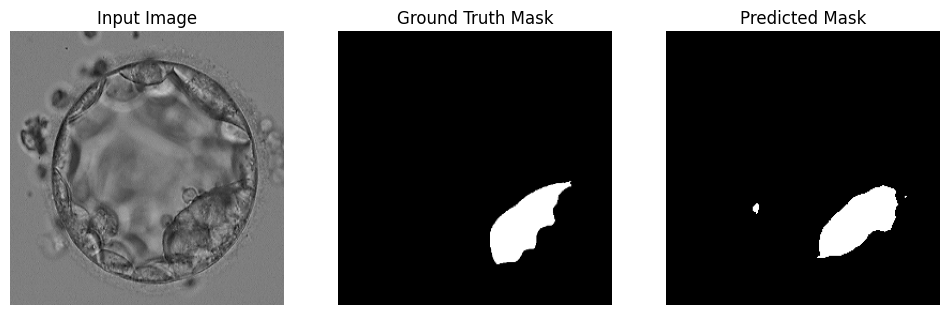

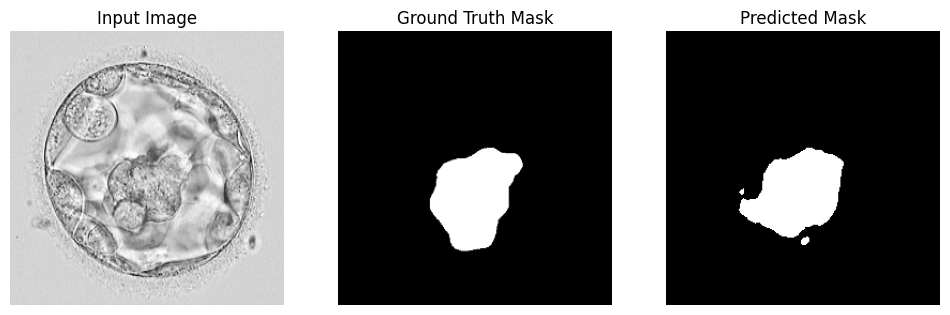

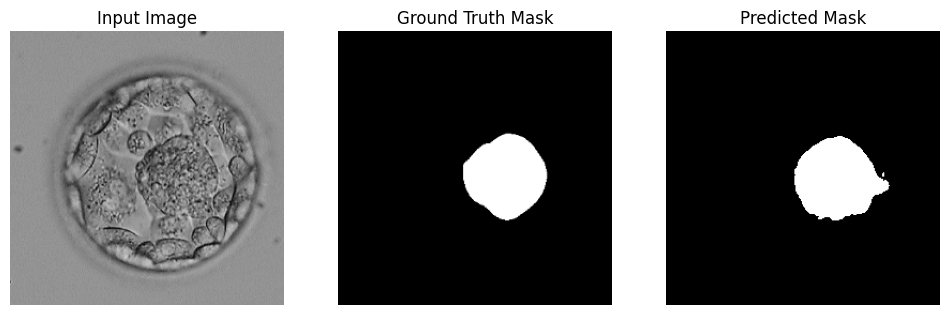

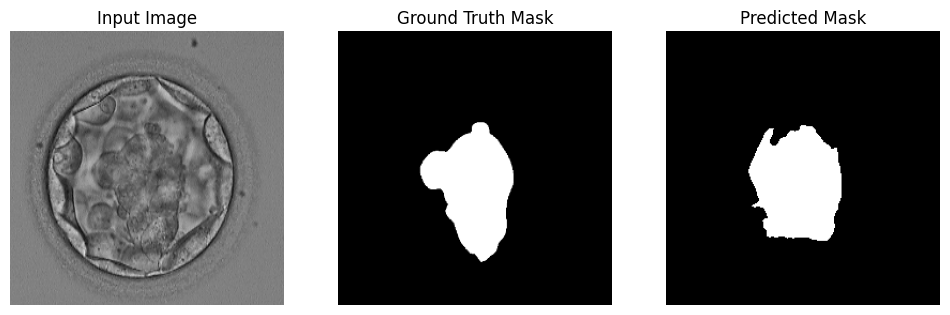

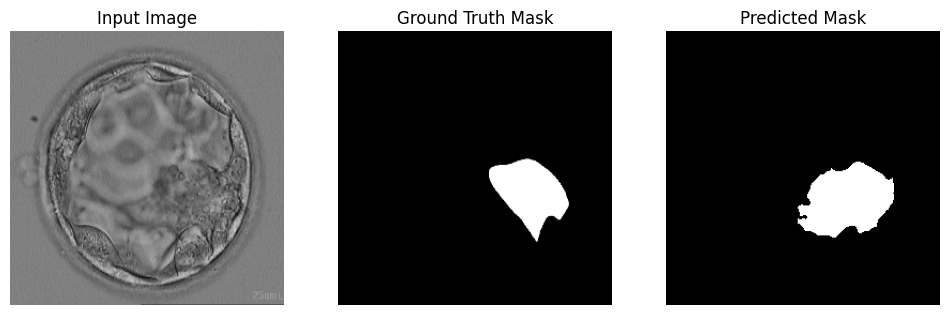

In [14]:
visualize_predictions(model, test_loader, DEVICE, num_samples=5)


In [15]:
pip install ptflops


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 27.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 88.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [16]:
from ptflops import get_model_complexity_info

# Add this right after model initialization
model = MALUNet().to(DEVICE)

# Calculate parameters and FLOPs
with torch.no_grad():
    macs, params = get_model_complexity_info(model, (3, 256, 256), as_strings=False,
                                           print_per_layer_stat=False, verbose=False)

# Convert to same units as paper (Millions and GFLOPs)
total_params = params / 1e6
total_flops = macs / 1e9

print(f"\nModel Statistics:")
print(f"Parameters: {total_params:.3f}M")
print(f"GFLOPs: {total_flops:.3f}\n")

# Add this to your training output
print(f"Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑")
print(f"{total_params:.3f} {total_flops:.3f} {np.mean(val_miou)*100:.2f} {np.mean(val_dice)*100:.2f} "
      f"{np.mean(val_accuracy)*100:.2f} {np.mean(val_specificity)*100:.2f} {np.mean(val_sensitivity)*100:.2f}")

SC_Att_Bridge was used

Model Statistics:
Parameters: 0.178M
GFLOPs: 0.090

Model Params ↓ GFLOPs↓ mIoU↑ DSC↑ Acc↑ Spe↑ Sen↑
0.178 0.090 73.46 84.66 97.41 98.84 83.06


SC_Att_Bridge was used


Epoch 1/100: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


[Epoch 1] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


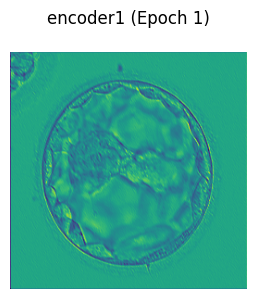

encoder2: torch.Size([3, 16, 128, 128])


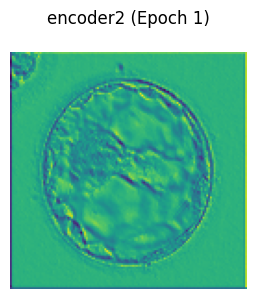

encoder3: torch.Size([3, 24, 64, 64])


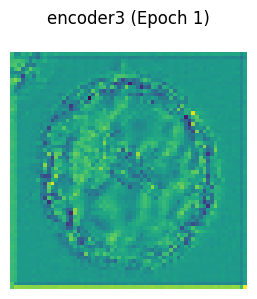

encoder4: torch.Size([3, 32, 32, 32])


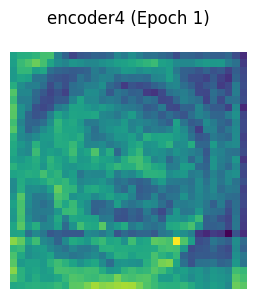

encoder5: torch.Size([3, 48, 16, 16])


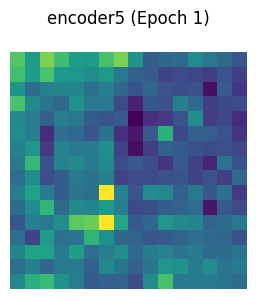

encoder6: torch.Size([3, 64, 8, 8])


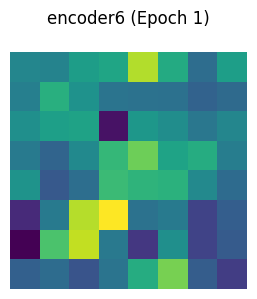

decoder1: torch.Size([3, 48, 8, 8])


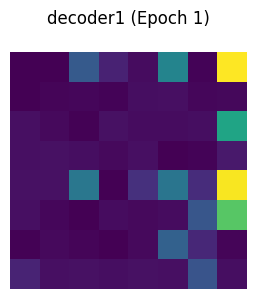

decoder2: torch.Size([3, 32, 8, 8])


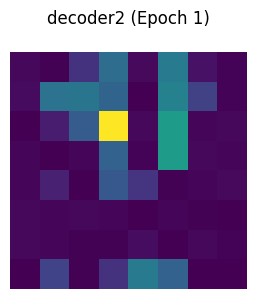

decoder3: torch.Size([3, 24, 16, 16])


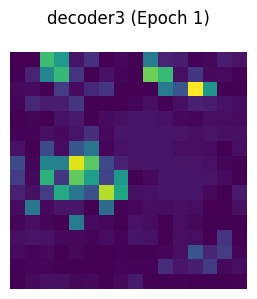

decoder4: torch.Size([3, 16, 32, 32])


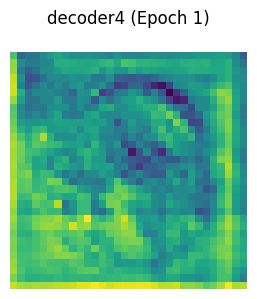

decoder5: torch.Size([3, 8, 64, 64])


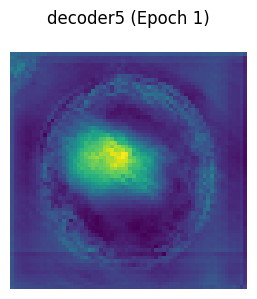

Epoch 1: Loss = 128.9824, Val Dice = 0.7965, Val mIoU = 0.6633, Val Accuracy = 0.9636, Val Sensitivity = 0.8271, Val Specificity = 0.9774


Epoch 2/100: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


[Epoch 2] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


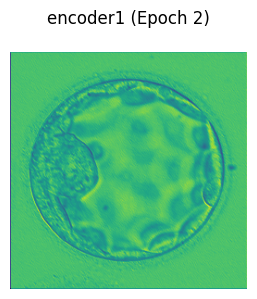

encoder2: torch.Size([3, 16, 128, 128])


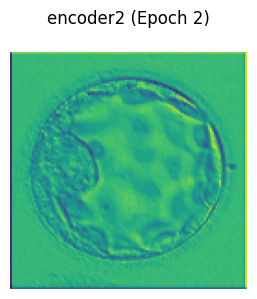

encoder3: torch.Size([3, 24, 64, 64])


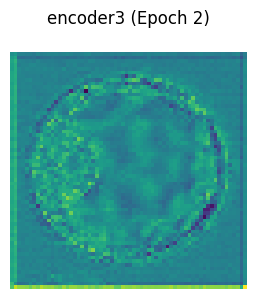

encoder4: torch.Size([3, 32, 32, 32])


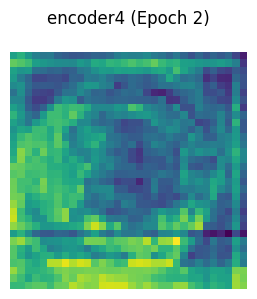

encoder5: torch.Size([3, 48, 16, 16])


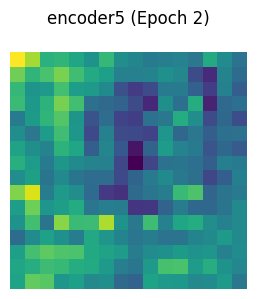

encoder6: torch.Size([3, 64, 8, 8])


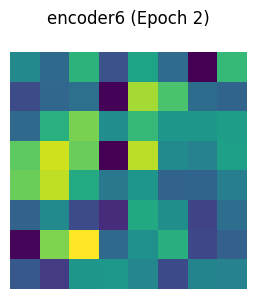

decoder1: torch.Size([3, 48, 8, 8])


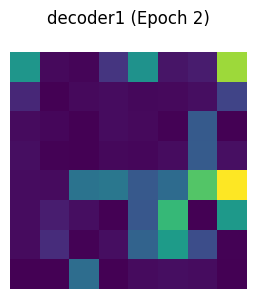

decoder2: torch.Size([3, 32, 8, 8])


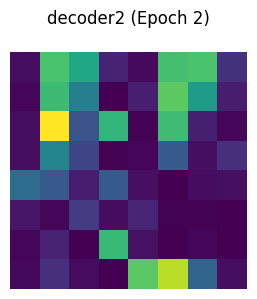

decoder3: torch.Size([3, 24, 16, 16])


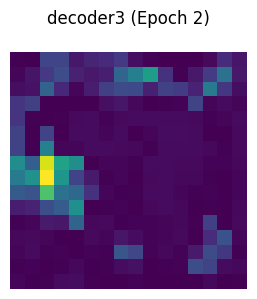

decoder4: torch.Size([3, 16, 32, 32])


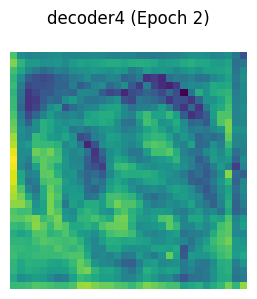

decoder5: torch.Size([3, 8, 64, 64])


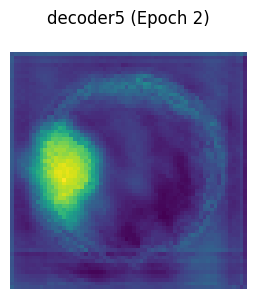

Epoch 2: Loss = 111.3229, Val Dice = 0.8162, Val mIoU = 0.6909, Val Accuracy = 0.9683, Val Sensitivity = 0.8122, Val Specificity = 0.9840


Epoch 3/100: 100%|██████████| 125/125 [01:29<00:00,  1.39it/s]


[Epoch 3] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


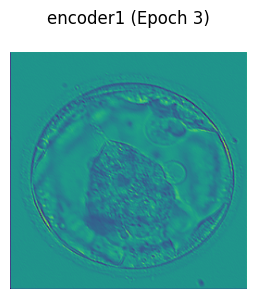

encoder2: torch.Size([3, 16, 128, 128])


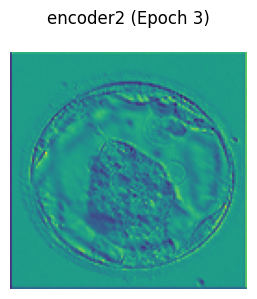

encoder3: torch.Size([3, 24, 64, 64])


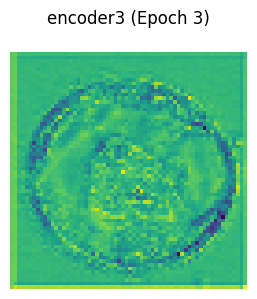

encoder4: torch.Size([3, 32, 32, 32])


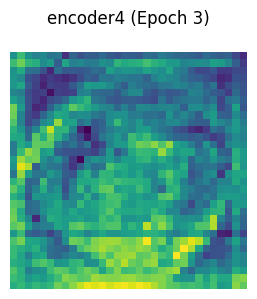

encoder5: torch.Size([3, 48, 16, 16])


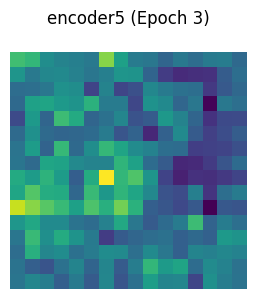

encoder6: torch.Size([3, 64, 8, 8])


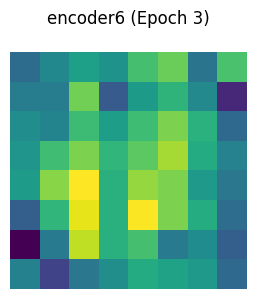

decoder1: torch.Size([3, 48, 8, 8])


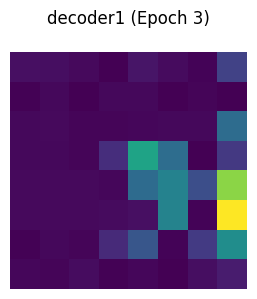

decoder2: torch.Size([3, 32, 8, 8])


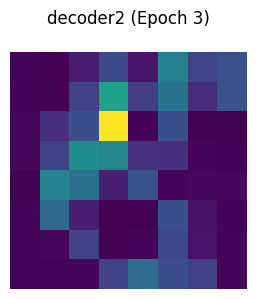

decoder3: torch.Size([3, 24, 16, 16])


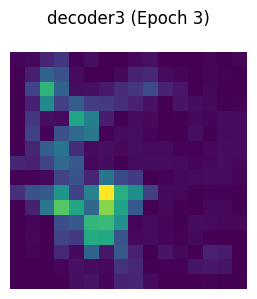

decoder4: torch.Size([3, 16, 32, 32])


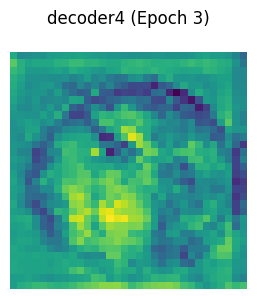

decoder5: torch.Size([3, 8, 64, 64])


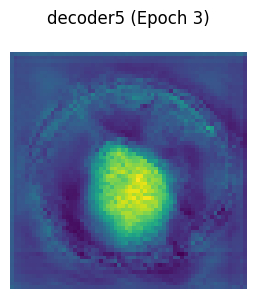

Epoch 3: Loss = 108.3161, Val Dice = 0.8244, Val mIoU = 0.7019, Val Accuracy = 0.9700, Val Sensitivity = 0.8150, Val Specificity = 0.9857


Epoch 4/100: 100%|██████████| 125/125 [01:30<00:00,  1.37it/s]


[Epoch 4] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


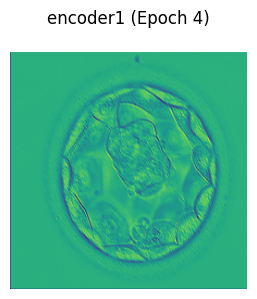

encoder2: torch.Size([3, 16, 128, 128])


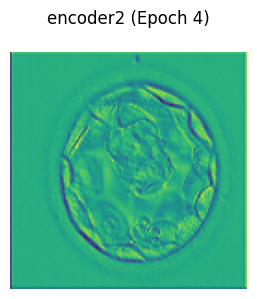

encoder3: torch.Size([3, 24, 64, 64])


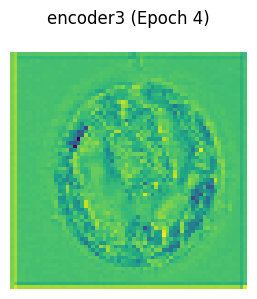

encoder4: torch.Size([3, 32, 32, 32])


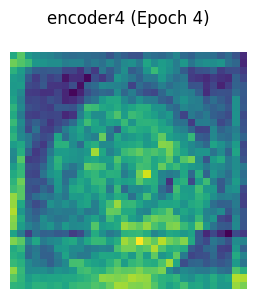

encoder5: torch.Size([3, 48, 16, 16])


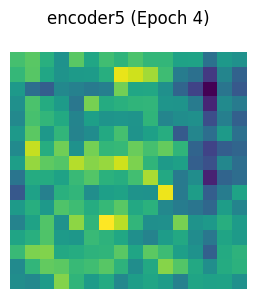

encoder6: torch.Size([3, 64, 8, 8])


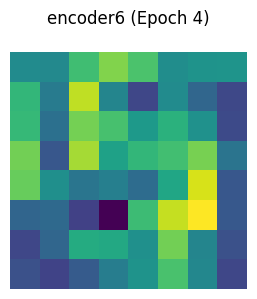

decoder1: torch.Size([3, 48, 8, 8])


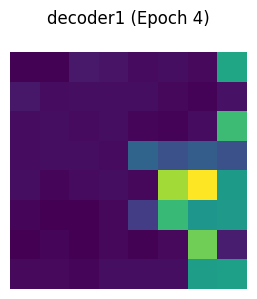

decoder2: torch.Size([3, 32, 8, 8])


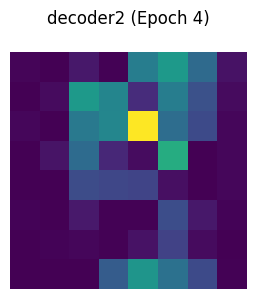

decoder3: torch.Size([3, 24, 16, 16])


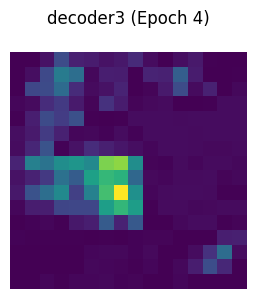

decoder4: torch.Size([3, 16, 32, 32])


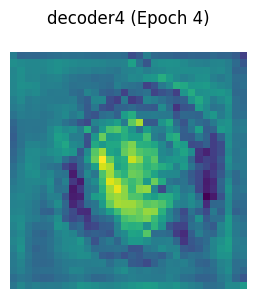

decoder5: torch.Size([3, 8, 64, 64])


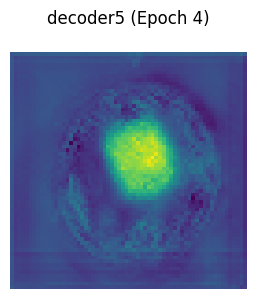

Epoch 4: Loss = 106.9487, Val Dice = 0.8351, Val mIoU = 0.7183, Val Accuracy = 0.9706, Val Sensitivity = 0.8644, Val Specificity = 0.9815


Epoch 5/100: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


[Epoch 5] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


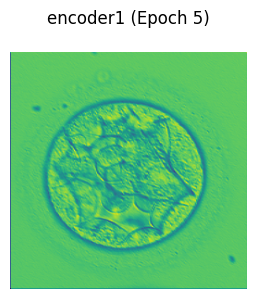

encoder2: torch.Size([3, 16, 128, 128])


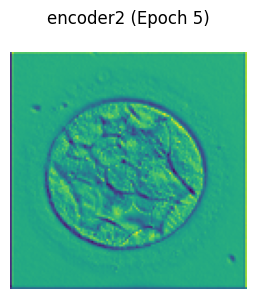

encoder3: torch.Size([3, 24, 64, 64])


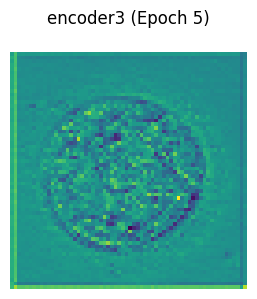

encoder4: torch.Size([3, 32, 32, 32])


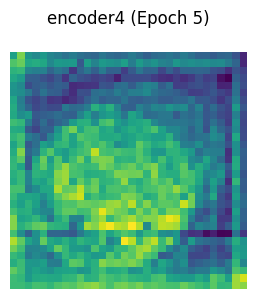

encoder5: torch.Size([3, 48, 16, 16])


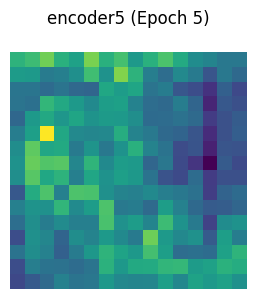

encoder6: torch.Size([3, 64, 8, 8])


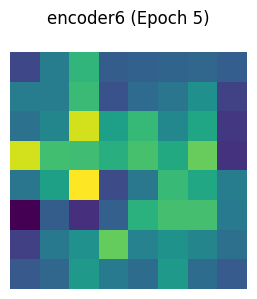

decoder1: torch.Size([3, 48, 8, 8])


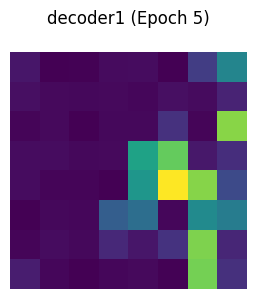

decoder2: torch.Size([3, 32, 8, 8])


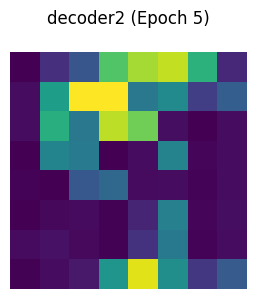

decoder3: torch.Size([3, 24, 16, 16])


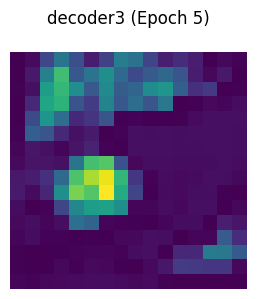

decoder4: torch.Size([3, 16, 32, 32])


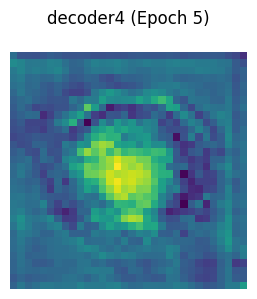

decoder5: torch.Size([3, 8, 64, 64])


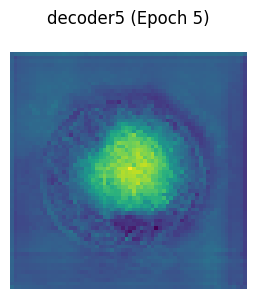

Epoch 5: Loss = 105.8023, Val Dice = 0.8312, Val mIoU = 0.7121, Val Accuracy = 0.9717, Val Sensitivity = 0.8083, Val Specificity = 0.9878


Epoch 6/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 6] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


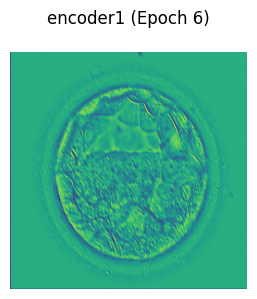

encoder2: torch.Size([3, 16, 128, 128])


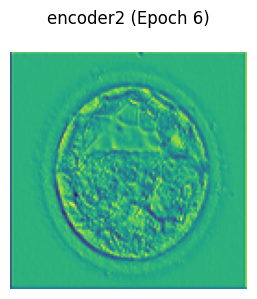

encoder3: torch.Size([3, 24, 64, 64])


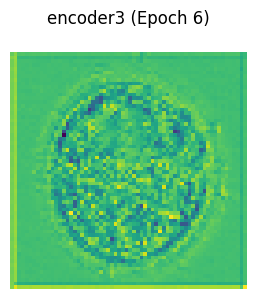

encoder4: torch.Size([3, 32, 32, 32])


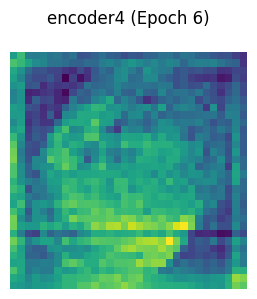

encoder5: torch.Size([3, 48, 16, 16])


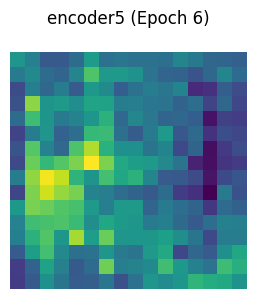

encoder6: torch.Size([3, 64, 8, 8])


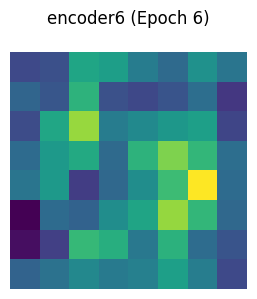

decoder1: torch.Size([3, 48, 8, 8])


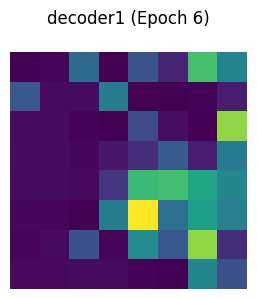

decoder2: torch.Size([3, 32, 8, 8])


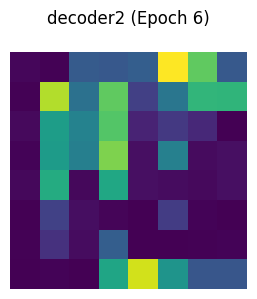

decoder3: torch.Size([3, 24, 16, 16])


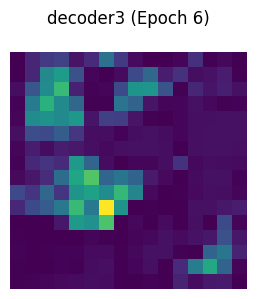

decoder4: torch.Size([3, 16, 32, 32])


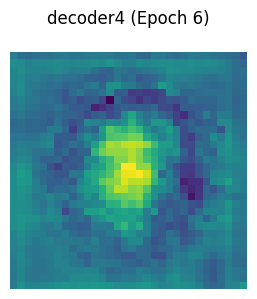

decoder5: torch.Size([3, 8, 64, 64])


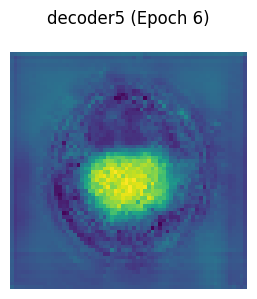

Epoch 6: Loss = 104.6479, Val Dice = 0.8303, Val mIoU = 0.7113, Val Accuracy = 0.9716, Val Sensitivity = 0.8073, Val Specificity = 0.9876


Epoch 7/100: 100%|██████████| 125/125 [01:30<00:00,  1.39it/s]


[Epoch 7] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


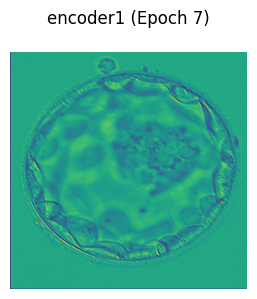

encoder2: torch.Size([3, 16, 128, 128])


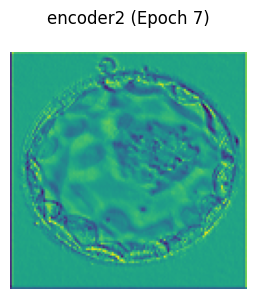

encoder3: torch.Size([3, 24, 64, 64])


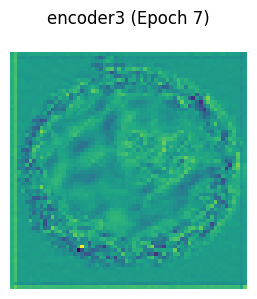

encoder4: torch.Size([3, 32, 32, 32])


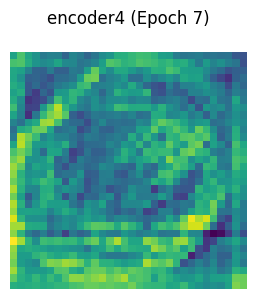

encoder5: torch.Size([3, 48, 16, 16])


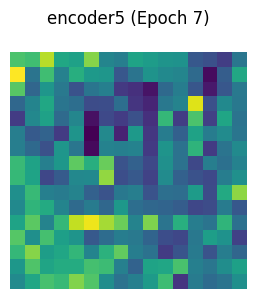

encoder6: torch.Size([3, 64, 8, 8])


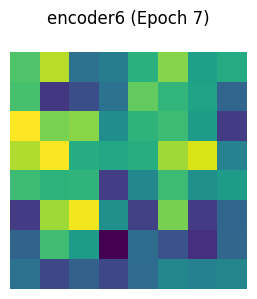

decoder1: torch.Size([3, 48, 8, 8])


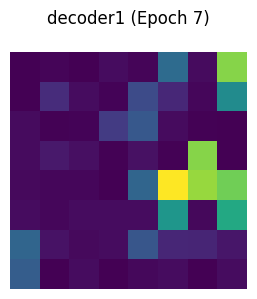

decoder2: torch.Size([3, 32, 8, 8])


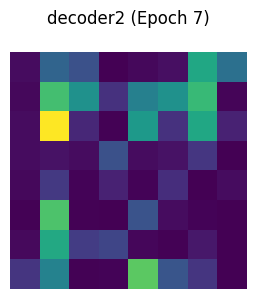

decoder3: torch.Size([3, 24, 16, 16])


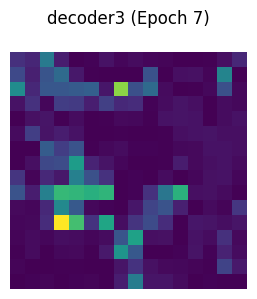

decoder4: torch.Size([3, 16, 32, 32])


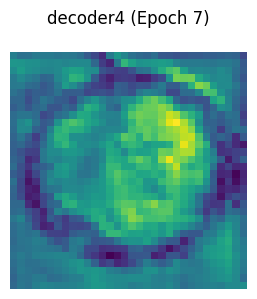

decoder5: torch.Size([3, 8, 64, 64])


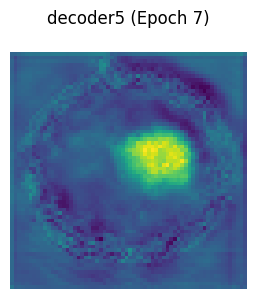

Epoch 7: Loss = 104.0649, Val Dice = 0.8375, Val mIoU = 0.7214, Val Accuracy = 0.9725, Val Sensitivity = 0.8254, Val Specificity = 0.9870


Epoch 8/100: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


[Epoch 8] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


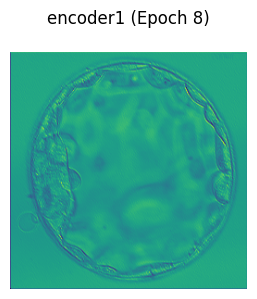

encoder2: torch.Size([3, 16, 128, 128])


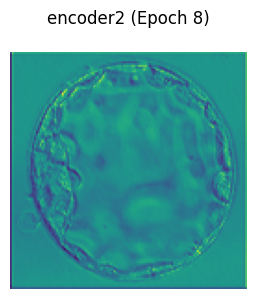

encoder3: torch.Size([3, 24, 64, 64])


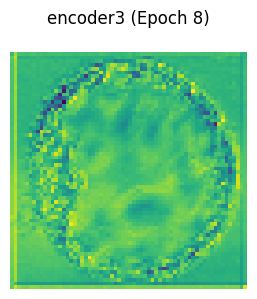

encoder4: torch.Size([3, 32, 32, 32])


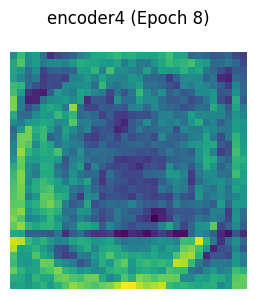

encoder5: torch.Size([3, 48, 16, 16])


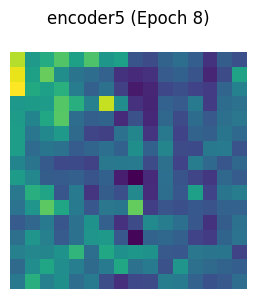

encoder6: torch.Size([3, 64, 8, 8])


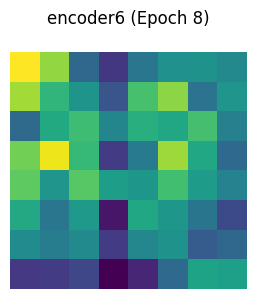

decoder1: torch.Size([3, 48, 8, 8])


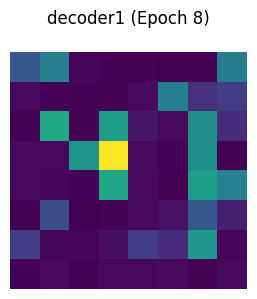

decoder2: torch.Size([3, 32, 8, 8])


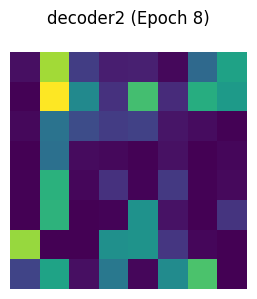

decoder3: torch.Size([3, 24, 16, 16])


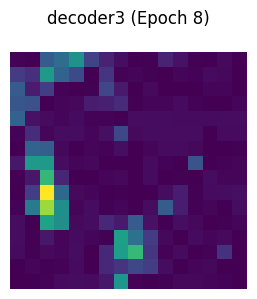

decoder4: torch.Size([3, 16, 32, 32])


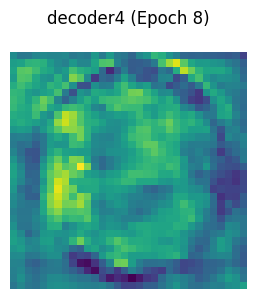

decoder5: torch.Size([3, 8, 64, 64])


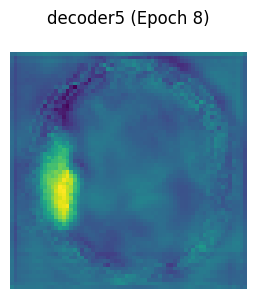

Epoch 8: Loss = 103.3099, Val Dice = 0.8326, Val mIoU = 0.7140, Val Accuracy = 0.9725, Val Sensitivity = 0.7943, Val Specificity = 0.9898


Epoch 9/100: 100%|██████████| 125/125 [01:30<00:00,  1.38it/s]


[Epoch 9] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


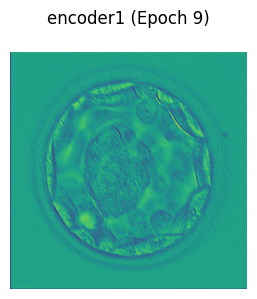

encoder2: torch.Size([3, 16, 128, 128])


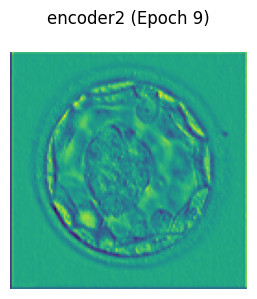

encoder3: torch.Size([3, 24, 64, 64])


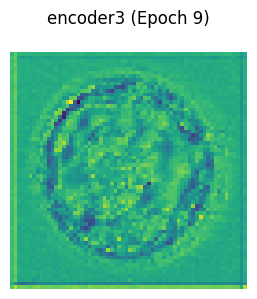

encoder4: torch.Size([3, 32, 32, 32])


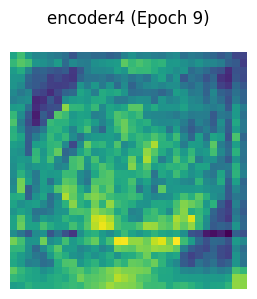

encoder5: torch.Size([3, 48, 16, 16])


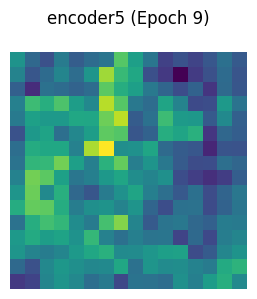

encoder6: torch.Size([3, 64, 8, 8])


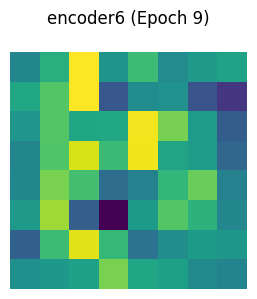

decoder1: torch.Size([3, 48, 8, 8])


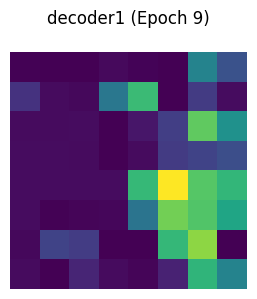

decoder2: torch.Size([3, 32, 8, 8])


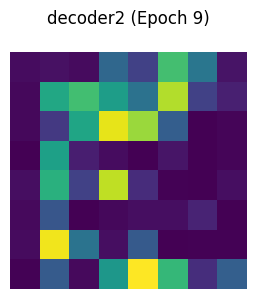

decoder3: torch.Size([3, 24, 16, 16])


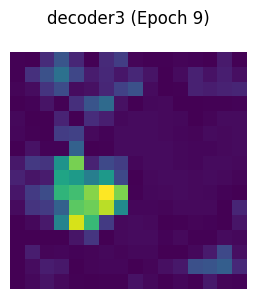

decoder4: torch.Size([3, 16, 32, 32])


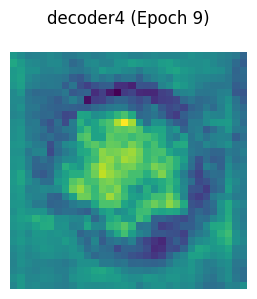

decoder5: torch.Size([3, 8, 64, 64])


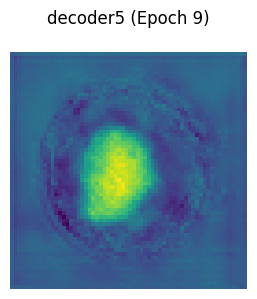

Epoch 9: Loss = 103.0555, Val Dice = 0.8407, Val mIoU = 0.7265, Val Accuracy = 0.9728, Val Sensitivity = 0.8331, Val Specificity = 0.9866


Epoch 10/100: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


[Epoch 10] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


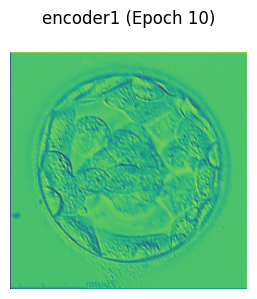

encoder2: torch.Size([3, 16, 128, 128])


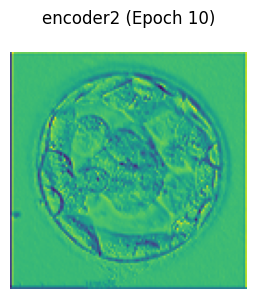

encoder3: torch.Size([3, 24, 64, 64])


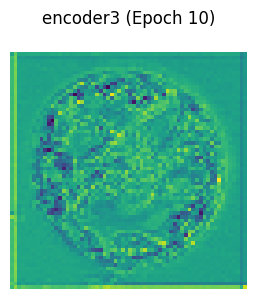

encoder4: torch.Size([3, 32, 32, 32])


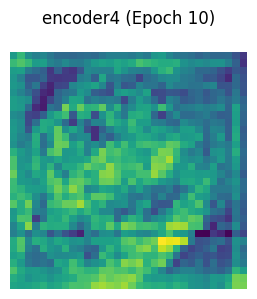

encoder5: torch.Size([3, 48, 16, 16])


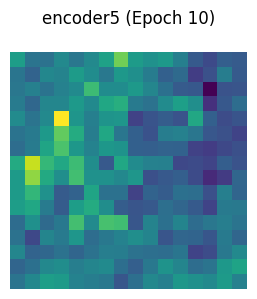

encoder6: torch.Size([3, 64, 8, 8])


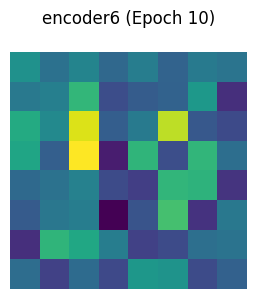

decoder1: torch.Size([3, 48, 8, 8])


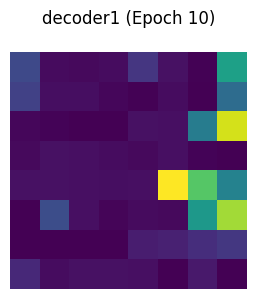

decoder2: torch.Size([3, 32, 8, 8])


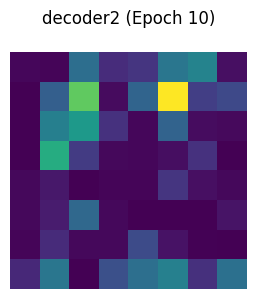

decoder3: torch.Size([3, 24, 16, 16])


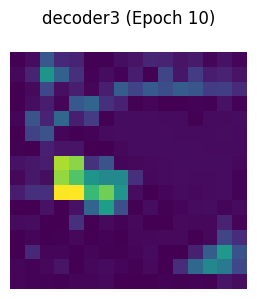

decoder4: torch.Size([3, 16, 32, 32])


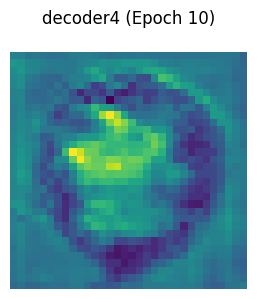

decoder5: torch.Size([3, 8, 64, 64])


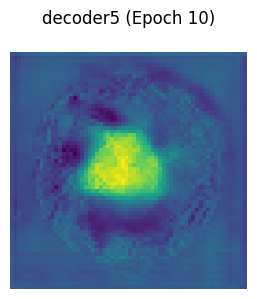

Epoch 10: Loss = 101.7842, Val Dice = 0.8330, Val mIoU = 0.7149, Val Accuracy = 0.9717, Val Sensitivity = 0.8229, Val Specificity = 0.9862


Epoch 11/100: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


[Epoch 11] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


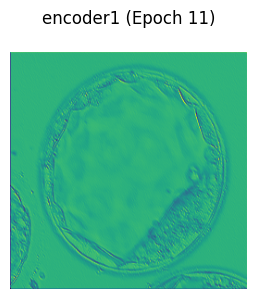

encoder2: torch.Size([3, 16, 128, 128])


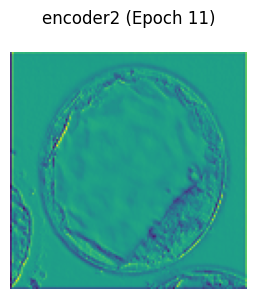

encoder3: torch.Size([3, 24, 64, 64])


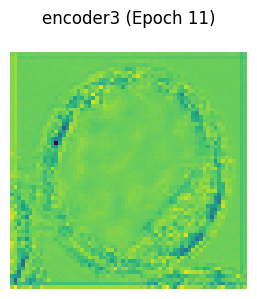

encoder4: torch.Size([3, 32, 32, 32])


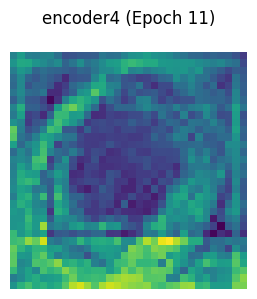

encoder5: torch.Size([3, 48, 16, 16])


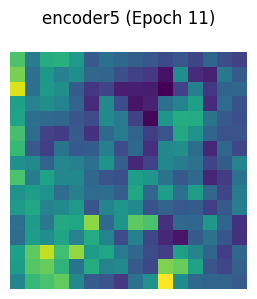

encoder6: torch.Size([3, 64, 8, 8])


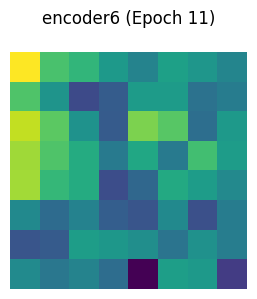

decoder1: torch.Size([3, 48, 8, 8])


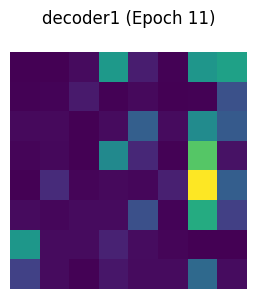

decoder2: torch.Size([3, 32, 8, 8])


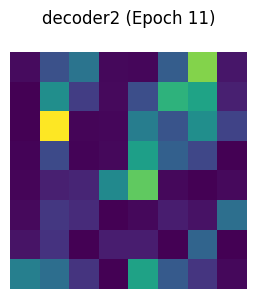

decoder3: torch.Size([3, 24, 16, 16])


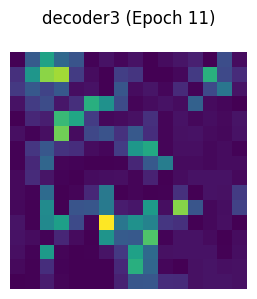

decoder4: torch.Size([3, 16, 32, 32])


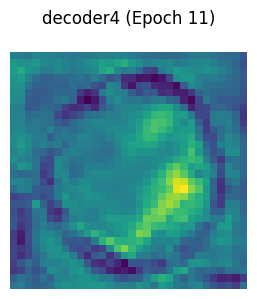

decoder5: torch.Size([3, 8, 64, 64])


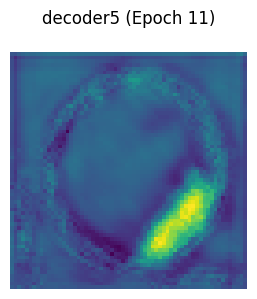

Epoch 11: Loss = 101.1937, Val Dice = 0.8333, Val mIoU = 0.7158, Val Accuracy = 0.9701, Val Sensitivity = 0.8732, Val Specificity = 0.9798


Epoch 12/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 12] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


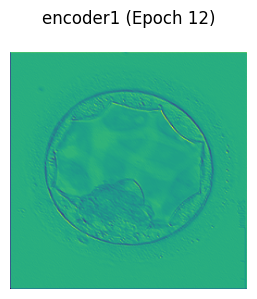

encoder2: torch.Size([3, 16, 128, 128])


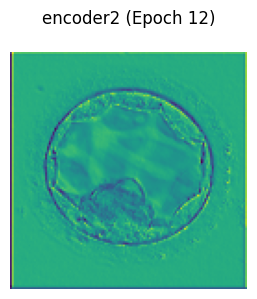

encoder3: torch.Size([3, 24, 64, 64])


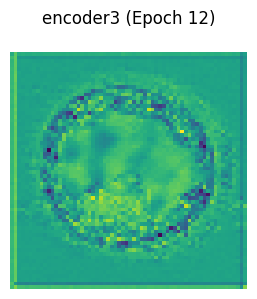

encoder4: torch.Size([3, 32, 32, 32])


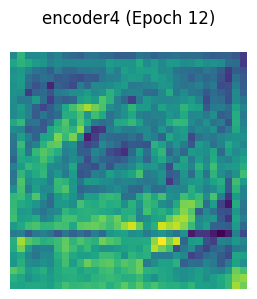

encoder5: torch.Size([3, 48, 16, 16])


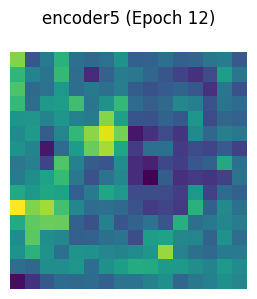

encoder6: torch.Size([3, 64, 8, 8])


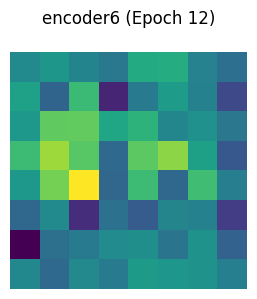

decoder1: torch.Size([3, 48, 8, 8])


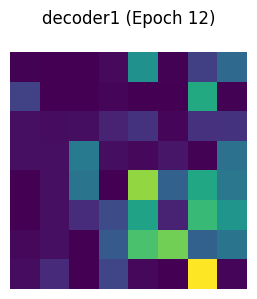

decoder2: torch.Size([3, 32, 8, 8])


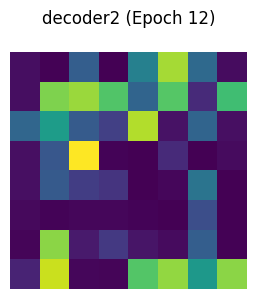

decoder3: torch.Size([3, 24, 16, 16])


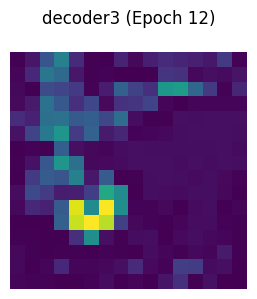

decoder4: torch.Size([3, 16, 32, 32])


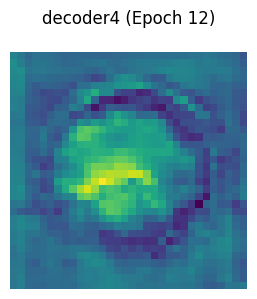

decoder5: torch.Size([3, 8, 64, 64])


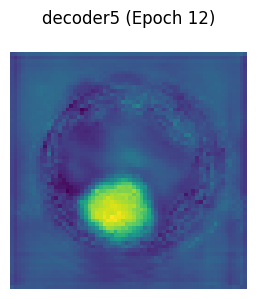

Epoch 12: Loss = 100.4919, Val Dice = 0.8555, Val mIoU = 0.7500, Val Accuracy = 0.9751, Val Sensitivity = 0.8631, Val Specificity = 0.9860


Epoch 13/100: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


[Epoch 13] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


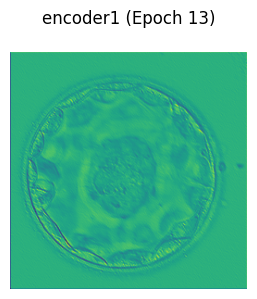

encoder2: torch.Size([3, 16, 128, 128])


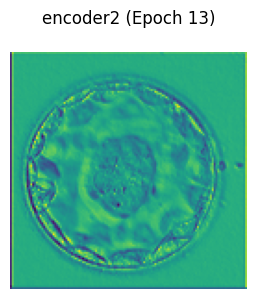

encoder3: torch.Size([3, 24, 64, 64])


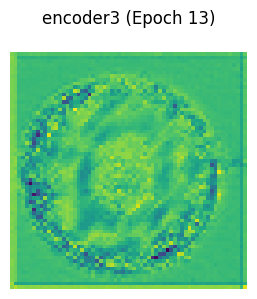

encoder4: torch.Size([3, 32, 32, 32])


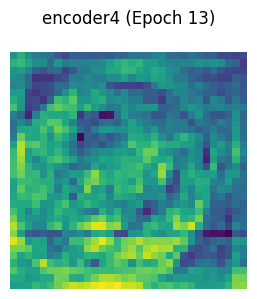

encoder5: torch.Size([3, 48, 16, 16])


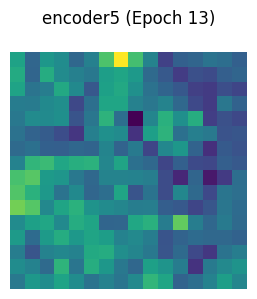

encoder6: torch.Size([3, 64, 8, 8])


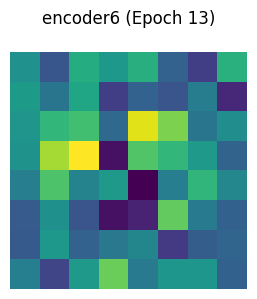

decoder1: torch.Size([3, 48, 8, 8])


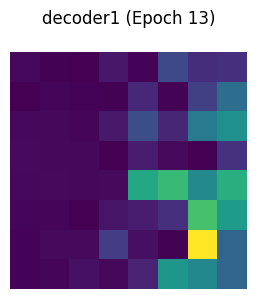

decoder2: torch.Size([3, 32, 8, 8])


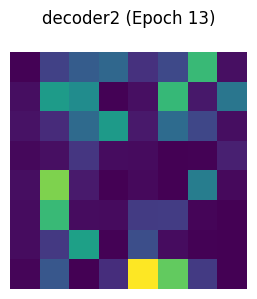

decoder3: torch.Size([3, 24, 16, 16])


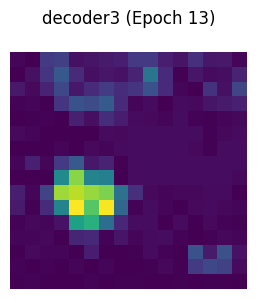

decoder4: torch.Size([3, 16, 32, 32])


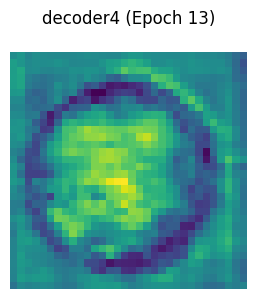

decoder5: torch.Size([3, 8, 64, 64])


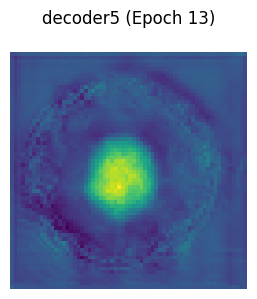

Epoch 13: Loss = 99.5952, Val Dice = 0.8419, Val mIoU = 0.7280, Val Accuracy = 0.9733, Val Sensitivity = 0.8277, Val Specificity = 0.9877


Epoch 14/100: 100%|██████████| 125/125 [01:32<00:00,  1.36it/s]


[Epoch 14] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


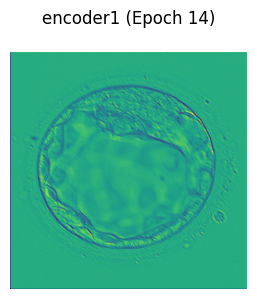

encoder2: torch.Size([3, 16, 128, 128])


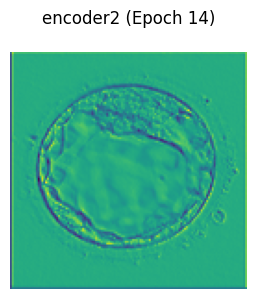

encoder3: torch.Size([3, 24, 64, 64])


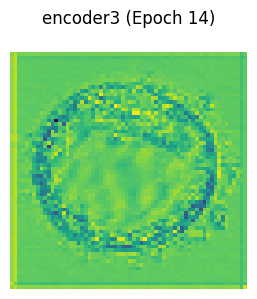

encoder4: torch.Size([3, 32, 32, 32])


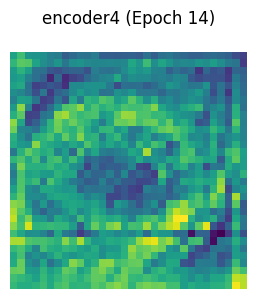

encoder5: torch.Size([3, 48, 16, 16])


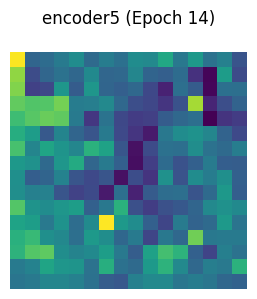

encoder6: torch.Size([3, 64, 8, 8])


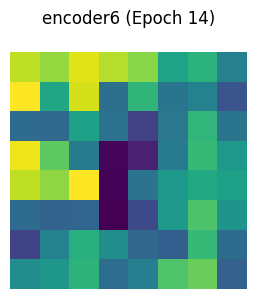

decoder1: torch.Size([3, 48, 8, 8])


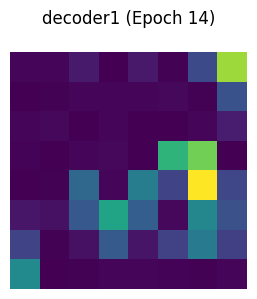

decoder2: torch.Size([3, 32, 8, 8])


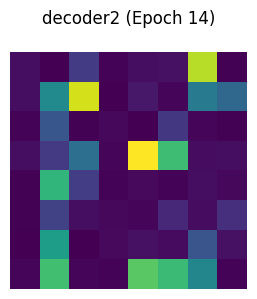

decoder3: torch.Size([3, 24, 16, 16])


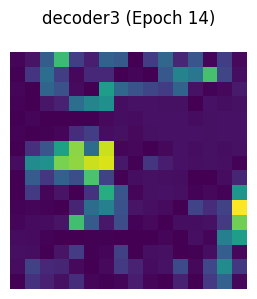

decoder4: torch.Size([3, 16, 32, 32])


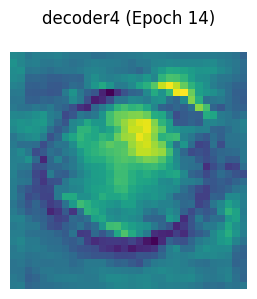

decoder5: torch.Size([3, 8, 64, 64])


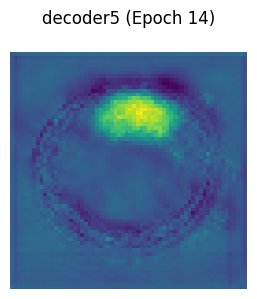

Epoch 14: Loss = 99.3623, Val Dice = 0.8364, Val mIoU = 0.7197, Val Accuracy = 0.9723, Val Sensitivity = 0.8251, Val Specificity = 0.9869


Epoch 15/100: 100%|██████████| 125/125 [01:31<00:00,  1.37it/s]


[Epoch 15] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


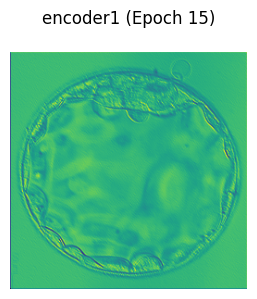

encoder2: torch.Size([3, 16, 128, 128])


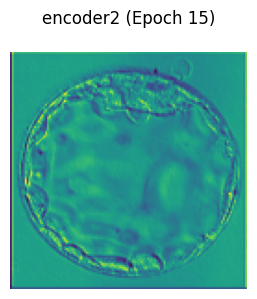

encoder3: torch.Size([3, 24, 64, 64])


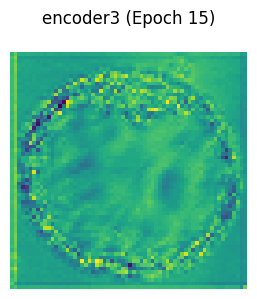

encoder4: torch.Size([3, 32, 32, 32])


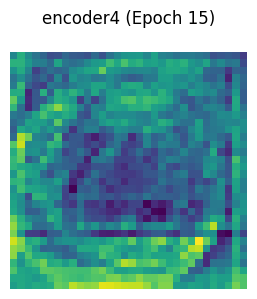

encoder5: torch.Size([3, 48, 16, 16])


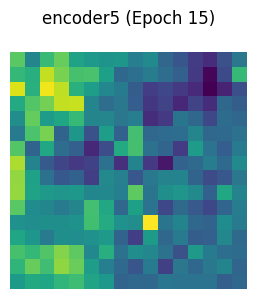

encoder6: torch.Size([3, 64, 8, 8])


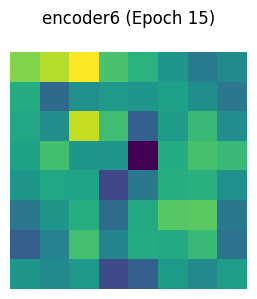

decoder1: torch.Size([3, 48, 8, 8])


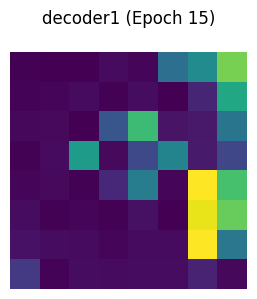

decoder2: torch.Size([3, 32, 8, 8])


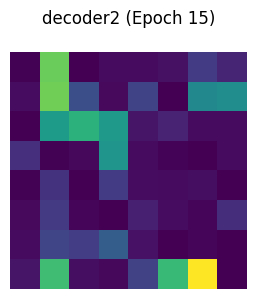

decoder3: torch.Size([3, 24, 16, 16])


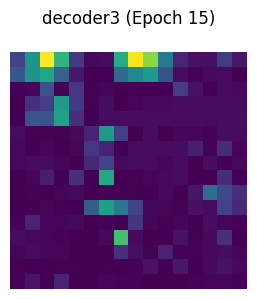

decoder4: torch.Size([3, 16, 32, 32])


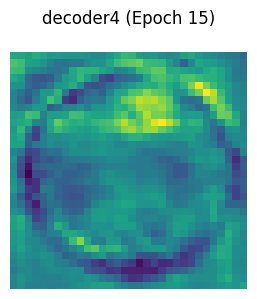

decoder5: torch.Size([3, 8, 64, 64])


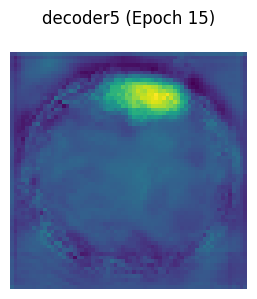

Epoch 15: Loss = 98.4831, Val Dice = 0.8441, Val mIoU = 0.7319, Val Accuracy = 0.9737, Val Sensitivity = 0.8340, Val Specificity = 0.9872


Epoch 16/100: 100%|██████████| 125/125 [01:31<00:00,  1.36it/s]


[Epoch 16] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


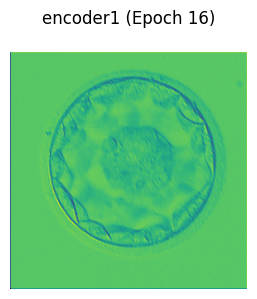

encoder2: torch.Size([3, 16, 128, 128])


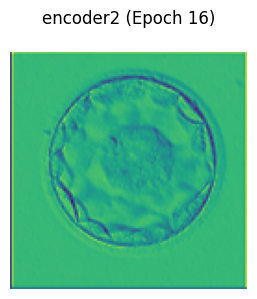

encoder3: torch.Size([3, 24, 64, 64])


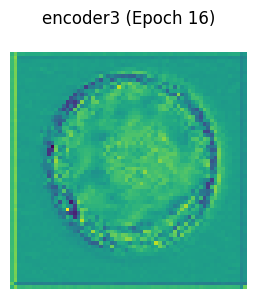

encoder4: torch.Size([3, 32, 32, 32])


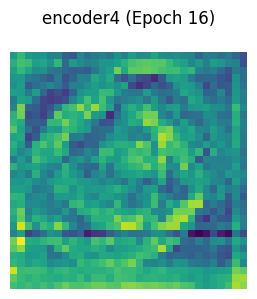

encoder5: torch.Size([3, 48, 16, 16])


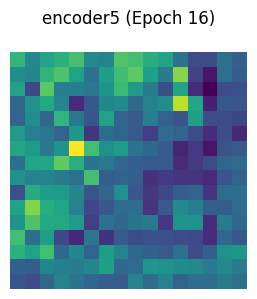

encoder6: torch.Size([3, 64, 8, 8])


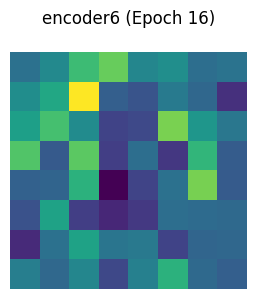

decoder1: torch.Size([3, 48, 8, 8])


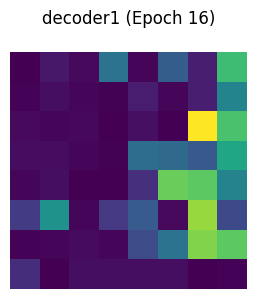

decoder2: torch.Size([3, 32, 8, 8])


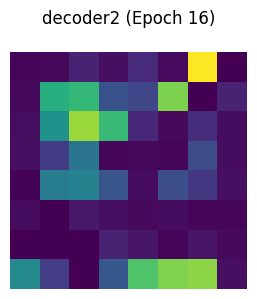

decoder3: torch.Size([3, 24, 16, 16])


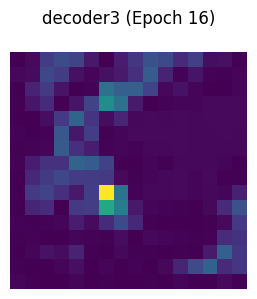

decoder4: torch.Size([3, 16, 32, 32])


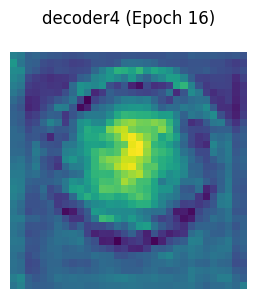

decoder5: torch.Size([3, 8, 64, 64])


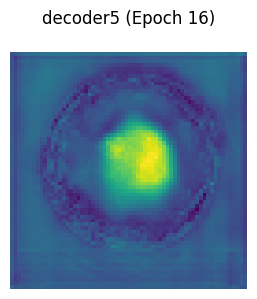

Epoch 16: Loss = 97.8825, Val Dice = 0.8351, Val mIoU = 0.7184, Val Accuracy = 0.9726, Val Sensitivity = 0.8150, Val Specificity = 0.9877


Epoch 17/100: 100%|██████████| 125/125 [01:32<00:00,  1.35it/s]


[Epoch 17] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


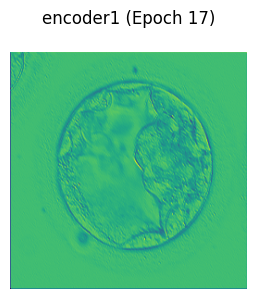

encoder2: torch.Size([3, 16, 128, 128])


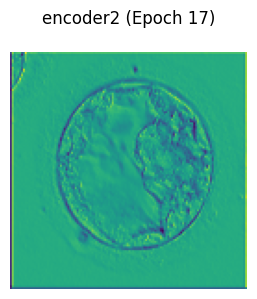

encoder3: torch.Size([3, 24, 64, 64])


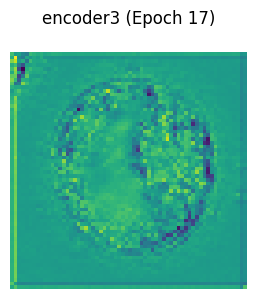

encoder4: torch.Size([3, 32, 32, 32])


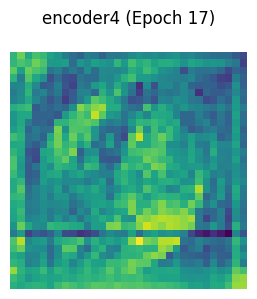

encoder5: torch.Size([3, 48, 16, 16])


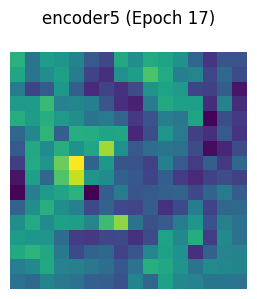

encoder6: torch.Size([3, 64, 8, 8])


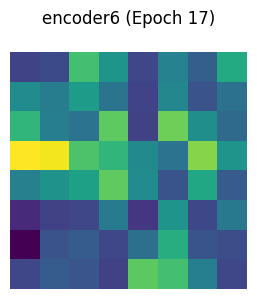

decoder1: torch.Size([3, 48, 8, 8])


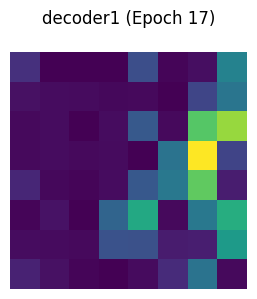

decoder2: torch.Size([3, 32, 8, 8])


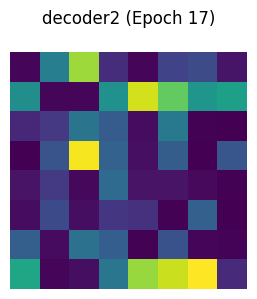

decoder3: torch.Size([3, 24, 16, 16])


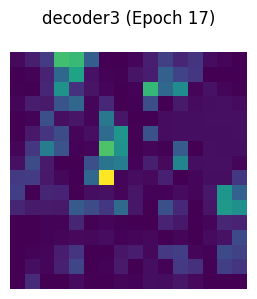

decoder4: torch.Size([3, 16, 32, 32])


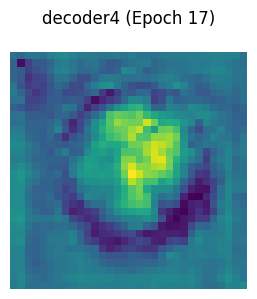

decoder5: torch.Size([3, 8, 64, 64])


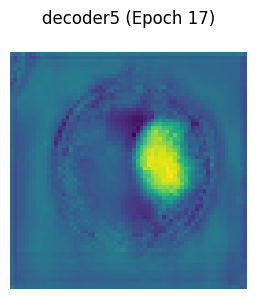

Epoch 17: Loss = 96.9603, Val Dice = 0.8453, Val mIoU = 0.7335, Val Accuracy = 0.9738, Val Sensitivity = 0.8375, Val Specificity = 0.9870


Epoch 18/100: 100%|██████████| 125/125 [01:32<00:00,  1.36it/s]


[Epoch 18] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


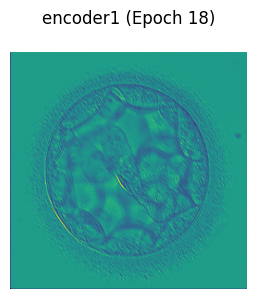

encoder2: torch.Size([3, 16, 128, 128])


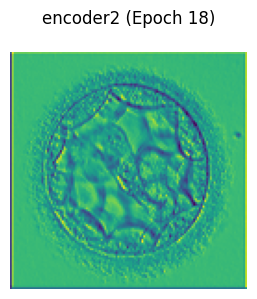

encoder3: torch.Size([3, 24, 64, 64])


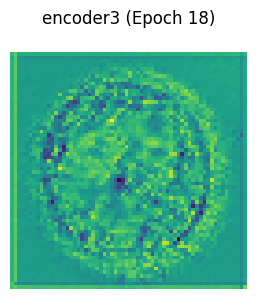

encoder4: torch.Size([3, 32, 32, 32])


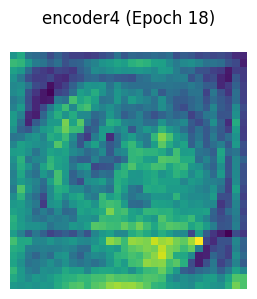

encoder5: torch.Size([3, 48, 16, 16])


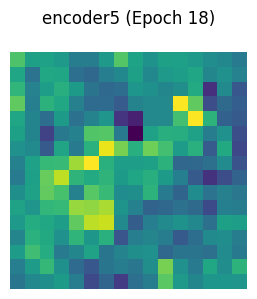

encoder6: torch.Size([3, 64, 8, 8])


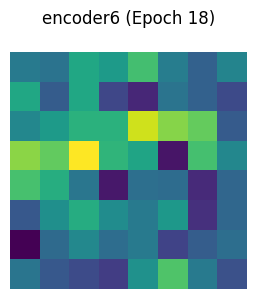

decoder1: torch.Size([3, 48, 8, 8])


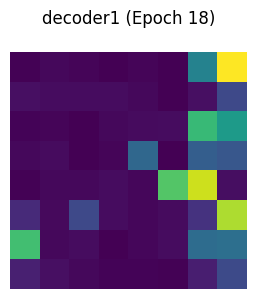

decoder2: torch.Size([3, 32, 8, 8])


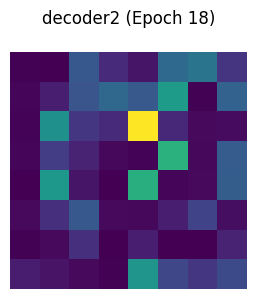

decoder3: torch.Size([3, 24, 16, 16])


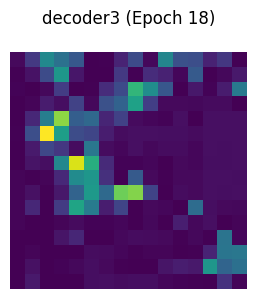

decoder4: torch.Size([3, 16, 32, 32])


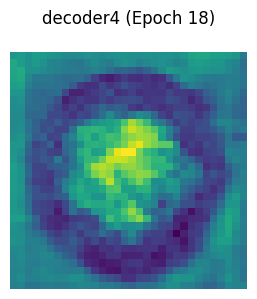

decoder5: torch.Size([3, 8, 64, 64])


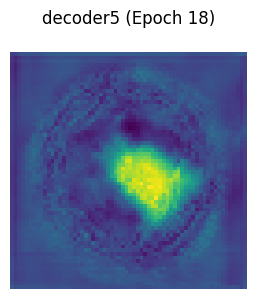

Epoch 18: Loss = 96.4731, Val Dice = 0.8379, Val mIoU = 0.7231, Val Accuracy = 0.9724, Val Sensitivity = 0.8355, Val Specificity = 0.9857


Epoch 19/100: 100%|██████████| 125/125 [01:38<00:00,  1.28it/s]


[Epoch 19] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


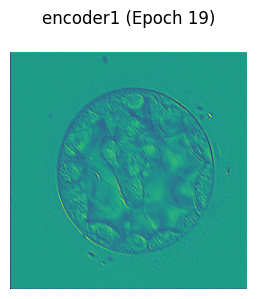

encoder2: torch.Size([3, 16, 128, 128])


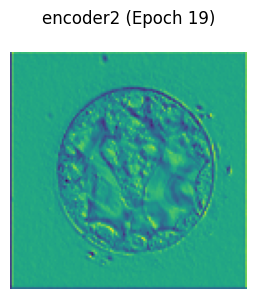

encoder3: torch.Size([3, 24, 64, 64])


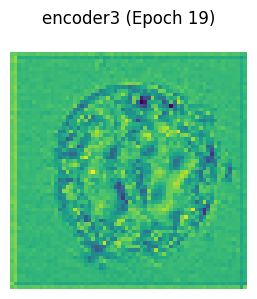

encoder4: torch.Size([3, 32, 32, 32])


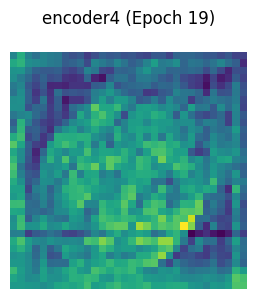

encoder5: torch.Size([3, 48, 16, 16])


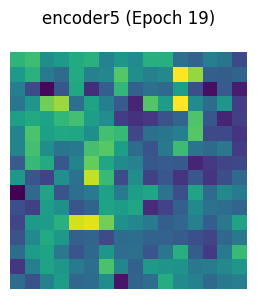

encoder6: torch.Size([3, 64, 8, 8])


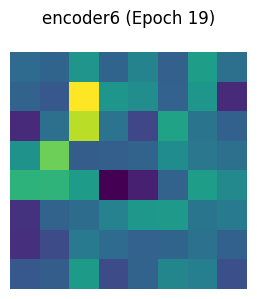

decoder1: torch.Size([3, 48, 8, 8])


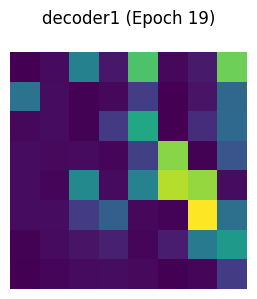

decoder2: torch.Size([3, 32, 8, 8])


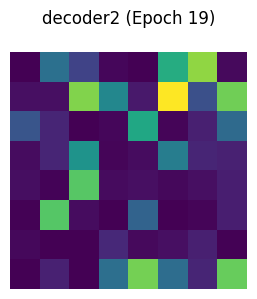

decoder3: torch.Size([3, 24, 16, 16])


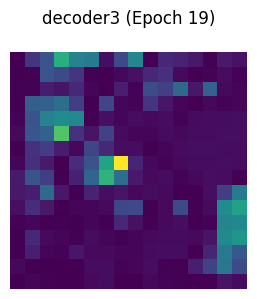

decoder4: torch.Size([3, 16, 32, 32])


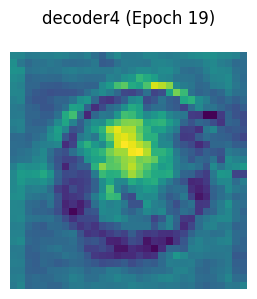

decoder5: torch.Size([3, 8, 64, 64])


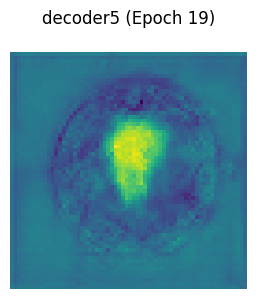

Epoch 19: Loss = 96.0051, Val Dice = 0.8363, Val mIoU = 0.7209, Val Accuracy = 0.9725, Val Sensitivity = 0.8220, Val Specificity = 0.9870


Epoch 20/100: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


[Epoch 20] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


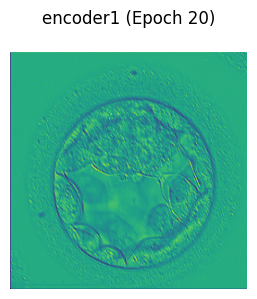

encoder2: torch.Size([3, 16, 128, 128])


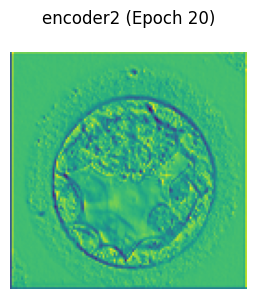

encoder3: torch.Size([3, 24, 64, 64])


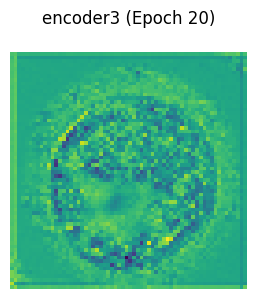

encoder4: torch.Size([3, 32, 32, 32])


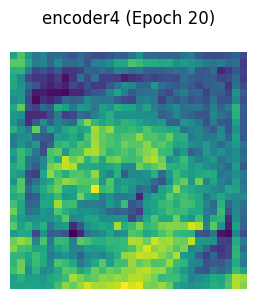

encoder5: torch.Size([3, 48, 16, 16])


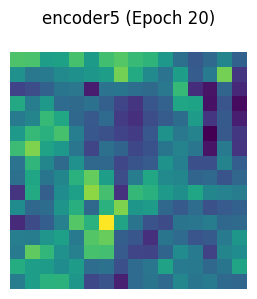

encoder6: torch.Size([3, 64, 8, 8])


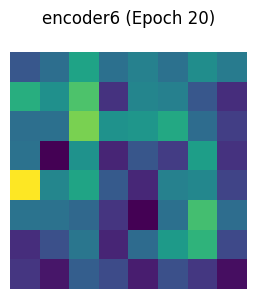

decoder1: torch.Size([3, 48, 8, 8])


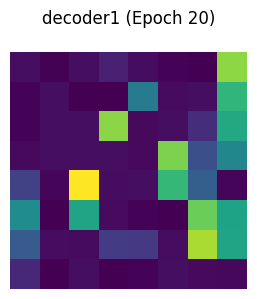

decoder2: torch.Size([3, 32, 8, 8])


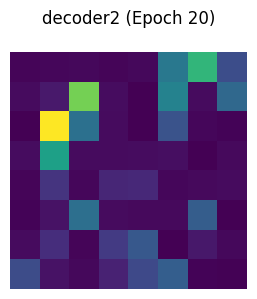

decoder3: torch.Size([3, 24, 16, 16])


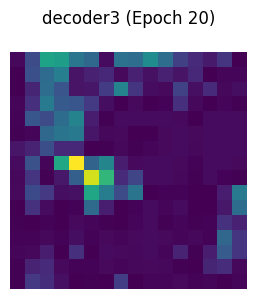

decoder4: torch.Size([3, 16, 32, 32])


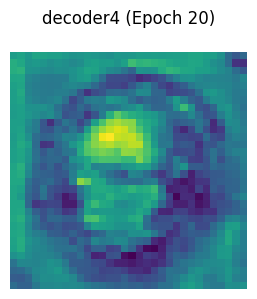

decoder5: torch.Size([3, 8, 64, 64])


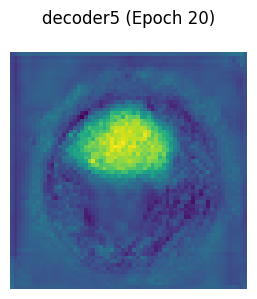

Epoch 20: Loss = 95.1694, Val Dice = 0.8354, Val mIoU = 0.7192, Val Accuracy = 0.9724, Val Sensitivity = 0.8217, Val Specificity = 0.9869


Epoch 21/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 21] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


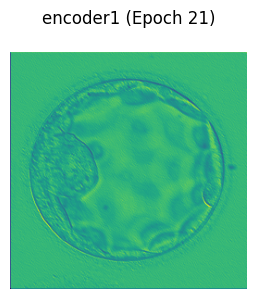

encoder2: torch.Size([3, 16, 128, 128])


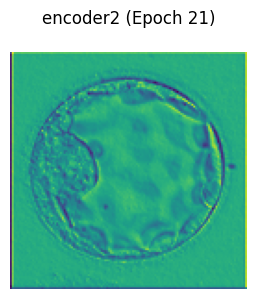

encoder3: torch.Size([3, 24, 64, 64])


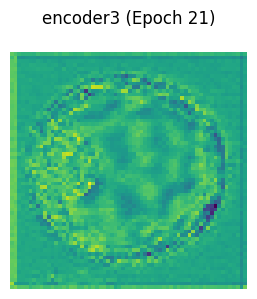

encoder4: torch.Size([3, 32, 32, 32])


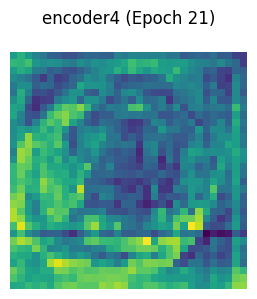

encoder5: torch.Size([3, 48, 16, 16])


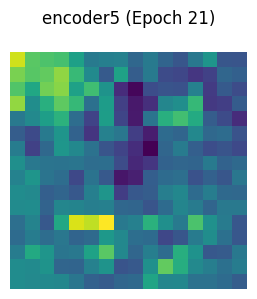

encoder6: torch.Size([3, 64, 8, 8])


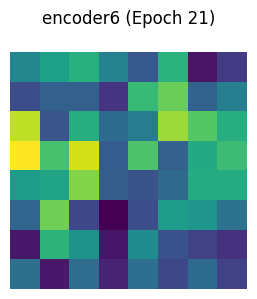

decoder1: torch.Size([3, 48, 8, 8])


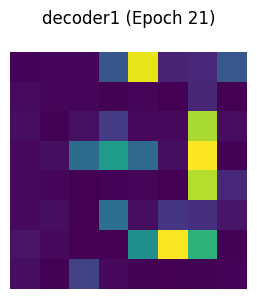

decoder2: torch.Size([3, 32, 8, 8])


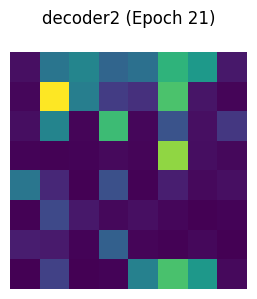

decoder3: torch.Size([3, 24, 16, 16])


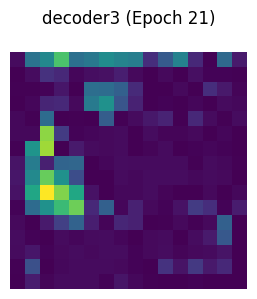

decoder4: torch.Size([3, 16, 32, 32])


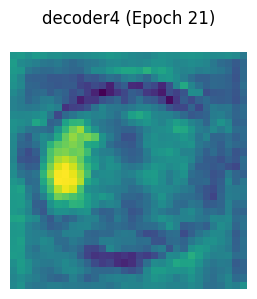

decoder5: torch.Size([3, 8, 64, 64])


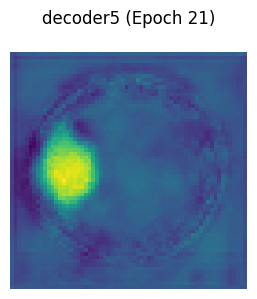

Epoch 21: Loss = 94.5388, Val Dice = 0.8427, Val mIoU = 0.7304, Val Accuracy = 0.9727, Val Sensitivity = 0.8554, Val Specificity = 0.9842


Epoch 22/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 22] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


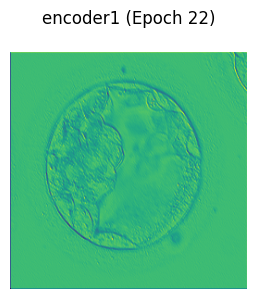

encoder2: torch.Size([3, 16, 128, 128])


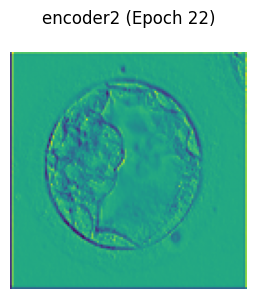

encoder3: torch.Size([3, 24, 64, 64])


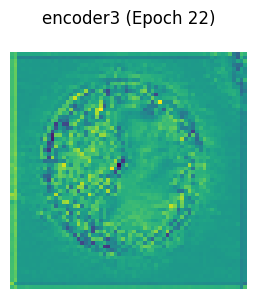

encoder4: torch.Size([3, 32, 32, 32])


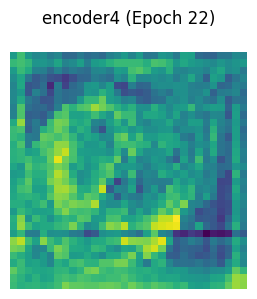

encoder5: torch.Size([3, 48, 16, 16])


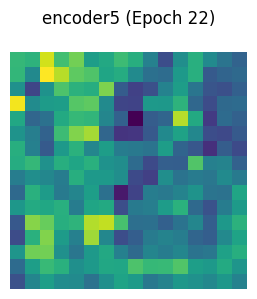

encoder6: torch.Size([3, 64, 8, 8])


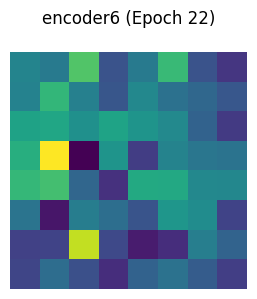

decoder1: torch.Size([3, 48, 8, 8])


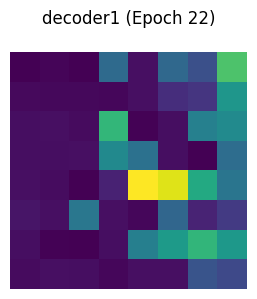

decoder2: torch.Size([3, 32, 8, 8])


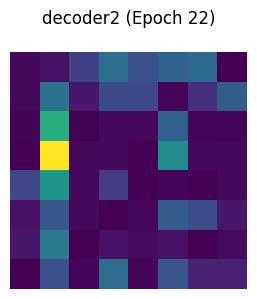

decoder3: torch.Size([3, 24, 16, 16])


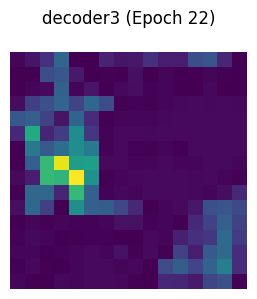

decoder4: torch.Size([3, 16, 32, 32])


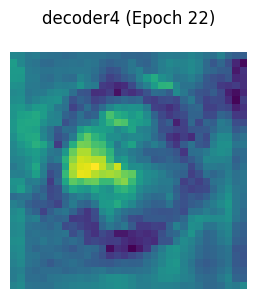

decoder5: torch.Size([3, 8, 64, 64])


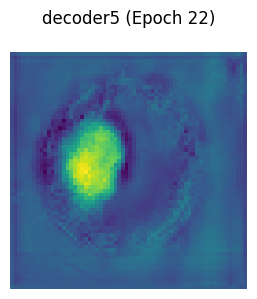

Epoch 22: Loss = 94.1231, Val Dice = 0.8355, Val mIoU = 0.7196, Val Accuracy = 0.9723, Val Sensitivity = 0.8258, Val Specificity = 0.9864


Epoch 23/100: 100%|██████████| 125/125 [01:33<00:00,  1.33it/s]


[Epoch 23] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


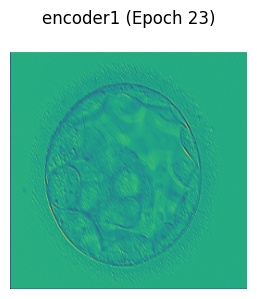

encoder2: torch.Size([3, 16, 128, 128])


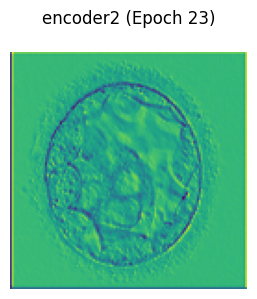

encoder3: torch.Size([3, 24, 64, 64])


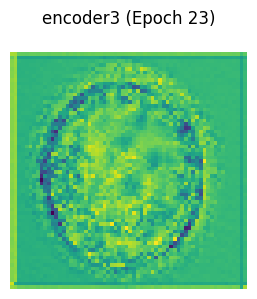

encoder4: torch.Size([3, 32, 32, 32])


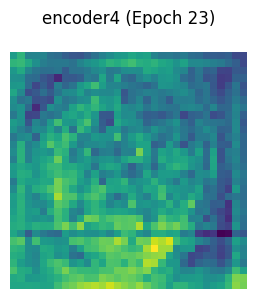

encoder5: torch.Size([3, 48, 16, 16])


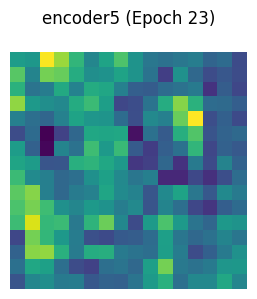

encoder6: torch.Size([3, 64, 8, 8])


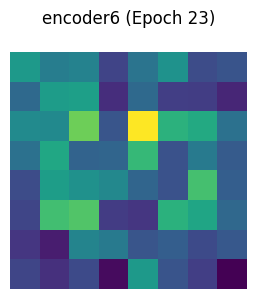

decoder1: torch.Size([3, 48, 8, 8])


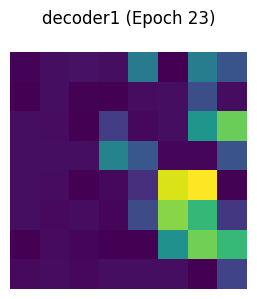

decoder2: torch.Size([3, 32, 8, 8])


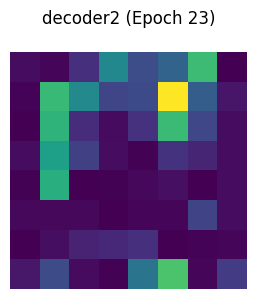

decoder3: torch.Size([3, 24, 16, 16])


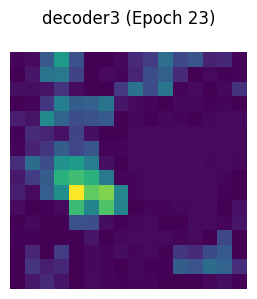

decoder4: torch.Size([3, 16, 32, 32])


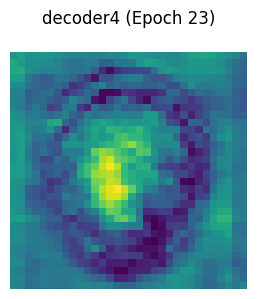

decoder5: torch.Size([3, 8, 64, 64])


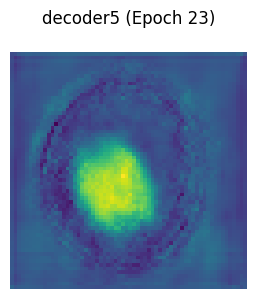

Epoch 23: Loss = 93.8096, Val Dice = 0.8400, Val mIoU = 0.7263, Val Accuracy = 0.9727, Val Sensitivity = 0.8424, Val Specificity = 0.9853


Epoch 24/100: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


[Epoch 24] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


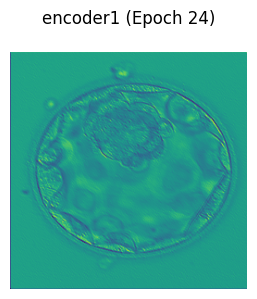

encoder2: torch.Size([3, 16, 128, 128])


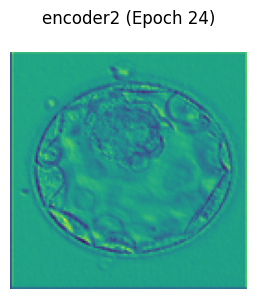

encoder3: torch.Size([3, 24, 64, 64])


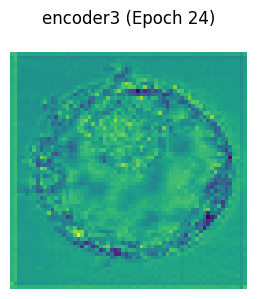

encoder4: torch.Size([3, 32, 32, 32])


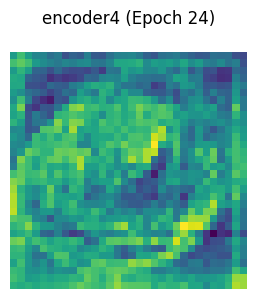

encoder5: torch.Size([3, 48, 16, 16])


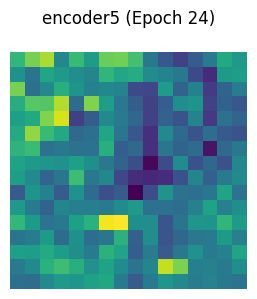

encoder6: torch.Size([3, 64, 8, 8])


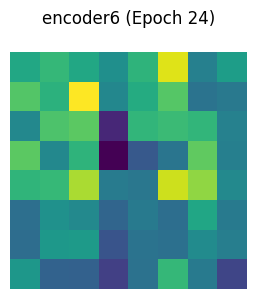

decoder1: torch.Size([3, 48, 8, 8])


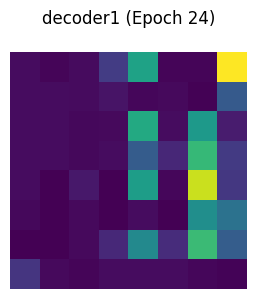

decoder2: torch.Size([3, 32, 8, 8])


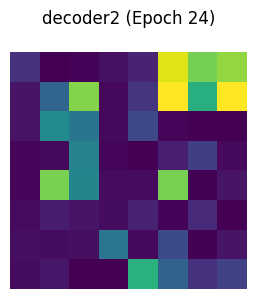

decoder3: torch.Size([3, 24, 16, 16])


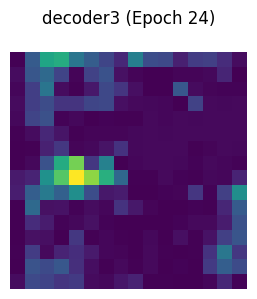

decoder4: torch.Size([3, 16, 32, 32])


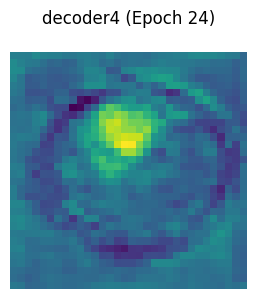

decoder5: torch.Size([3, 8, 64, 64])


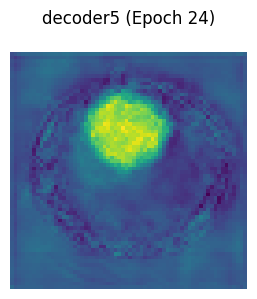

Epoch 24: Loss = 93.4546, Val Dice = 0.8306, Val mIoU = 0.7124, Val Accuracy = 0.9718, Val Sensitivity = 0.8131, Val Specificity = 0.9870


Epoch 25/100: 100%|██████████| 125/125 [01:39<00:00,  1.25it/s]


[Epoch 25] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


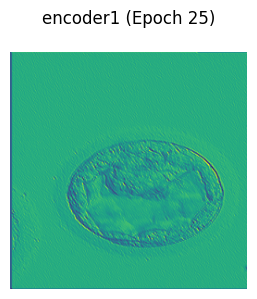

encoder2: torch.Size([3, 16, 128, 128])


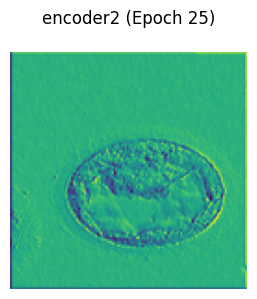

encoder3: torch.Size([3, 24, 64, 64])


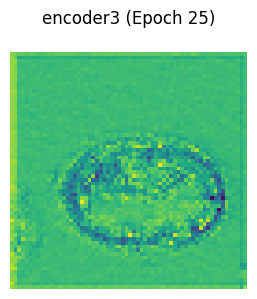

encoder4: torch.Size([3, 32, 32, 32])


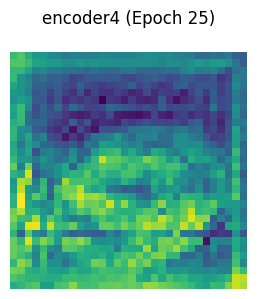

encoder5: torch.Size([3, 48, 16, 16])


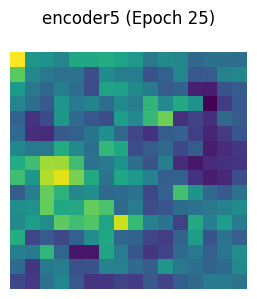

encoder6: torch.Size([3, 64, 8, 8])


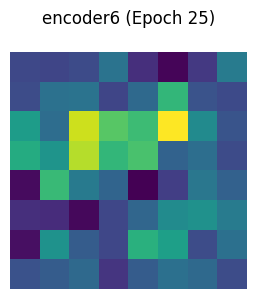

decoder1: torch.Size([3, 48, 8, 8])


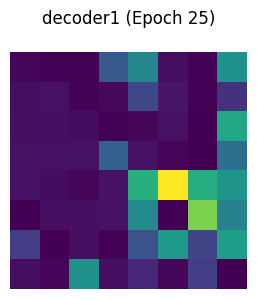

decoder2: torch.Size([3, 32, 8, 8])


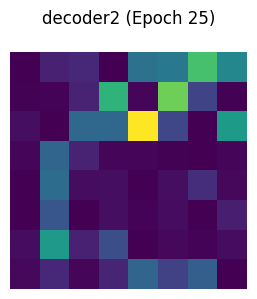

decoder3: torch.Size([3, 24, 16, 16])


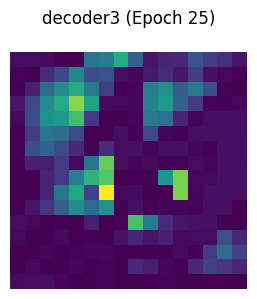

decoder4: torch.Size([3, 16, 32, 32])


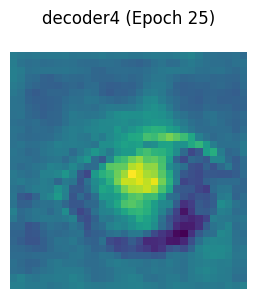

decoder5: torch.Size([3, 8, 64, 64])


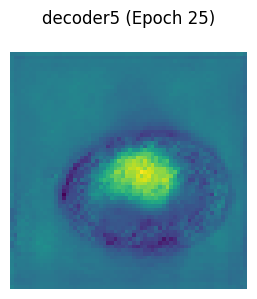

Epoch 25: Loss = 92.7616, Val Dice = 0.8297, Val mIoU = 0.7108, Val Accuracy = 0.9712, Val Sensitivity = 0.8199, Val Specificity = 0.9858


Epoch 26/100: 100%|██████████| 125/125 [01:34<00:00,  1.32it/s]


[Epoch 26] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


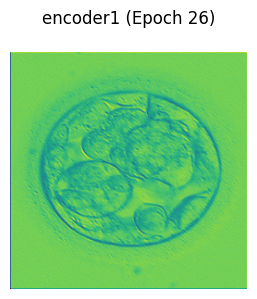

encoder2: torch.Size([3, 16, 128, 128])


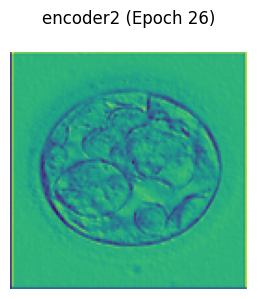

encoder3: torch.Size([3, 24, 64, 64])


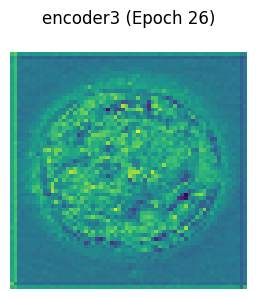

encoder4: torch.Size([3, 32, 32, 32])


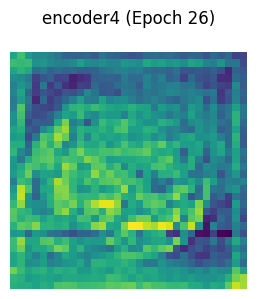

encoder5: torch.Size([3, 48, 16, 16])


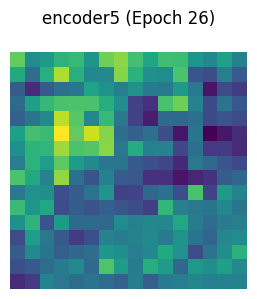

encoder6: torch.Size([3, 64, 8, 8])


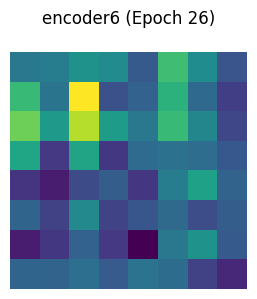

decoder1: torch.Size([3, 48, 8, 8])


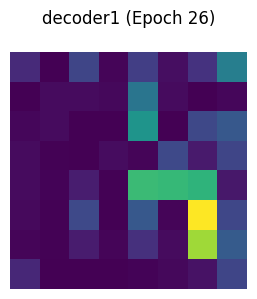

decoder2: torch.Size([3, 32, 8, 8])


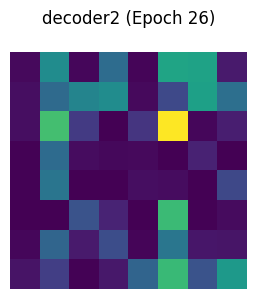

decoder3: torch.Size([3, 24, 16, 16])


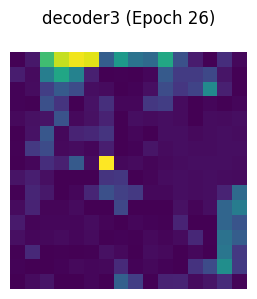

decoder4: torch.Size([3, 16, 32, 32])


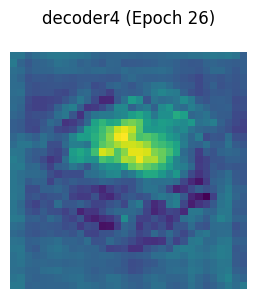

decoder5: torch.Size([3, 8, 64, 64])


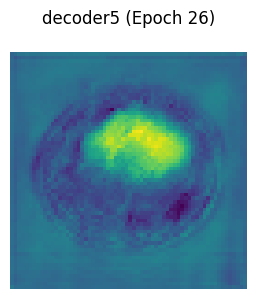

Epoch 26: Loss = 92.2685, Val Dice = 0.8309, Val mIoU = 0.7122, Val Accuracy = 0.9719, Val Sensitivity = 0.8071, Val Specificity = 0.9877


Epoch 27/100: 100%|██████████| 125/125 [01:34<00:00,  1.32it/s]


[Epoch 27] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


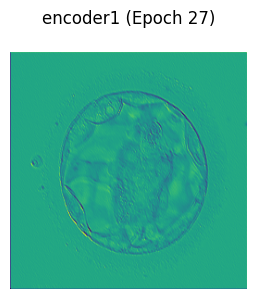

encoder2: torch.Size([3, 16, 128, 128])


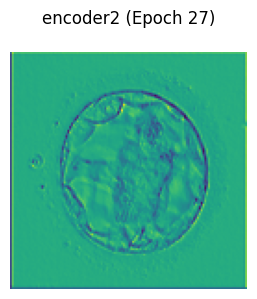

encoder3: torch.Size([3, 24, 64, 64])


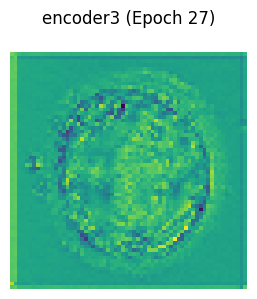

encoder4: torch.Size([3, 32, 32, 32])


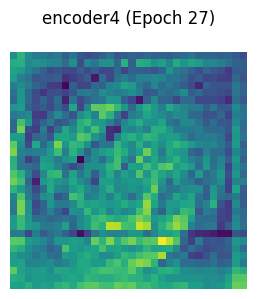

encoder5: torch.Size([3, 48, 16, 16])


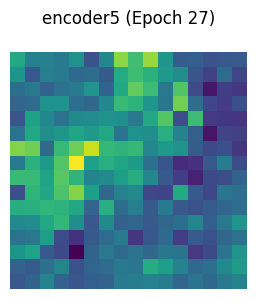

encoder6: torch.Size([3, 64, 8, 8])


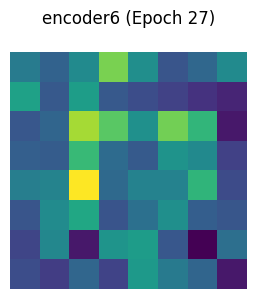

decoder1: torch.Size([3, 48, 8, 8])


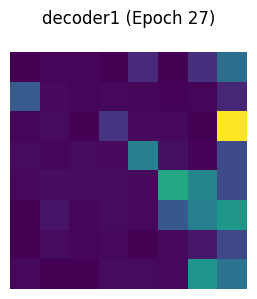

decoder2: torch.Size([3, 32, 8, 8])


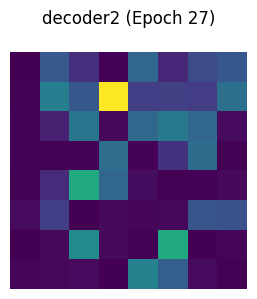

decoder3: torch.Size([3, 24, 16, 16])


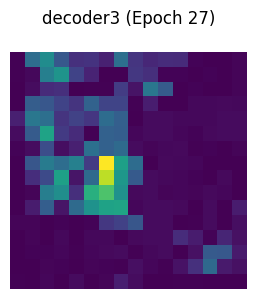

decoder4: torch.Size([3, 16, 32, 32])


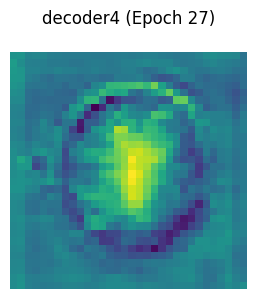

decoder5: torch.Size([3, 8, 64, 64])


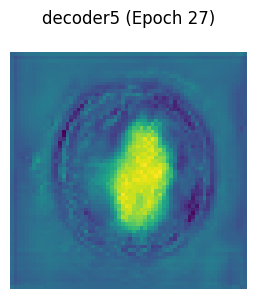

Epoch 27: Loss = 92.0222, Val Dice = 0.8258, Val mIoU = 0.7044, Val Accuracy = 0.9709, Val Sensitivity = 0.8058, Val Specificity = 0.9869


Epoch 28/100: 100%|██████████| 125/125 [01:35<00:00,  1.32it/s]


[Epoch 28] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


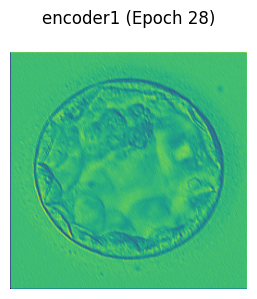

encoder2: torch.Size([3, 16, 128, 128])


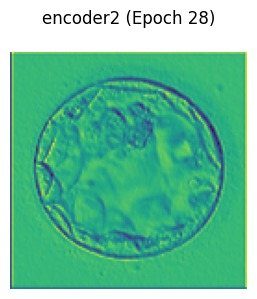

encoder3: torch.Size([3, 24, 64, 64])


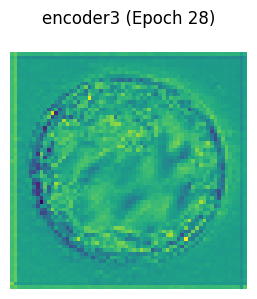

encoder4: torch.Size([3, 32, 32, 32])


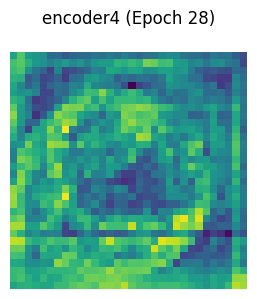

encoder5: torch.Size([3, 48, 16, 16])


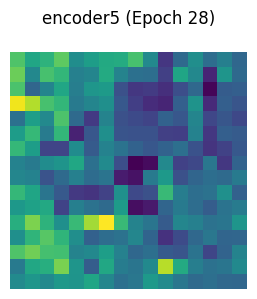

encoder6: torch.Size([3, 64, 8, 8])


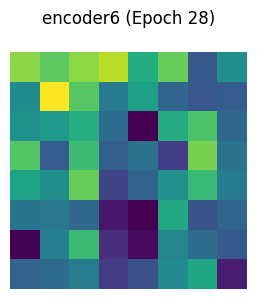

decoder1: torch.Size([3, 48, 8, 8])


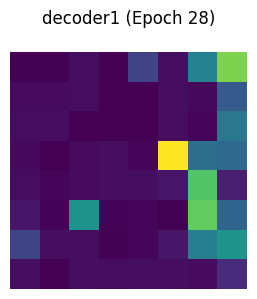

decoder2: torch.Size([3, 32, 8, 8])


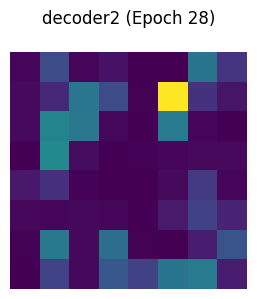

decoder3: torch.Size([3, 24, 16, 16])


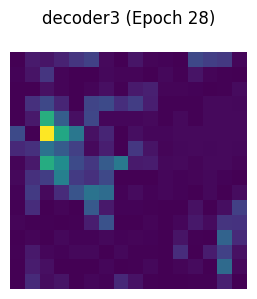

decoder4: torch.Size([3, 16, 32, 32])


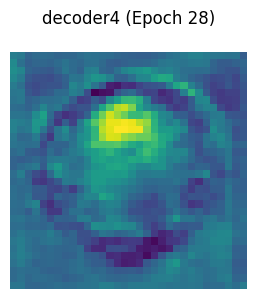

decoder5: torch.Size([3, 8, 64, 64])


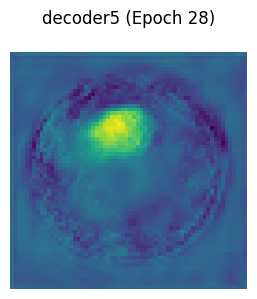

Epoch 28: Loss = 91.7111, Val Dice = 0.8338, Val mIoU = 0.7172, Val Accuracy = 0.9719, Val Sensitivity = 0.8261, Val Specificity = 0.9859


Epoch 29/100: 100%|██████████| 125/125 [01:33<00:00,  1.34it/s]


[Epoch 29] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


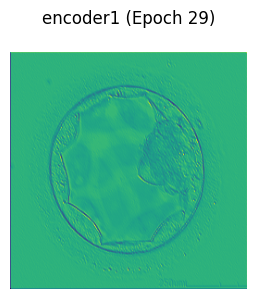

encoder2: torch.Size([3, 16, 128, 128])


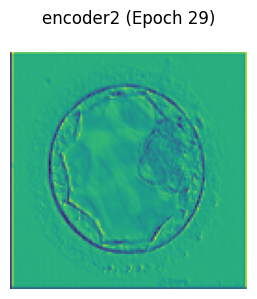

encoder3: torch.Size([3, 24, 64, 64])


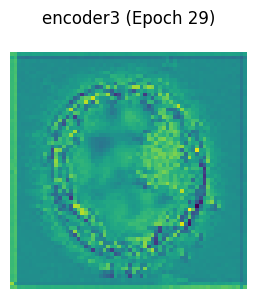

encoder4: torch.Size([3, 32, 32, 32])


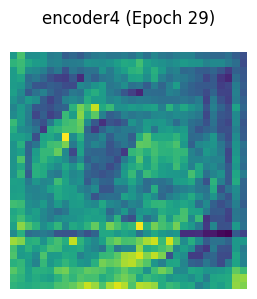

encoder5: torch.Size([3, 48, 16, 16])


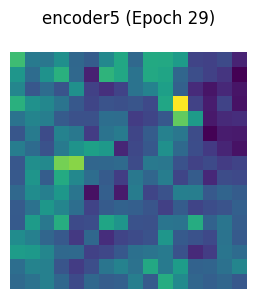

encoder6: torch.Size([3, 64, 8, 8])


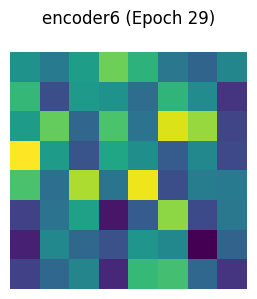

decoder1: torch.Size([3, 48, 8, 8])


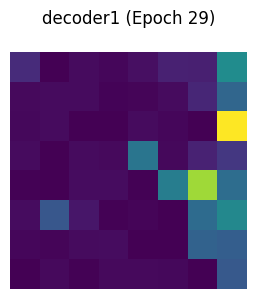

decoder2: torch.Size([3, 32, 8, 8])


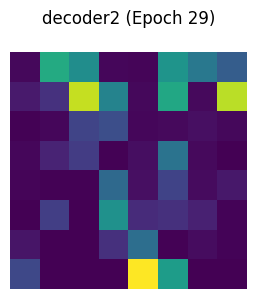

decoder3: torch.Size([3, 24, 16, 16])


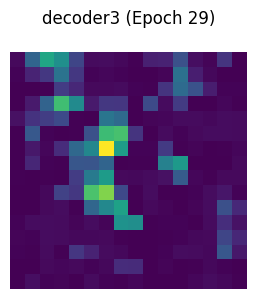

decoder4: torch.Size([3, 16, 32, 32])


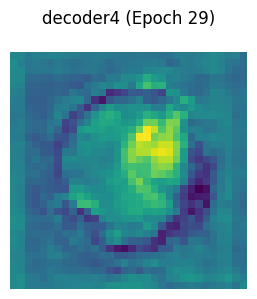

decoder5: torch.Size([3, 8, 64, 64])


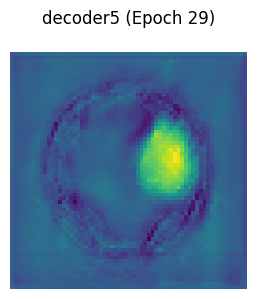

Epoch 29: Loss = 91.2173, Val Dice = 0.8362, Val mIoU = 0.7199, Val Accuracy = 0.9721, Val Sensitivity = 0.8306, Val Specificity = 0.9859


Epoch 30/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 30] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


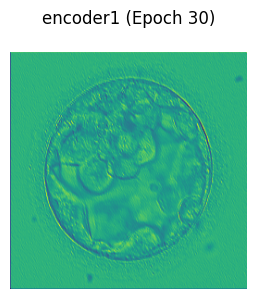

encoder2: torch.Size([3, 16, 128, 128])


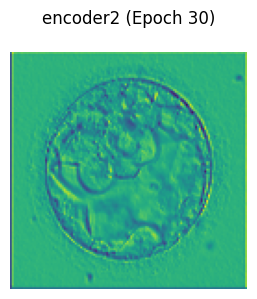

encoder3: torch.Size([3, 24, 64, 64])


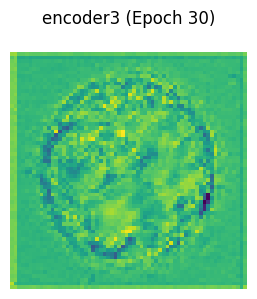

encoder4: torch.Size([3, 32, 32, 32])


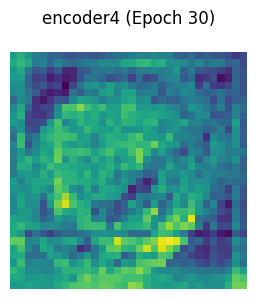

encoder5: torch.Size([3, 48, 16, 16])


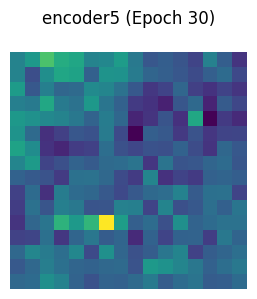

encoder6: torch.Size([3, 64, 8, 8])


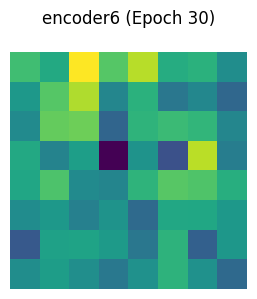

decoder1: torch.Size([3, 48, 8, 8])


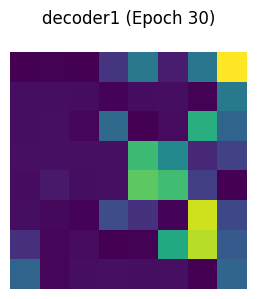

decoder2: torch.Size([3, 32, 8, 8])


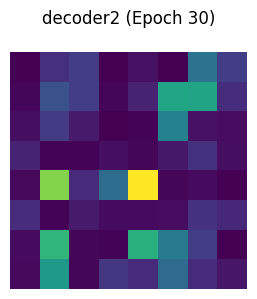

decoder3: torch.Size([3, 24, 16, 16])


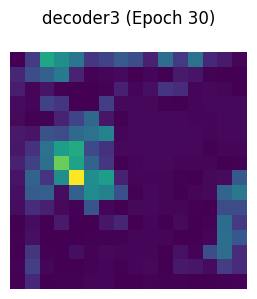

decoder4: torch.Size([3, 16, 32, 32])


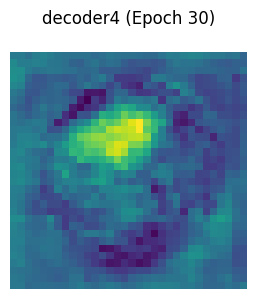

decoder5: torch.Size([3, 8, 64, 64])


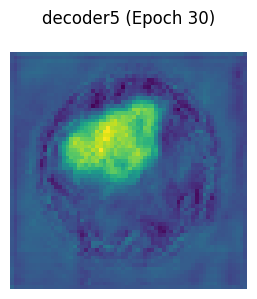

Epoch 30: Loss = 90.9128, Val Dice = 0.8252, Val mIoU = 0.7041, Val Accuracy = 0.9703, Val Sensitivity = 0.8221, Val Specificity = 0.9846


Epoch 31/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 31] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


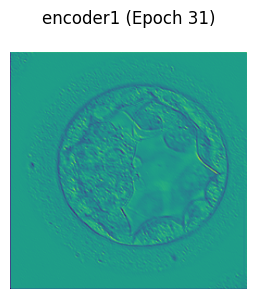

encoder2: torch.Size([3, 16, 128, 128])


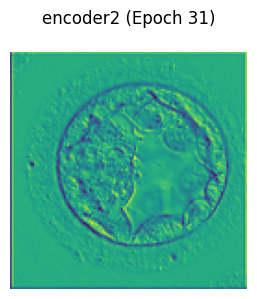

encoder3: torch.Size([3, 24, 64, 64])


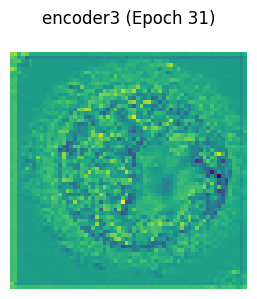

encoder4: torch.Size([3, 32, 32, 32])


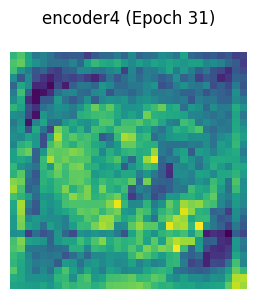

encoder5: torch.Size([3, 48, 16, 16])


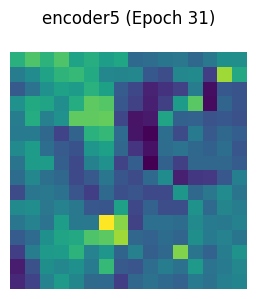

encoder6: torch.Size([3, 64, 8, 8])


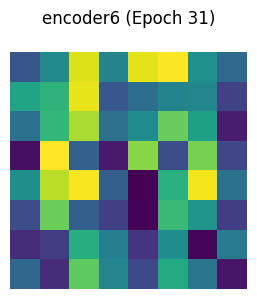

decoder1: torch.Size([3, 48, 8, 8])


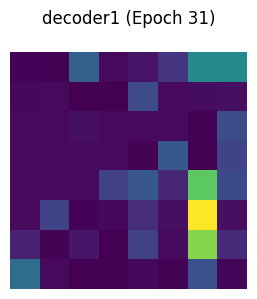

decoder2: torch.Size([3, 32, 8, 8])


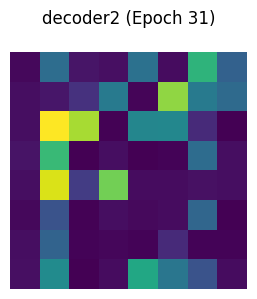

decoder3: torch.Size([3, 24, 16, 16])


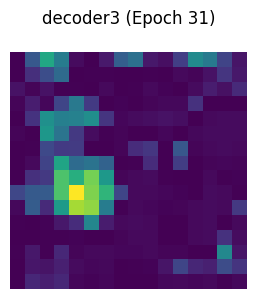

decoder4: torch.Size([3, 16, 32, 32])


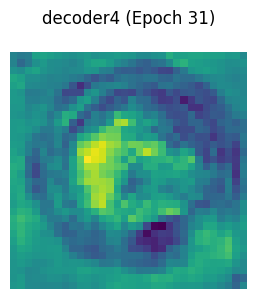

decoder5: torch.Size([3, 8, 64, 64])


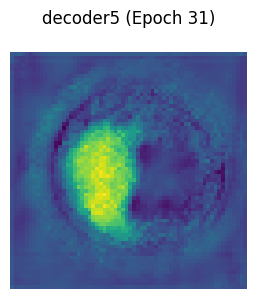

Epoch 31: Loss = 90.6486, Val Dice = 0.8280, Val mIoU = 0.7089, Val Accuracy = 0.9707, Val Sensitivity = 0.8267, Val Specificity = 0.9846


Epoch 32/100: 100%|██████████| 125/125 [01:35<00:00,  1.30it/s]


[Epoch 32] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


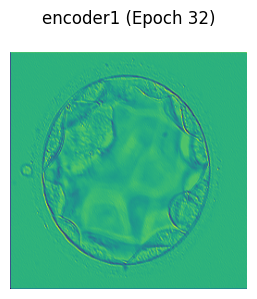

encoder2: torch.Size([3, 16, 128, 128])


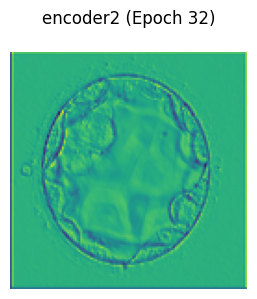

encoder3: torch.Size([3, 24, 64, 64])


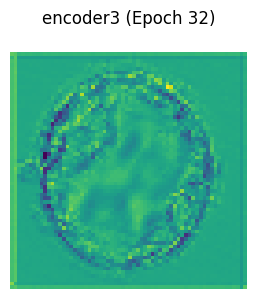

encoder4: torch.Size([3, 32, 32, 32])


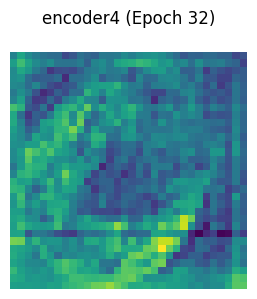

encoder5: torch.Size([3, 48, 16, 16])


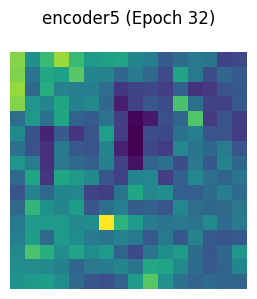

encoder6: torch.Size([3, 64, 8, 8])


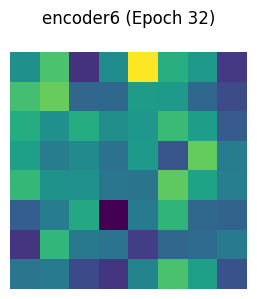

decoder1: torch.Size([3, 48, 8, 8])


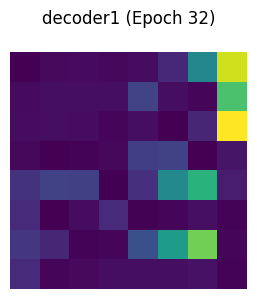

decoder2: torch.Size([3, 32, 8, 8])


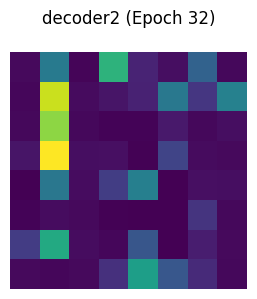

decoder3: torch.Size([3, 24, 16, 16])


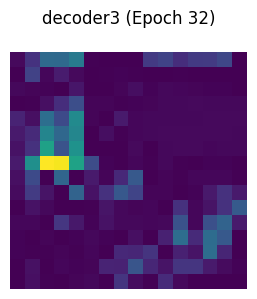

decoder4: torch.Size([3, 16, 32, 32])


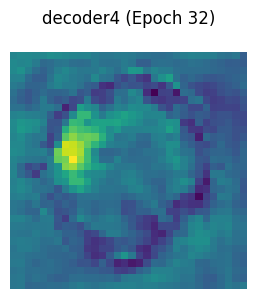

decoder5: torch.Size([3, 8, 64, 64])


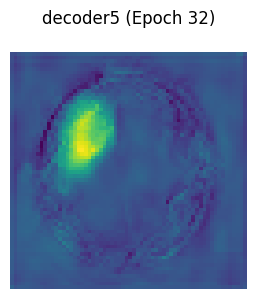

Epoch 32: Loss = 90.3549, Val Dice = 0.8255, Val mIoU = 0.7046, Val Accuracy = 0.9703, Val Sensitivity = 0.8224, Val Specificity = 0.9847


Epoch 33/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 33] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


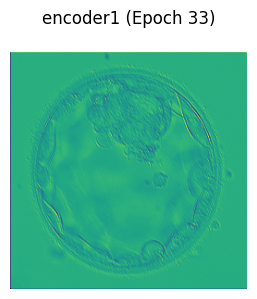

encoder2: torch.Size([3, 16, 128, 128])


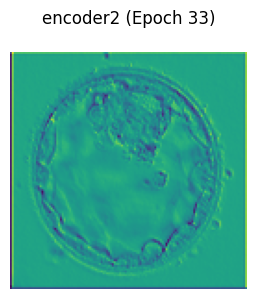

encoder3: torch.Size([3, 24, 64, 64])


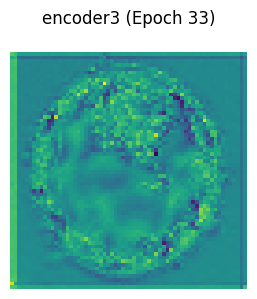

encoder4: torch.Size([3, 32, 32, 32])


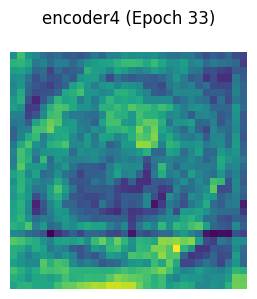

encoder5: torch.Size([3, 48, 16, 16])


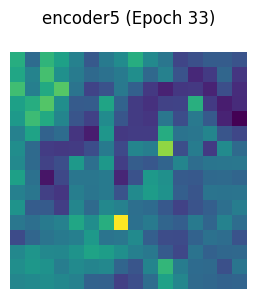

encoder6: torch.Size([3, 64, 8, 8])


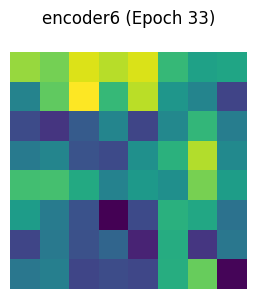

decoder1: torch.Size([3, 48, 8, 8])


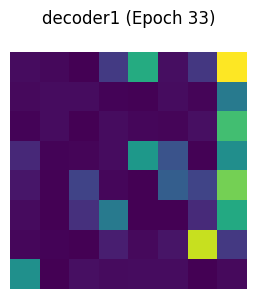

decoder2: torch.Size([3, 32, 8, 8])


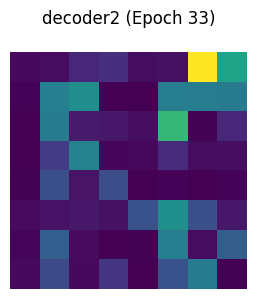

decoder3: torch.Size([3, 24, 16, 16])


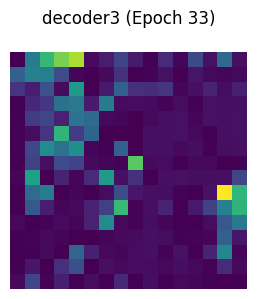

decoder4: torch.Size([3, 16, 32, 32])


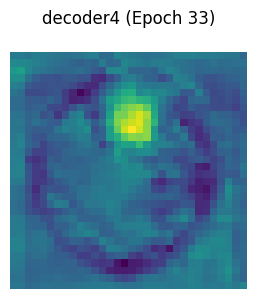

decoder5: torch.Size([3, 8, 64, 64])


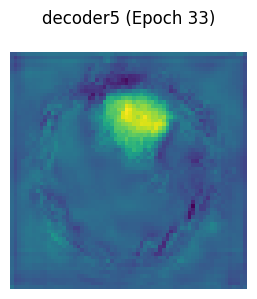

Epoch 33: Loss = 90.1060, Val Dice = 0.8219, Val mIoU = 0.6995, Val Accuracy = 0.9700, Val Sensitivity = 0.8100, Val Specificity = 0.9855


Epoch 34/100: 100%|██████████| 125/125 [01:34<00:00,  1.32it/s]


[Epoch 34] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


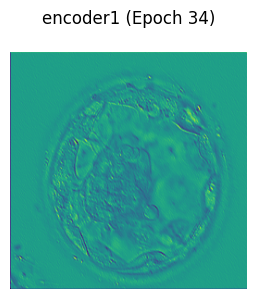

encoder2: torch.Size([3, 16, 128, 128])


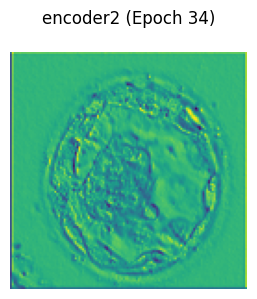

encoder3: torch.Size([3, 24, 64, 64])


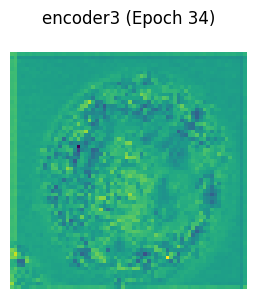

encoder4: torch.Size([3, 32, 32, 32])


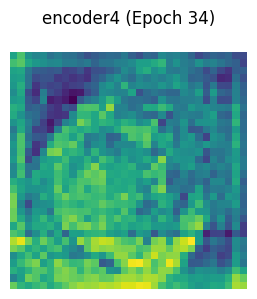

encoder5: torch.Size([3, 48, 16, 16])


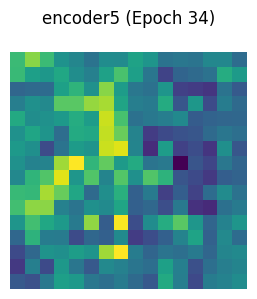

encoder6: torch.Size([3, 64, 8, 8])


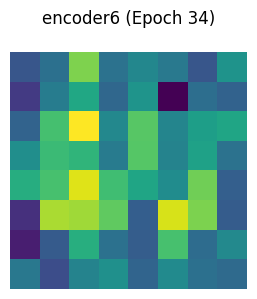

decoder1: torch.Size([3, 48, 8, 8])


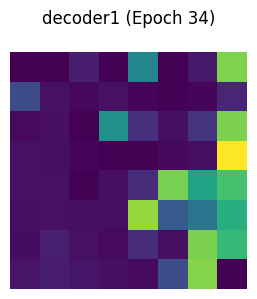

decoder2: torch.Size([3, 32, 8, 8])


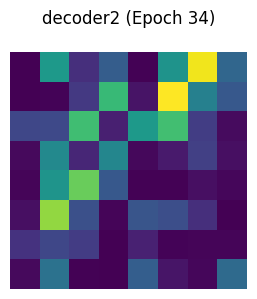

decoder3: torch.Size([3, 24, 16, 16])


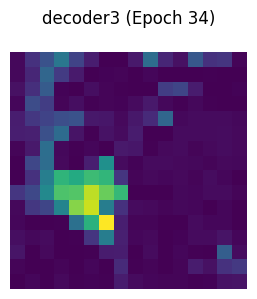

decoder4: torch.Size([3, 16, 32, 32])


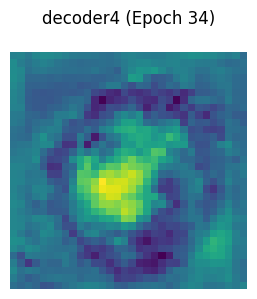

decoder5: torch.Size([3, 8, 64, 64])


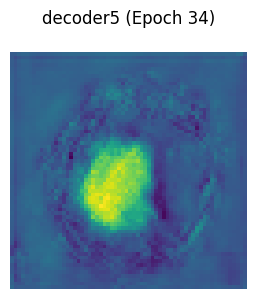

Epoch 34: Loss = 89.7278, Val Dice = 0.8255, Val mIoU = 0.7049, Val Accuracy = 0.9704, Val Sensitivity = 0.8183, Val Specificity = 0.9852


Epoch 35/100: 100%|██████████| 125/125 [01:36<00:00,  1.29it/s]


[Epoch 35] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


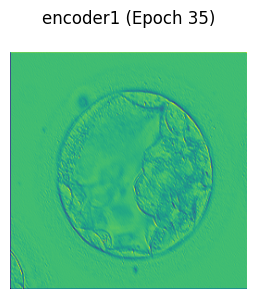

encoder2: torch.Size([3, 16, 128, 128])


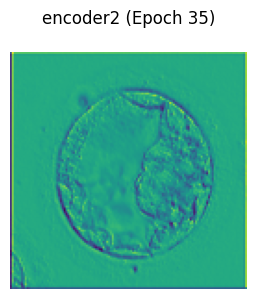

encoder3: torch.Size([3, 24, 64, 64])


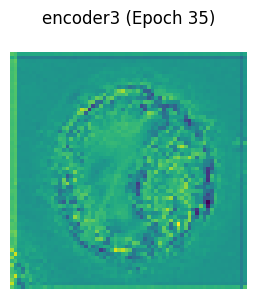

encoder4: torch.Size([3, 32, 32, 32])


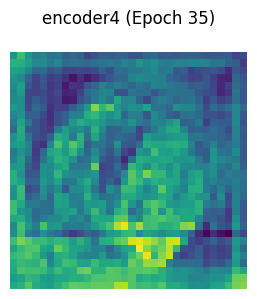

encoder5: torch.Size([3, 48, 16, 16])


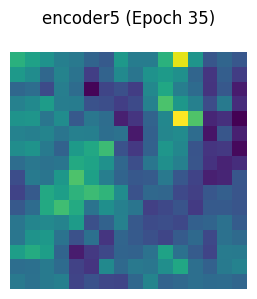

encoder6: torch.Size([3, 64, 8, 8])


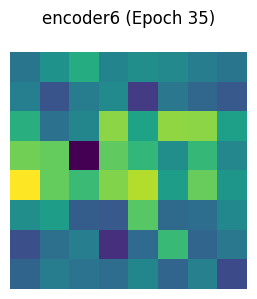

decoder1: torch.Size([3, 48, 8, 8])


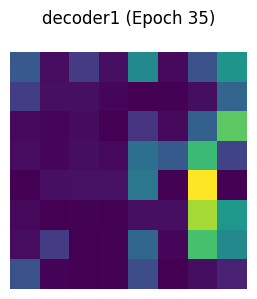

decoder2: torch.Size([3, 32, 8, 8])


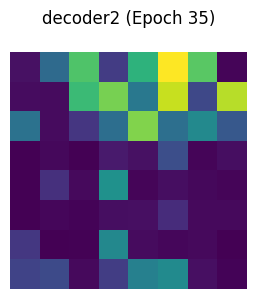

decoder3: torch.Size([3, 24, 16, 16])


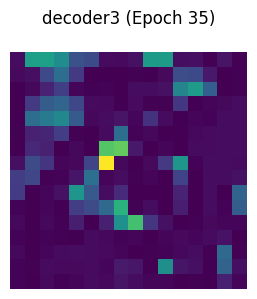

decoder4: torch.Size([3, 16, 32, 32])


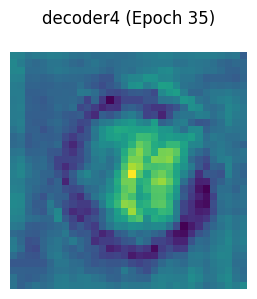

decoder5: torch.Size([3, 8, 64, 64])


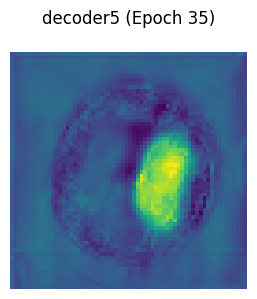

Epoch 35: Loss = 89.5237, Val Dice = 0.8218, Val mIoU = 0.6994, Val Accuracy = 0.9698, Val Sensitivity = 0.8152, Val Specificity = 0.9848


Epoch 36/100: 100%|██████████| 125/125 [01:35<00:00,  1.31it/s]


[Epoch 36] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


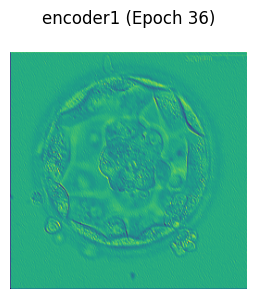

encoder2: torch.Size([3, 16, 128, 128])


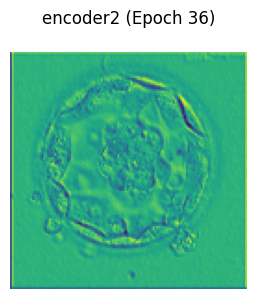

encoder3: torch.Size([3, 24, 64, 64])


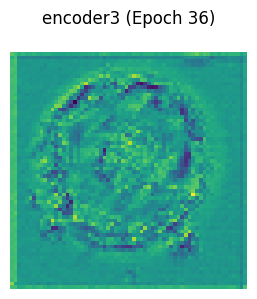

encoder4: torch.Size([3, 32, 32, 32])


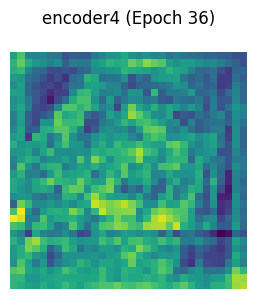

encoder5: torch.Size([3, 48, 16, 16])


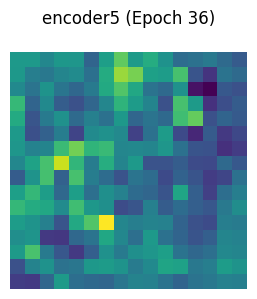

encoder6: torch.Size([3, 64, 8, 8])


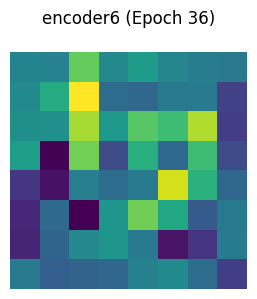

decoder1: torch.Size([3, 48, 8, 8])


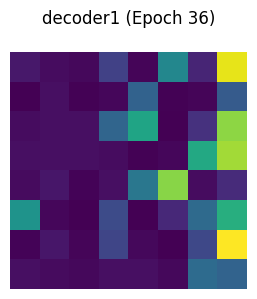

decoder2: torch.Size([3, 32, 8, 8])


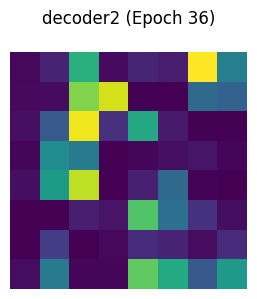

decoder3: torch.Size([3, 24, 16, 16])


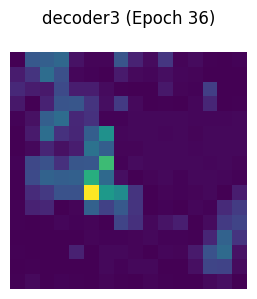

decoder4: torch.Size([3, 16, 32, 32])


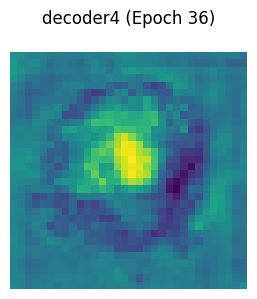

decoder5: torch.Size([3, 8, 64, 64])


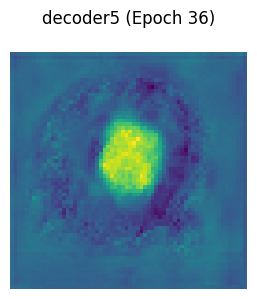

Epoch 36: Loss = 89.2521, Val Dice = 0.8230, Val mIoU = 0.7014, Val Accuracy = 0.9701, Val Sensitivity = 0.8138, Val Specificity = 0.9852


Epoch 37/100: 100%|██████████| 125/125 [01:37<00:00,  1.29it/s]


[Epoch 37] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


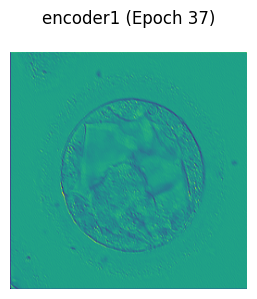

encoder2: torch.Size([3, 16, 128, 128])


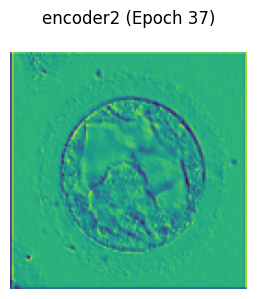

encoder3: torch.Size([3, 24, 64, 64])


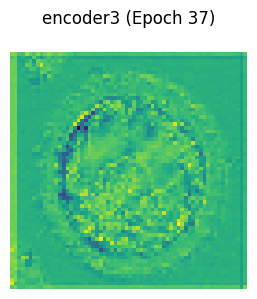

encoder4: torch.Size([3, 32, 32, 32])


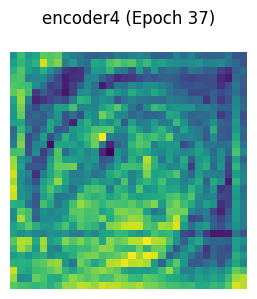

encoder5: torch.Size([3, 48, 16, 16])


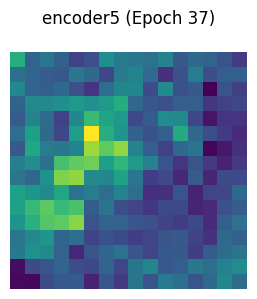

encoder6: torch.Size([3, 64, 8, 8])


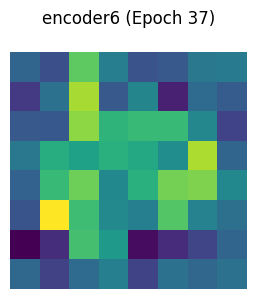

decoder1: torch.Size([3, 48, 8, 8])


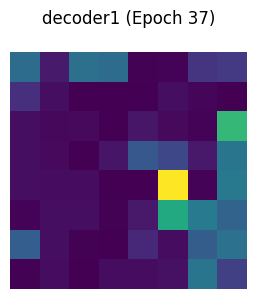

decoder2: torch.Size([3, 32, 8, 8])


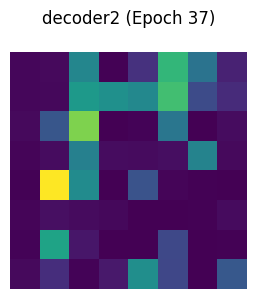

decoder3: torch.Size([3, 24, 16, 16])


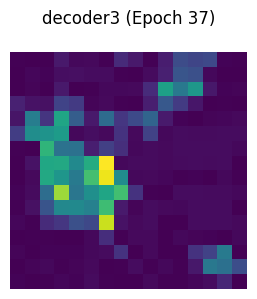

decoder4: torch.Size([3, 16, 32, 32])


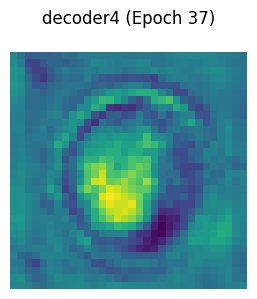

decoder5: torch.Size([3, 8, 64, 64])


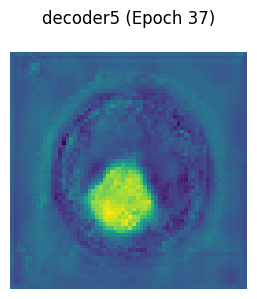

Epoch 37: Loss = 89.0366, Val Dice = 0.8152, Val mIoU = 0.6896, Val Accuracy = 0.9689, Val Sensitivity = 0.8028, Val Specificity = 0.9850


Epoch 38/100: 100%|██████████| 125/125 [01:37<00:00,  1.28it/s]


[Epoch 38] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


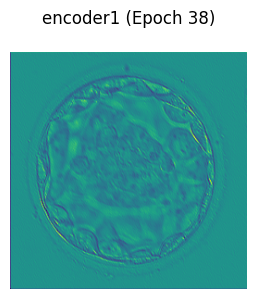

encoder2: torch.Size([3, 16, 128, 128])


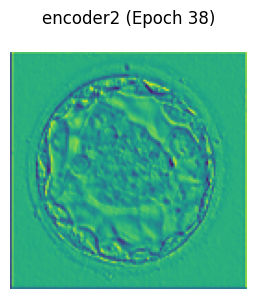

encoder3: torch.Size([3, 24, 64, 64])


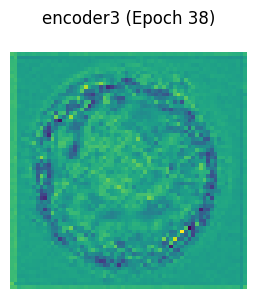

encoder4: torch.Size([3, 32, 32, 32])


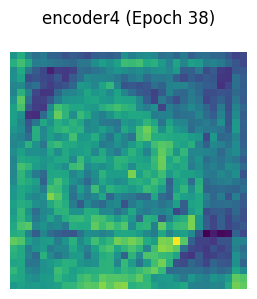

encoder5: torch.Size([3, 48, 16, 16])


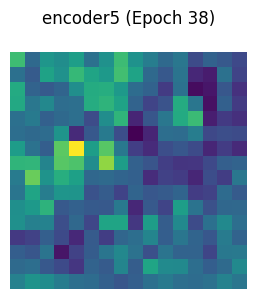

encoder6: torch.Size([3, 64, 8, 8])


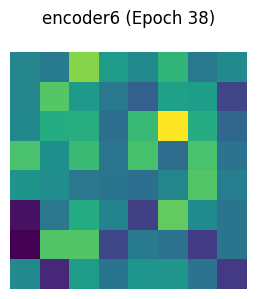

decoder1: torch.Size([3, 48, 8, 8])


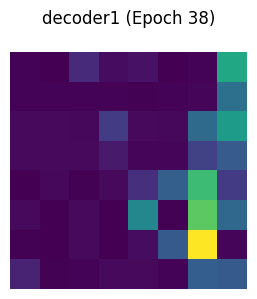

decoder2: torch.Size([3, 32, 8, 8])


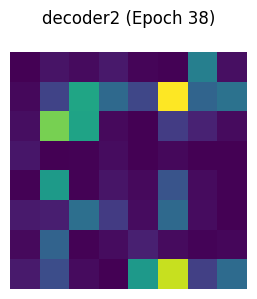

decoder3: torch.Size([3, 24, 16, 16])


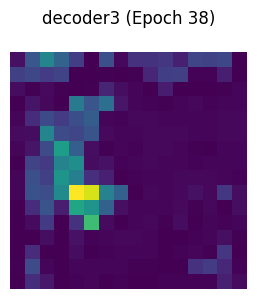

decoder4: torch.Size([3, 16, 32, 32])


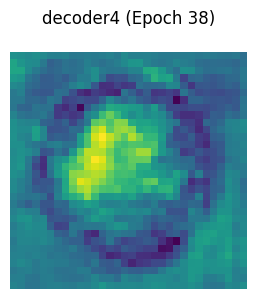

decoder5: torch.Size([3, 8, 64, 64])


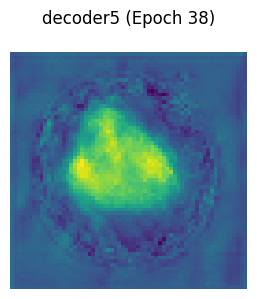

Epoch 38: Loss = 88.8215, Val Dice = 0.8227, Val mIoU = 0.7007, Val Accuracy = 0.9699, Val Sensitivity = 0.8155, Val Specificity = 0.9849


Epoch 39/100: 100%|██████████| 125/125 [01:36<00:00,  1.30it/s]


[Epoch 39] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


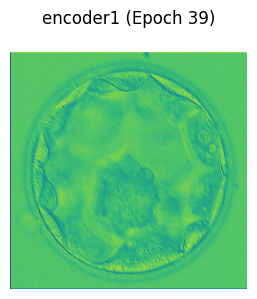

encoder2: torch.Size([3, 16, 128, 128])


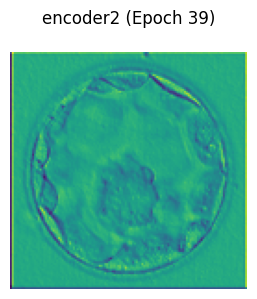

encoder3: torch.Size([3, 24, 64, 64])


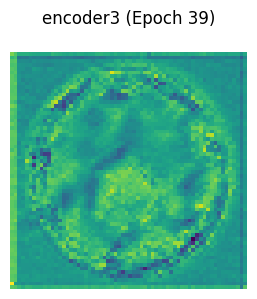

encoder4: torch.Size([3, 32, 32, 32])


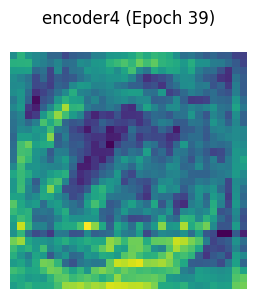

encoder5: torch.Size([3, 48, 16, 16])


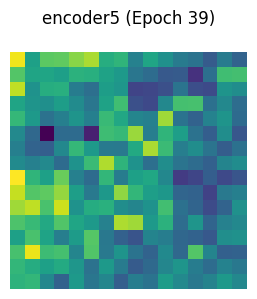

encoder6: torch.Size([3, 64, 8, 8])


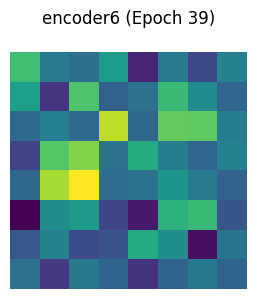

decoder1: torch.Size([3, 48, 8, 8])


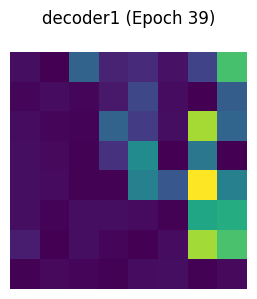

decoder2: torch.Size([3, 32, 8, 8])


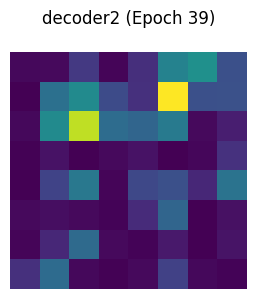

decoder3: torch.Size([3, 24, 16, 16])


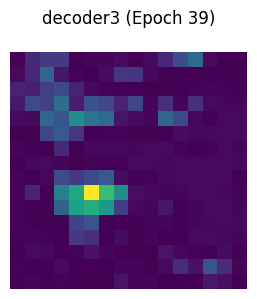

decoder4: torch.Size([3, 16, 32, 32])


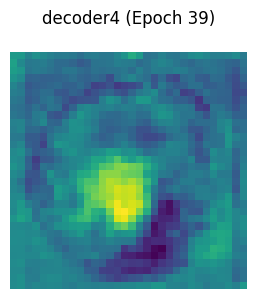

decoder5: torch.Size([3, 8, 64, 64])


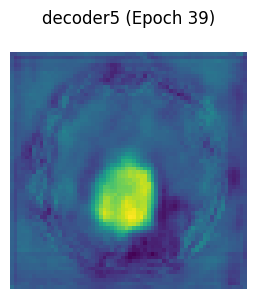

Epoch 39: Loss = 88.6208, Val Dice = 0.8225, Val mIoU = 0.7005, Val Accuracy = 0.9698, Val Sensitivity = 0.8176, Val Specificity = 0.9846


Epoch 40/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 40] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


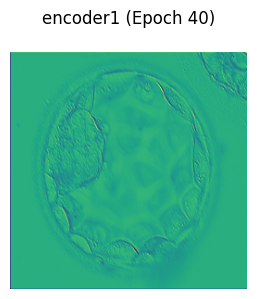

encoder2: torch.Size([3, 16, 128, 128])


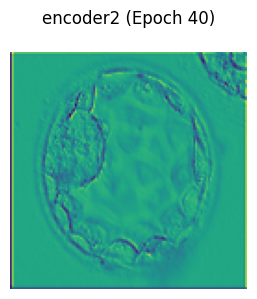

encoder3: torch.Size([3, 24, 64, 64])


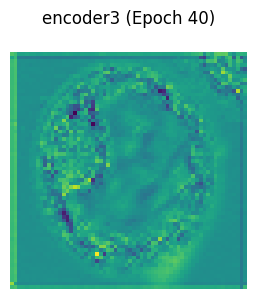

encoder4: torch.Size([3, 32, 32, 32])


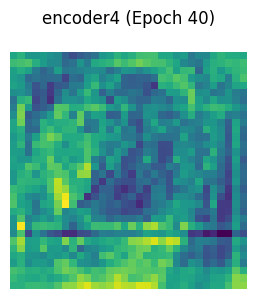

encoder5: torch.Size([3, 48, 16, 16])


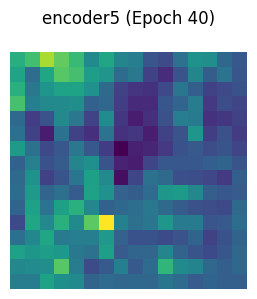

encoder6: torch.Size([3, 64, 8, 8])


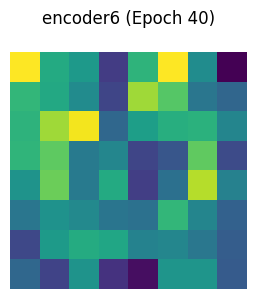

decoder1: torch.Size([3, 48, 8, 8])


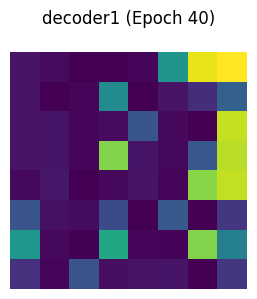

decoder2: torch.Size([3, 32, 8, 8])


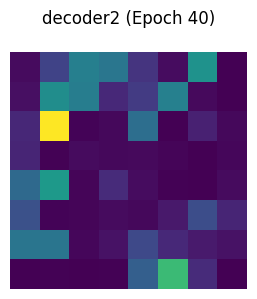

decoder3: torch.Size([3, 24, 16, 16])


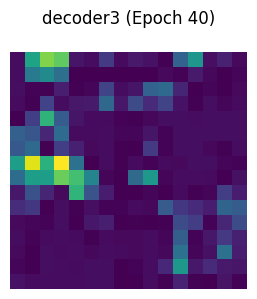

decoder4: torch.Size([3, 16, 32, 32])


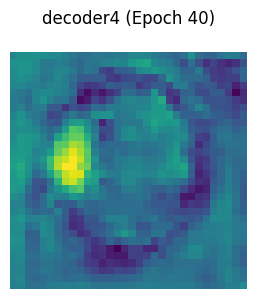

decoder5: torch.Size([3, 8, 64, 64])


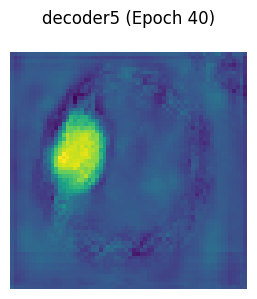

Epoch 40: Loss = 88.4739, Val Dice = 0.8145, Val mIoU = 0.6886, Val Accuracy = 0.9686, Val Sensitivity = 0.8060, Val Specificity = 0.9844


Epoch 41/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 41] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


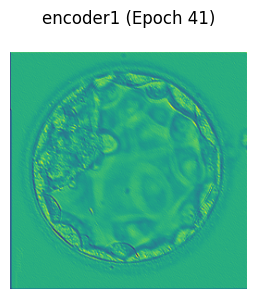

encoder2: torch.Size([3, 16, 128, 128])


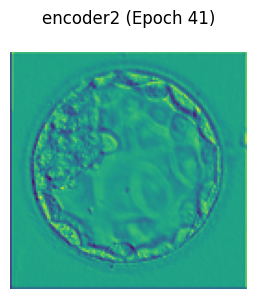

encoder3: torch.Size([3, 24, 64, 64])


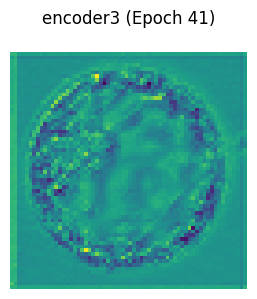

encoder4: torch.Size([3, 32, 32, 32])


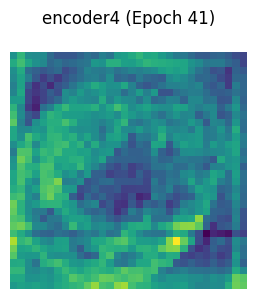

encoder5: torch.Size([3, 48, 16, 16])


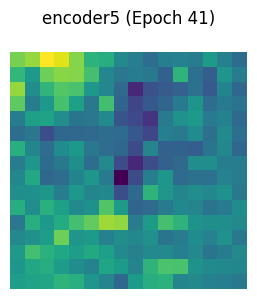

encoder6: torch.Size([3, 64, 8, 8])


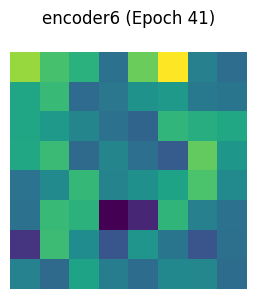

decoder1: torch.Size([3, 48, 8, 8])


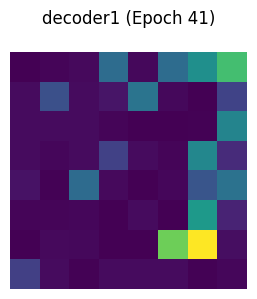

decoder2: torch.Size([3, 32, 8, 8])


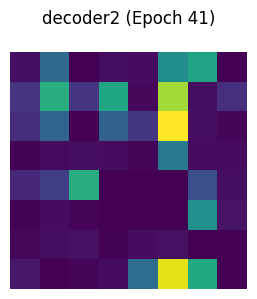

decoder3: torch.Size([3, 24, 16, 16])


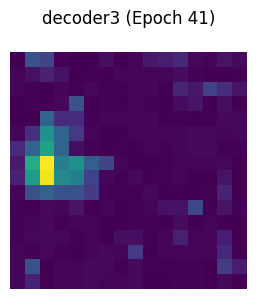

decoder4: torch.Size([3, 16, 32, 32])


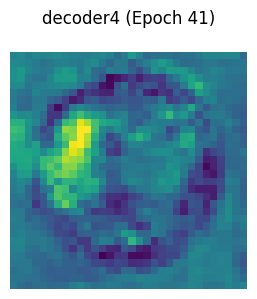

decoder5: torch.Size([3, 8, 64, 64])


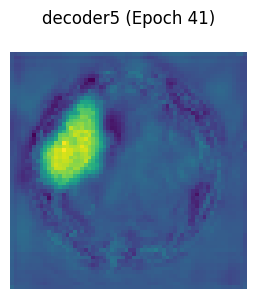

Epoch 41: Loss = 88.3355, Val Dice = 0.8177, Val mIoU = 0.6934, Val Accuracy = 0.9689, Val Sensitivity = 0.8150, Val Specificity = 0.9838


Epoch 42/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 42] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


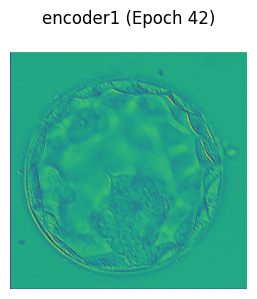

encoder2: torch.Size([3, 16, 128, 128])


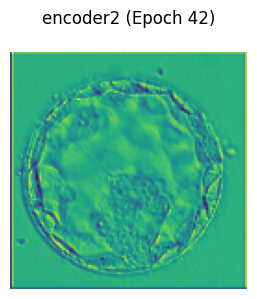

encoder3: torch.Size([3, 24, 64, 64])


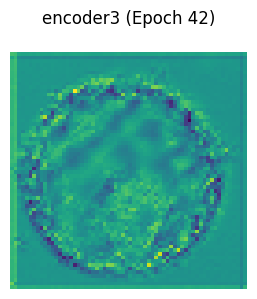

encoder4: torch.Size([3, 32, 32, 32])


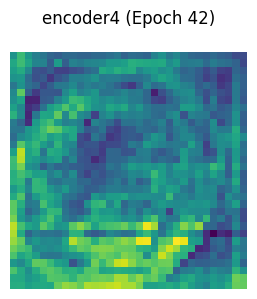

encoder5: torch.Size([3, 48, 16, 16])


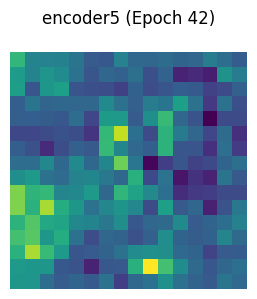

encoder6: torch.Size([3, 64, 8, 8])


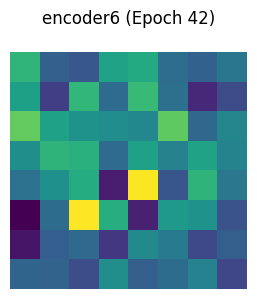

decoder1: torch.Size([3, 48, 8, 8])


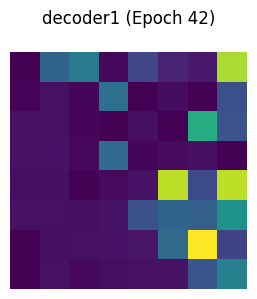

decoder2: torch.Size([3, 32, 8, 8])


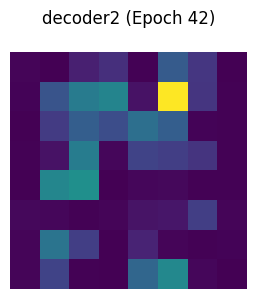

decoder3: torch.Size([3, 24, 16, 16])


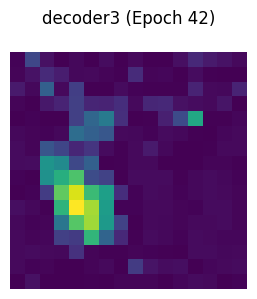

decoder4: torch.Size([3, 16, 32, 32])


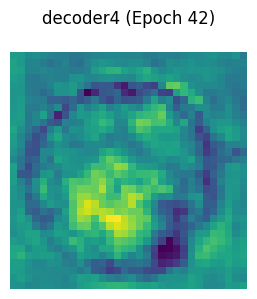

decoder5: torch.Size([3, 8, 64, 64])


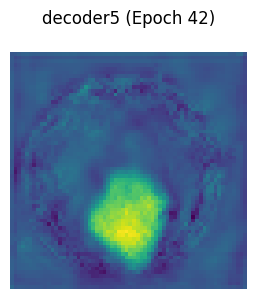

Epoch 42: Loss = 88.2535, Val Dice = 0.8159, Val mIoU = 0.6908, Val Accuracy = 0.9687, Val Sensitivity = 0.8108, Val Specificity = 0.9840


Epoch 43/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 43] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


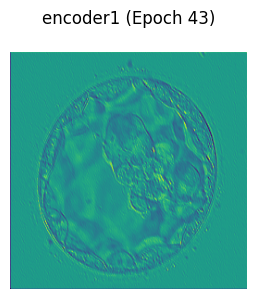

encoder2: torch.Size([3, 16, 128, 128])


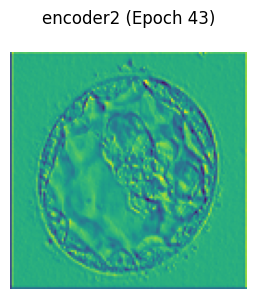

encoder3: torch.Size([3, 24, 64, 64])


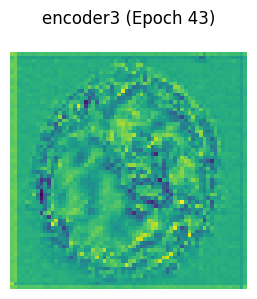

encoder4: torch.Size([3, 32, 32, 32])


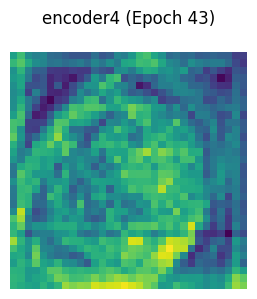

encoder5: torch.Size([3, 48, 16, 16])


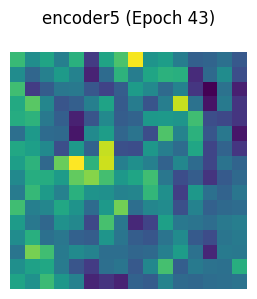

encoder6: torch.Size([3, 64, 8, 8])


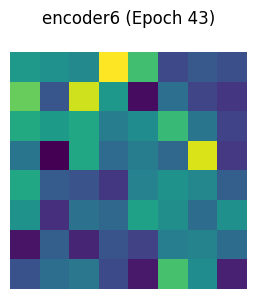

decoder1: torch.Size([3, 48, 8, 8])


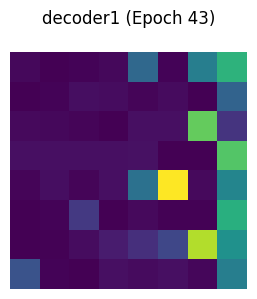

decoder2: torch.Size([3, 32, 8, 8])


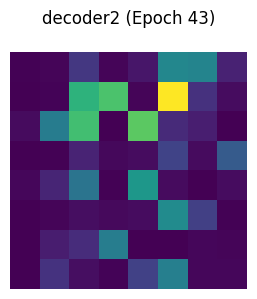

decoder3: torch.Size([3, 24, 16, 16])


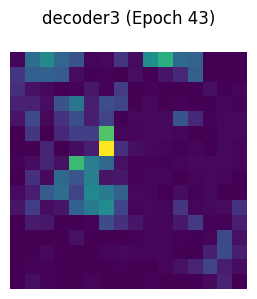

decoder4: torch.Size([3, 16, 32, 32])


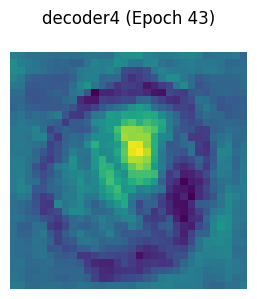

decoder5: torch.Size([3, 8, 64, 64])


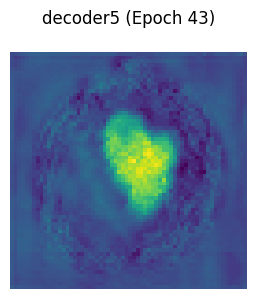

Epoch 43: Loss = 88.1345, Val Dice = 0.8160, Val mIoU = 0.6911, Val Accuracy = 0.9687, Val Sensitivity = 0.8113, Val Specificity = 0.9840


Epoch 44/100: 100%|██████████| 125/125 [01:40<00:00,  1.25it/s]


[Epoch 44] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


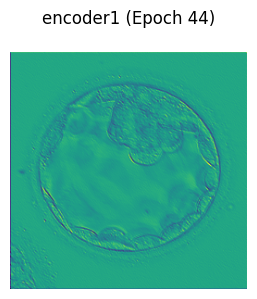

encoder2: torch.Size([3, 16, 128, 128])


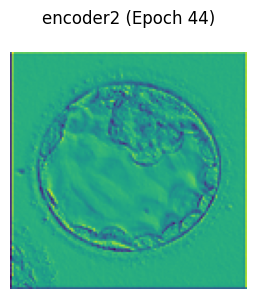

encoder3: torch.Size([3, 24, 64, 64])


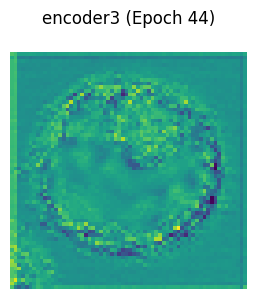

encoder4: torch.Size([3, 32, 32, 32])


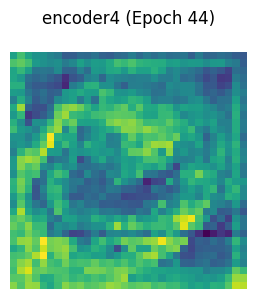

encoder5: torch.Size([3, 48, 16, 16])


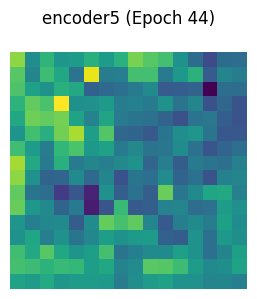

encoder6: torch.Size([3, 64, 8, 8])


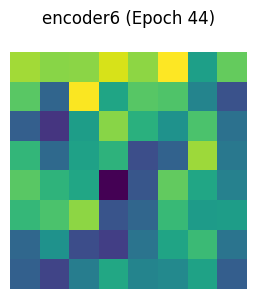

decoder1: torch.Size([3, 48, 8, 8])


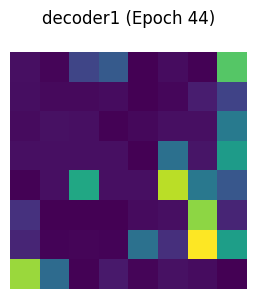

decoder2: torch.Size([3, 32, 8, 8])


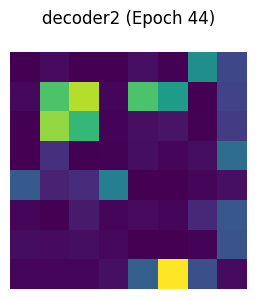

decoder3: torch.Size([3, 24, 16, 16])


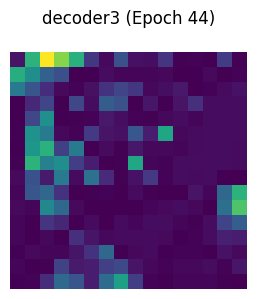

decoder4: torch.Size([3, 16, 32, 32])


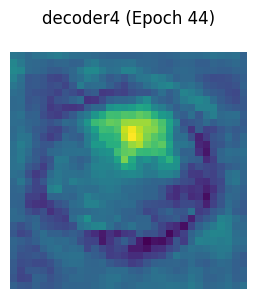

decoder5: torch.Size([3, 8, 64, 64])


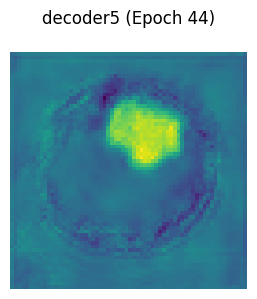

Epoch 44: Loss = 88.0499, Val Dice = 0.8153, Val mIoU = 0.6901, Val Accuracy = 0.9687, Val Sensitivity = 0.8087, Val Specificity = 0.9842


Epoch 45/100: 100%|██████████| 125/125 [01:39<00:00,  1.26it/s]


[Epoch 45] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


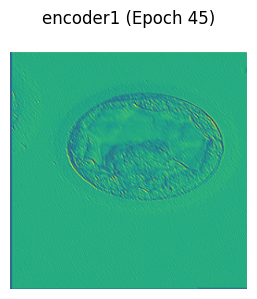

encoder2: torch.Size([3, 16, 128, 128])


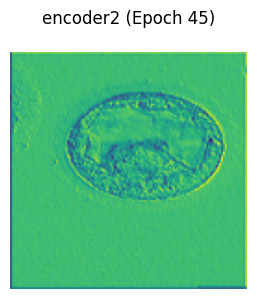

encoder3: torch.Size([3, 24, 64, 64])


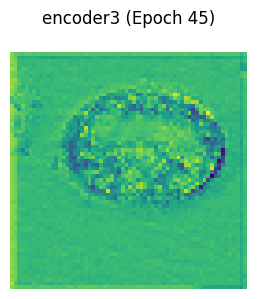

encoder4: torch.Size([3, 32, 32, 32])


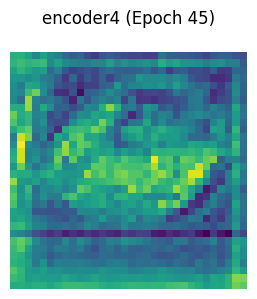

encoder5: torch.Size([3, 48, 16, 16])


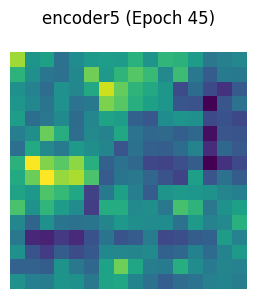

encoder6: torch.Size([3, 64, 8, 8])


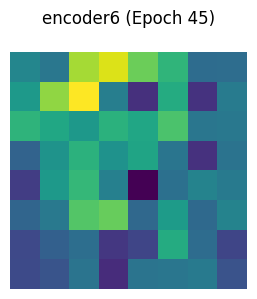

decoder1: torch.Size([3, 48, 8, 8])


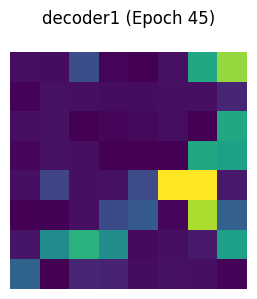

decoder2: torch.Size([3, 32, 8, 8])


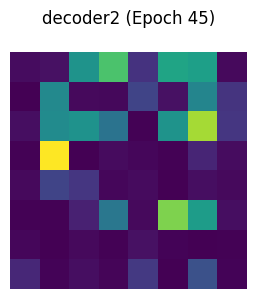

decoder3: torch.Size([3, 24, 16, 16])


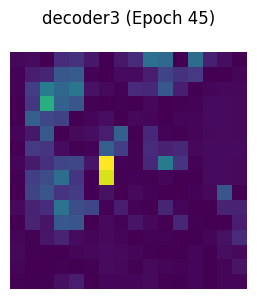

decoder4: torch.Size([3, 16, 32, 32])


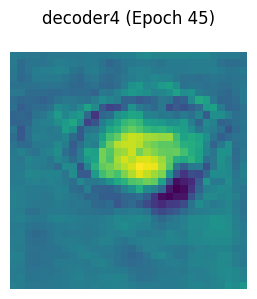

decoder5: torch.Size([3, 8, 64, 64])


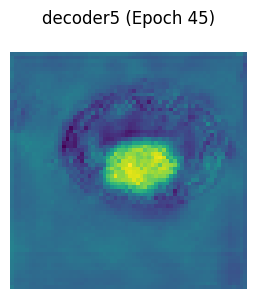

Epoch 45: Loss = 87.9910, Val Dice = 0.8155, Val mIoU = 0.6904, Val Accuracy = 0.9686, Val Sensitivity = 0.8113, Val Specificity = 0.9838


Epoch 46/100: 100%|██████████| 125/125 [01:38<00:00,  1.27it/s]


[Epoch 46] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


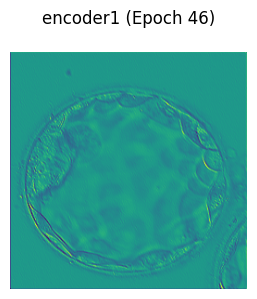

encoder2: torch.Size([3, 16, 128, 128])


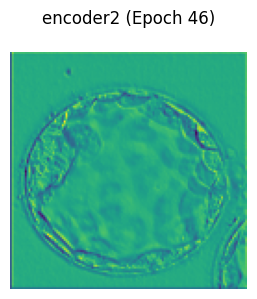

encoder3: torch.Size([3, 24, 64, 64])


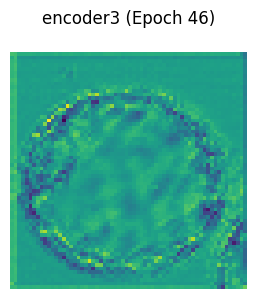

encoder4: torch.Size([3, 32, 32, 32])


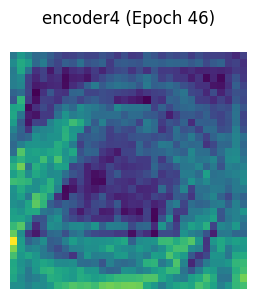

encoder5: torch.Size([3, 48, 16, 16])


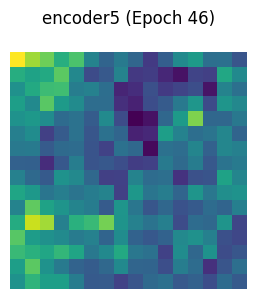

encoder6: torch.Size([3, 64, 8, 8])


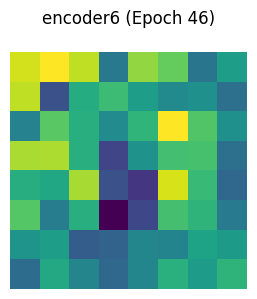

decoder1: torch.Size([3, 48, 8, 8])


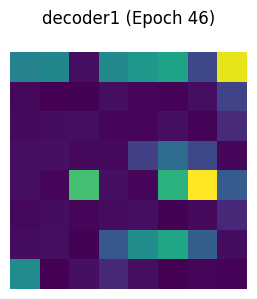

decoder2: torch.Size([3, 32, 8, 8])


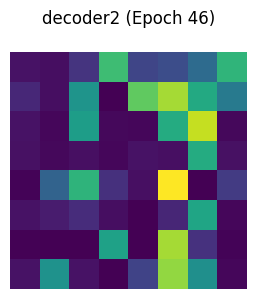

decoder3: torch.Size([3, 24, 16, 16])


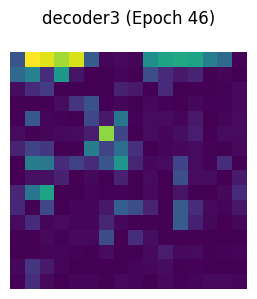

decoder4: torch.Size([3, 16, 32, 32])


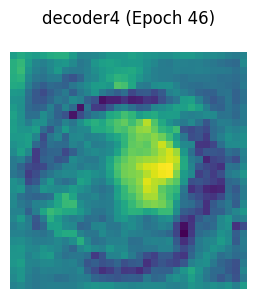

decoder5: torch.Size([3, 8, 64, 64])


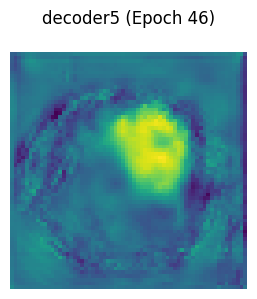

Epoch 46: Loss = 87.9442, Val Dice = 0.8153, Val mIoU = 0.6902, Val Accuracy = 0.9686, Val Sensitivity = 0.8102, Val Specificity = 0.9839


Epoch 47/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 47] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


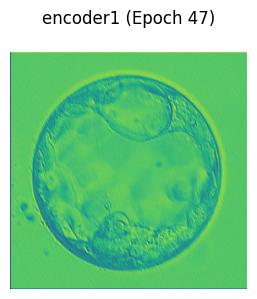

encoder2: torch.Size([3, 16, 128, 128])


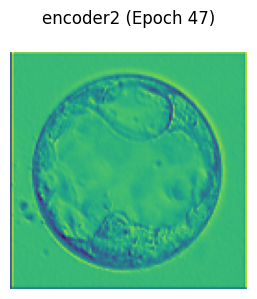

encoder3: torch.Size([3, 24, 64, 64])


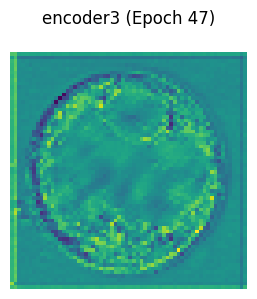

encoder4: torch.Size([3, 32, 32, 32])


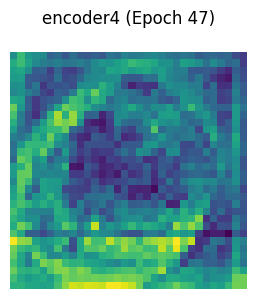

encoder5: torch.Size([3, 48, 16, 16])


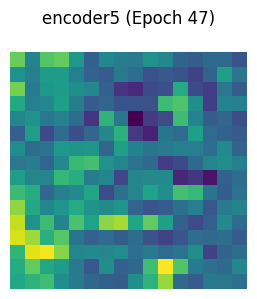

encoder6: torch.Size([3, 64, 8, 8])


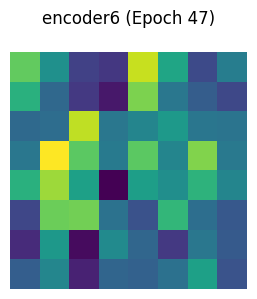

decoder1: torch.Size([3, 48, 8, 8])


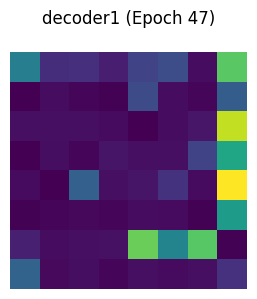

decoder2: torch.Size([3, 32, 8, 8])


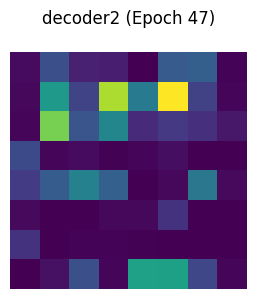

decoder3: torch.Size([3, 24, 16, 16])


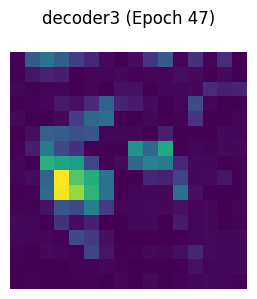

decoder4: torch.Size([3, 16, 32, 32])


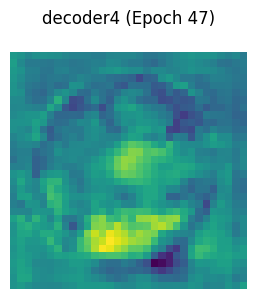

decoder5: torch.Size([3, 8, 64, 64])


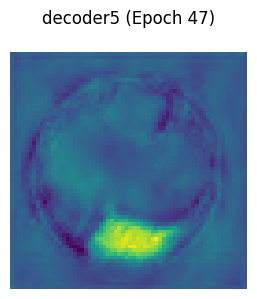

Epoch 47: Loss = 87.8895, Val Dice = 0.8149, Val mIoU = 0.6894, Val Accuracy = 0.9685, Val Sensitivity = 0.8100, Val Specificity = 0.9839


Epoch 48/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 48] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


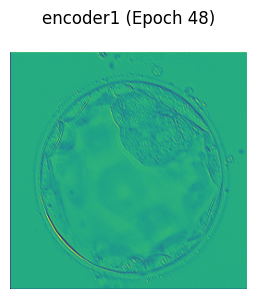

encoder2: torch.Size([3, 16, 128, 128])


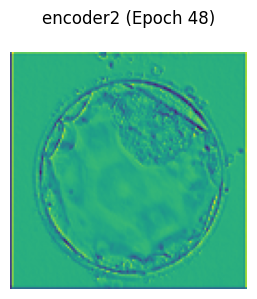

encoder3: torch.Size([3, 24, 64, 64])


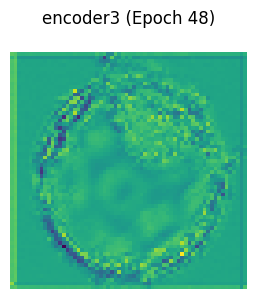

encoder4: torch.Size([3, 32, 32, 32])


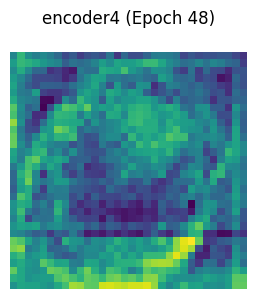

encoder5: torch.Size([3, 48, 16, 16])


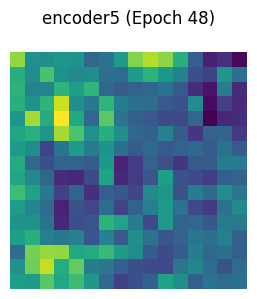

encoder6: torch.Size([3, 64, 8, 8])


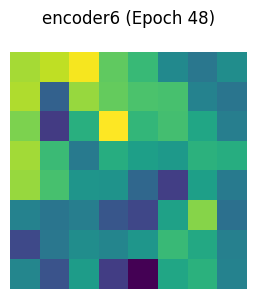

decoder1: torch.Size([3, 48, 8, 8])


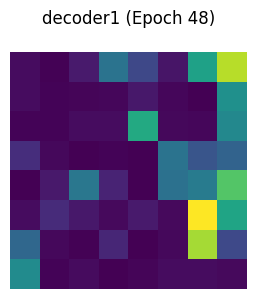

decoder2: torch.Size([3, 32, 8, 8])


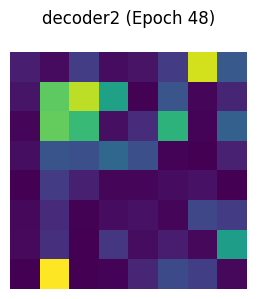

decoder3: torch.Size([3, 24, 16, 16])


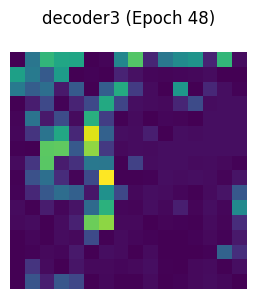

decoder4: torch.Size([3, 16, 32, 32])


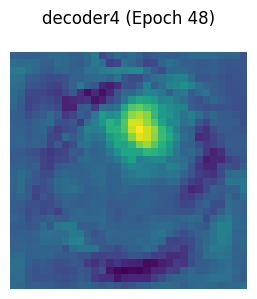

decoder5: torch.Size([3, 8, 64, 64])


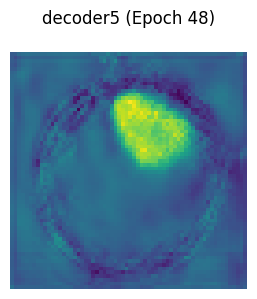

Epoch 48: Loss = 87.8716, Val Dice = 0.8147, Val mIoU = 0.6892, Val Accuracy = 0.9685, Val Sensitivity = 0.8093, Val Specificity = 0.9839


Epoch 49/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 49] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


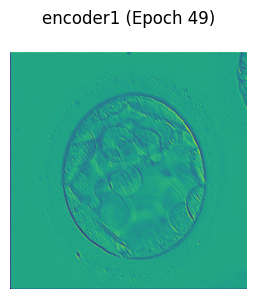

encoder2: torch.Size([3, 16, 128, 128])


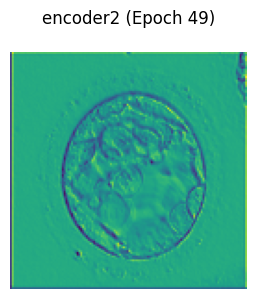

encoder3: torch.Size([3, 24, 64, 64])


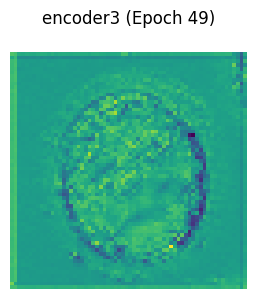

encoder4: torch.Size([3, 32, 32, 32])


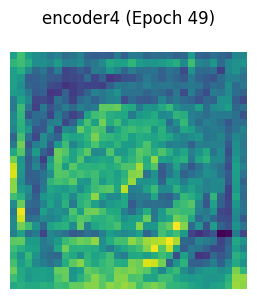

encoder5: torch.Size([3, 48, 16, 16])


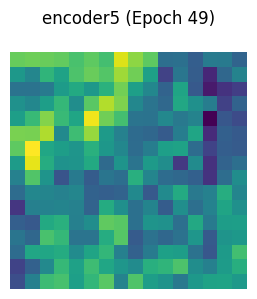

encoder6: torch.Size([3, 64, 8, 8])


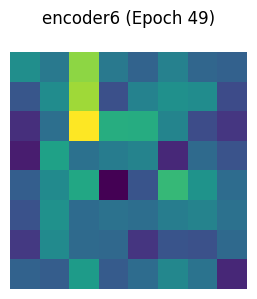

decoder1: torch.Size([3, 48, 8, 8])


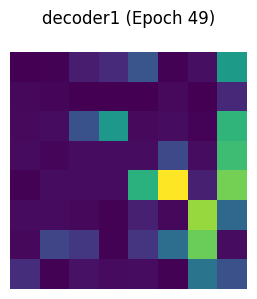

decoder2: torch.Size([3, 32, 8, 8])


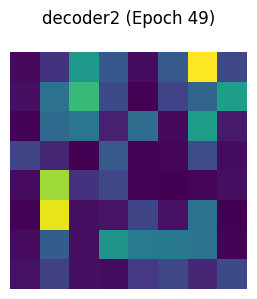

decoder3: torch.Size([3, 24, 16, 16])


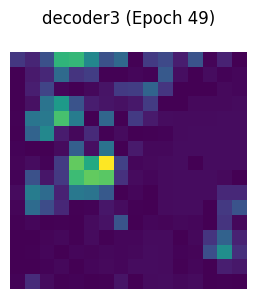

decoder4: torch.Size([3, 16, 32, 32])


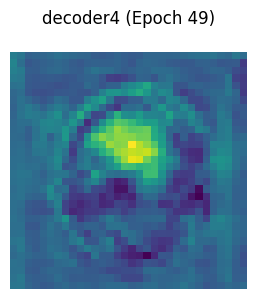

decoder5: torch.Size([3, 8, 64, 64])


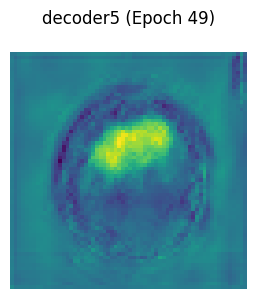

Epoch 49: Loss = 87.8563, Val Dice = 0.8151, Val mIoU = 0.6898, Val Accuracy = 0.9686, Val Sensitivity = 0.8101, Val Specificity = 0.9839


Epoch 50/100: 100%|██████████| 125/125 [01:40<00:00,  1.24it/s]


[Epoch 50] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


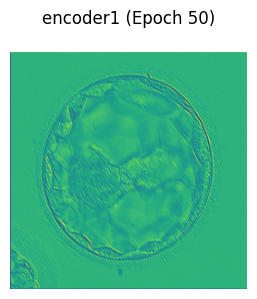

encoder2: torch.Size([3, 16, 128, 128])


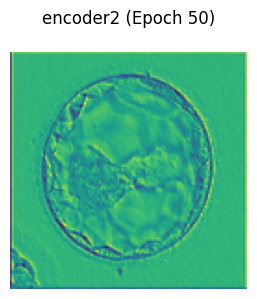

encoder3: torch.Size([3, 24, 64, 64])


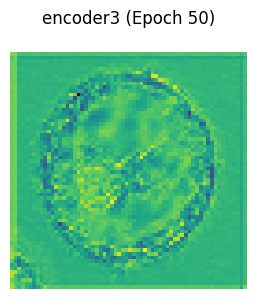

encoder4: torch.Size([3, 32, 32, 32])


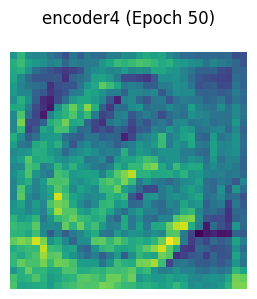

encoder5: torch.Size([3, 48, 16, 16])


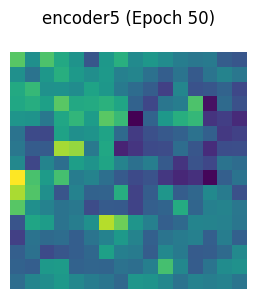

encoder6: torch.Size([3, 64, 8, 8])


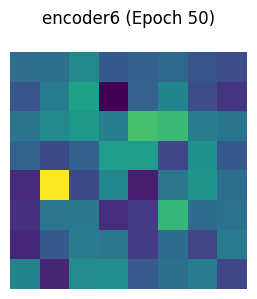

decoder1: torch.Size([3, 48, 8, 8])


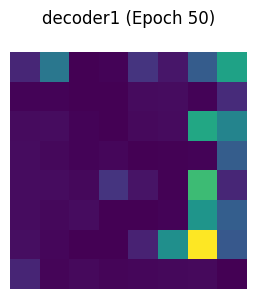

decoder2: torch.Size([3, 32, 8, 8])


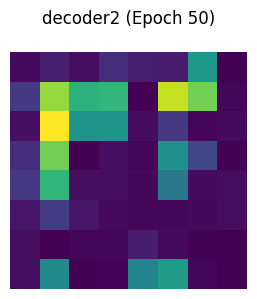

decoder3: torch.Size([3, 24, 16, 16])


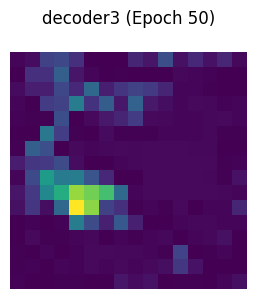

decoder4: torch.Size([3, 16, 32, 32])


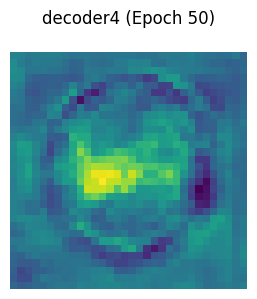

decoder5: torch.Size([3, 8, 64, 64])


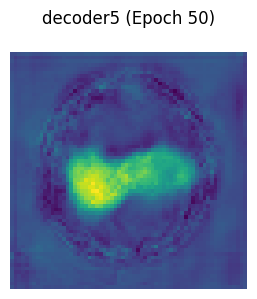

Epoch 50: Loss = 87.8406, Val Dice = 0.8149, Val mIoU = 0.6895, Val Accuracy = 0.9685, Val Sensitivity = 0.8104, Val Specificity = 0.9838


Epoch 51/100: 100%|██████████| 125/125 [01:42<00:00,  1.22it/s]


[Epoch 51] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


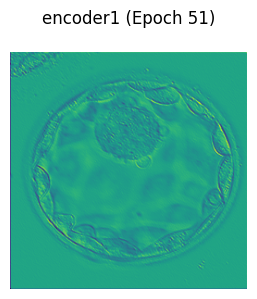

encoder2: torch.Size([3, 16, 128, 128])


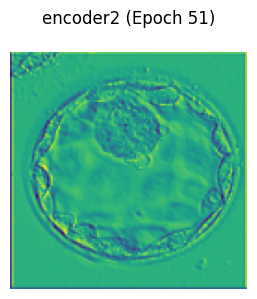

encoder3: torch.Size([3, 24, 64, 64])


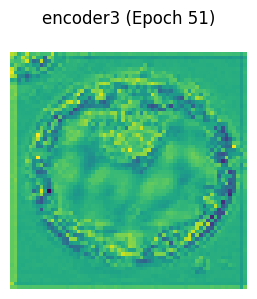

encoder4: torch.Size([3, 32, 32, 32])


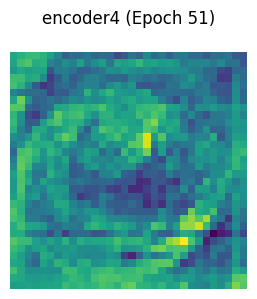

encoder5: torch.Size([3, 48, 16, 16])


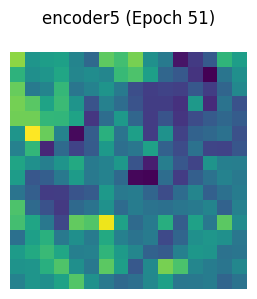

encoder6: torch.Size([3, 64, 8, 8])


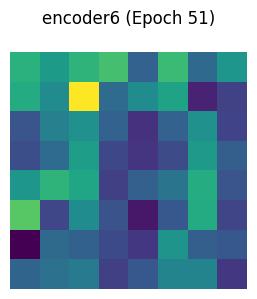

decoder1: torch.Size([3, 48, 8, 8])


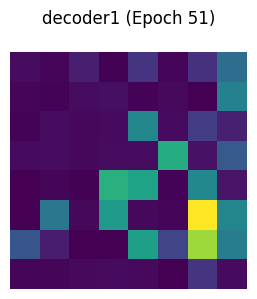

decoder2: torch.Size([3, 32, 8, 8])


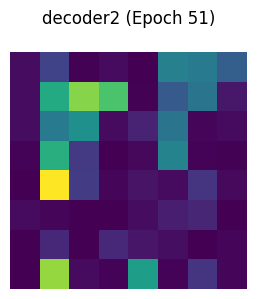

decoder3: torch.Size([3, 24, 16, 16])


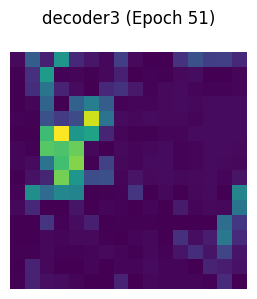

decoder4: torch.Size([3, 16, 32, 32])


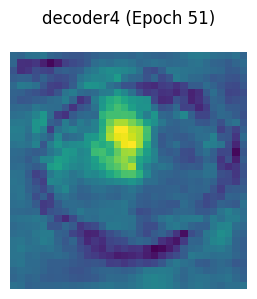

decoder5: torch.Size([3, 8, 64, 64])


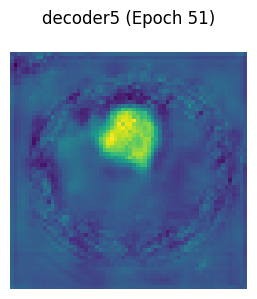

Epoch 51: Loss = 87.8071, Val Dice = 0.8149, Val mIoU = 0.6896, Val Accuracy = 0.9685, Val Sensitivity = 0.8102, Val Specificity = 0.9838


Epoch 52/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 52] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


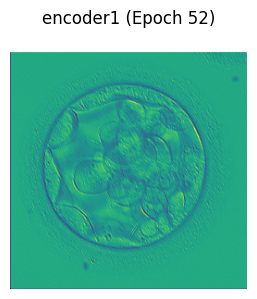

encoder2: torch.Size([3, 16, 128, 128])


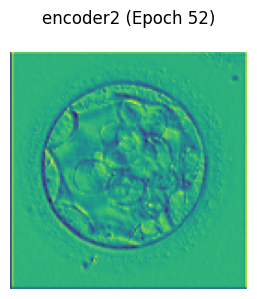

encoder3: torch.Size([3, 24, 64, 64])


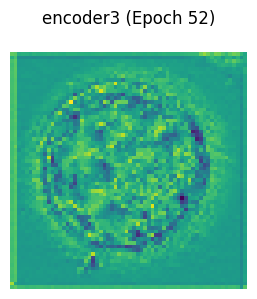

encoder4: torch.Size([3, 32, 32, 32])


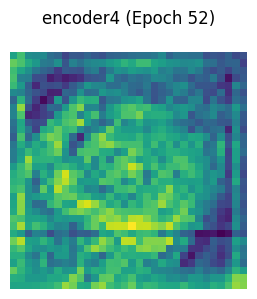

encoder5: torch.Size([3, 48, 16, 16])


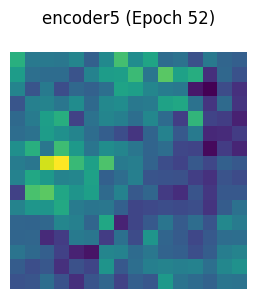

encoder6: torch.Size([3, 64, 8, 8])


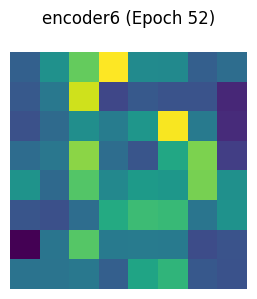

decoder1: torch.Size([3, 48, 8, 8])


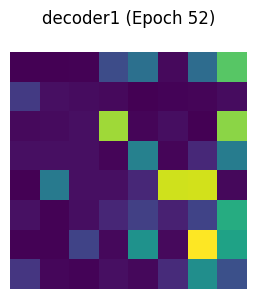

decoder2: torch.Size([3, 32, 8, 8])


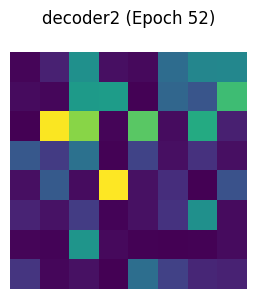

decoder3: torch.Size([3, 24, 16, 16])


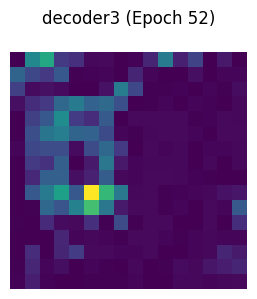

decoder4: torch.Size([3, 16, 32, 32])


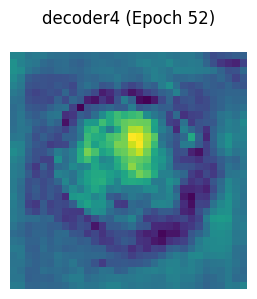

decoder5: torch.Size([3, 8, 64, 64])


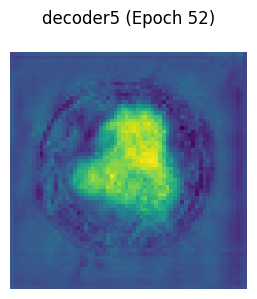

Epoch 52: Loss = 87.8525, Val Dice = 0.8148, Val mIoU = 0.6894, Val Accuracy = 0.9685, Val Sensitivity = 0.8104, Val Specificity = 0.9838


Epoch 53/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 53] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


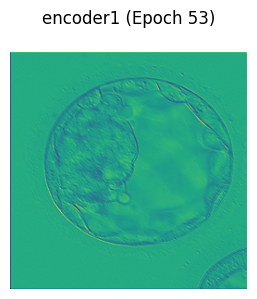

encoder2: torch.Size([3, 16, 128, 128])


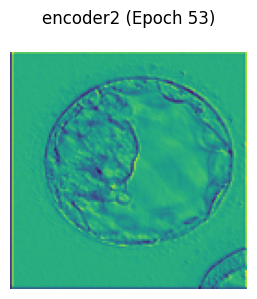

encoder3: torch.Size([3, 24, 64, 64])


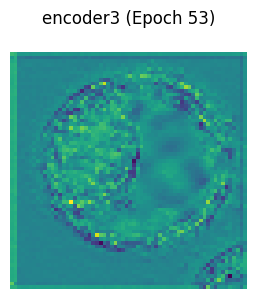

encoder4: torch.Size([3, 32, 32, 32])


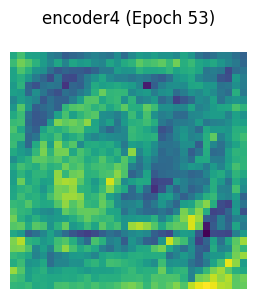

encoder5: torch.Size([3, 48, 16, 16])


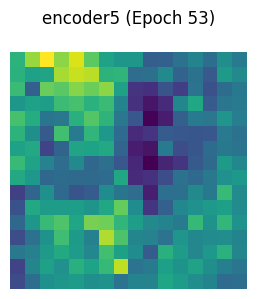

encoder6: torch.Size([3, 64, 8, 8])


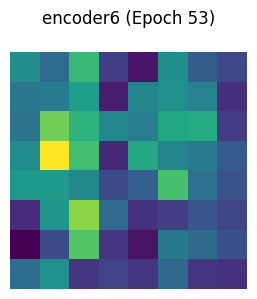

decoder1: torch.Size([3, 48, 8, 8])


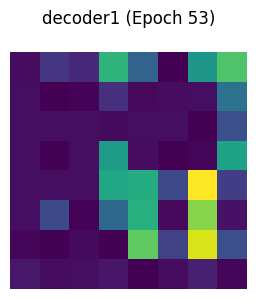

decoder2: torch.Size([3, 32, 8, 8])


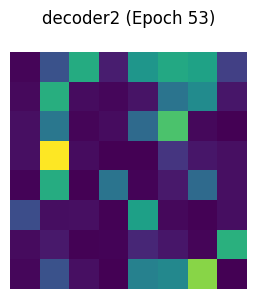

decoder3: torch.Size([3, 24, 16, 16])


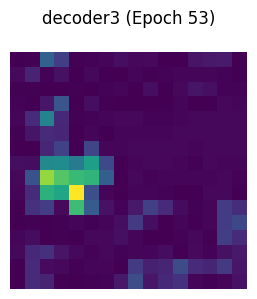

decoder4: torch.Size([3, 16, 32, 32])


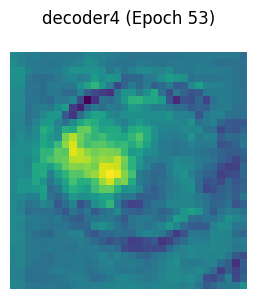

decoder5: torch.Size([3, 8, 64, 64])


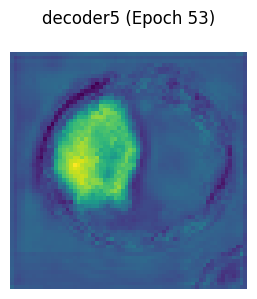

Epoch 53: Loss = 87.8018, Val Dice = 0.8149, Val mIoU = 0.6896, Val Accuracy = 0.9685, Val Sensitivity = 0.8102, Val Specificity = 0.9839


Epoch 54/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 54] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


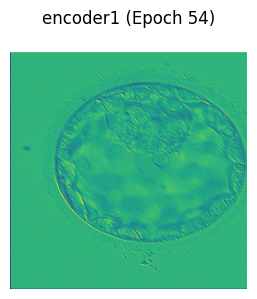

encoder2: torch.Size([3, 16, 128, 128])


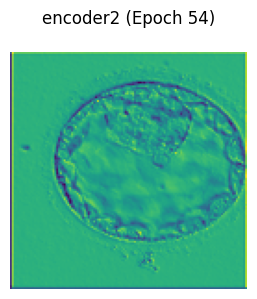

encoder3: torch.Size([3, 24, 64, 64])


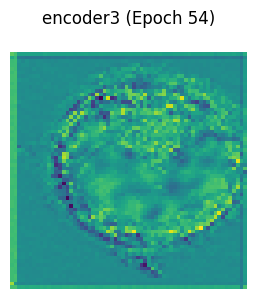

encoder4: torch.Size([3, 32, 32, 32])


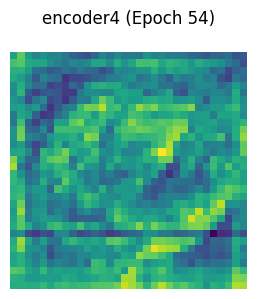

encoder5: torch.Size([3, 48, 16, 16])


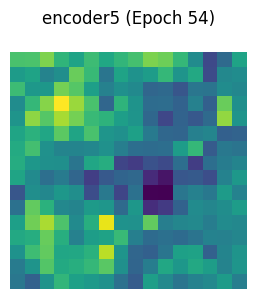

encoder6: torch.Size([3, 64, 8, 8])


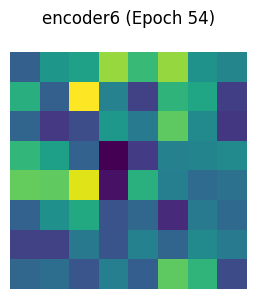

decoder1: torch.Size([3, 48, 8, 8])


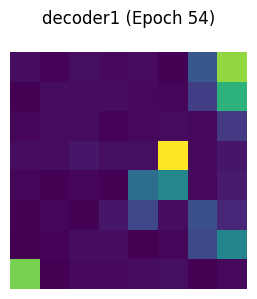

decoder2: torch.Size([3, 32, 8, 8])


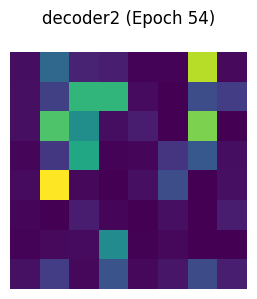

decoder3: torch.Size([3, 24, 16, 16])


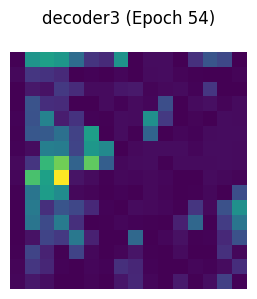

decoder4: torch.Size([3, 16, 32, 32])


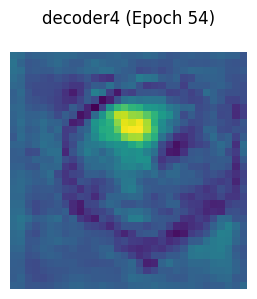

decoder5: torch.Size([3, 8, 64, 64])


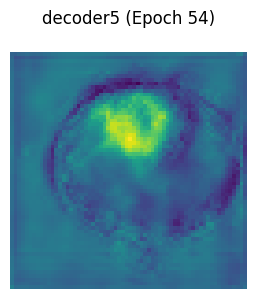

Epoch 54: Loss = 87.7907, Val Dice = 0.8142, Val mIoU = 0.6886, Val Accuracy = 0.9685, Val Sensitivity = 0.8087, Val Specificity = 0.9839


Epoch 55/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 55] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


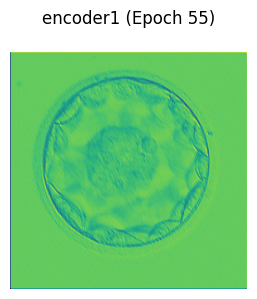

encoder2: torch.Size([3, 16, 128, 128])


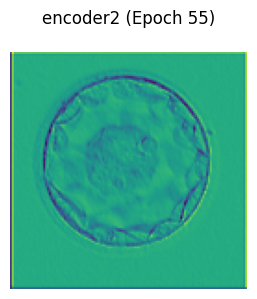

encoder3: torch.Size([3, 24, 64, 64])


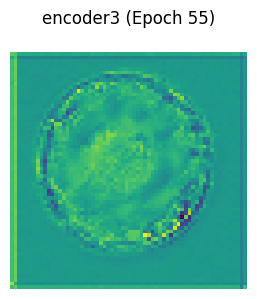

encoder4: torch.Size([3, 32, 32, 32])


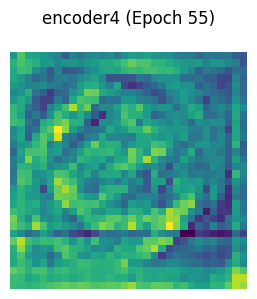

encoder5: torch.Size([3, 48, 16, 16])


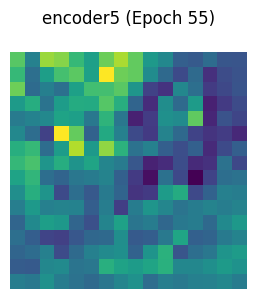

encoder6: torch.Size([3, 64, 8, 8])


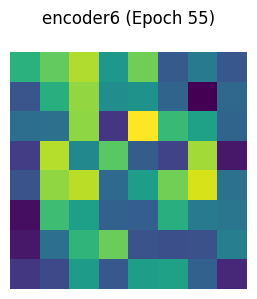

decoder1: torch.Size([3, 48, 8, 8])


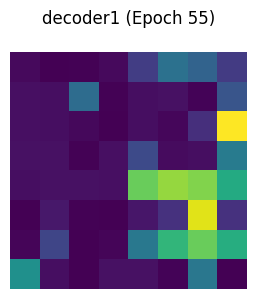

decoder2: torch.Size([3, 32, 8, 8])


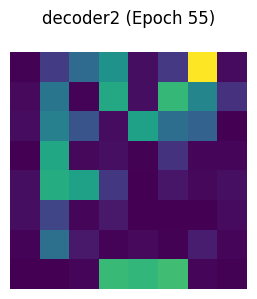

decoder3: torch.Size([3, 24, 16, 16])


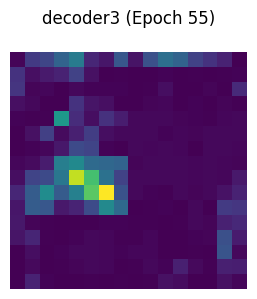

decoder4: torch.Size([3, 16, 32, 32])


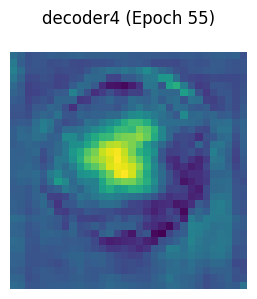

decoder5: torch.Size([3, 8, 64, 64])


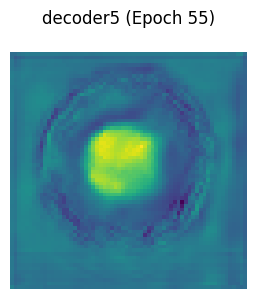

Epoch 55: Loss = 87.8071, Val Dice = 0.8146, Val mIoU = 0.6892, Val Accuracy = 0.9685, Val Sensitivity = 0.8095, Val Specificity = 0.9839


Epoch 56/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 56] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


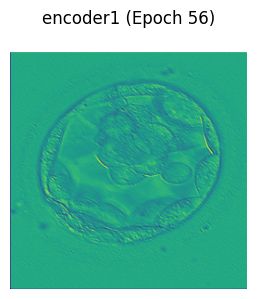

encoder2: torch.Size([3, 16, 128, 128])


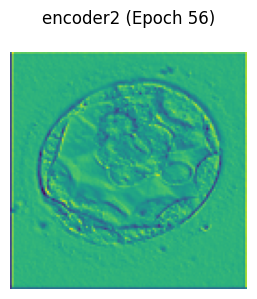

encoder3: torch.Size([3, 24, 64, 64])


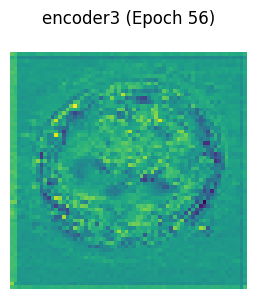

encoder4: torch.Size([3, 32, 32, 32])


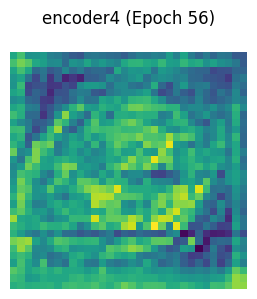

encoder5: torch.Size([3, 48, 16, 16])


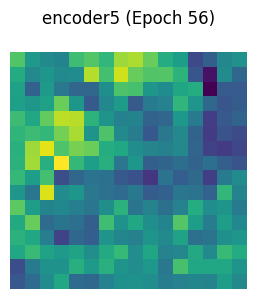

encoder6: torch.Size([3, 64, 8, 8])


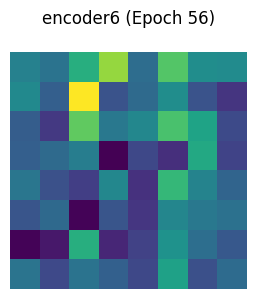

decoder1: torch.Size([3, 48, 8, 8])


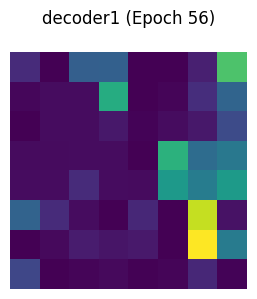

decoder2: torch.Size([3, 32, 8, 8])


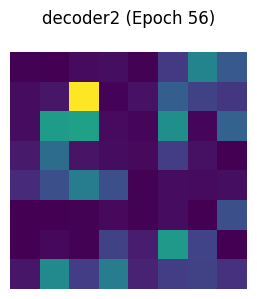

decoder3: torch.Size([3, 24, 16, 16])


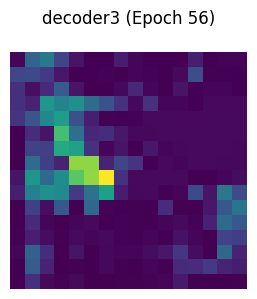

decoder4: torch.Size([3, 16, 32, 32])


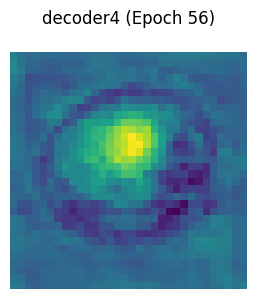

decoder5: torch.Size([3, 8, 64, 64])


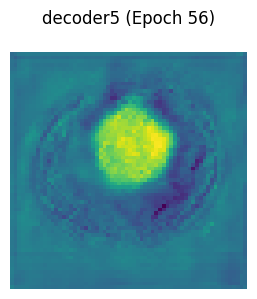

Epoch 56: Loss = 87.7628, Val Dice = 0.8152, Val mIoU = 0.6901, Val Accuracy = 0.9685, Val Sensitivity = 0.8118, Val Specificity = 0.9837


Epoch 57/100: 100%|██████████| 125/125 [01:43<00:00,  1.21it/s]


[Epoch 57] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


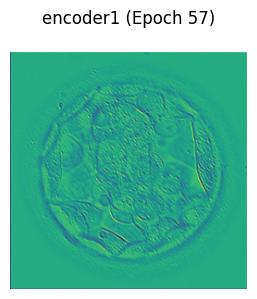

encoder2: torch.Size([3, 16, 128, 128])


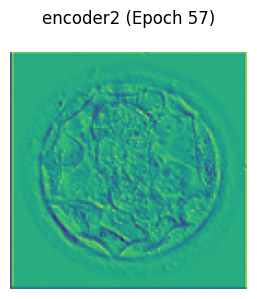

encoder3: torch.Size([3, 24, 64, 64])


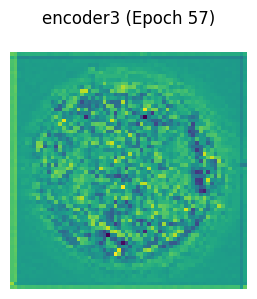

encoder4: torch.Size([3, 32, 32, 32])


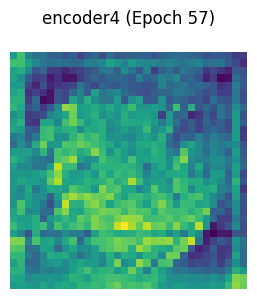

encoder5: torch.Size([3, 48, 16, 16])


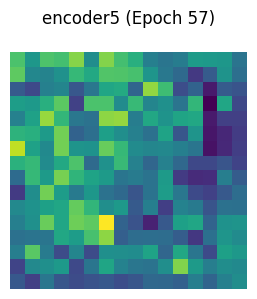

encoder6: torch.Size([3, 64, 8, 8])


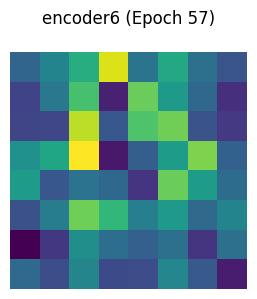

decoder1: torch.Size([3, 48, 8, 8])


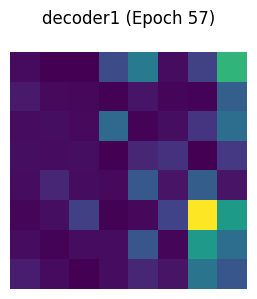

decoder2: torch.Size([3, 32, 8, 8])


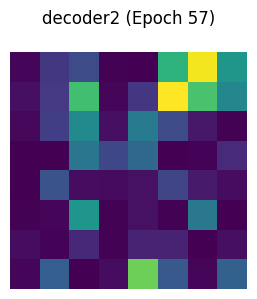

decoder3: torch.Size([3, 24, 16, 16])


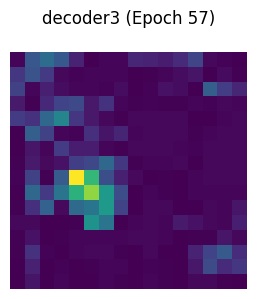

decoder4: torch.Size([3, 16, 32, 32])


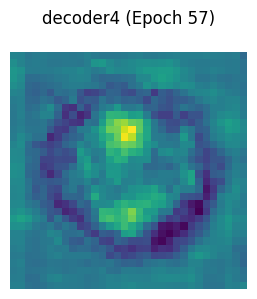

decoder5: torch.Size([3, 8, 64, 64])


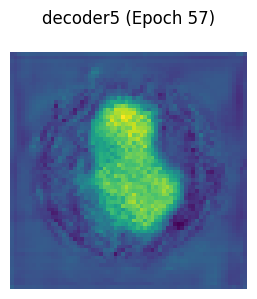

Epoch 57: Loss = 87.7471, Val Dice = 0.8141, Val mIoU = 0.6884, Val Accuracy = 0.9684, Val Sensitivity = 0.8087, Val Specificity = 0.9839


Epoch 58/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 58] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


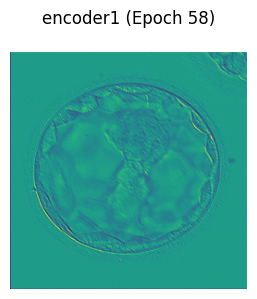

encoder2: torch.Size([3, 16, 128, 128])


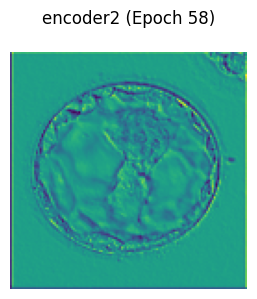

encoder3: torch.Size([3, 24, 64, 64])


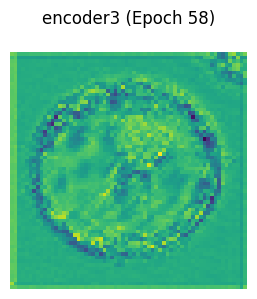

encoder4: torch.Size([3, 32, 32, 32])


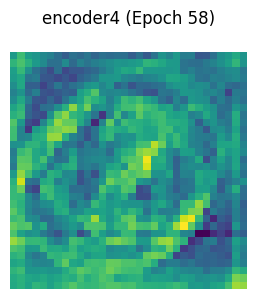

encoder5: torch.Size([3, 48, 16, 16])


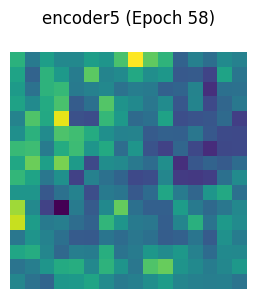

encoder6: torch.Size([3, 64, 8, 8])


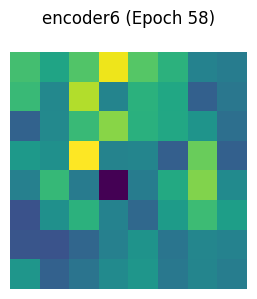

decoder1: torch.Size([3, 48, 8, 8])


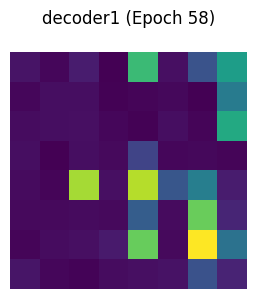

decoder2: torch.Size([3, 32, 8, 8])


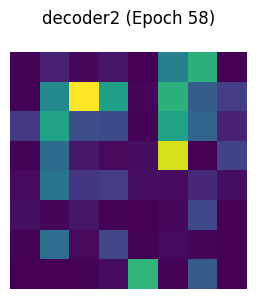

decoder3: torch.Size([3, 24, 16, 16])


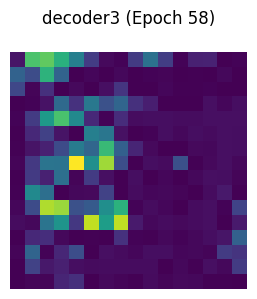

decoder4: torch.Size([3, 16, 32, 32])


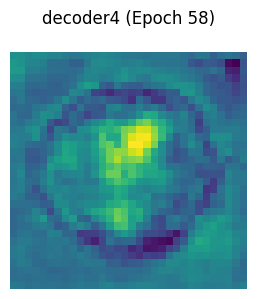

decoder5: torch.Size([3, 8, 64, 64])


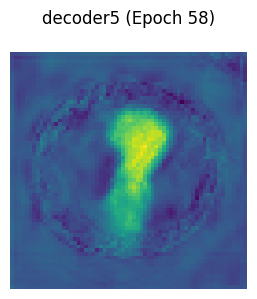

Epoch 58: Loss = 87.7741, Val Dice = 0.8136, Val mIoU = 0.6878, Val Accuracy = 0.9684, Val Sensitivity = 0.8077, Val Specificity = 0.9839


Epoch 59/100: 100%|██████████| 125/125 [01:44<00:00,  1.19it/s]


[Epoch 59] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


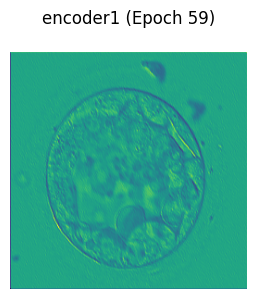

encoder2: torch.Size([3, 16, 128, 128])


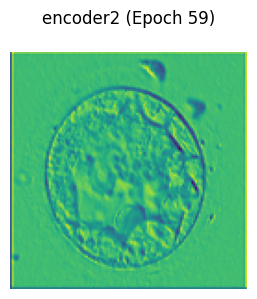

encoder3: torch.Size([3, 24, 64, 64])


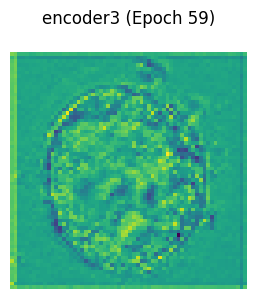

encoder4: torch.Size([3, 32, 32, 32])


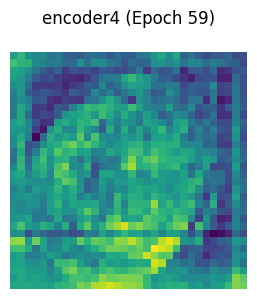

encoder5: torch.Size([3, 48, 16, 16])


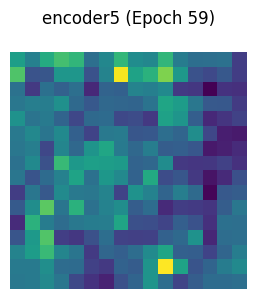

encoder6: torch.Size([3, 64, 8, 8])


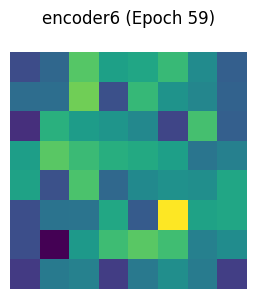

decoder1: torch.Size([3, 48, 8, 8])


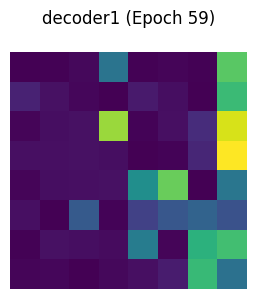

decoder2: torch.Size([3, 32, 8, 8])


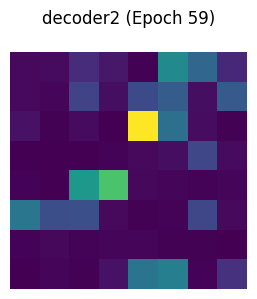

decoder3: torch.Size([3, 24, 16, 16])


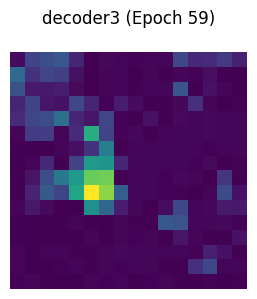

decoder4: torch.Size([3, 16, 32, 32])


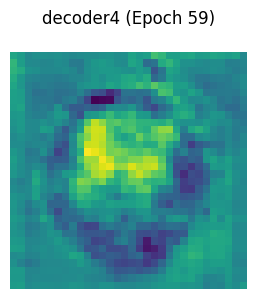

decoder5: torch.Size([3, 8, 64, 64])


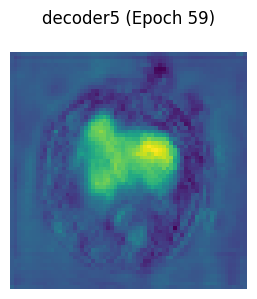

Epoch 59: Loss = 87.9243, Val Dice = 0.8154, Val mIoU = 0.6900, Val Accuracy = 0.9688, Val Sensitivity = 0.8060, Val Specificity = 0.9845


Epoch 60/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 60] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


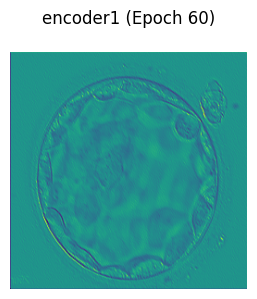

encoder2: torch.Size([3, 16, 128, 128])


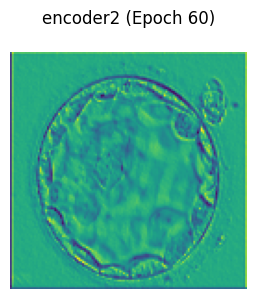

encoder3: torch.Size([3, 24, 64, 64])


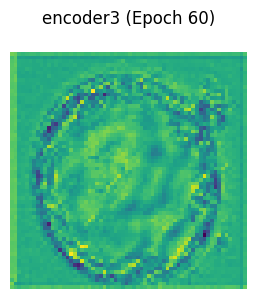

encoder4: torch.Size([3, 32, 32, 32])


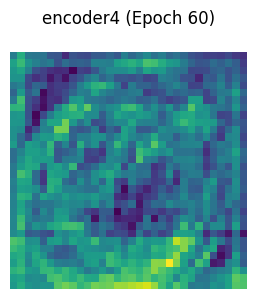

encoder5: torch.Size([3, 48, 16, 16])


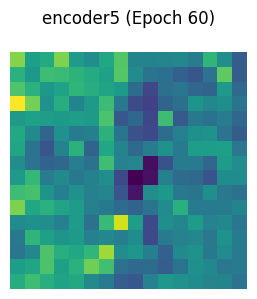

encoder6: torch.Size([3, 64, 8, 8])


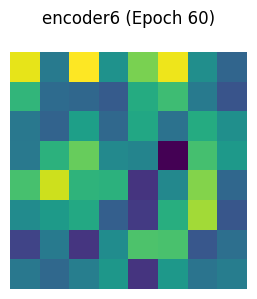

decoder1: torch.Size([3, 48, 8, 8])


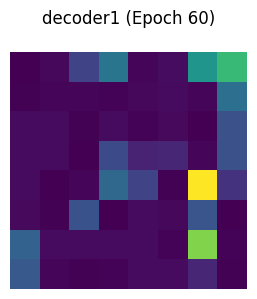

decoder2: torch.Size([3, 32, 8, 8])


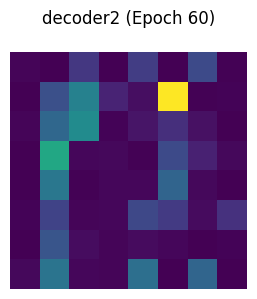

decoder3: torch.Size([3, 24, 16, 16])


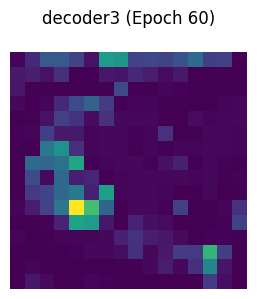

decoder4: torch.Size([3, 16, 32, 32])


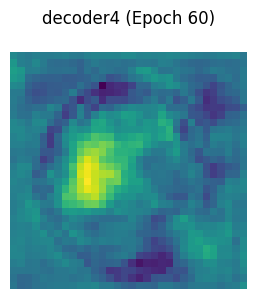

decoder5: torch.Size([3, 8, 64, 64])


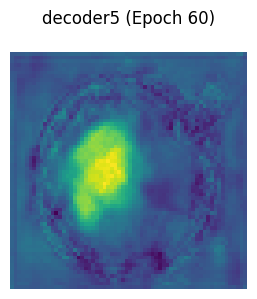

Epoch 60: Loss = 88.0460, Val Dice = 0.8114, Val mIoU = 0.6845, Val Accuracy = 0.9677, Val Sensitivity = 0.8111, Val Specificity = 0.9830


Epoch 61/100: 100%|██████████| 125/125 [01:44<00:00,  1.20it/s]


[Epoch 61] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


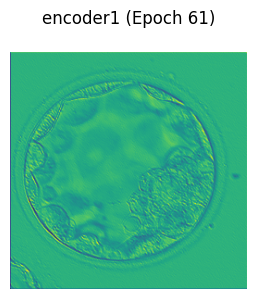

encoder2: torch.Size([3, 16, 128, 128])


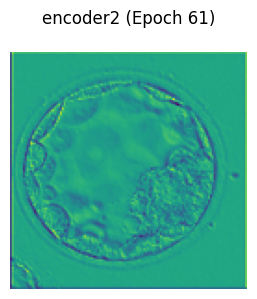

encoder3: torch.Size([3, 24, 64, 64])


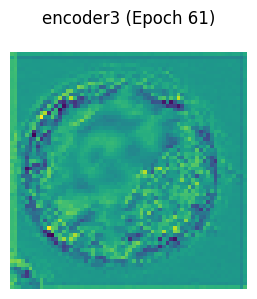

encoder4: torch.Size([3, 32, 32, 32])


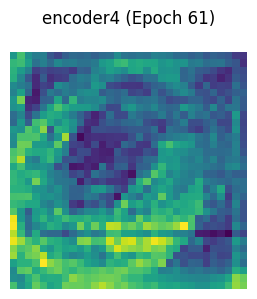

encoder5: torch.Size([3, 48, 16, 16])


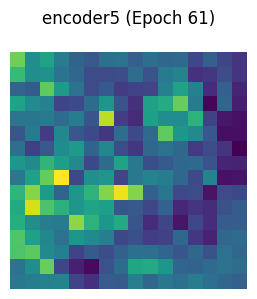

encoder6: torch.Size([3, 64, 8, 8])


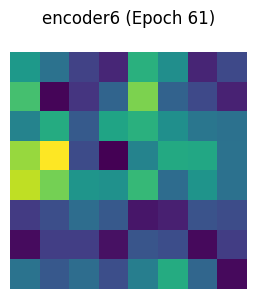

decoder1: torch.Size([3, 48, 8, 8])


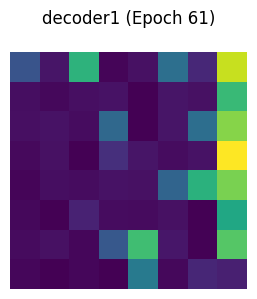

decoder2: torch.Size([3, 32, 8, 8])


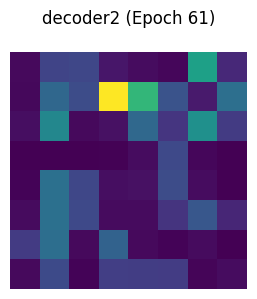

decoder3: torch.Size([3, 24, 16, 16])


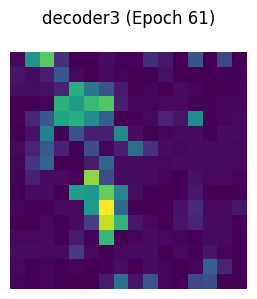

decoder4: torch.Size([3, 16, 32, 32])


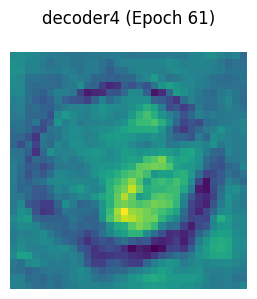

decoder5: torch.Size([3, 8, 64, 64])


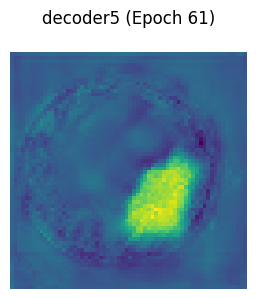

Epoch 61: Loss = 88.2093, Val Dice = 0.8123, Val mIoU = 0.6854, Val Accuracy = 0.9682, Val Sensitivity = 0.8032, Val Specificity = 0.9843


Epoch 62/100: 100%|██████████| 125/125 [01:43<00:00,  1.20it/s]


[Epoch 62] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


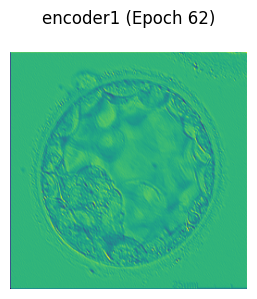

encoder2: torch.Size([3, 16, 128, 128])


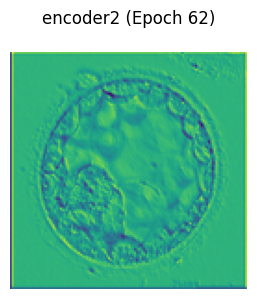

encoder3: torch.Size([3, 24, 64, 64])


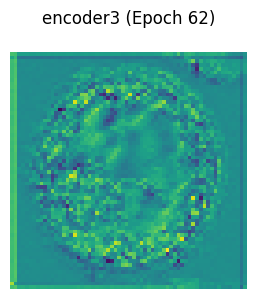

encoder4: torch.Size([3, 32, 32, 32])


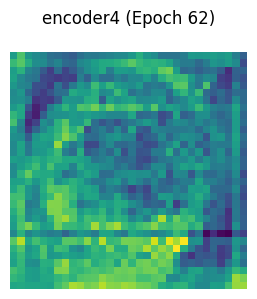

encoder5: torch.Size([3, 48, 16, 16])


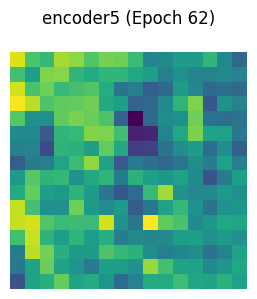

encoder6: torch.Size([3, 64, 8, 8])


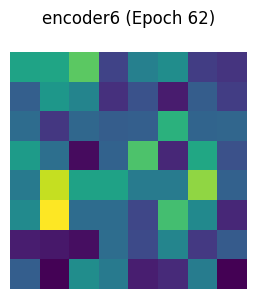

decoder1: torch.Size([3, 48, 8, 8])


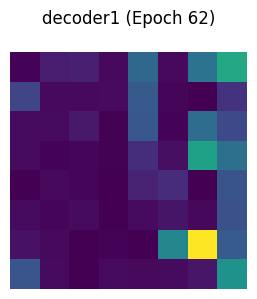

decoder2: torch.Size([3, 32, 8, 8])


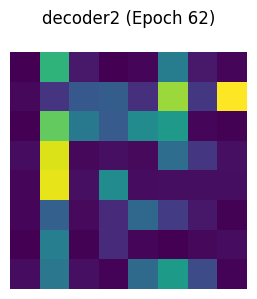

decoder3: torch.Size([3, 24, 16, 16])


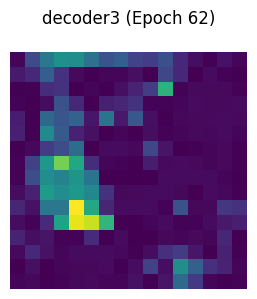

decoder4: torch.Size([3, 16, 32, 32])


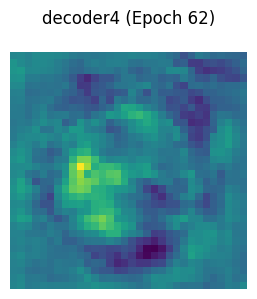

decoder5: torch.Size([3, 8, 64, 64])


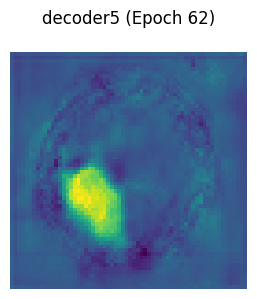

Epoch 62: Loss = 88.2832, Val Dice = 0.8135, Val mIoU = 0.6876, Val Accuracy = 0.9679, Val Sensitivity = 0.8158, Val Specificity = 0.9827


Epoch 63/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 63] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


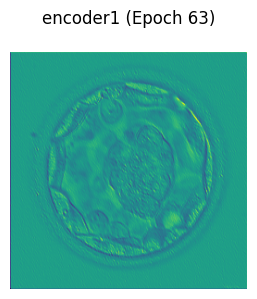

encoder2: torch.Size([3, 16, 128, 128])


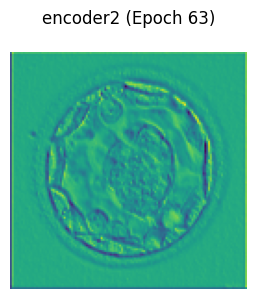

encoder3: torch.Size([3, 24, 64, 64])


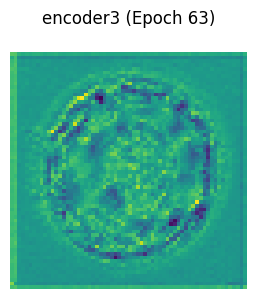

encoder4: torch.Size([3, 32, 32, 32])


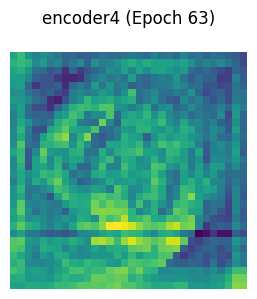

encoder5: torch.Size([3, 48, 16, 16])


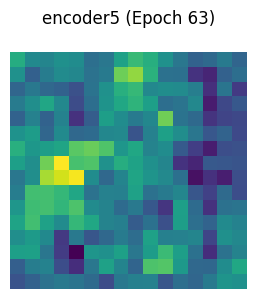

encoder6: torch.Size([3, 64, 8, 8])


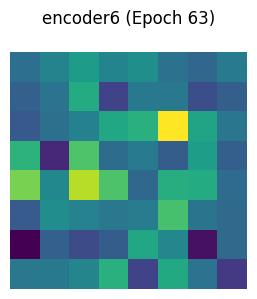

decoder1: torch.Size([3, 48, 8, 8])


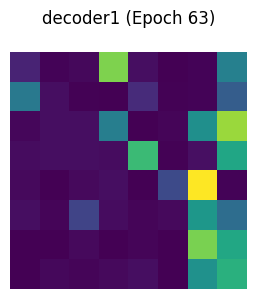

decoder2: torch.Size([3, 32, 8, 8])


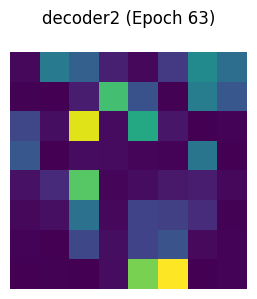

decoder3: torch.Size([3, 24, 16, 16])


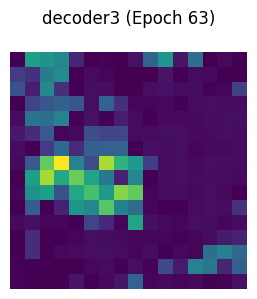

decoder4: torch.Size([3, 16, 32, 32])


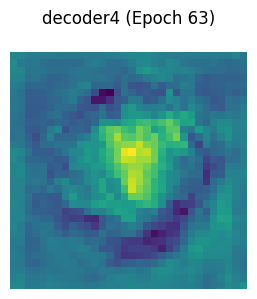

decoder5: torch.Size([3, 8, 64, 64])


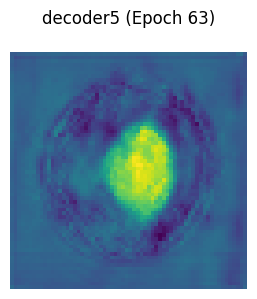

Epoch 63: Loss = 88.3648, Val Dice = 0.8155, Val mIoU = 0.6909, Val Accuracy = 0.9686, Val Sensitivity = 0.8147, Val Specificity = 0.9833


Epoch 64/100: 100%|██████████| 125/125 [01:45<00:00,  1.19it/s]


[Epoch 64] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


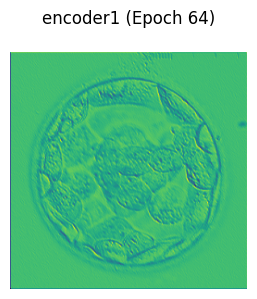

encoder2: torch.Size([3, 16, 128, 128])


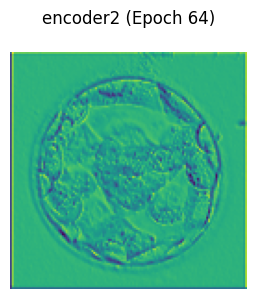

encoder3: torch.Size([3, 24, 64, 64])


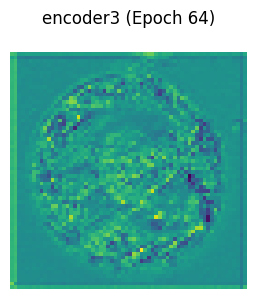

encoder4: torch.Size([3, 32, 32, 32])


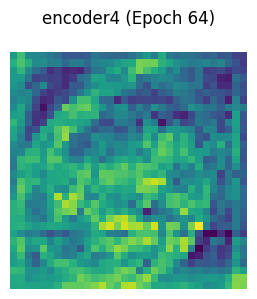

encoder5: torch.Size([3, 48, 16, 16])


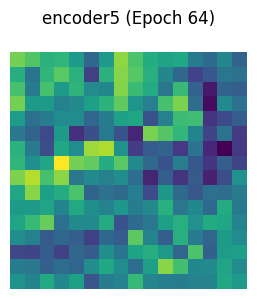

encoder6: torch.Size([3, 64, 8, 8])


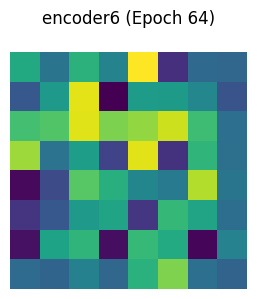

decoder1: torch.Size([3, 48, 8, 8])


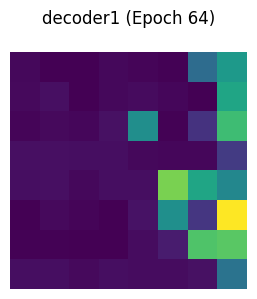

decoder2: torch.Size([3, 32, 8, 8])


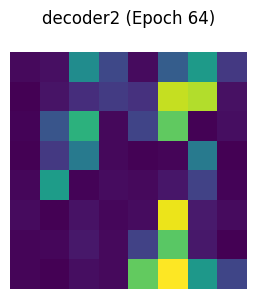

decoder3: torch.Size([3, 24, 16, 16])


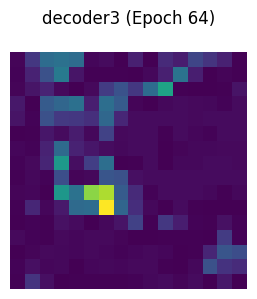

decoder4: torch.Size([3, 16, 32, 32])


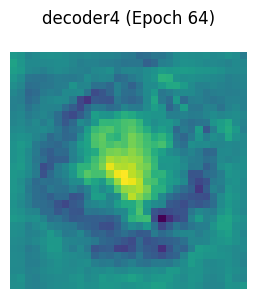

decoder5: torch.Size([3, 8, 64, 64])


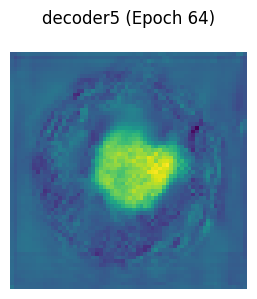

Epoch 64: Loss = 88.5462, Val Dice = 0.8143, Val mIoU = 0.6883, Val Accuracy = 0.9684, Val Sensitivity = 0.8098, Val Specificity = 0.9838


Epoch 65/100: 100%|██████████| 125/125 [01:46<00:00,  1.17it/s]


[Epoch 65] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


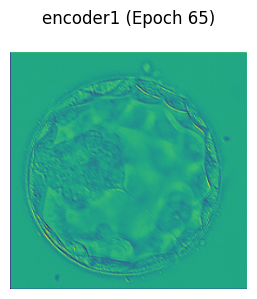

encoder2: torch.Size([3, 16, 128, 128])


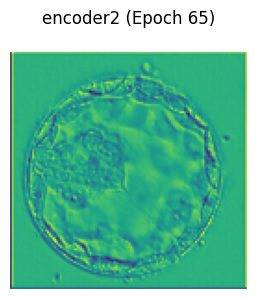

encoder3: torch.Size([3, 24, 64, 64])


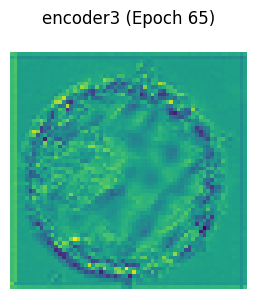

encoder4: torch.Size([3, 32, 32, 32])


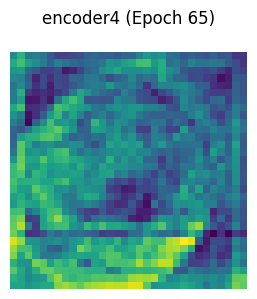

encoder5: torch.Size([3, 48, 16, 16])


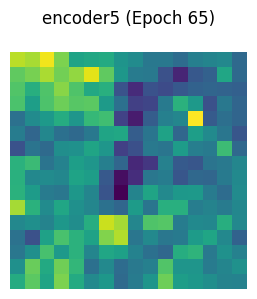

encoder6: torch.Size([3, 64, 8, 8])


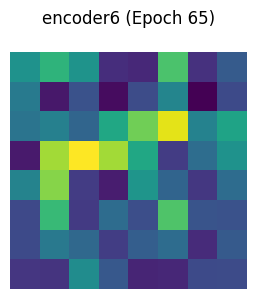

decoder1: torch.Size([3, 48, 8, 8])


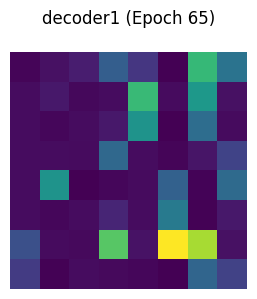

decoder2: torch.Size([3, 32, 8, 8])


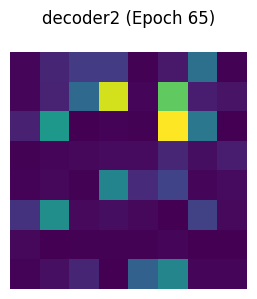

decoder3: torch.Size([3, 24, 16, 16])


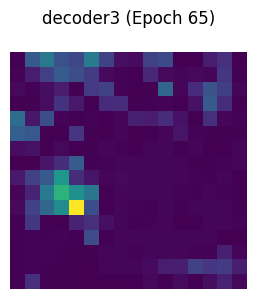

decoder4: torch.Size([3, 16, 32, 32])


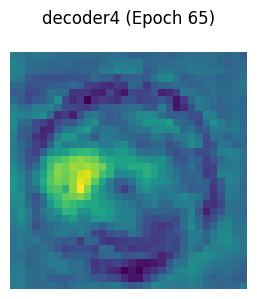

decoder5: torch.Size([3, 8, 64, 64])


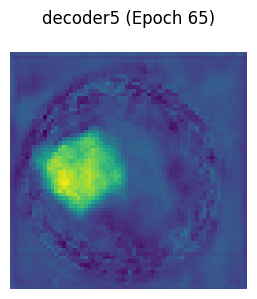

Epoch 65: Loss = 88.5469, Val Dice = 0.8165, Val mIoU = 0.6920, Val Accuracy = 0.9689, Val Sensitivity = 0.8105, Val Specificity = 0.9841


Epoch 66/100: 100%|██████████| 125/125 [01:47<00:00,  1.17it/s]


[Epoch 66] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


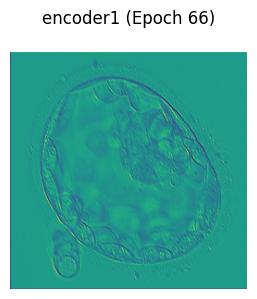

encoder2: torch.Size([3, 16, 128, 128])


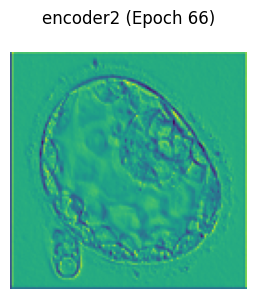

encoder3: torch.Size([3, 24, 64, 64])


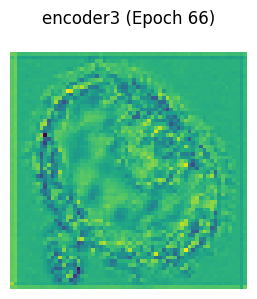

encoder4: torch.Size([3, 32, 32, 32])


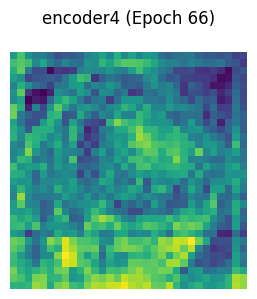

encoder5: torch.Size([3, 48, 16, 16])


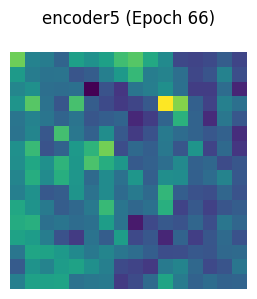

encoder6: torch.Size([3, 64, 8, 8])


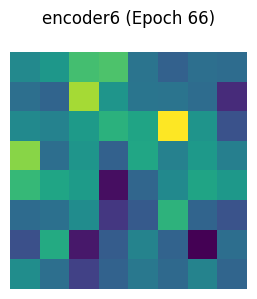

decoder1: torch.Size([3, 48, 8, 8])


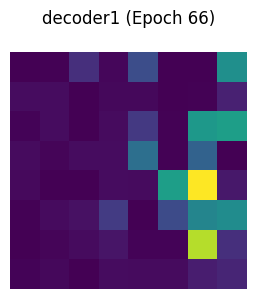

decoder2: torch.Size([3, 32, 8, 8])


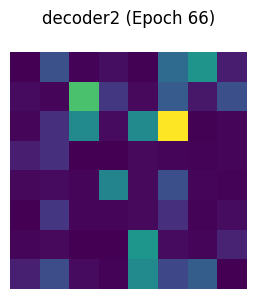

decoder3: torch.Size([3, 24, 16, 16])


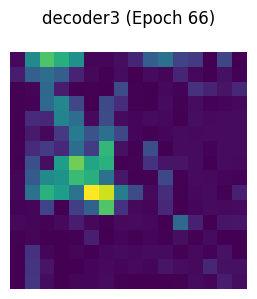

decoder4: torch.Size([3, 16, 32, 32])


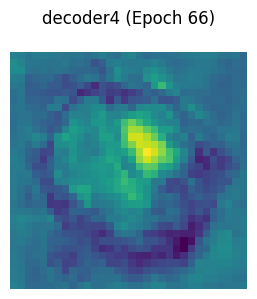

decoder5: torch.Size([3, 8, 64, 64])


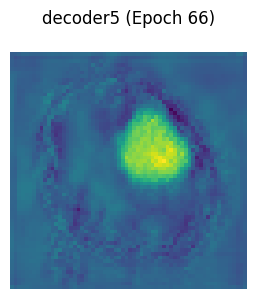

Epoch 66: Loss = 88.6004, Val Dice = 0.8166, Val mIoU = 0.6920, Val Accuracy = 0.9686, Val Sensitivity = 0.8157, Val Specificity = 0.9835


Epoch 67/100: 100%|██████████| 125/125 [01:46<00:00,  1.17it/s]


[Epoch 67] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


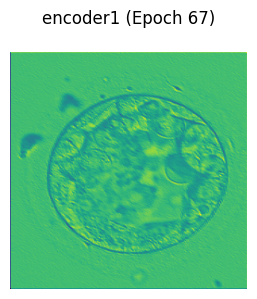

encoder2: torch.Size([3, 16, 128, 128])


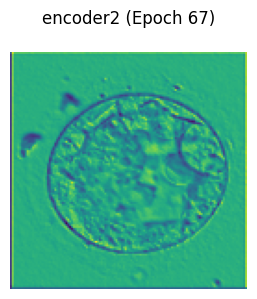

encoder3: torch.Size([3, 24, 64, 64])


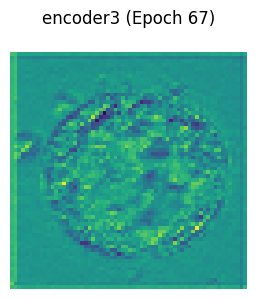

encoder4: torch.Size([3, 32, 32, 32])


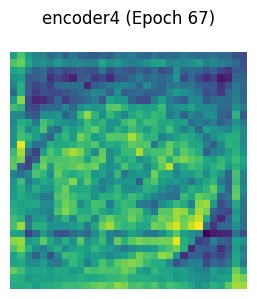

encoder5: torch.Size([3, 48, 16, 16])


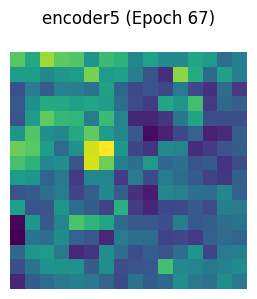

encoder6: torch.Size([3, 64, 8, 8])


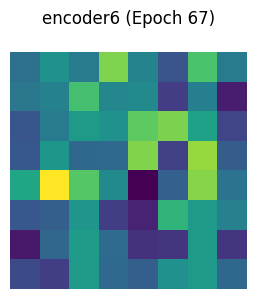

decoder1: torch.Size([3, 48, 8, 8])


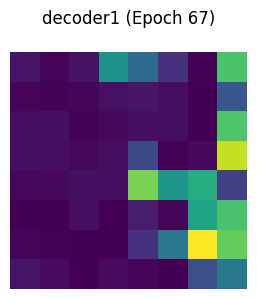

decoder2: torch.Size([3, 32, 8, 8])


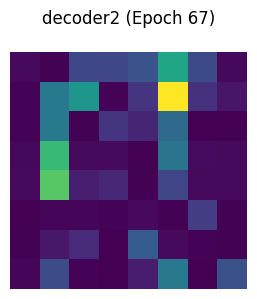

decoder3: torch.Size([3, 24, 16, 16])


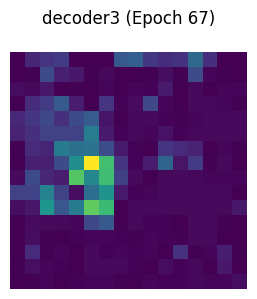

decoder4: torch.Size([3, 16, 32, 32])


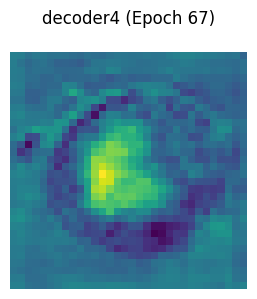

decoder5: torch.Size([3, 8, 64, 64])


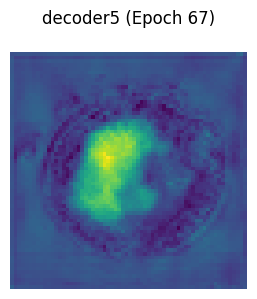

Epoch 67: Loss = 88.6885, Val Dice = 0.8175, Val mIoU = 0.6934, Val Accuracy = 0.9690, Val Sensitivity = 0.8117, Val Specificity = 0.9842


Epoch 68/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 68] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


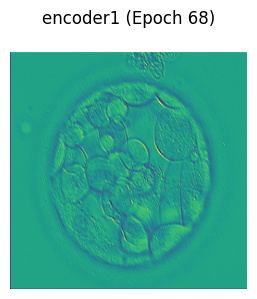

encoder2: torch.Size([3, 16, 128, 128])


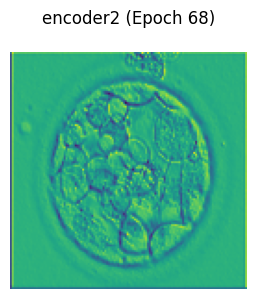

encoder3: torch.Size([3, 24, 64, 64])


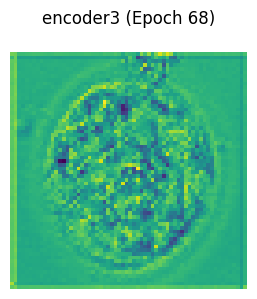

encoder4: torch.Size([3, 32, 32, 32])


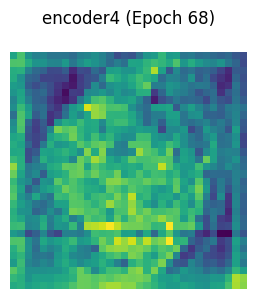

encoder5: torch.Size([3, 48, 16, 16])


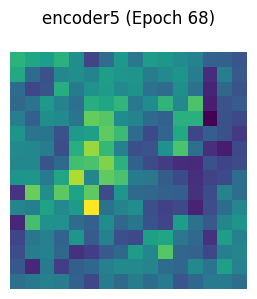

encoder6: torch.Size([3, 64, 8, 8])


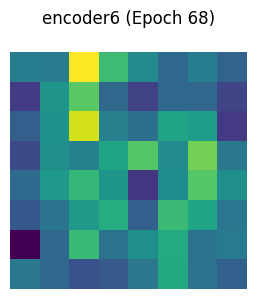

decoder1: torch.Size([3, 48, 8, 8])


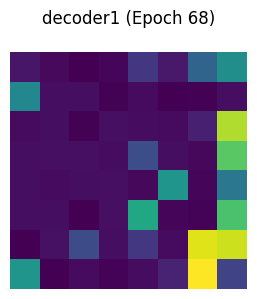

decoder2: torch.Size([3, 32, 8, 8])


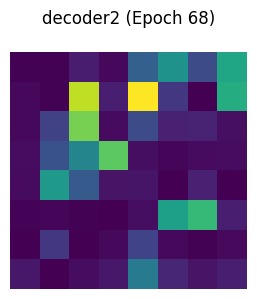

decoder3: torch.Size([3, 24, 16, 16])


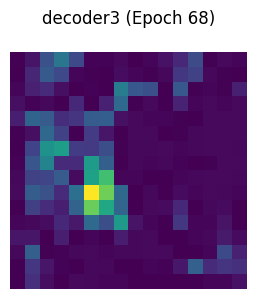

decoder4: torch.Size([3, 16, 32, 32])


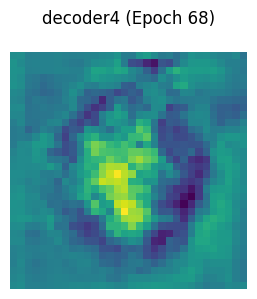

decoder5: torch.Size([3, 8, 64, 64])


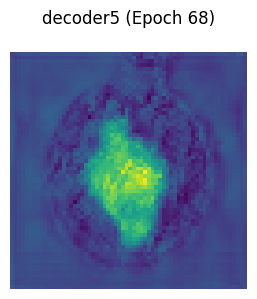

Epoch 68: Loss = 88.9472, Val Dice = 0.8148, Val mIoU = 0.6892, Val Accuracy = 0.9688, Val Sensitivity = 0.8006, Val Specificity = 0.9851


Epoch 69/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 69] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


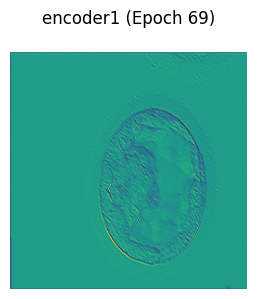

encoder2: torch.Size([3, 16, 128, 128])


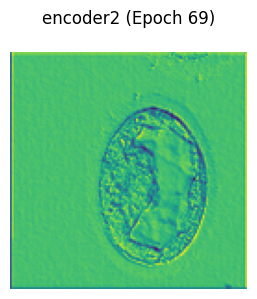

encoder3: torch.Size([3, 24, 64, 64])


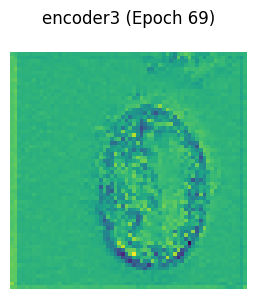

encoder4: torch.Size([3, 32, 32, 32])


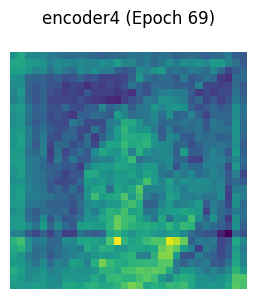

encoder5: torch.Size([3, 48, 16, 16])


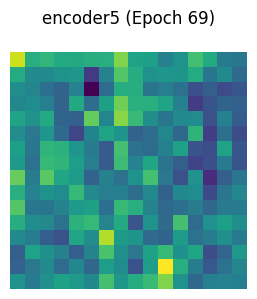

encoder6: torch.Size([3, 64, 8, 8])


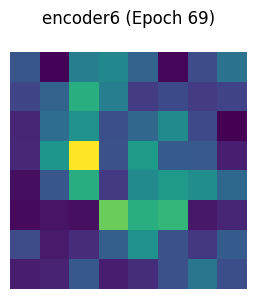

decoder1: torch.Size([3, 48, 8, 8])


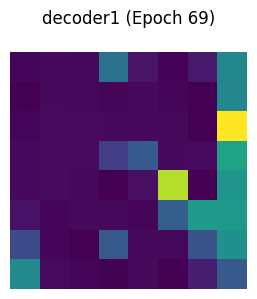

decoder2: torch.Size([3, 32, 8, 8])


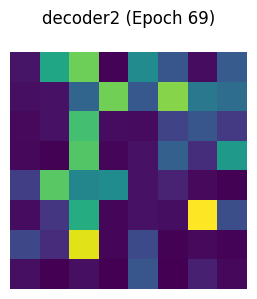

decoder3: torch.Size([3, 24, 16, 16])


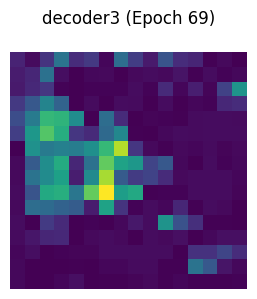

decoder4: torch.Size([3, 16, 32, 32])


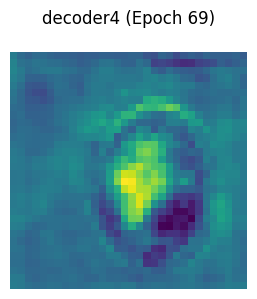

decoder5: torch.Size([3, 8, 64, 64])


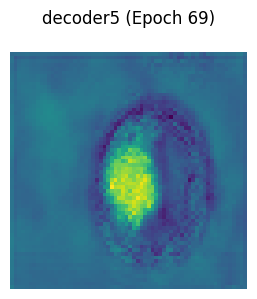

Epoch 69: Loss = 89.1351, Val Dice = 0.8236, Val mIoU = 0.7022, Val Accuracy = 0.9700, Val Sensitivity = 0.8173, Val Specificity = 0.9848


Epoch 70/100: 100%|██████████| 125/125 [01:48<00:00,  1.16it/s]


[Epoch 70] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


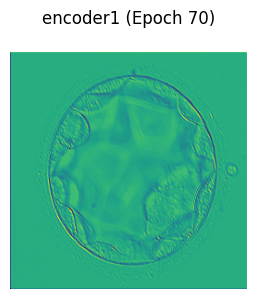

encoder2: torch.Size([3, 16, 128, 128])


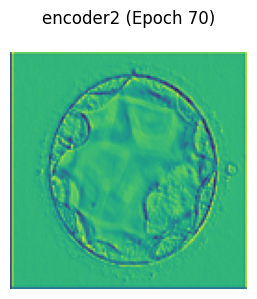

encoder3: torch.Size([3, 24, 64, 64])


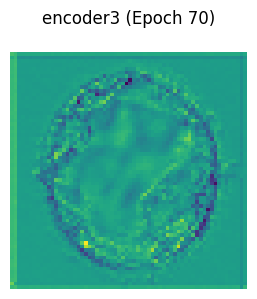

encoder4: torch.Size([3, 32, 32, 32])


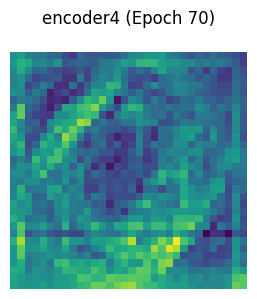

encoder5: torch.Size([3, 48, 16, 16])


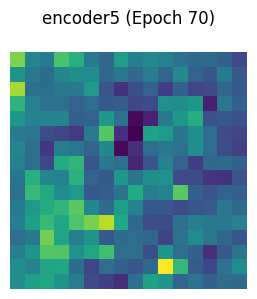

encoder6: torch.Size([3, 64, 8, 8])


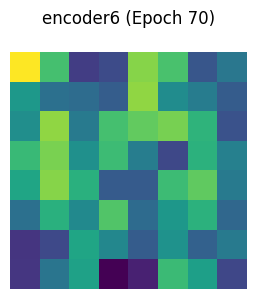

decoder1: torch.Size([3, 48, 8, 8])


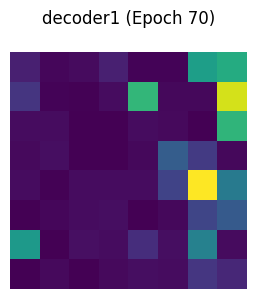

decoder2: torch.Size([3, 32, 8, 8])


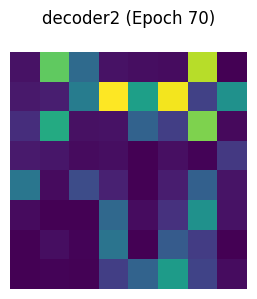

decoder3: torch.Size([3, 24, 16, 16])


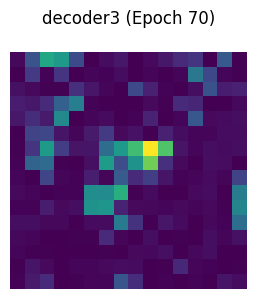

decoder4: torch.Size([3, 16, 32, 32])


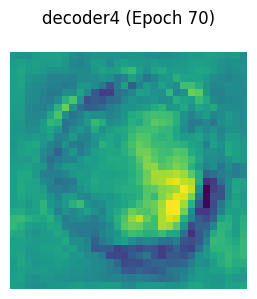

decoder5: torch.Size([3, 8, 64, 64])


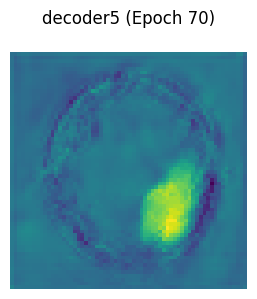

Epoch 70: Loss = 89.3054, Val Dice = 0.8211, Val mIoU = 0.6993, Val Accuracy = 0.9694, Val Sensitivity = 0.8222, Val Specificity = 0.9836


Epoch 71/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 71] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


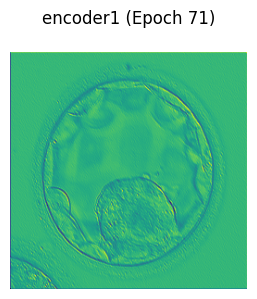

encoder2: torch.Size([3, 16, 128, 128])


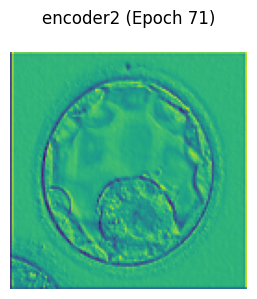

encoder3: torch.Size([3, 24, 64, 64])


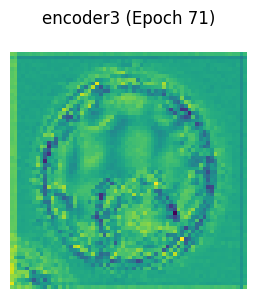

encoder4: torch.Size([3, 32, 32, 32])


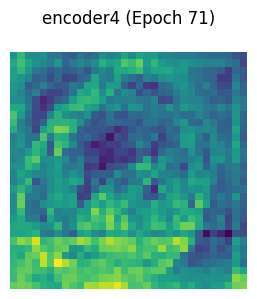

encoder5: torch.Size([3, 48, 16, 16])


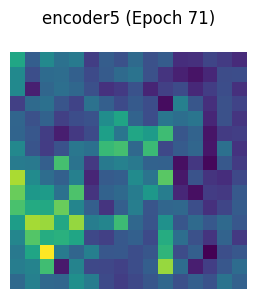

encoder6: torch.Size([3, 64, 8, 8])


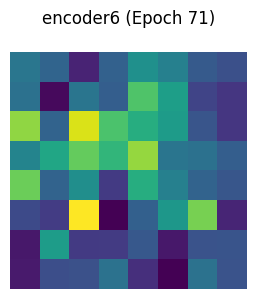

decoder1: torch.Size([3, 48, 8, 8])


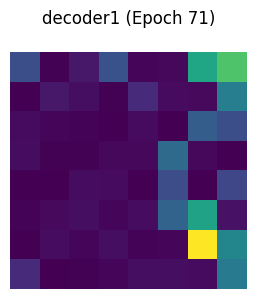

decoder2: torch.Size([3, 32, 8, 8])


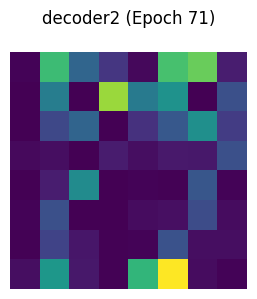

decoder3: torch.Size([3, 24, 16, 16])


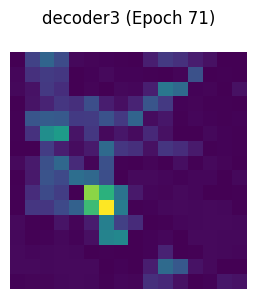

decoder4: torch.Size([3, 16, 32, 32])


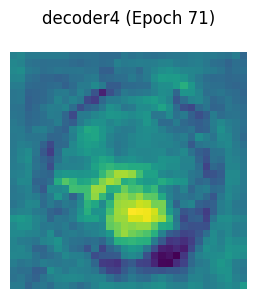

decoder5: torch.Size([3, 8, 64, 64])


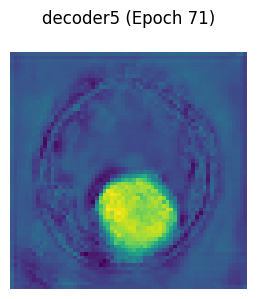

Epoch 71: Loss = 89.2928, Val Dice = 0.8205, Val mIoU = 0.6982, Val Accuracy = 0.9695, Val Sensitivity = 0.8171, Val Specificity = 0.9841


Epoch 72/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 72] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


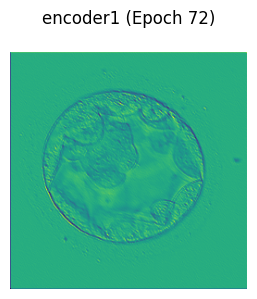

encoder2: torch.Size([3, 16, 128, 128])


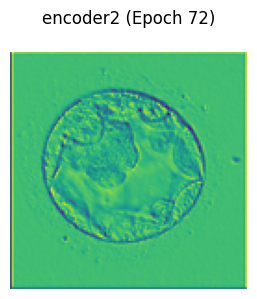

encoder3: torch.Size([3, 24, 64, 64])


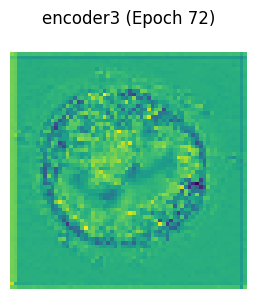

encoder4: torch.Size([3, 32, 32, 32])


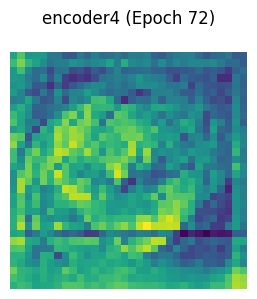

encoder5: torch.Size([3, 48, 16, 16])


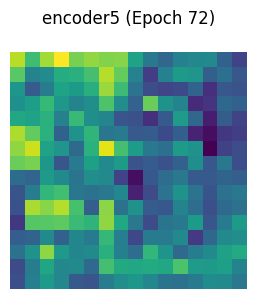

encoder6: torch.Size([3, 64, 8, 8])


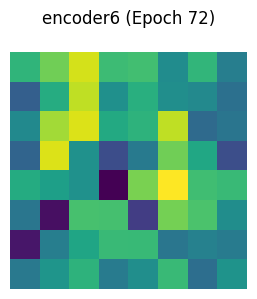

decoder1: torch.Size([3, 48, 8, 8])


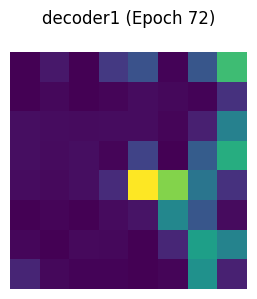

decoder2: torch.Size([3, 32, 8, 8])


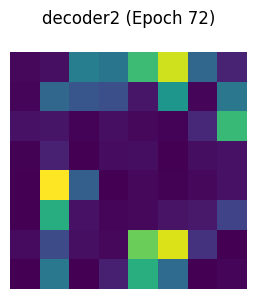

decoder3: torch.Size([3, 24, 16, 16])


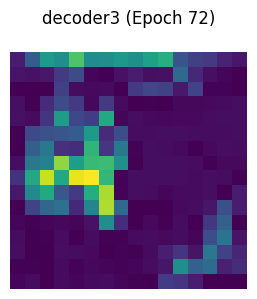

decoder4: torch.Size([3, 16, 32, 32])


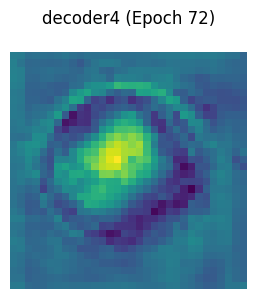

decoder5: torch.Size([3, 8, 64, 64])


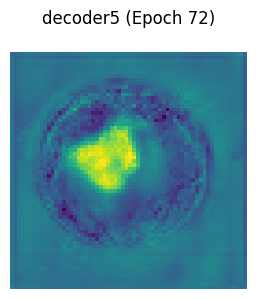

Epoch 72: Loss = 89.3309, Val Dice = 0.8211, Val mIoU = 0.6992, Val Accuracy = 0.9692, Val Sensitivity = 0.8255, Val Specificity = 0.9832


Epoch 73/100: 100%|██████████| 125/125 [01:48<00:00,  1.15it/s]


[Epoch 73] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


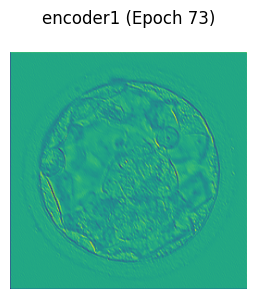

encoder2: torch.Size([3, 16, 128, 128])


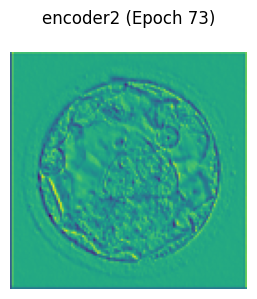

encoder3: torch.Size([3, 24, 64, 64])


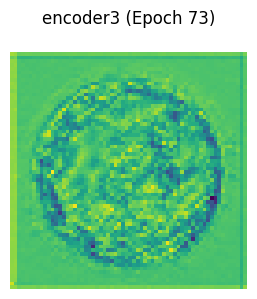

encoder4: torch.Size([3, 32, 32, 32])


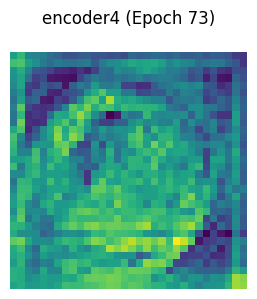

encoder5: torch.Size([3, 48, 16, 16])


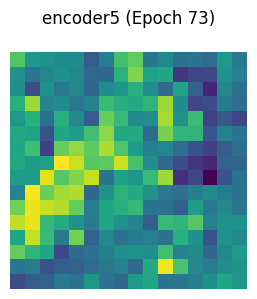

encoder6: torch.Size([3, 64, 8, 8])


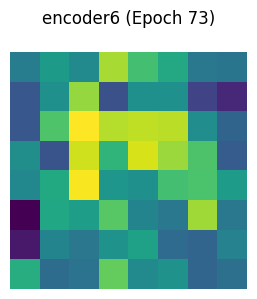

decoder1: torch.Size([3, 48, 8, 8])


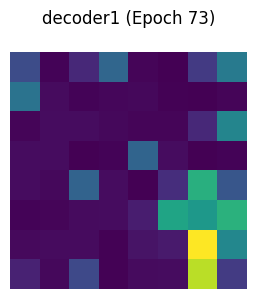

decoder2: torch.Size([3, 32, 8, 8])


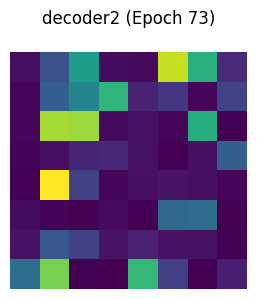

decoder3: torch.Size([3, 24, 16, 16])


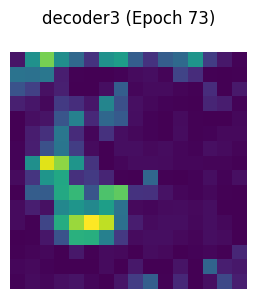

decoder4: torch.Size([3, 16, 32, 32])


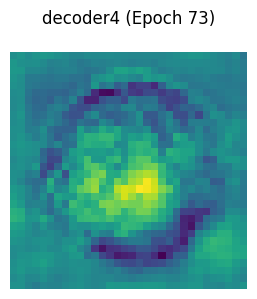

decoder5: torch.Size([3, 8, 64, 64])


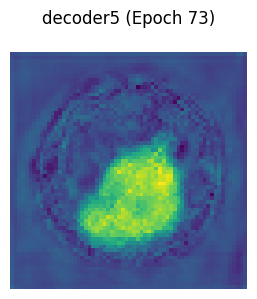

Epoch 73: Loss = 89.6184, Val Dice = 0.8169, Val mIoU = 0.6919, Val Accuracy = 0.9693, Val Sensitivity = 0.8000, Val Specificity = 0.9858


Epoch 74/100: 100%|██████████| 125/125 [01:49<00:00,  1.15it/s]


[Epoch 74] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


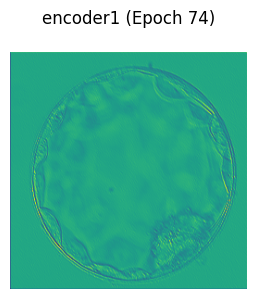

encoder2: torch.Size([3, 16, 128, 128])


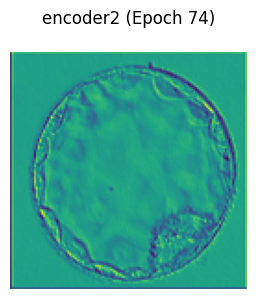

encoder3: torch.Size([3, 24, 64, 64])


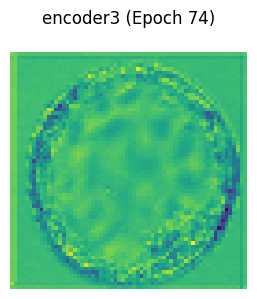

encoder4: torch.Size([3, 32, 32, 32])


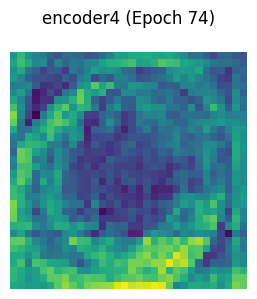

encoder5: torch.Size([3, 48, 16, 16])


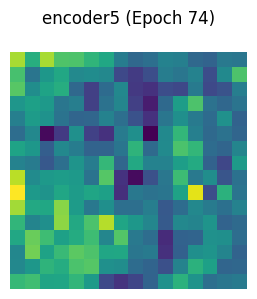

encoder6: torch.Size([3, 64, 8, 8])


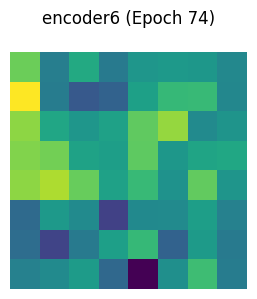

decoder1: torch.Size([3, 48, 8, 8])


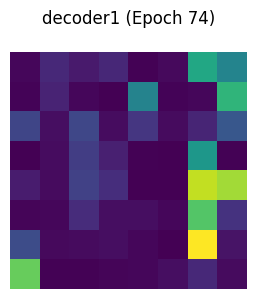

decoder2: torch.Size([3, 32, 8, 8])


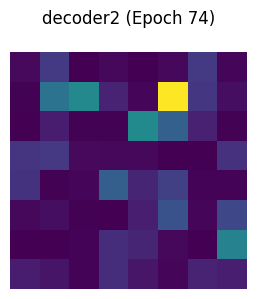

decoder3: torch.Size([3, 24, 16, 16])


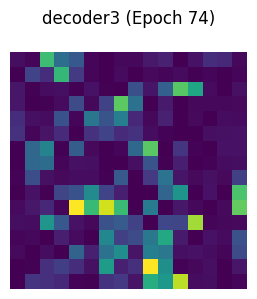

decoder4: torch.Size([3, 16, 32, 32])


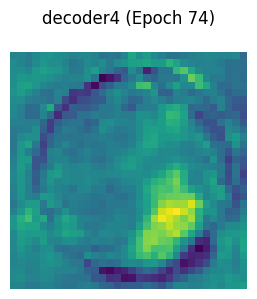

decoder5: torch.Size([3, 8, 64, 64])


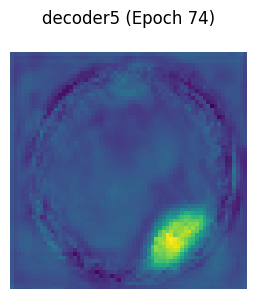

Epoch 74: Loss = 90.3565, Val Dice = 0.8221, Val mIoU = 0.7002, Val Accuracy = 0.9701, Val Sensitivity = 0.8069, Val Specificity = 0.9859


Epoch 75/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 75] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


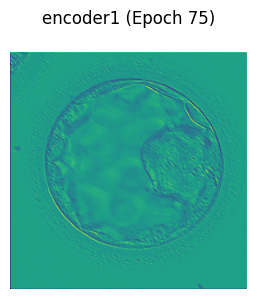

encoder2: torch.Size([3, 16, 128, 128])


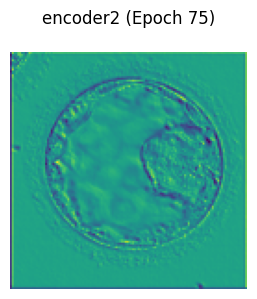

encoder3: torch.Size([3, 24, 64, 64])


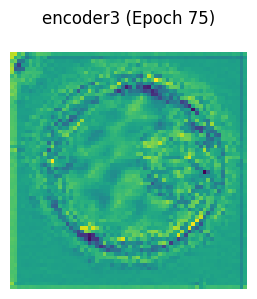

encoder4: torch.Size([3, 32, 32, 32])


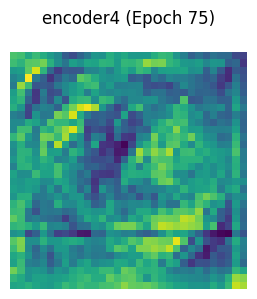

encoder5: torch.Size([3, 48, 16, 16])


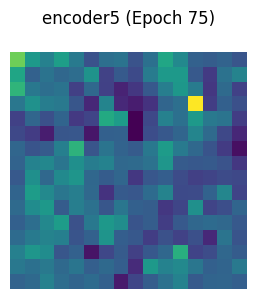

encoder6: torch.Size([3, 64, 8, 8])


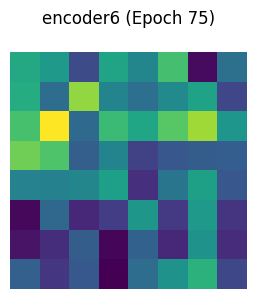

decoder1: torch.Size([3, 48, 8, 8])


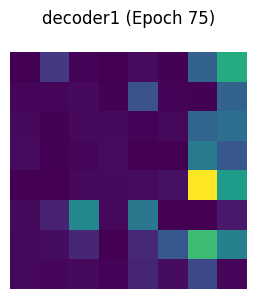

decoder2: torch.Size([3, 32, 8, 8])


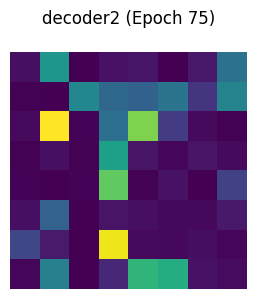

decoder3: torch.Size([3, 24, 16, 16])


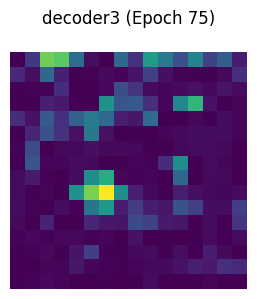

decoder4: torch.Size([3, 16, 32, 32])


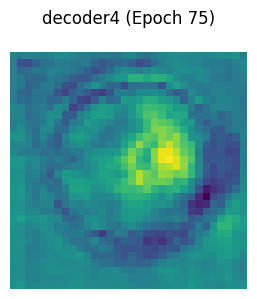

decoder5: torch.Size([3, 8, 64, 64])


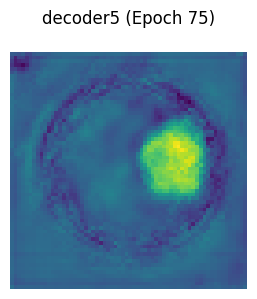

Epoch 75: Loss = 90.2660, Val Dice = 0.8128, Val mIoU = 0.6862, Val Accuracy = 0.9682, Val Sensitivity = 0.8054, Val Specificity = 0.9841


Epoch 76/100: 100%|██████████| 125/125 [01:47<00:00,  1.16it/s]


[Epoch 76] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


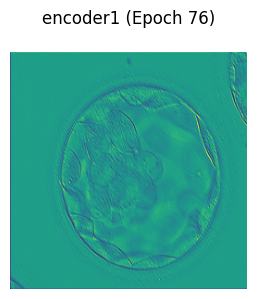

encoder2: torch.Size([3, 16, 128, 128])


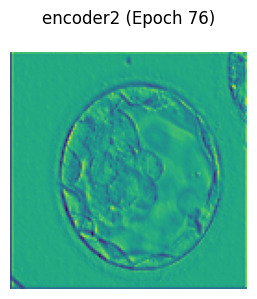

encoder3: torch.Size([3, 24, 64, 64])


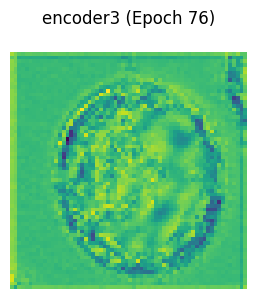

encoder4: torch.Size([3, 32, 32, 32])


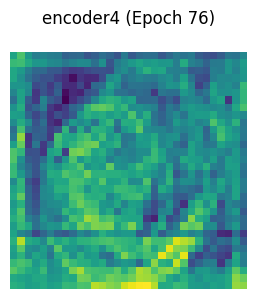

encoder5: torch.Size([3, 48, 16, 16])


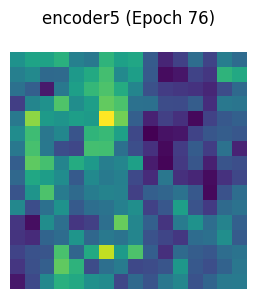

encoder6: torch.Size([3, 64, 8, 8])


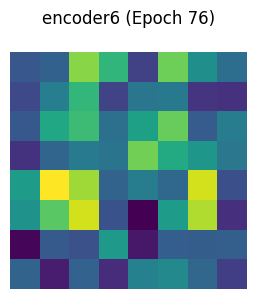

decoder1: torch.Size([3, 48, 8, 8])


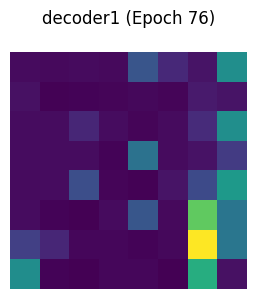

decoder2: torch.Size([3, 32, 8, 8])


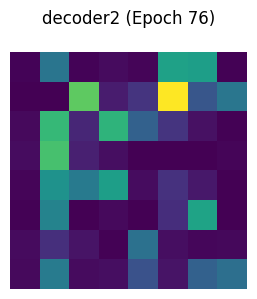

decoder3: torch.Size([3, 24, 16, 16])


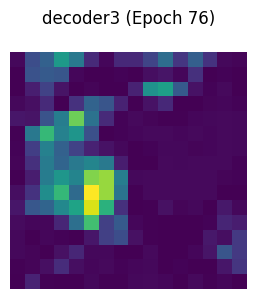

decoder4: torch.Size([3, 16, 32, 32])


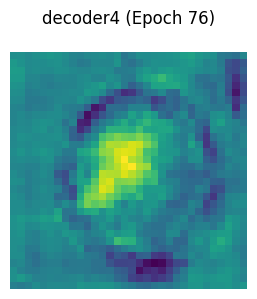

decoder5: torch.Size([3, 8, 64, 64])


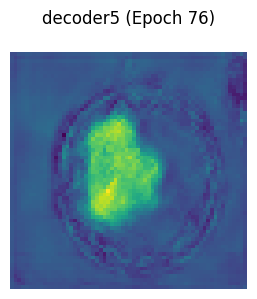

Epoch 76: Loss = 89.8715, Val Dice = 0.8265, Val mIoU = 0.7057, Val Accuracy = 0.9705, Val Sensitivity = 0.8189, Val Specificity = 0.9854


Epoch 77/100: 100%|██████████| 125/125 [01:49<00:00,  1.15it/s]


[Epoch 77] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


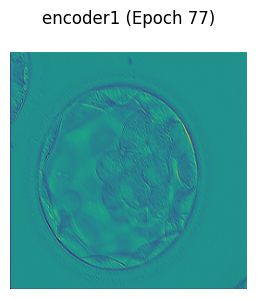

encoder2: torch.Size([3, 16, 128, 128])


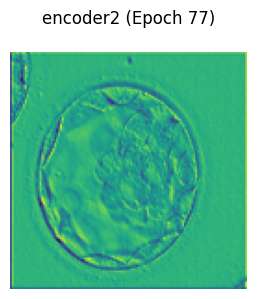

encoder3: torch.Size([3, 24, 64, 64])


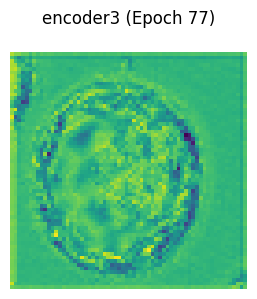

encoder4: torch.Size([3, 32, 32, 32])


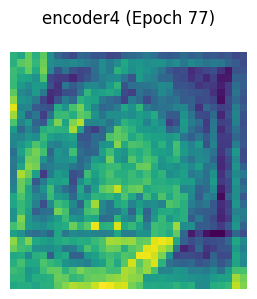

encoder5: torch.Size([3, 48, 16, 16])


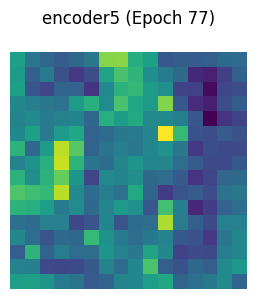

encoder6: torch.Size([3, 64, 8, 8])


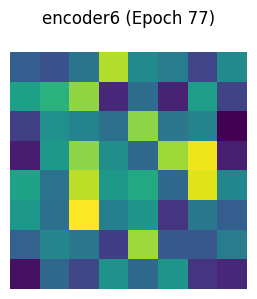

decoder1: torch.Size([3, 48, 8, 8])


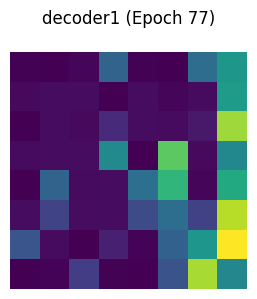

decoder2: torch.Size([3, 32, 8, 8])


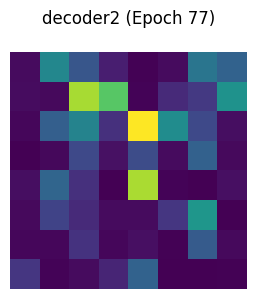

decoder3: torch.Size([3, 24, 16, 16])


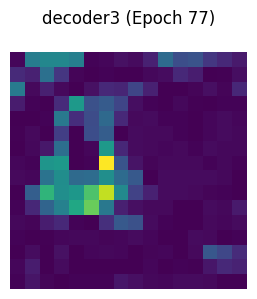

decoder4: torch.Size([3, 16, 32, 32])


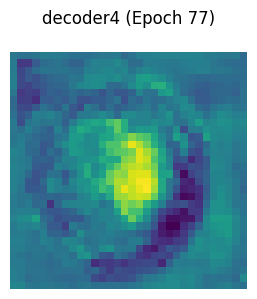

decoder5: torch.Size([3, 8, 64, 64])


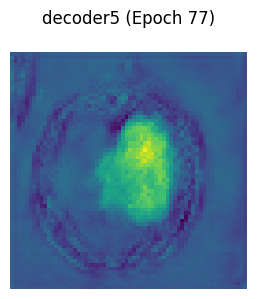

Epoch 77: Loss = 89.7295, Val Dice = 0.8163, Val mIoU = 0.6910, Val Accuracy = 0.9688, Val Sensitivity = 0.8089, Val Specificity = 0.9844


Epoch 78/100: 100%|██████████| 125/125 [01:50<00:00,  1.13it/s]


[Epoch 78] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


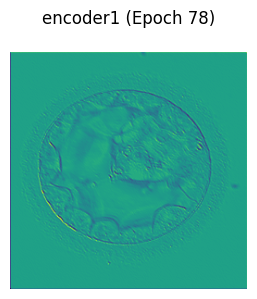

encoder2: torch.Size([3, 16, 128, 128])


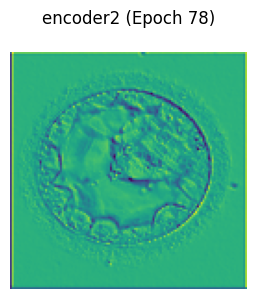

encoder3: torch.Size([3, 24, 64, 64])


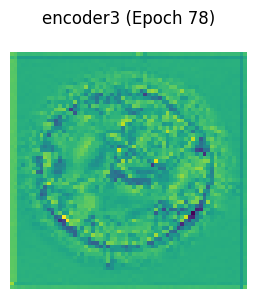

encoder4: torch.Size([3, 32, 32, 32])


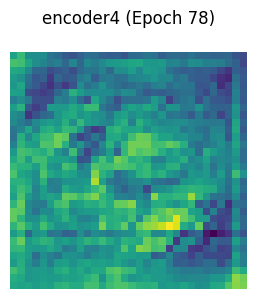

encoder5: torch.Size([3, 48, 16, 16])


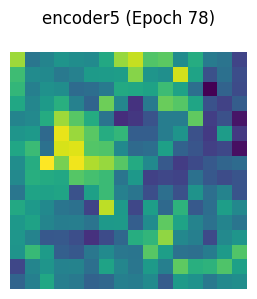

encoder6: torch.Size([3, 64, 8, 8])


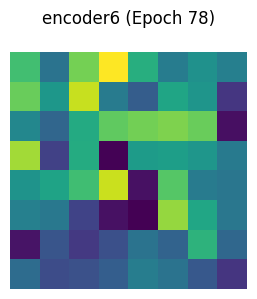

decoder1: torch.Size([3, 48, 8, 8])


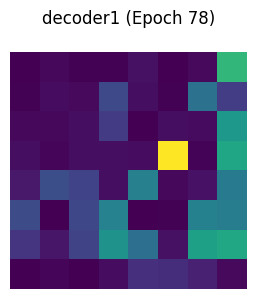

decoder2: torch.Size([3, 32, 8, 8])


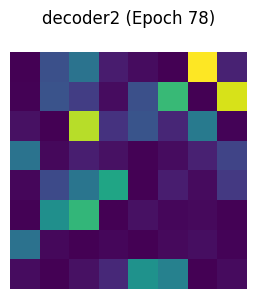

decoder3: torch.Size([3, 24, 16, 16])


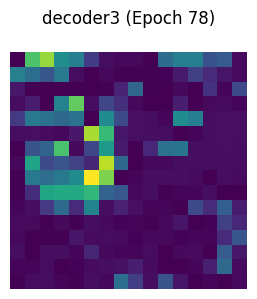

decoder4: torch.Size([3, 16, 32, 32])


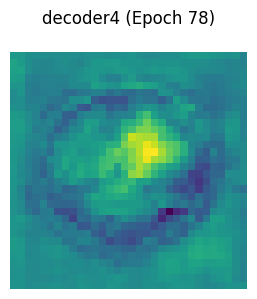

decoder5: torch.Size([3, 8, 64, 64])


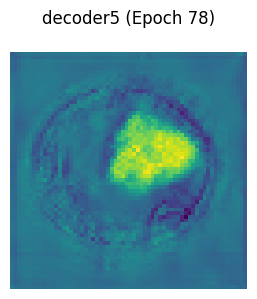

Epoch 78: Loss = 89.8795, Val Dice = 0.8242, Val mIoU = 0.7022, Val Accuracy = 0.9701, Val Sensitivity = 0.8166, Val Specificity = 0.9851


Epoch 79/100: 100%|██████████| 125/125 [01:50<00:00,  1.13it/s]


[Epoch 79] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


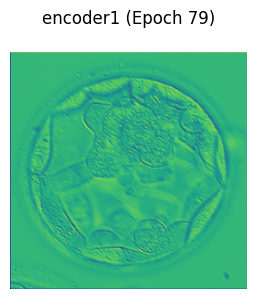

encoder2: torch.Size([3, 16, 128, 128])


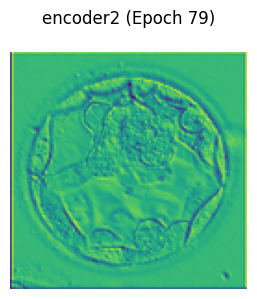

encoder3: torch.Size([3, 24, 64, 64])


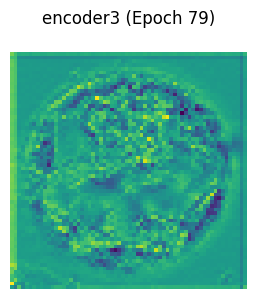

encoder4: torch.Size([3, 32, 32, 32])


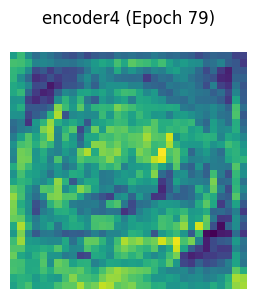

encoder5: torch.Size([3, 48, 16, 16])


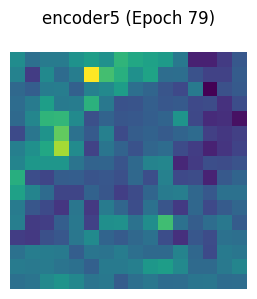

encoder6: torch.Size([3, 64, 8, 8])


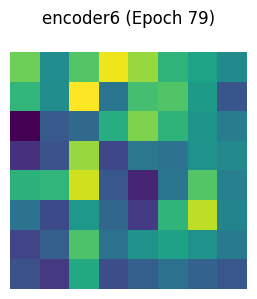

decoder1: torch.Size([3, 48, 8, 8])


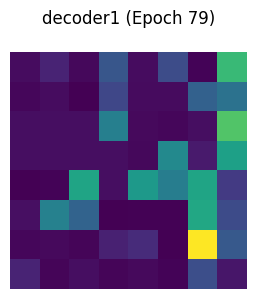

decoder2: torch.Size([3, 32, 8, 8])


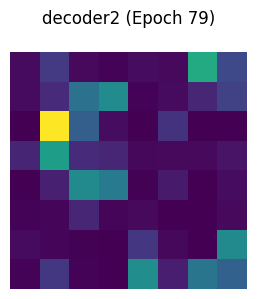

decoder3: torch.Size([3, 24, 16, 16])


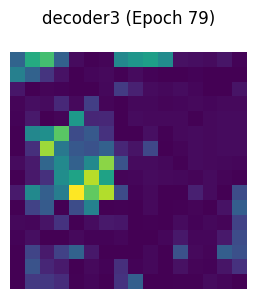

decoder4: torch.Size([3, 16, 32, 32])


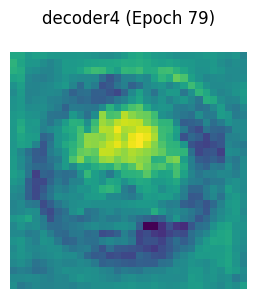

decoder5: torch.Size([3, 8, 64, 64])


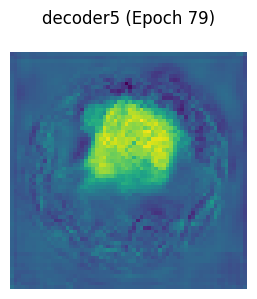

Epoch 79: Loss = 90.7415, Val Dice = 0.8259, Val mIoU = 0.7054, Val Accuracy = 0.9706, Val Sensitivity = 0.8134, Val Specificity = 0.9859


Epoch 80/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 80] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


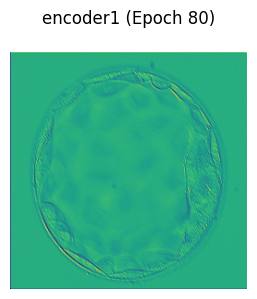

encoder2: torch.Size([3, 16, 128, 128])


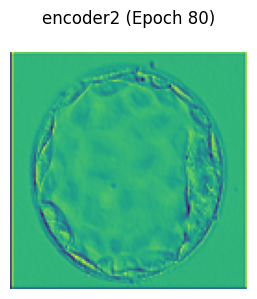

encoder3: torch.Size([3, 24, 64, 64])


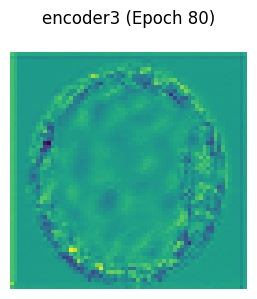

encoder4: torch.Size([3, 32, 32, 32])


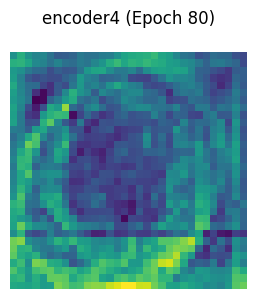

encoder5: torch.Size([3, 48, 16, 16])


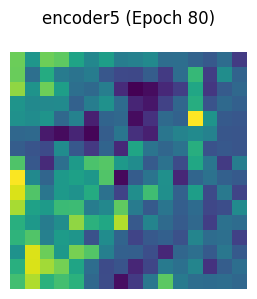

encoder6: torch.Size([3, 64, 8, 8])


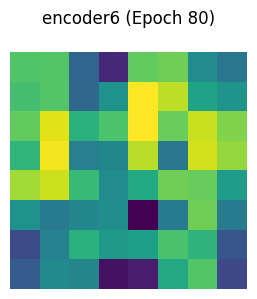

decoder1: torch.Size([3, 48, 8, 8])


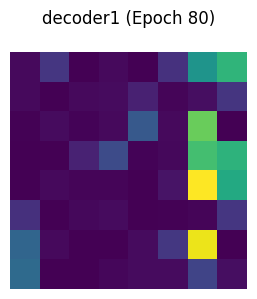

decoder2: torch.Size([3, 32, 8, 8])


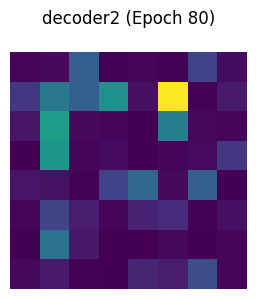

decoder3: torch.Size([3, 24, 16, 16])


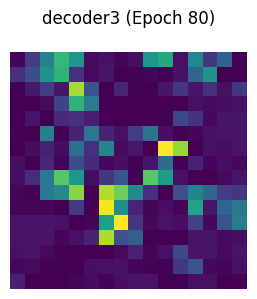

decoder4: torch.Size([3, 16, 32, 32])


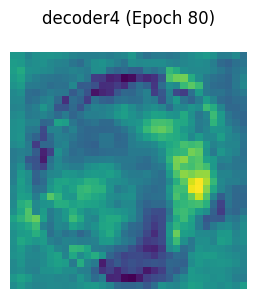

decoder5: torch.Size([3, 8, 64, 64])


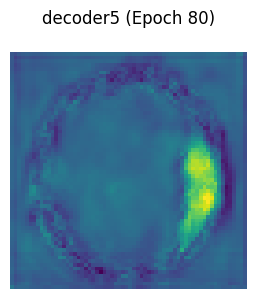

Epoch 80: Loss = 90.5970, Val Dice = 0.8112, Val mIoU = 0.6831, Val Accuracy = 0.9680, Val Sensitivity = 0.8013, Val Specificity = 0.9843


Epoch 81/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 81] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


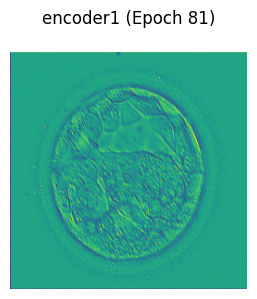

encoder2: torch.Size([3, 16, 128, 128])


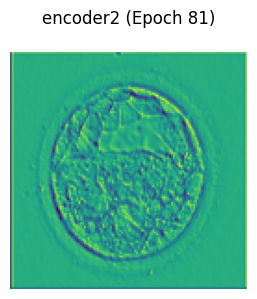

encoder3: torch.Size([3, 24, 64, 64])


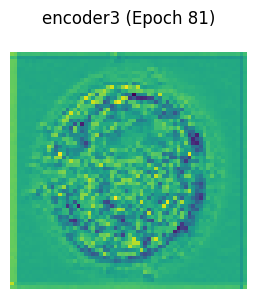

encoder4: torch.Size([3, 32, 32, 32])


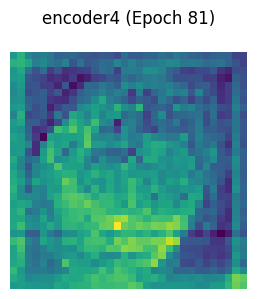

encoder5: torch.Size([3, 48, 16, 16])


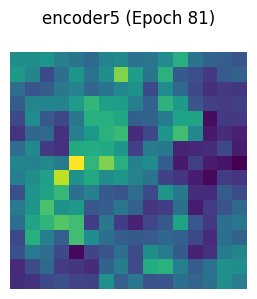

encoder6: torch.Size([3, 64, 8, 8])


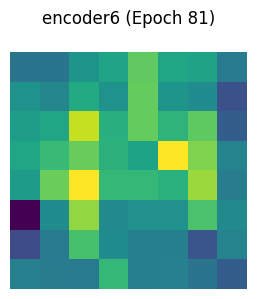

decoder1: torch.Size([3, 48, 8, 8])


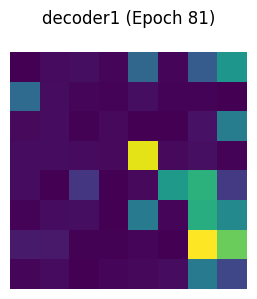

decoder2: torch.Size([3, 32, 8, 8])


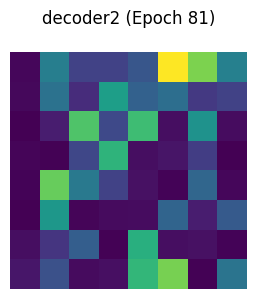

decoder3: torch.Size([3, 24, 16, 16])


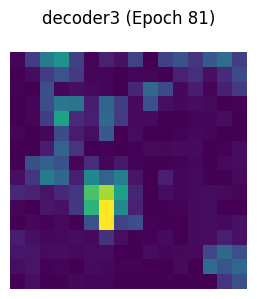

decoder4: torch.Size([3, 16, 32, 32])


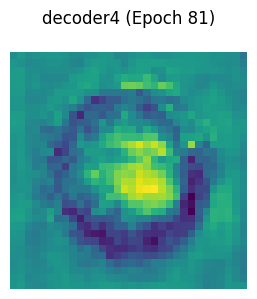

decoder5: torch.Size([3, 8, 64, 64])


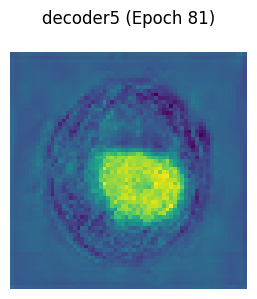

Epoch 81: Loss = 90.8390, Val Dice = 0.8183, Val mIoU = 0.6936, Val Accuracy = 0.9687, Val Sensitivity = 0.8158, Val Specificity = 0.9839


Epoch 82/100: 100%|██████████| 125/125 [01:51<00:00,  1.13it/s]


[Epoch 82] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


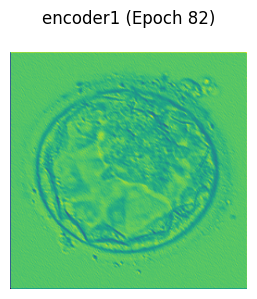

encoder2: torch.Size([3, 16, 128, 128])


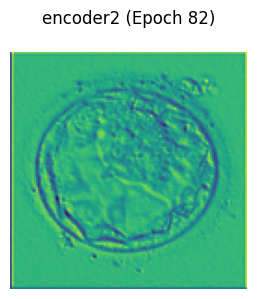

encoder3: torch.Size([3, 24, 64, 64])


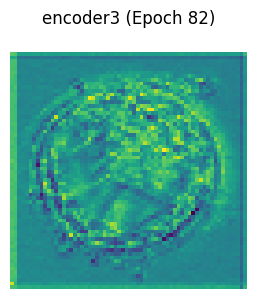

encoder4: torch.Size([3, 32, 32, 32])


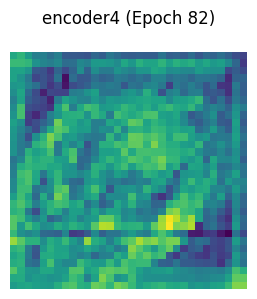

encoder5: torch.Size([3, 48, 16, 16])


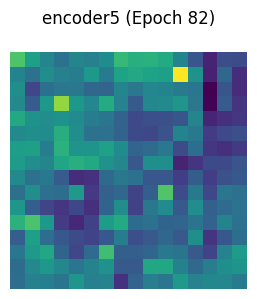

encoder6: torch.Size([3, 64, 8, 8])


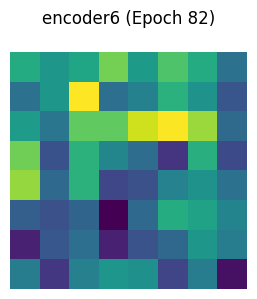

decoder1: torch.Size([3, 48, 8, 8])


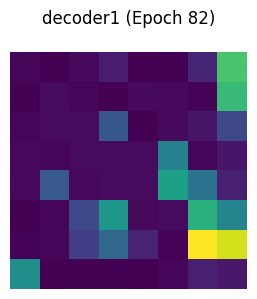

decoder2: torch.Size([3, 32, 8, 8])


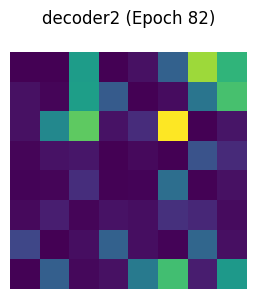

decoder3: torch.Size([3, 24, 16, 16])


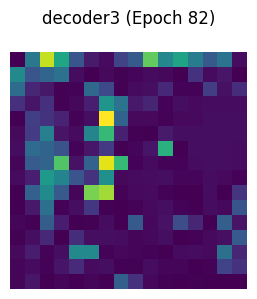

decoder4: torch.Size([3, 16, 32, 32])


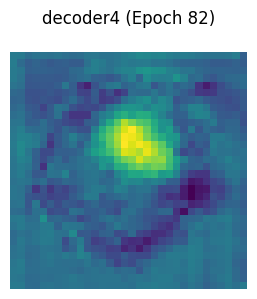

decoder5: torch.Size([3, 8, 64, 64])


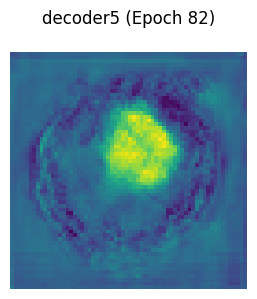

Epoch 82: Loss = 91.3583, Val Dice = 0.8163, Val mIoU = 0.6910, Val Accuracy = 0.9694, Val Sensitivity = 0.7907, Val Specificity = 0.9869


Epoch 83/100: 100%|██████████| 125/125 [01:51<00:00,  1.12it/s]


[Epoch 83] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


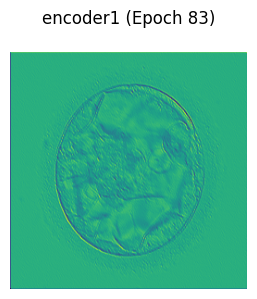

encoder2: torch.Size([3, 16, 128, 128])


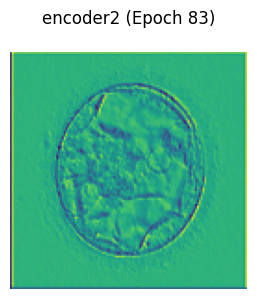

encoder3: torch.Size([3, 24, 64, 64])


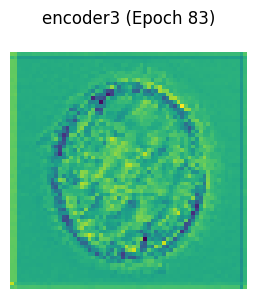

encoder4: torch.Size([3, 32, 32, 32])


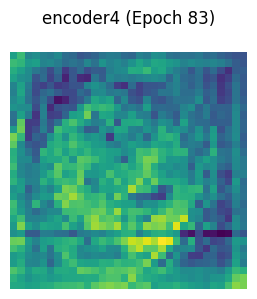

encoder5: torch.Size([3, 48, 16, 16])


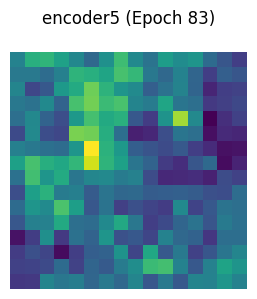

encoder6: torch.Size([3, 64, 8, 8])


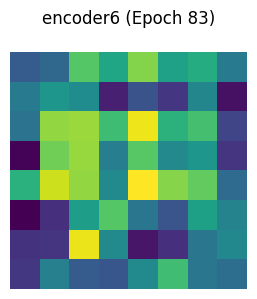

decoder1: torch.Size([3, 48, 8, 8])


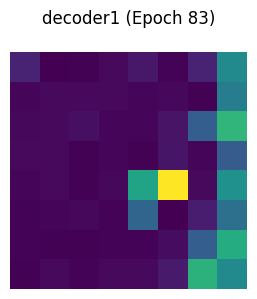

decoder2: torch.Size([3, 32, 8, 8])


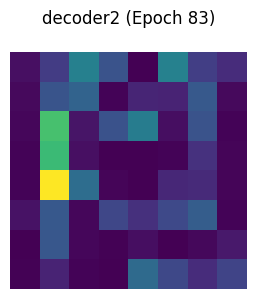

decoder3: torch.Size([3, 24, 16, 16])


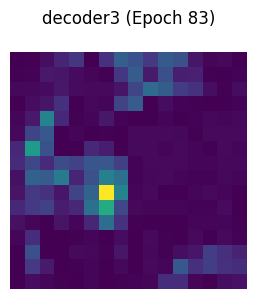

decoder4: torch.Size([3, 16, 32, 32])


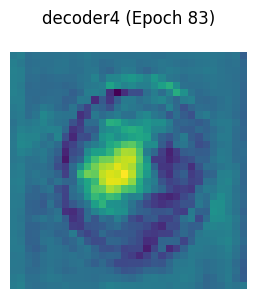

decoder5: torch.Size([3, 8, 64, 64])


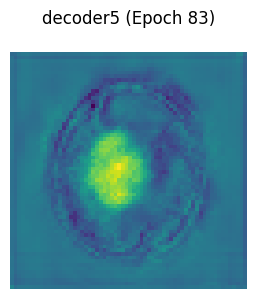

Epoch 83: Loss = 90.9473, Val Dice = 0.8196, Val mIoU = 0.6960, Val Accuracy = 0.9703, Val Sensitivity = 0.7899, Val Specificity = 0.9876


Epoch 84/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 84] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


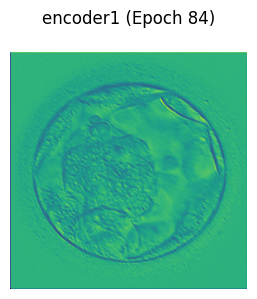

encoder2: torch.Size([3, 16, 128, 128])


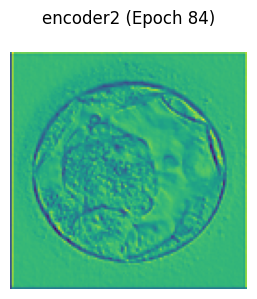

encoder3: torch.Size([3, 24, 64, 64])


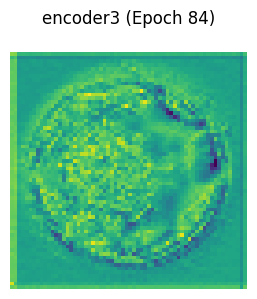

encoder4: torch.Size([3, 32, 32, 32])


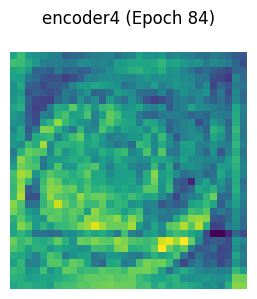

encoder5: torch.Size([3, 48, 16, 16])


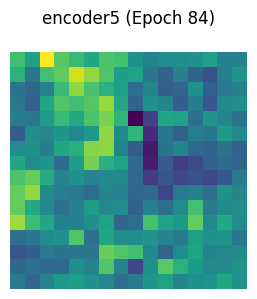

encoder6: torch.Size([3, 64, 8, 8])


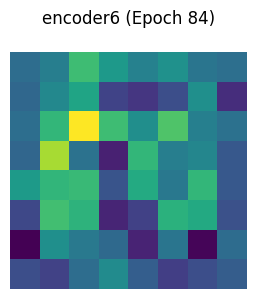

decoder1: torch.Size([3, 48, 8, 8])


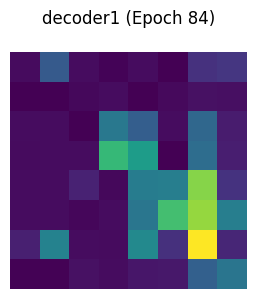

decoder2: torch.Size([3, 32, 8, 8])


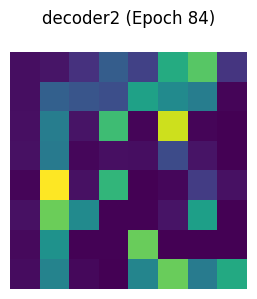

decoder3: torch.Size([3, 24, 16, 16])


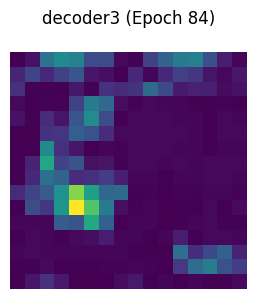

decoder4: torch.Size([3, 16, 32, 32])


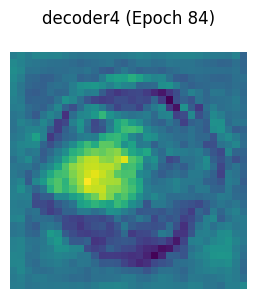

decoder5: torch.Size([3, 8, 64, 64])


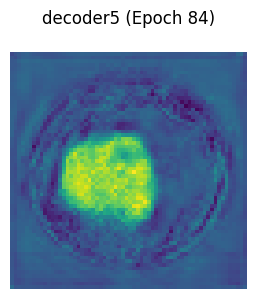

Epoch 84: Loss = 91.1647, Val Dice = 0.8336, Val mIoU = 0.7164, Val Accuracy = 0.9716, Val Sensitivity = 0.8317, Val Specificity = 0.9852


Epoch 85/100: 100%|██████████| 125/125 [01:52<00:00,  1.12it/s]


[Epoch 85] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


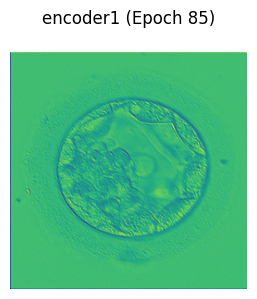

encoder2: torch.Size([3, 16, 128, 128])


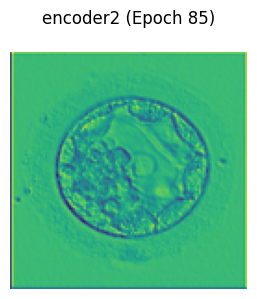

encoder3: torch.Size([3, 24, 64, 64])


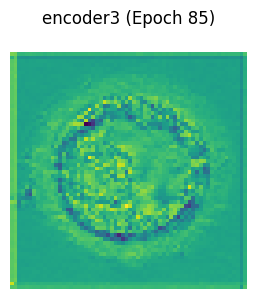

encoder4: torch.Size([3, 32, 32, 32])


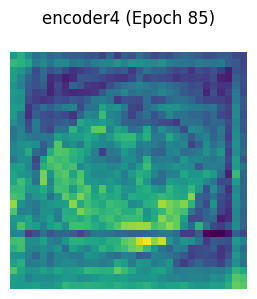

encoder5: torch.Size([3, 48, 16, 16])


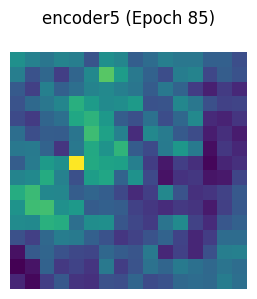

encoder6: torch.Size([3, 64, 8, 8])


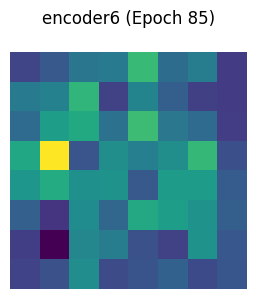

decoder1: torch.Size([3, 48, 8, 8])


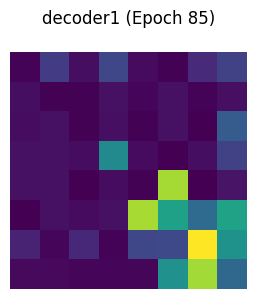

decoder2: torch.Size([3, 32, 8, 8])


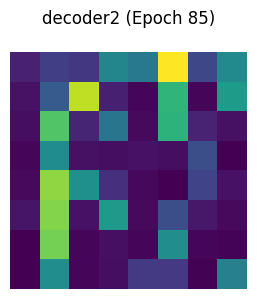

decoder3: torch.Size([3, 24, 16, 16])


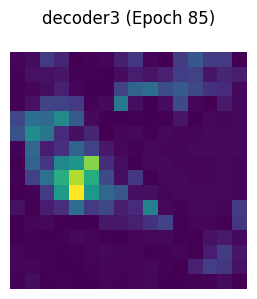

decoder4: torch.Size([3, 16, 32, 32])


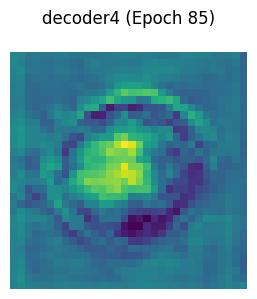

decoder5: torch.Size([3, 8, 64, 64])


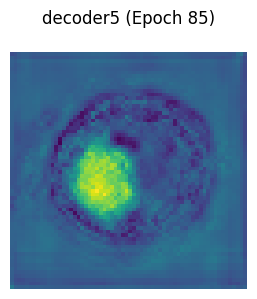

Epoch 85: Loss = 90.8164, Val Dice = 0.8266, Val mIoU = 0.7066, Val Accuracy = 0.9709, Val Sensitivity = 0.8150, Val Specificity = 0.9858


Epoch 86/100: 100%|██████████| 125/125 [01:52<00:00,  1.12it/s]


[Epoch 86] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


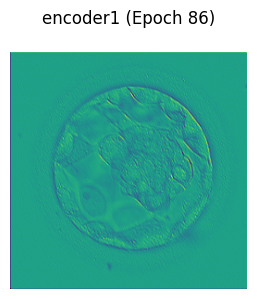

encoder2: torch.Size([3, 16, 128, 128])


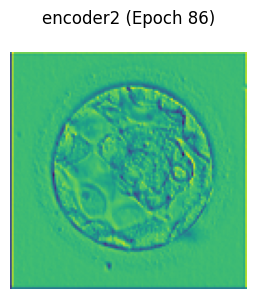

encoder3: torch.Size([3, 24, 64, 64])


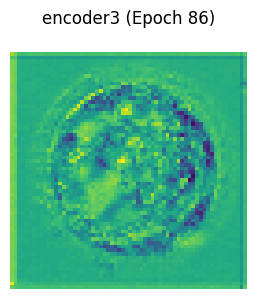

encoder4: torch.Size([3, 32, 32, 32])


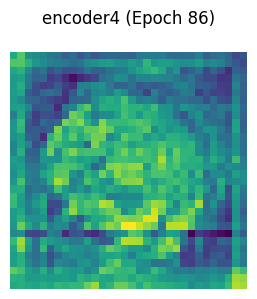

encoder5: torch.Size([3, 48, 16, 16])


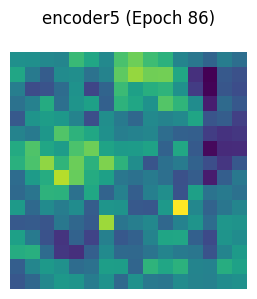

encoder6: torch.Size([3, 64, 8, 8])


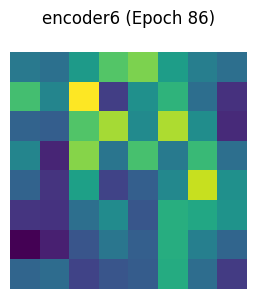

decoder1: torch.Size([3, 48, 8, 8])


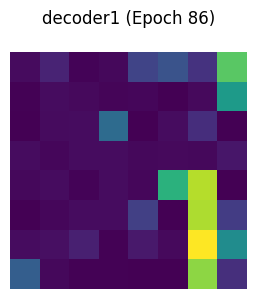

decoder2: torch.Size([3, 32, 8, 8])


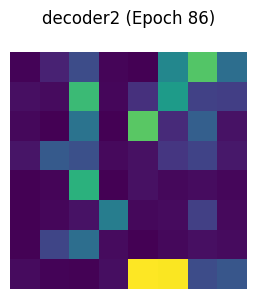

decoder3: torch.Size([3, 24, 16, 16])


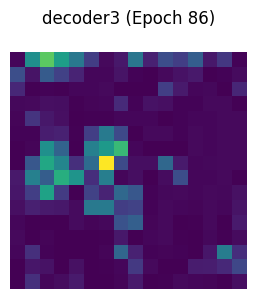

decoder4: torch.Size([3, 16, 32, 32])


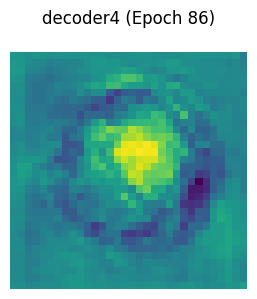

decoder5: torch.Size([3, 8, 64, 64])


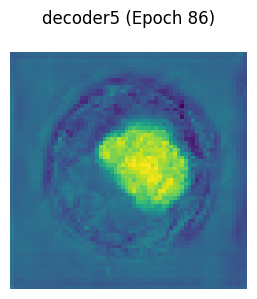

Epoch 86: Loss = 91.0208, Val Dice = 0.8350, Val mIoU = 0.7197, Val Accuracy = 0.9711, Val Sensitivity = 0.8538, Val Specificity = 0.9825


Epoch 87/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]



[Epoch 87] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


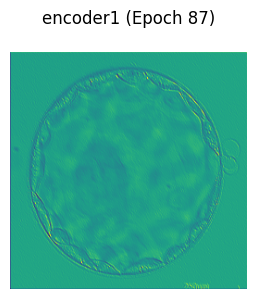

encoder2: torch.Size([3, 16, 128, 128])


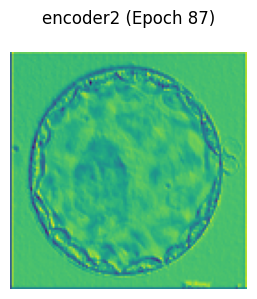

encoder3: torch.Size([3, 24, 64, 64])


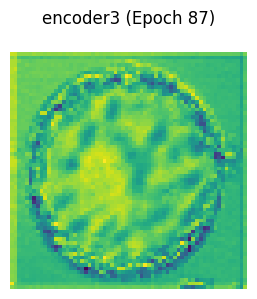

encoder4: torch.Size([3, 32, 32, 32])


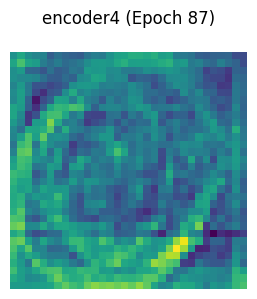

encoder5: torch.Size([3, 48, 16, 16])


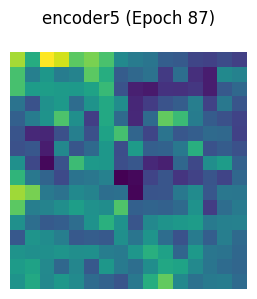

encoder6: torch.Size([3, 64, 8, 8])


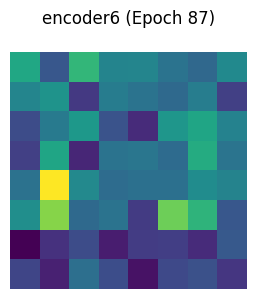

decoder1: torch.Size([3, 48, 8, 8])


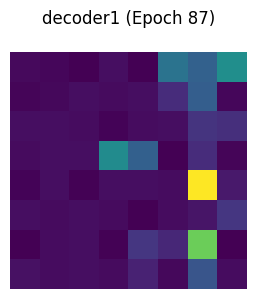

decoder2: torch.Size([3, 32, 8, 8])


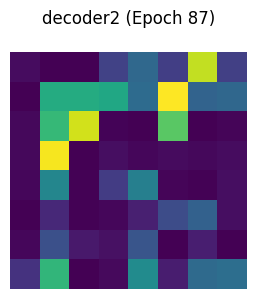

decoder3: torch.Size([3, 24, 16, 16])


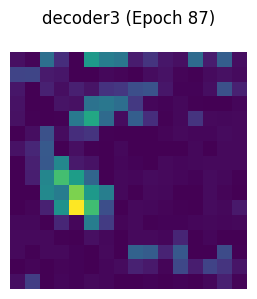

decoder4: torch.Size([3, 16, 32, 32])


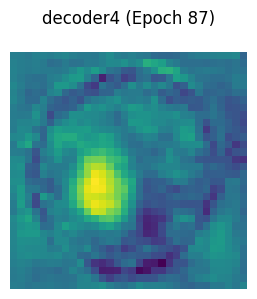

decoder5: torch.Size([3, 8, 64, 64])


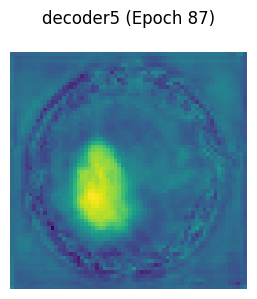

Epoch 87: Loss = 90.4731, Val Dice = 0.8291, Val mIoU = 0.7098, Val Accuracy = 0.9707, Val Sensitivity = 0.8348, Val Specificity = 0.9839


Epoch 88/100: 100%|██████████| 125/125 [01:52<00:00,  1.11it/s]


[Epoch 88] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


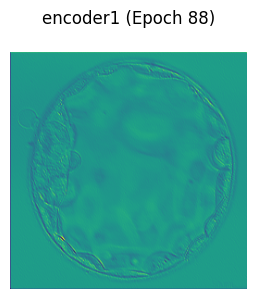

encoder2: torch.Size([3, 16, 128, 128])


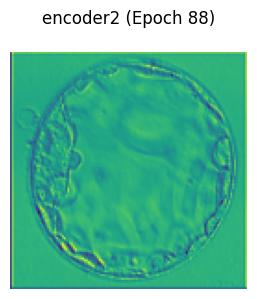

encoder3: torch.Size([3, 24, 64, 64])


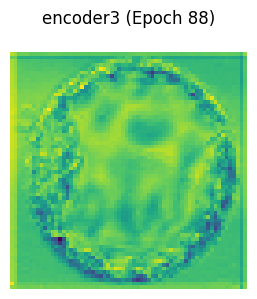

encoder4: torch.Size([3, 32, 32, 32])


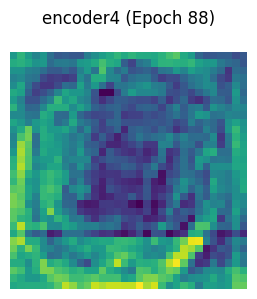

encoder5: torch.Size([3, 48, 16, 16])


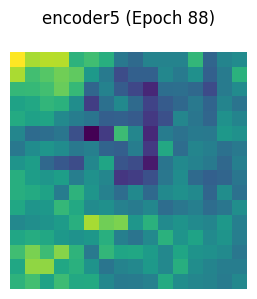

encoder6: torch.Size([3, 64, 8, 8])


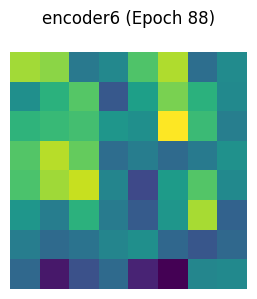

decoder1: torch.Size([3, 48, 8, 8])


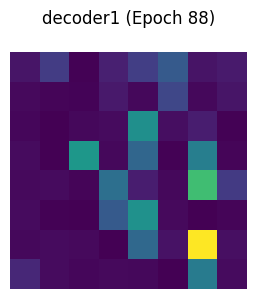

decoder2: torch.Size([3, 32, 8, 8])


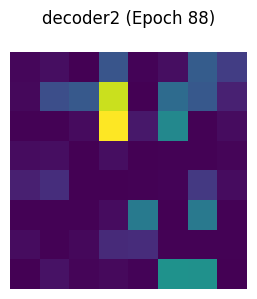

decoder3: torch.Size([3, 24, 16, 16])


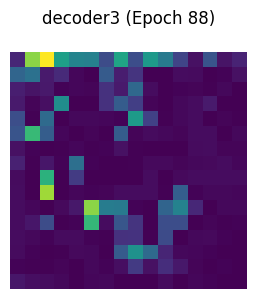

decoder4: torch.Size([3, 16, 32, 32])


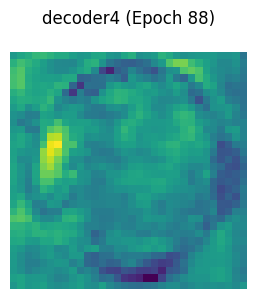

decoder5: torch.Size([3, 8, 64, 64])


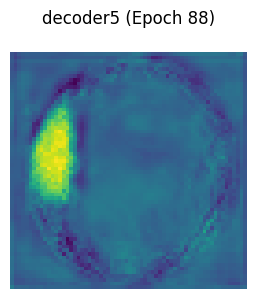

Epoch 88: Loss = 91.4214, Val Dice = 0.8167, Val mIoU = 0.6908, Val Accuracy = 0.9698, Val Sensitivity = 0.7804, Val Specificity = 0.9883


Epoch 89/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 89] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


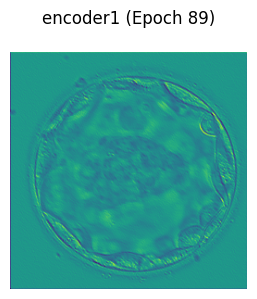

encoder2: torch.Size([3, 16, 128, 128])


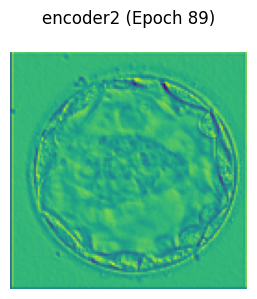

encoder3: torch.Size([3, 24, 64, 64])


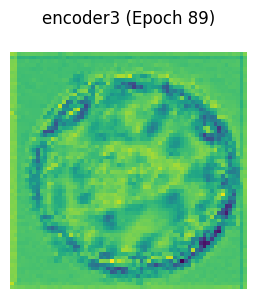

encoder4: torch.Size([3, 32, 32, 32])


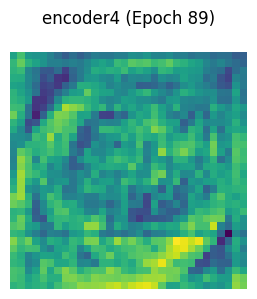

encoder5: torch.Size([3, 48, 16, 16])


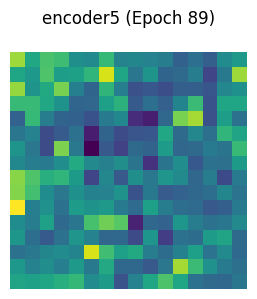

encoder6: torch.Size([3, 64, 8, 8])


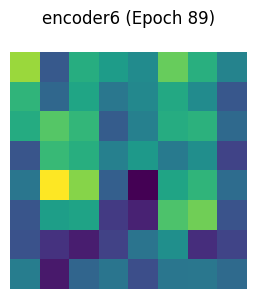

decoder1: torch.Size([3, 48, 8, 8])


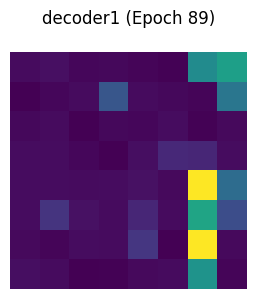

decoder2: torch.Size([3, 32, 8, 8])


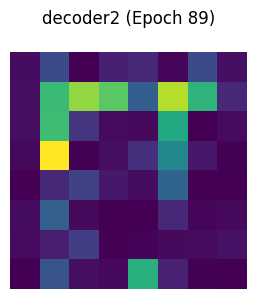

decoder3: torch.Size([3, 24, 16, 16])


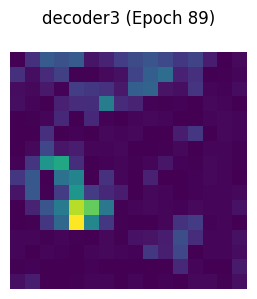

decoder4: torch.Size([3, 16, 32, 32])


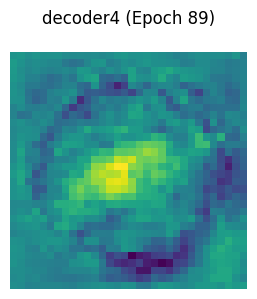

decoder5: torch.Size([3, 8, 64, 64])


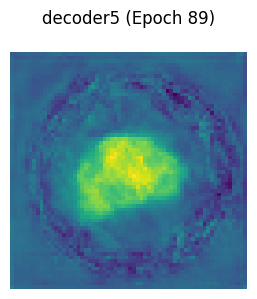

Epoch 89: Loss = 91.2350, Val Dice = 0.8337, Val mIoU = 0.7168, Val Accuracy = 0.9714, Val Sensitivity = 0.8393, Val Specificity = 0.9843


Epoch 90/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 90] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


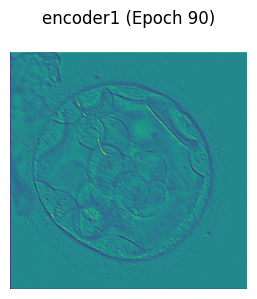

encoder2: torch.Size([3, 16, 128, 128])


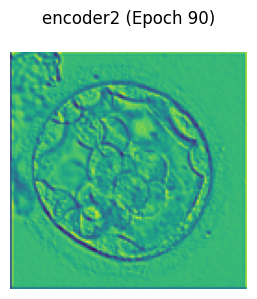

encoder3: torch.Size([3, 24, 64, 64])


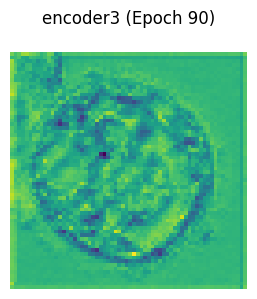

encoder4: torch.Size([3, 32, 32, 32])


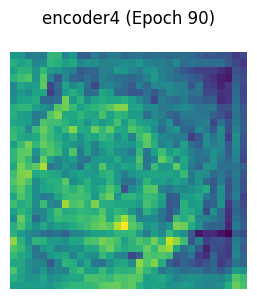

encoder5: torch.Size([3, 48, 16, 16])


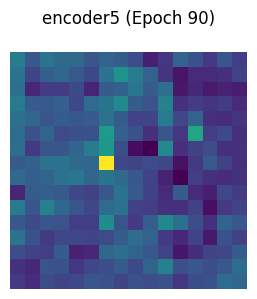

encoder6: torch.Size([3, 64, 8, 8])


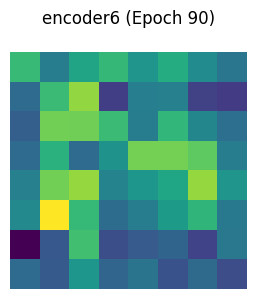

decoder1: torch.Size([3, 48, 8, 8])


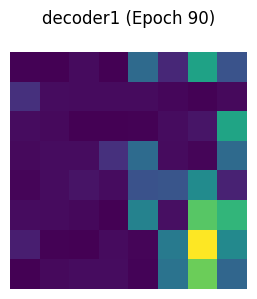

decoder2: torch.Size([3, 32, 8, 8])


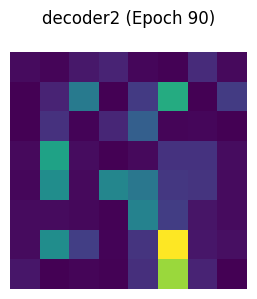

decoder3: torch.Size([3, 24, 16, 16])


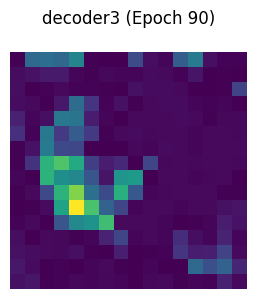

decoder4: torch.Size([3, 16, 32, 32])


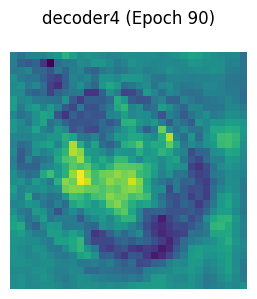

decoder5: torch.Size([3, 8, 64, 64])


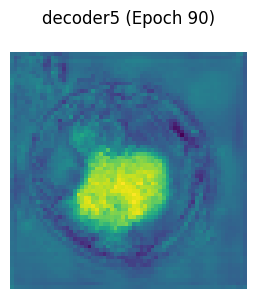

Epoch 90: Loss = 91.0485, Val Dice = 0.8407, Val mIoU = 0.7277, Val Accuracy = 0.9727, Val Sensitivity = 0.8474, Val Specificity = 0.9847


Epoch 91/100: 100%|██████████| 125/125 [01:54<00:00,  1.10it/s]


[Epoch 91] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


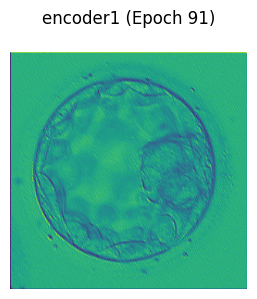

encoder2: torch.Size([3, 16, 128, 128])


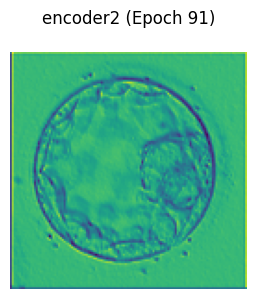

encoder3: torch.Size([3, 24, 64, 64])


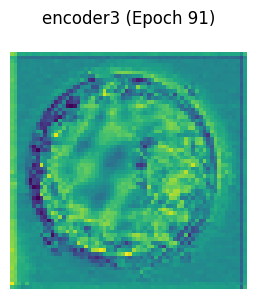

encoder4: torch.Size([3, 32, 32, 32])


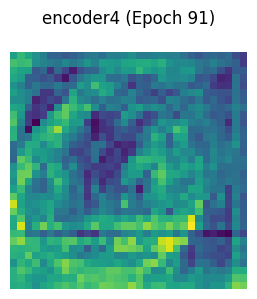

encoder5: torch.Size([3, 48, 16, 16])


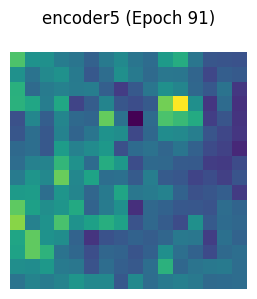

encoder6: torch.Size([3, 64, 8, 8])


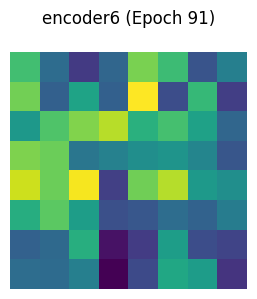

decoder1: torch.Size([3, 48, 8, 8])


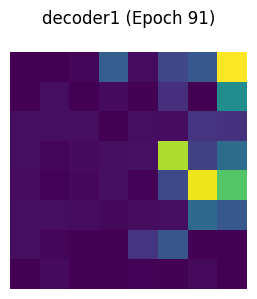

decoder2: torch.Size([3, 32, 8, 8])


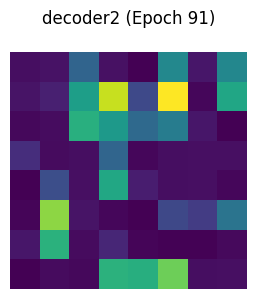

decoder3: torch.Size([3, 24, 16, 16])


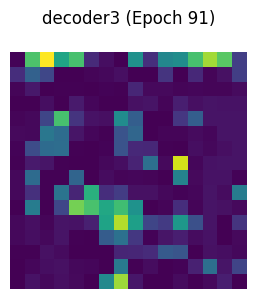

decoder4: torch.Size([3, 16, 32, 32])


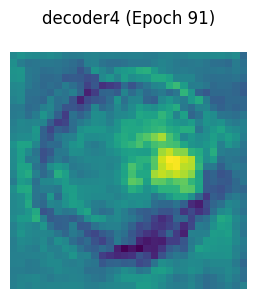

decoder5: torch.Size([3, 8, 64, 64])


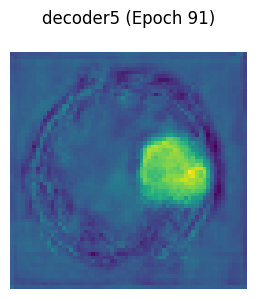

Epoch 91: Loss = 91.4637, Val Dice = 0.8224, Val mIoU = 0.7009, Val Accuracy = 0.9698, Val Sensitivity = 0.8217, Val Specificity = 0.9840


Epoch 92/100: 100%|██████████| 125/125 [01:53<00:00,  1.10it/s]


[Epoch 92] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


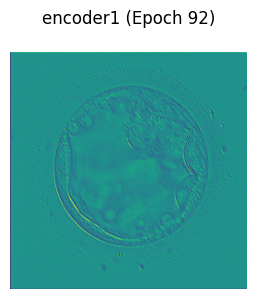

encoder2: torch.Size([3, 16, 128, 128])


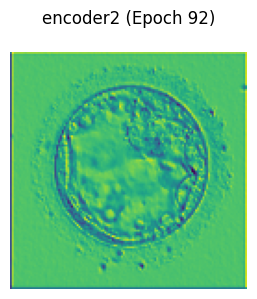

encoder3: torch.Size([3, 24, 64, 64])


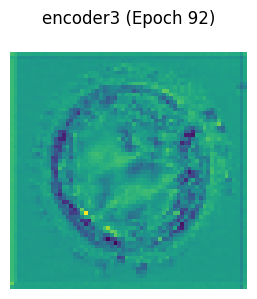

encoder4: torch.Size([3, 32, 32, 32])


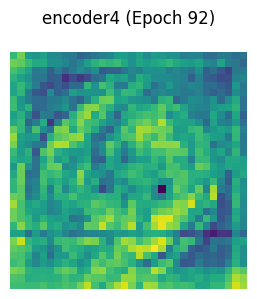

encoder5: torch.Size([3, 48, 16, 16])


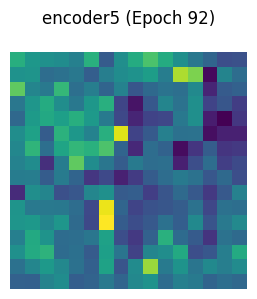

encoder6: torch.Size([3, 64, 8, 8])


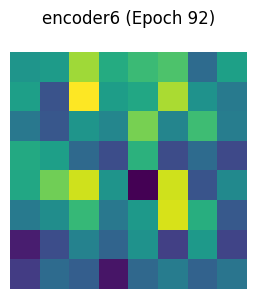

decoder1: torch.Size([3, 48, 8, 8])


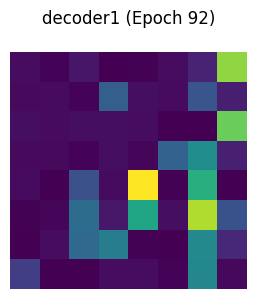

decoder2: torch.Size([3, 32, 8, 8])


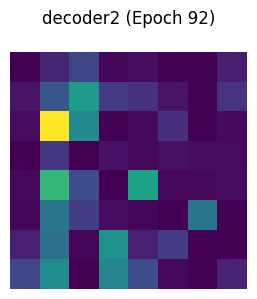

decoder3: torch.Size([3, 24, 16, 16])


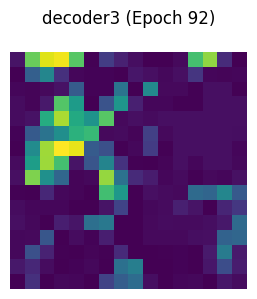

decoder4: torch.Size([3, 16, 32, 32])


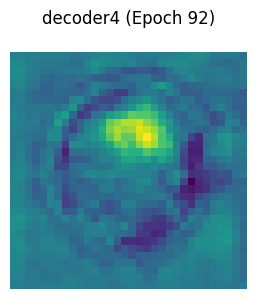

decoder5: torch.Size([3, 8, 64, 64])


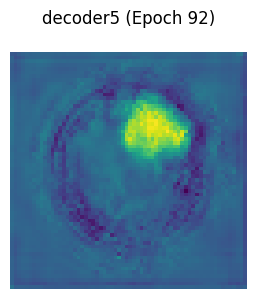

Epoch 92: Loss = 92.1831, Val Dice = 0.8364, Val mIoU = 0.7206, Val Accuracy = 0.9728, Val Sensitivity = 0.8151, Val Specificity = 0.9880


Epoch 93/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 93] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


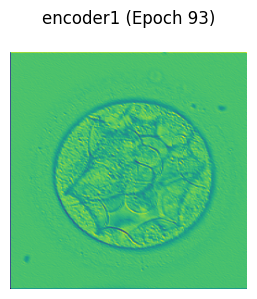

encoder2: torch.Size([3, 16, 128, 128])


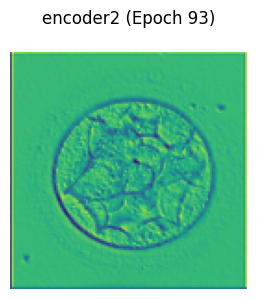

encoder3: torch.Size([3, 24, 64, 64])


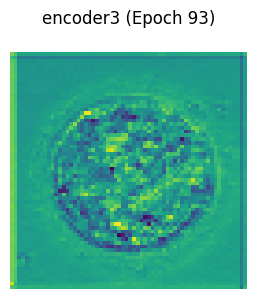

encoder4: torch.Size([3, 32, 32, 32])


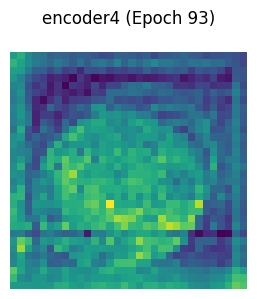

encoder5: torch.Size([3, 48, 16, 16])


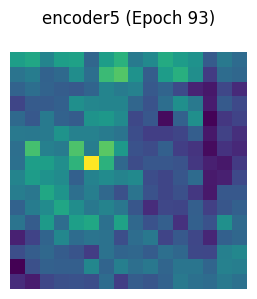

encoder6: torch.Size([3, 64, 8, 8])


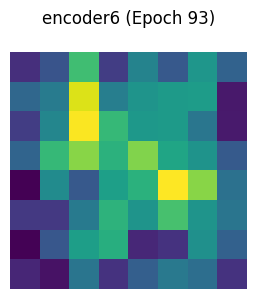

decoder1: torch.Size([3, 48, 8, 8])


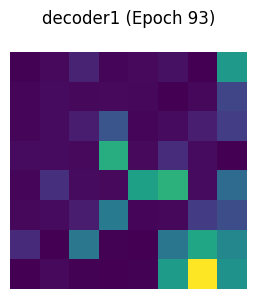

decoder2: torch.Size([3, 32, 8, 8])


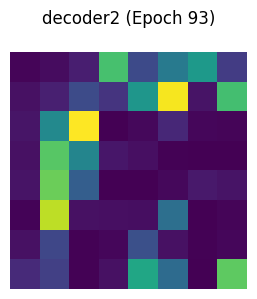

decoder3: torch.Size([3, 24, 16, 16])


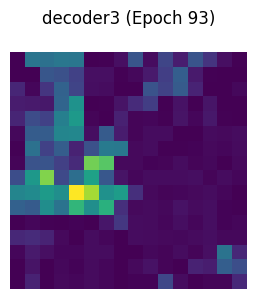

decoder4: torch.Size([3, 16, 32, 32])


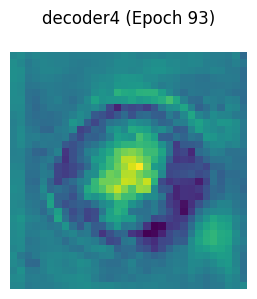

decoder5: torch.Size([3, 8, 64, 64])


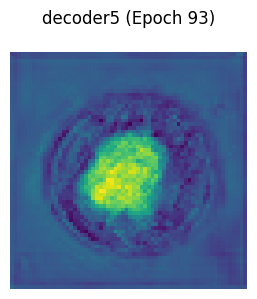

Epoch 93: Loss = 92.0424, Val Dice = 0.8209, Val mIoU = 0.6996, Val Accuracy = 0.9701, Val Sensitivity = 0.8004, Val Specificity = 0.9865


Epoch 94/100: 100%|██████████| 125/125 [01:54<00:00,  1.09it/s]


[Epoch 94] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


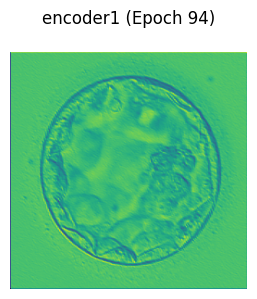

encoder2: torch.Size([3, 16, 128, 128])


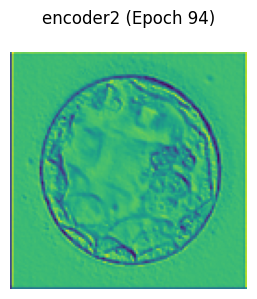

encoder3: torch.Size([3, 24, 64, 64])


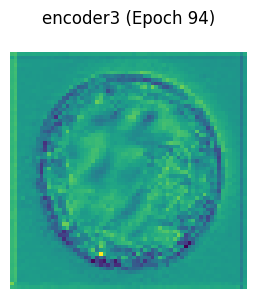

encoder4: torch.Size([3, 32, 32, 32])


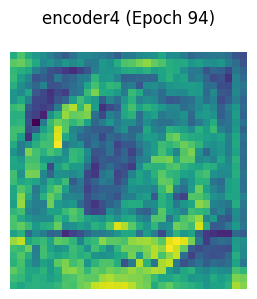

encoder5: torch.Size([3, 48, 16, 16])


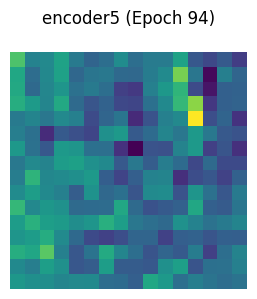

encoder6: torch.Size([3, 64, 8, 8])


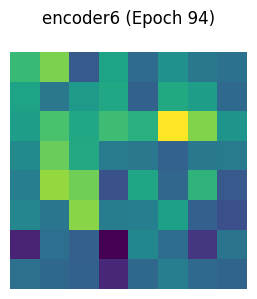

decoder1: torch.Size([3, 48, 8, 8])


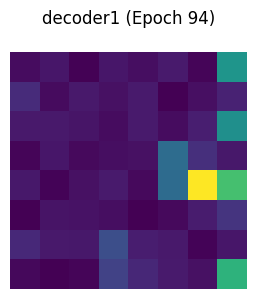

decoder2: torch.Size([3, 32, 8, 8])


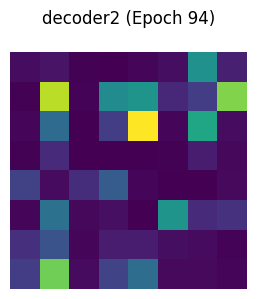

decoder3: torch.Size([3, 24, 16, 16])


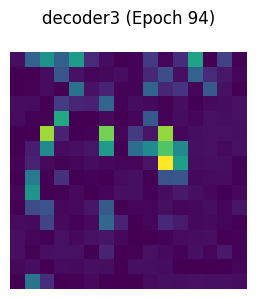

decoder4: torch.Size([3, 16, 32, 32])


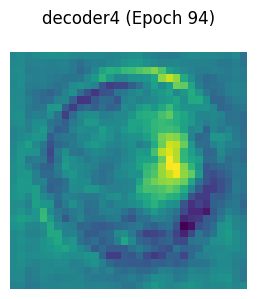

decoder5: torch.Size([3, 8, 64, 64])


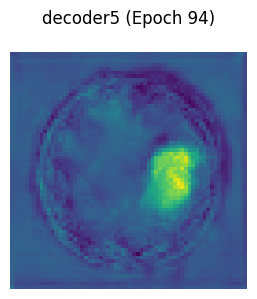

Epoch 94: Loss = 92.2045, Val Dice = 0.8418, Val mIoU = 0.7291, Val Accuracy = 0.9722, Val Sensitivity = 0.8615, Val Specificity = 0.9832


Epoch 95/100: 100%|██████████| 125/125 [01:55<00:00,  1.08it/s]


[Epoch 95] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


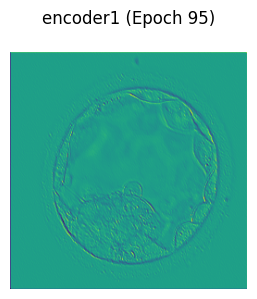

encoder2: torch.Size([3, 16, 128, 128])


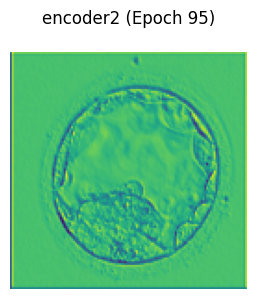

encoder3: torch.Size([3, 24, 64, 64])


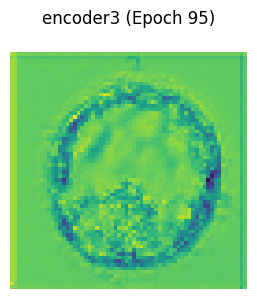

encoder4: torch.Size([3, 32, 32, 32])


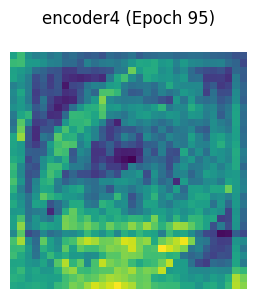

encoder5: torch.Size([3, 48, 16, 16])


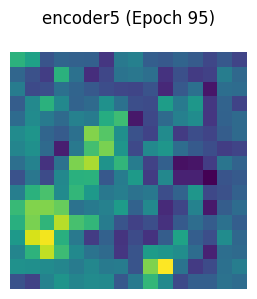

encoder6: torch.Size([3, 64, 8, 8])


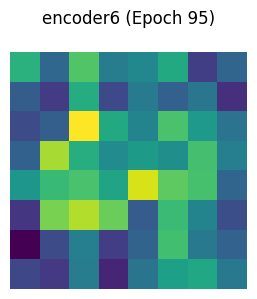

decoder1: torch.Size([3, 48, 8, 8])


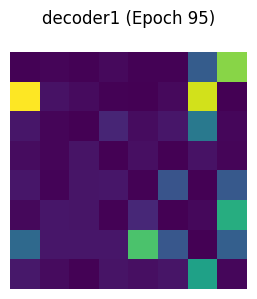

decoder2: torch.Size([3, 32, 8, 8])


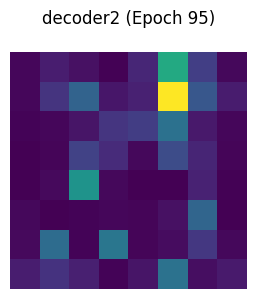

decoder3: torch.Size([3, 24, 16, 16])


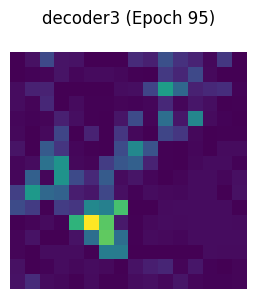

decoder4: torch.Size([3, 16, 32, 32])


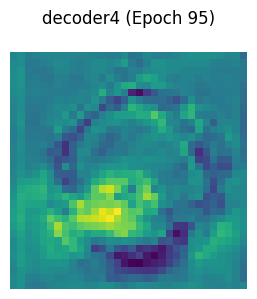

decoder5: torch.Size([3, 8, 64, 64])


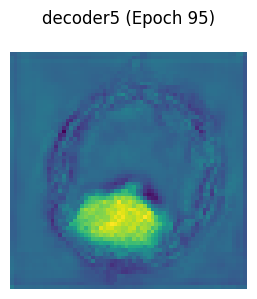

Epoch 95: Loss = 91.4209, Val Dice = 0.8385, Val mIoU = 0.7234, Val Accuracy = 0.9725, Val Sensitivity = 0.8290, Val Specificity = 0.9867


Epoch 96/100: 100%|██████████| 125/125 [01:56<00:00,  1.08it/s]


[Epoch 96] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


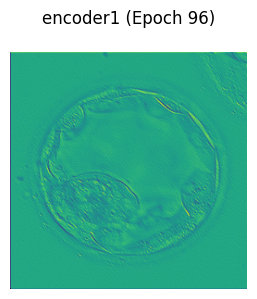

encoder2: torch.Size([3, 16, 128, 128])


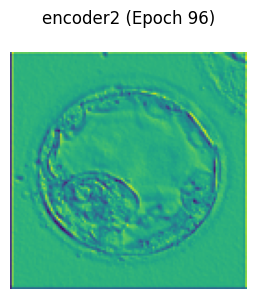

encoder3: torch.Size([3, 24, 64, 64])


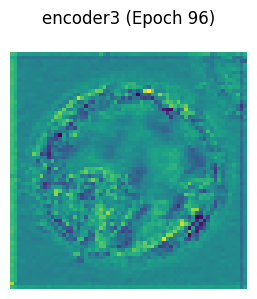

encoder4: torch.Size([3, 32, 32, 32])


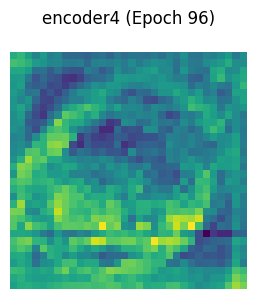

encoder5: torch.Size([3, 48, 16, 16])


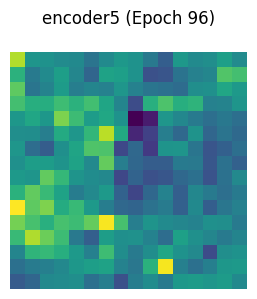

encoder6: torch.Size([3, 64, 8, 8])


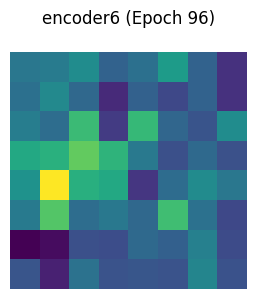

decoder1: torch.Size([3, 48, 8, 8])


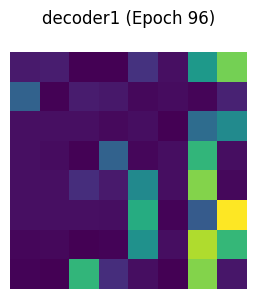

decoder2: torch.Size([3, 32, 8, 8])


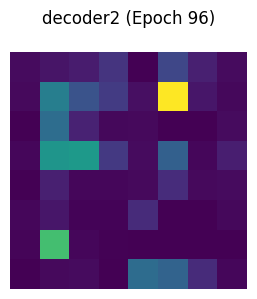

decoder3: torch.Size([3, 24, 16, 16])


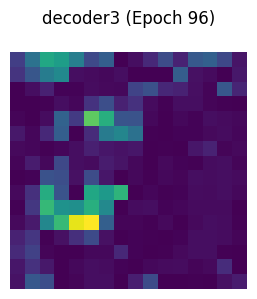

decoder4: torch.Size([3, 16, 32, 32])


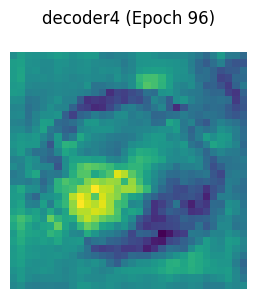

decoder5: torch.Size([3, 8, 64, 64])


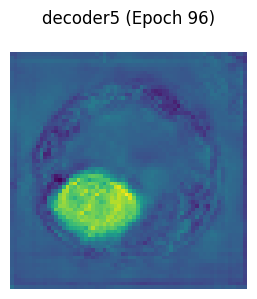

Epoch 96: Loss = 90.7731, Val Dice = 0.8432, Val mIoU = 0.7320, Val Accuracy = 0.9733, Val Sensitivity = 0.8401, Val Specificity = 0.9863


Epoch 97/100: 100%|██████████| 125/125 [01:56<00:00,  1.07it/s]


[Epoch 97] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


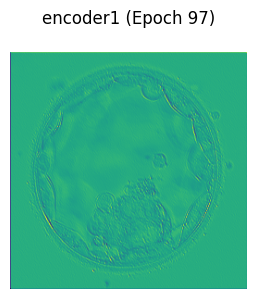

encoder2: torch.Size([3, 16, 128, 128])


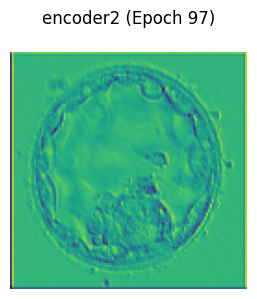

encoder3: torch.Size([3, 24, 64, 64])


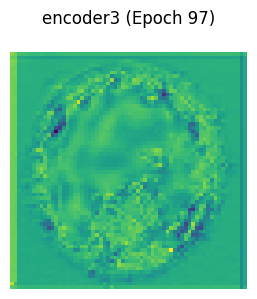

encoder4: torch.Size([3, 32, 32, 32])


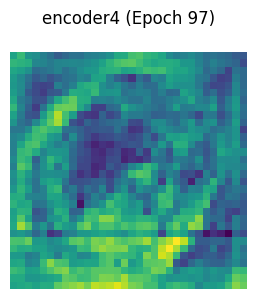

encoder5: torch.Size([3, 48, 16, 16])


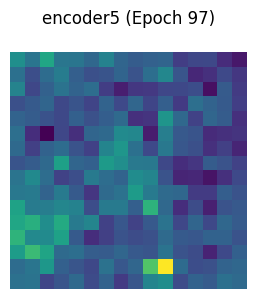

encoder6: torch.Size([3, 64, 8, 8])


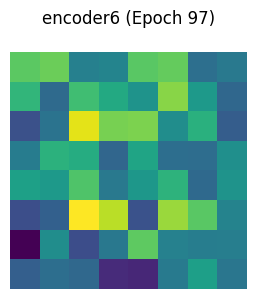

decoder1: torch.Size([3, 48, 8, 8])


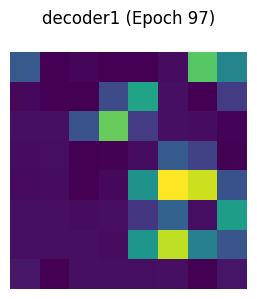

decoder2: torch.Size([3, 32, 8, 8])


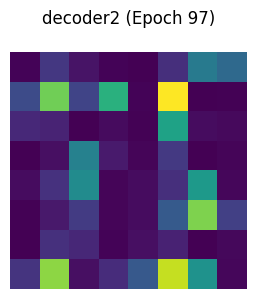

decoder3: torch.Size([3, 24, 16, 16])


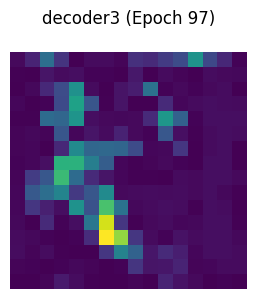

decoder4: torch.Size([3, 16, 32, 32])


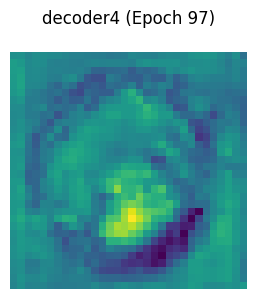

decoder5: torch.Size([3, 8, 64, 64])


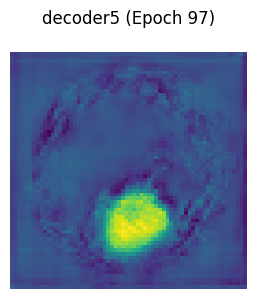

Epoch 97: Loss = 90.5392, Val Dice = 0.8373, Val mIoU = 0.7244, Val Accuracy = 0.9714, Val Sensitivity = 0.8609, Val Specificity = 0.9821


Epoch 98/100: 100%|██████████| 125/125 [01:56<00:00,  1.07it/s]


[Epoch 98] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


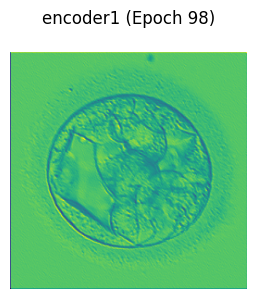

encoder2: torch.Size([3, 16, 128, 128])


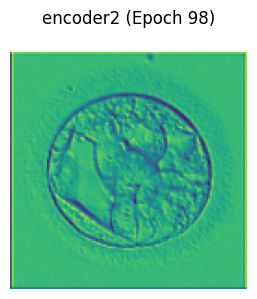

encoder3: torch.Size([3, 24, 64, 64])


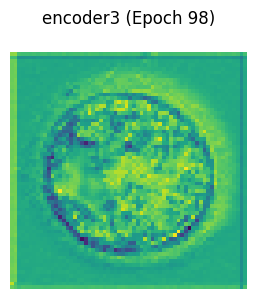

encoder4: torch.Size([3, 32, 32, 32])


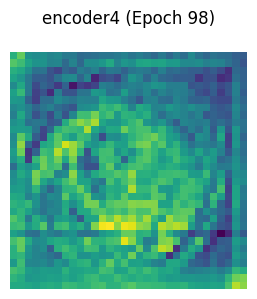

encoder5: torch.Size([3, 48, 16, 16])


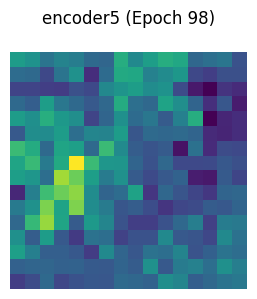

encoder6: torch.Size([3, 64, 8, 8])


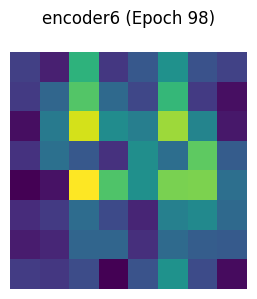

decoder1: torch.Size([3, 48, 8, 8])


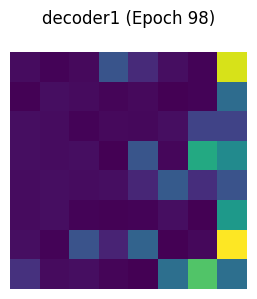

decoder2: torch.Size([3, 32, 8, 8])


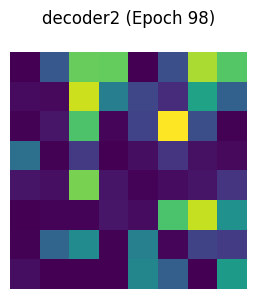

decoder3: torch.Size([3, 24, 16, 16])


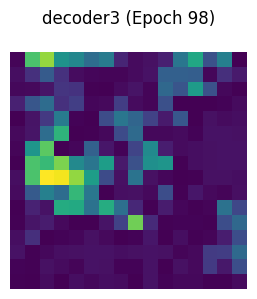

decoder4: torch.Size([3, 16, 32, 32])


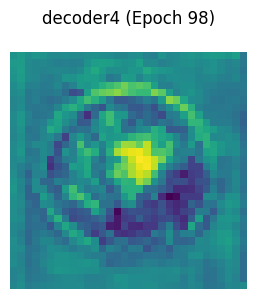

decoder5: torch.Size([3, 8, 64, 64])


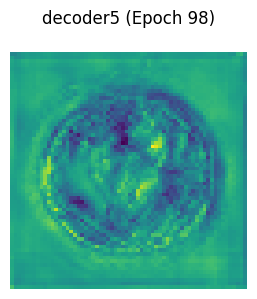

Epoch 98: Loss = 90.3500, Val Dice = 0.8491, Val mIoU = 0.7400, Val Accuracy = 0.9740, Val Sensitivity = 0.8544, Val Specificity = 0.9857


Epoch 99/100: 100%|██████████| 125/125 [01:56<00:00,  1.07it/s]


[Epoch 99] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


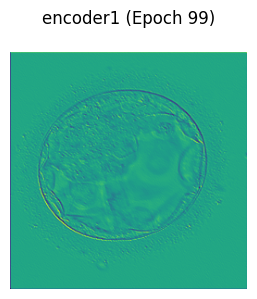

encoder2: torch.Size([3, 16, 128, 128])


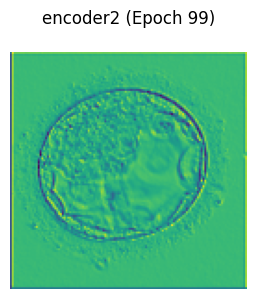

encoder3: torch.Size([3, 24, 64, 64])


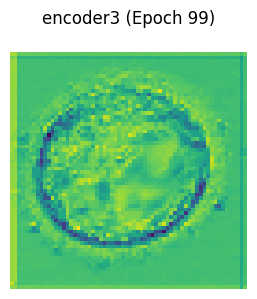

encoder4: torch.Size([3, 32, 32, 32])


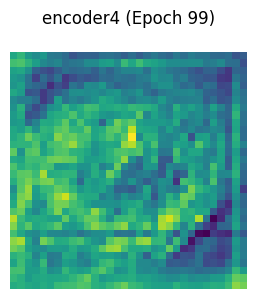

encoder5: torch.Size([3, 48, 16, 16])


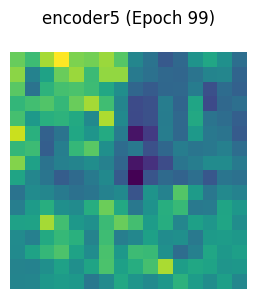

encoder6: torch.Size([3, 64, 8, 8])


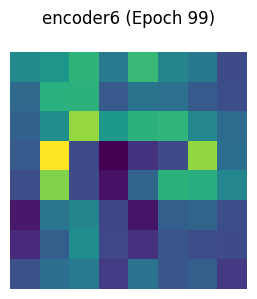

decoder1: torch.Size([3, 48, 8, 8])


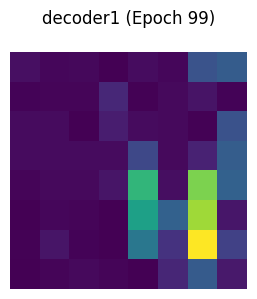

decoder2: torch.Size([3, 32, 8, 8])


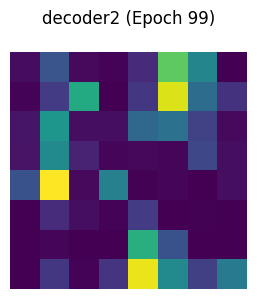

decoder3: torch.Size([3, 24, 16, 16])


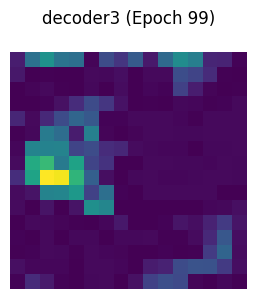

decoder4: torch.Size([3, 16, 32, 32])


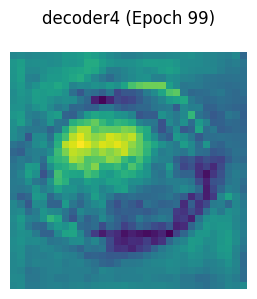

decoder5: torch.Size([3, 8, 64, 64])


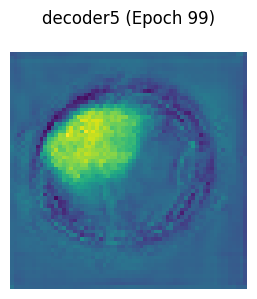

Epoch 99: Loss = 90.1065, Val Dice = 0.8502, Val mIoU = 0.7421, Val Accuracy = 0.9744, Val Sensitivity = 0.8459, Val Specificity = 0.9869


Epoch 100/100: 100%|██████████| 125/125 [01:56<00:00,  1.07it/s]


[Epoch 100] Feature maps:
encoder1: torch.Size([3, 8, 256, 256])


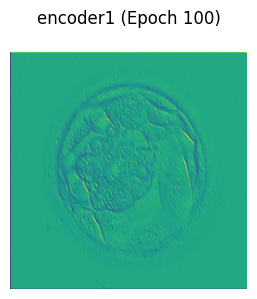

encoder2: torch.Size([3, 16, 128, 128])


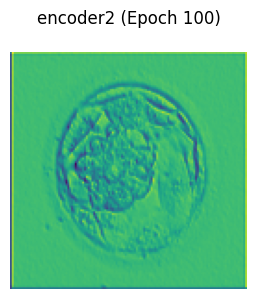

encoder3: torch.Size([3, 24, 64, 64])


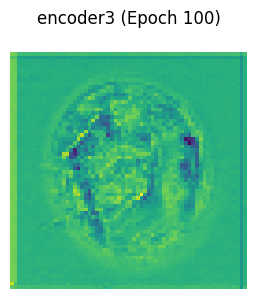

encoder4: torch.Size([3, 32, 32, 32])


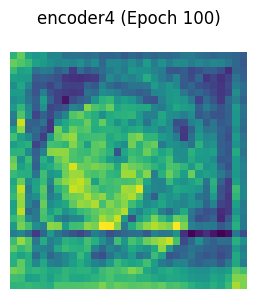

encoder5: torch.Size([3, 48, 16, 16])


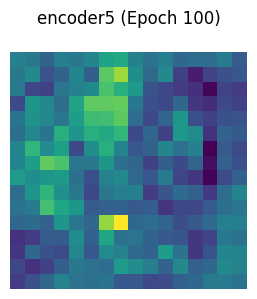

encoder6: torch.Size([3, 64, 8, 8])


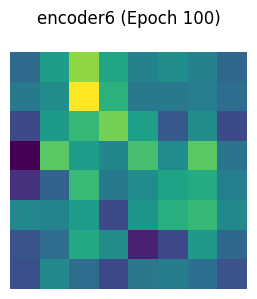

decoder1: torch.Size([3, 48, 8, 8])


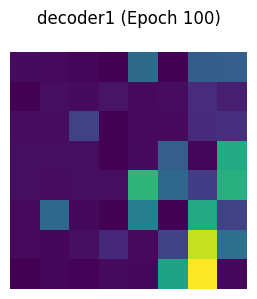

decoder2: torch.Size([3, 32, 8, 8])


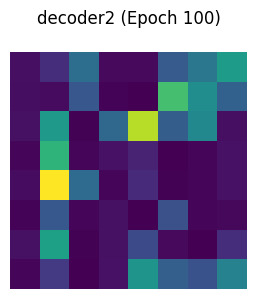

decoder3: torch.Size([3, 24, 16, 16])


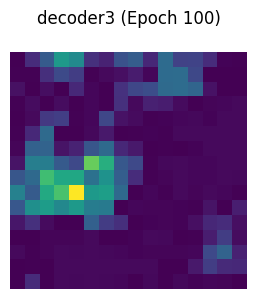

decoder4: torch.Size([3, 16, 32, 32])


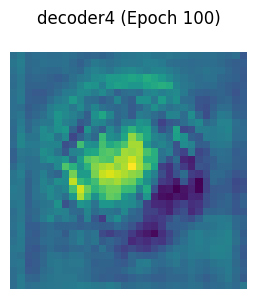

decoder5: torch.Size([3, 8, 64, 64])


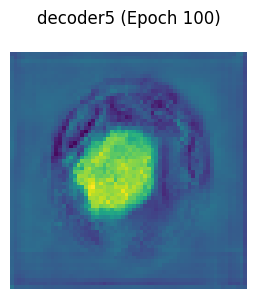

Epoch 100: Loss = 90.2915, Val Dice = 0.8424, Val mIoU = 0.7305, Val Accuracy = 0.9731, Val Sensitivity = 0.8433, Val Specificity = 0.9857


In [17]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# === Feature map visualization ===
def visualize_feature_maps(feature_maps, title, n_maps=5):
    num_maps = min(n_maps, feature_maps.shape[1])
    plt.figure(figsize=(3 * num_maps, 3))  # Wider layout for horizontal arrangement
    plt.suptitle(title)

    for i in range(num_maps):
        plt.subplot(1, num_maps, i + 1)
        fmap = feature_maps[0, i].cpu().detach().numpy()
        plt.imshow(fmap, cmap='viridis')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# === Register forward hooks on specific layers ===
def register_hooks(model, layer_names):
    feature_maps = {}

    def get_hook(name):
        def hook(module, input, output):
            feature_maps[name] = output
        return hook

    handles = []
    for name, module in model.named_modules():
        if name in layer_names:
            handles.append(module.register_forward_hook(get_hook(name)))

    return feature_maps, handles

# === CONFIGURATION ===
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
EPOCHS = 100

# === MODEL ===
model = MALUNet().to(DEVICE)
optimizer = optim.AdamW(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=50, eta_min=0.00001)

# === LAYERS TO TRACK ===
tracked_layers = [
    'encoder1', 'encoder2', 'encoder3', 'encoder4', 'encoder5', 'encoder6',
    'decoder1', 'decoder2', 'decoder3', 'decoder4', 'decoder5',
]

# === TRAINING LOOP ===
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0

    # Register hooks
    feature_maps, handles = register_hooks(model, tracked_layers)
    last_batch_images = None

    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{EPOCHS}"):
        images, masks = images.to(DEVICE), masks.to(DEVICE)
        last_batch_images = images  # Save last batch for visualization

        optimizer.zero_grad()
        preds = model(images)
        loss = BCEDiceLoss()(preds, masks)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    scheduler.step()

    # === Visualize Feature Maps ===
    if feature_maps:
        print(f"\n[Epoch {epoch + 1}] Feature maps:")
        for name, fmap in feature_maps.items():
            print(f"{name}: {fmap.shape}")
            visualize_feature_maps(fmap, f"{name} (Epoch {epoch+1})", n_maps=1)
    else:
        print(f"\n[Epoch {epoch + 1}] No feature maps captured.")

    # Remove hooks after each epoch
    for h in handles:
        h.remove()

    # === VALIDATION ===
    model.eval()
    with torch.no_grad():
        val_dice, val_miou, val_accuracy, val_sensitivity, val_specificity = [], [], [], [], []

        for images, masks in valid_loader:
            images, masks = images.to(DEVICE), masks.to(DEVICE)
            preds = model(images)

            TP, TN, FP, FN = get_confusion(masks, preds)
            val_dice.append(dice_score(masks, preds).item())
            val_miou.append(mean_iou(masks, preds).item())
            val_accuracy.append(accuracy(masks, preds).item())
            val_sensitivity.append(sensitivity(masks, preds).item())
            val_specificity.append(specificity(masks, preds).item())

        print(f"Epoch {epoch+1}: Loss = {total_loss:.4f}, "
              f"Val Dice = {np.mean(val_dice):.4f}, "
              f"Val mIoU = {np.mean(val_miou):.4f}, "
              f"Val Accuracy = {np.mean(val_accuracy):.4f}, "
              f"Val Sensitivity = {np.mean(val_sensitivity):.4f}, "
              f"Val Specificity = {np.mean(val_specificity):.4f}")
